# **Physics-Informed Neural Network (PINN) for System Identification**

## **Overview**
This project implements a **Physics-Informed Neural Network (PINN)** to identify unknown dynamics in a system of differential equations. The model consists of:
1. **A Known Dynamics Model (`PINNIdentificationNet`)** – learns the structured part of the system along with unknown system parameters.
2. **An Unknown Dynamics Model (`GNet`)** – approximates missing or unmodeled dynamics.

The solver (`PINNSolver_ID`) integrates both models, optimizes their parameters, and minimizes residual errors in the system.

---

## **Workflow**
### **1. Imports and Setup**
- Required libraries (`TensorFlow`, `NumPy`, `Matplotlib`, etc.) are imported.
- Data types and random seeds are set for **reproducibility**.

### **2. Defining the System of Differential Equations**
- The system consists of four coupled ODEs modeling the state evolution.
- Parameters governing the system are defined.

### **3. Generating Training Data**
- The ODE system is solved numerically using `scipy.integrate.odeint`.
- **Noise is added** to simulate real-world uncertainties.

### **4. Building the PINN Model**
- A deep neural network (NN1:`ePINNIdentificationNet`) is designed with trainable parameters.
- Another network (NN2:`GNet`) learns the value of unknown dynamics in each time instant.

### **5. Loss Function and Training**
- **Residuals are computed** from the system dynamics.
- The **initial condition loss, physics loss, and data loss** are included.
- The **Adam optimizer** is used to minimize the loss.

### **6. Training the ePINN**
- The PINN solver (`PINNSolver_ID`) iteratively optimizes the model.
- Results are logged and plotted during training.

### **7. Results and Visualization**
- The **final trained parameters** are printed.
- **Loss trends** and system trajectories are plotted.

---

## **Usage**
1. **Run the script** to initialize and train the model.
2. Modify **hyperparameters** (number of layers, neurons, learning rate) if needed.
3. Examine the **loss plots** to analyze model performance.
4. Use the trained model for **predictions and further analysis**.


## Import libraries

In [1]:
# Standard Library
import time
import random

# Third-Party Libraries
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
from scipy.optimize import minimize
from scipy.integrate import odeint

# Set TensorFlow Float Type
DTYPE = 'float32'
tf.keras.backend.set_floatx(DTYPE)


2025-03-05 11:00:03.051090: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


## Generate synthetic data (Alternatively, import previously generated data using the following cell)

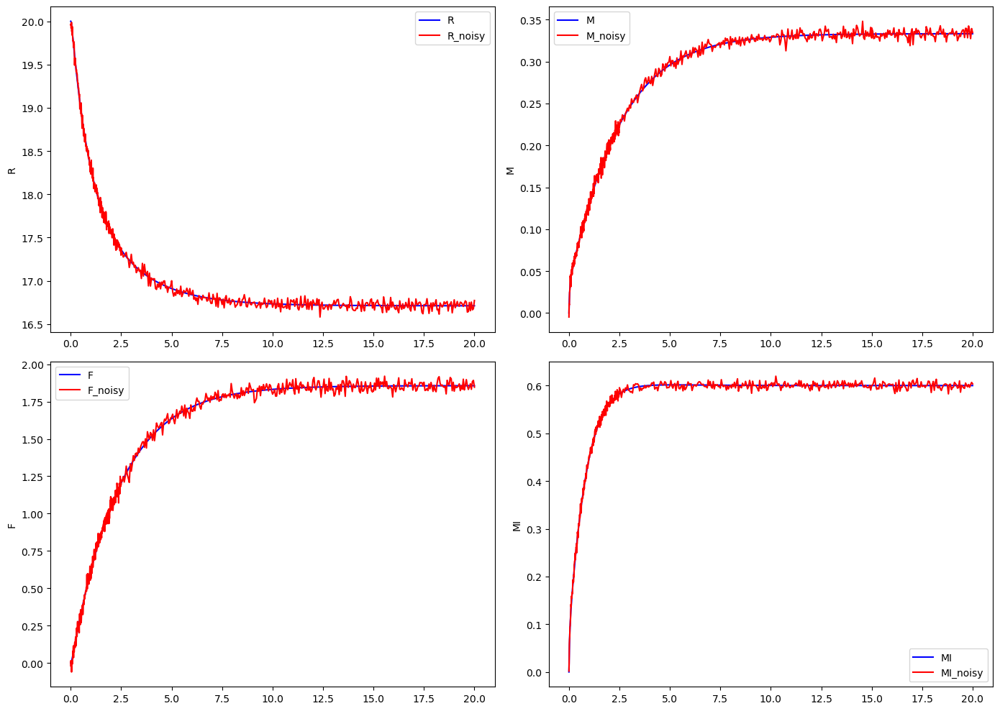

In [2]:
# Define the system of differential equations
def system(state, t, params):
    R, M, F, MI = state
    
    # Unpack parameters
    w11, w12, w21, w22 = params['w11'], params['w12'], params['w21'], params['w22']
    beta2 = params['beta2']
    alpha11, alpha12, alpha21, alpha22 = params['alpha11'], params['alpha12'], params['alpha21'], params['alpha22']
    RT, QT = params['RT'], params['QT']
    
    # Define the system of equations
    dR_dt = -w11 * M * R + w12 * F - w21 * MI * R + w22 * (RT - R - F)
    dM_dt = alpha11 - alpha12 * M - w11 * M * R + w12 * F
    dF_dt = w11 * M * R - w12 * F
    dMI_dt = alpha21 - alpha22 * MI - w21 * MI * R + w22 * (RT - R - F)
    
    return [dR_dt, dM_dt, dF_dt, dMI_dt]

# Parameters
params = {
    'w11': 1, 'w12': 3, 'w21': 1, 'w22': 7,
    'beta1': 2, 'beta2': 1,
    'alpha11': 1, 'alpha12': 3, 'alpha21': 3, 'alpha22': 5,
    'RT': 20, 'QT': 18
}

# Initial conditions
initial_conditions = [20, 0, 0, 0]

# Time intervals
dt1, dt2 = 0.01, 0.05
t0, t1, t2, t3 = 0, 2.5, 15, 20

time_interval1 = np.linspace(t0, t1, int((t1 - t0) / dt1) + 1)
time_interval2 = np.linspace(t1, t2, int((t2 - t1) / dt2) + 1)
time_interval3 = np.linspace(t2, t3, int((t3 - t2) / dt2) + 1)

t_data_train = np.concatenate((time_interval1, time_interval2))
t_data = np.concatenate((time_interval1, time_interval2, time_interval3))
t_true = t_data

# Solve the system
solution = odeint(system, initial_conditions, t_data, args=(params,))
x_data = solution
R_true, M_true, F_true, MI_true = solution.T

# Add noise to data
noise_scale = 0.05
noise_matrix = np.hstack([
    np.random.normal(0, stdev * noise_scale, (len(solution), 1)) 
    for stdev in solution.std(axis=0)
])

noisy_solution = solution + noise_matrix
R_noisy, M_noisy, F_noisy, MI_noisy = noisy_solution.T
x_data_noisy = noisy_solution

# Plot the results
fig, axs = plt.subplots(2, 2, figsize=(14, 10))
axs = axs.flatten()

for i, (true_data, noisy_data, label) in enumerate(zip(
        [R_true, M_true, F_true, MI_true],
        [R_noisy, M_noisy, F_noisy, MI_noisy],
        ['R', 'M', 'F', 'MI'])):
    
    axs[i].plot(t_true, true_data, label=f'{label}', color='b')
    axs[i].plot(t_true, noisy_data, label=f'{label}_noisy', color='r')
    axs[i].set_ylabel(label)
    axs[i].legend()

plt.tight_layout()
plt.show()

# Prepare training data
x_data_train = x_data[:len(t_data_train), :]
x_data_noisy_train = x_data_noisy[:len(t_data_train), :]

# Convert to tensors
t_data_tf = tf.convert_to_tensor(t_data, dtype=DTYPE)
x_data_tf = tf.convert_to_tensor(x_data, dtype=DTYPE)
x_data_noisy_tf = tf.convert_to_tensor(x_data_noisy, dtype=DTYPE)

T_data = tf.reshape(t_data_tf, (-1, 1))
T_data_train = tf.reshape(t_data_tf[:len(t_data_train)], (-1, 1))
X_data = tf.reshape(x_data_tf, (-1, 4))
X_data_train = tf.reshape(x_data_tf[:len(t_data_train), :], (-1, 4))
X_data_noisy_train = tf.reshape(x_data_noisy_tf[:len(t_data_train), :], (-1, 4))


## Import data 

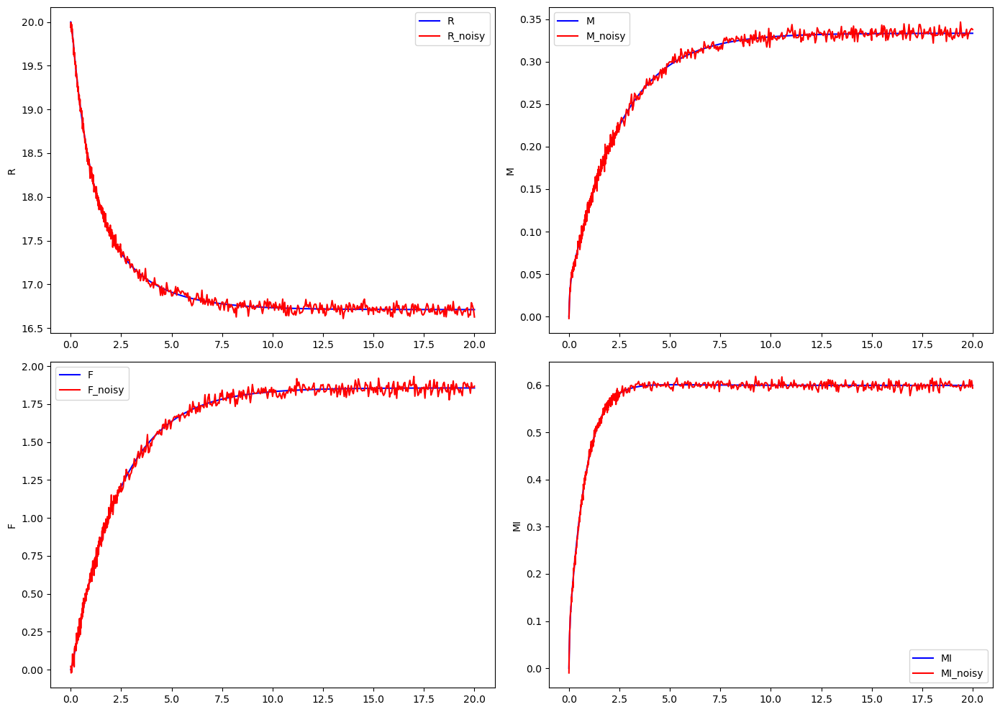

In [3]:
# Load precomputed data
X_data_noisy_train = tf.convert_to_tensor(np.load('X_data_noisy_train.npy'), dtype=tf.float32)
T_data_train = tf.convert_to_tensor(np.load('T_data_train.npy'), dtype=tf.float32)
x_data_noisy = np.load('x_data_noisy.npy')
x_data = np.load('x_data.npy')
t_data = np.load('t_data.npy')

# Convert time data to tensor
t_true = t_data
t_data_tf = tf.convert_to_tensor(t_data, dtype=DTYPE)
T_data = tf.reshape(t_data_tf, (-1, 1))

# Extract individual states
R_noisy, M_noisy, F_noisy, MI_noisy = x_data_noisy.T
R_true, M_true, F_true, MI_true = x_data.T

# Plot the results
fig, axs = plt.subplots(2, 2, figsize=(14, 10))
axs = axs.flatten()

for i, (true_data, noisy_data, label) in enumerate(zip(
        [R_true, M_true, F_true, MI_true],
        [R_noisy, M_noisy, F_noisy, MI_noisy],
        ['R', 'M', 'F', 'MI'])):
    
    axs[i].plot(t_true, true_data, label=f'{label}', color='b')
    axs[i].plot(t_true, noisy_data, label=f'{label}_noisy', color='r')
    axs[i].set_ylabel(label)
    axs[i].legend()

plt.tight_layout()
plt.show()


## NN1 (Parameter Estimator)

In [4]:
class PINNIdentificationNet(tf.keras.Model):
    def __init__(self, output_dim=4, num_hidden_layers=4, num_neurons_per_layer=64,
                 activation='softplus', kernel_initializer='glorot_normal', bias_initializer='zeros', **kwargs):
        super().__init__(**kwargs)

        # Hidden layers
        self.hidden_layers = [
            tf.keras.layers.Dense(
                units=num_neurons_per_layer,
                activation=activation,
                kernel_initializer=kernel_initializer,
                bias_initializer=bias_initializer
            ) for _ in range(num_hidden_layers)
        ]

        # Output layer
        self.output_layer = tf.keras.layers.Dense(
            units=output_dim,
            kernel_initializer=kernel_initializer,
            bias_initializer=bias_initializer
        )

        # Custom variables (non-trainable)
        self.true_alpha21 = tf.Variable(3.0, trainable=False, dtype=tf.float32)
        self.true_alpha22 = tf.Variable(5.0, trainable=False, dtype=tf.float32)
        self.true_R0 = tf.Variable(20.0, trainable=False, dtype=tf.float32)
        self.true_M0 = tf.Variable(0.0, trainable=False, dtype=tf.float32)
        self.true_F0 = tf.Variable(0.0, trainable=False, dtype=tf.float32)
        self.true_MI0 = tf.Variable(0.0, trainable=False, dtype=tf.float32)

        # Lists to track variable updates
        self.true_alpha21_list = []
        self.true_alpha22_list = []
        self.alpha21_list = []
        self.alpha22_list = []

        # Model parameters (non-trainable unless explicitly stated)
        self.w11 = tf.Variable(1.0, trainable=False, dtype=tf.float32)
        self.w12 = tf.Variable(3.0, trainable=False, dtype=tf.float32)
        self.w21 = tf.Variable(1.0, trainable=False, dtype=tf.float32)
        self.w22 = tf.Variable(7.0, trainable=False, dtype=tf.float32)
        self.alpha11 = tf.Variable(1.0, trainable=False, dtype=tf.float32)
        self.alpha12 = tf.Variable(3.0, trainable=False, dtype=tf.float32)

        # Trainable parameters
        self.alpha21 = tf.Variable(4.0, trainable=True, dtype=tf.float32, name="alpha21")
        self.alpha22 = tf.Variable(4.0, trainable=True, dtype=tf.float32, name="alpha22")

        # Other constants
        self.beta2 = tf.Variable(1.0, trainable=False, dtype=tf.float32)
        self.RT = tf.Variable(20.0, trainable=False, dtype=tf.float32)
        self.QT = tf.Variable(18.0, trainable=False, dtype=tf.float32)

    def call(self, inputs):
        x = inputs
        for layer in self.hidden_layers:
            x = layer(x)
        return self.output_layer(x)


## NN2 (Unknown mechanism estimator)

In [5]:
class GNet(tf.keras.Model):
    def __init__(self, output_dim=1, num_hidden_layers=2, num_neurons_per_layer=64,
                 activation='softplus', kernel_initializer='glorot_normal', bias_initializer='zeros', **kwargs):
        super().__init__(**kwargs)

        # Hidden layers
        self.hidden_layers = [
            tf.keras.layers.Dense(
                units=num_neurons_per_layer,
                activation=activation,
                kernel_initializer=kernel_initializer,
                bias_initializer=bias_initializer
            ) for _ in range(num_hidden_layers)
        ]

        # Output layer
        self.output_layer = tf.keras.layers.Dense(
            units=output_dim,
            kernel_initializer=kernel_initializer,
            bias_initializer=bias_initializer
        )

    def call(self, inputs):
        x = inputs
        for layer in self.hidden_layers:
            x = layer(x)
        return self.output_layer(x)


## Define problem and solver

In [8]:
class PINNSolver_ID:
    def __init__(self, knowndynamics_model, unknowndynamics_model, T_r):
        self.knowndynamics_model = knowndynamics_model
        self.unknowndynamics_model = unknowndynamics_model
        self.t = T_r
        self.L_hist, self.L_p_hist, self.L_d_hist = [], [], []
        self.L_IC_hist, self.L_G_hist, self.IC_hist, self.G_hist = [], [], [], []
        self.alpha21_hist, self.alpha22_hist = [], []
        self.iter = 0

    def get_r(self):
        with tf.GradientTape(persistent=True) as tape:
            tape.watch(self.t)
            u = self.knowndynamics_model(self.t)
            R, M, F, MI = u[:, 0:1], u[:, 1:2], u[:, 2:3], u[:, 3:4]

        R_t, M_t, F_t, MI_t = (
            tape.gradient(R, self.t),
            tape.gradient(M, self.t),
            tape.gradient(F, self.t),
            tape.gradient(MI, self.t)
        )
        G = self.unknowndynamics_model(self.t)
        r, e_G = self.fun_r(R, M, F, MI, R_t, M_t, F_t, MI_t, G)

        return r, e_G, G

    def loss_fn(self, T, u):
        r, e_G, G = self.get_r()
        L_p = tf.reduce_mean(r)

        # Compute L_d using vectorized operations
        u_pred = self.knowndynamics_model(T)
        L_d = tf.reduce_mean(
            tf.square(u[:, 0] - tf.gather(u_pred, indices=[2], axis=1)) +
            tf.square(u[:, 1] - tf.reduce_sum(tf.gather(u_pred, indices=[1, 3], axis=1), axis=1))
        )

        # Compute initial condition loss
        u_pred_initial = self.knowndynamics_model(T[:1, :1])
        u_initial_true = tf.convert_to_tensor([
            self.knowndynamics_model.true_R0, self.knowndynamics_model.true_M0,
            self.knowndynamics_model.true_F0, self.knowndynamics_model.true_MI0
        ], dtype=tf.float32)

        L_IC = tf.reduce_sum(tf.square(u_pred_initial - u_initial_true))

        # Compute total loss with weighted contributions
        w_p, w_d, w_ic = 1,1,1;
        loss = w_d*L_d + w_p*L_p + w_ic*L_IC
        L_G = tf.reduce_mean(e_G)
        return loss, L_d, L_p, L_IC, L_G, G

    

    def get_grad(self, T, u):
        with tf.GradientTape(persistent=True) as tape:
            loss, L_d, L_p, L_IC, L_G, G = self.loss_fn(T, u)

        trainable_vars = [self.knowndynamics_model.alpha21, self.knowndynamics_model.alpha22] + \
                         self.knowndynamics_model.trainable_variables + self.unknowndynamics_model.trainable_variables

        gradients = tape.gradient(loss, trainable_vars)
        del tape
        return loss, L_d, L_p, L_IC, L_G, gradients

    def fun_r(self, R, M, F, MI, R_t, M_t, F_t, MI_t, G):
        result, r_G = [], []

        for i in range(len(R)):
            e_R = R_t[i] + self.knowndynamics_model.w11 * M[i] * R[i] - self.knowndynamics_model.w12 * F[i] - G[i]
            e_M = M_t[i] - self.knowndynamics_model.alpha11 + self.knowndynamics_model.alpha12 * M[i] + \
                  self.knowndynamics_model.w11 * M[i] * R[i] - self.knowndynamics_model.w12 * F[i]
            e_F = F_t[i] - self.knowndynamics_model.w11 * M[i] * R[i] + self.knowndynamics_model.w12 * F[i]
            e_MI = MI_t[i] - self.knowndynamics_model.alpha21 + self.knowndynamics_model.alpha22 * MI[i] - G[i]

            residual_sum = tf.square(e_R) + tf.square(e_M) + tf.square(e_F) + tf.square(e_MI)
            result.append(residual_sum)

            e_G = -self.knowndynamics_model.w11 * MI[i] * R[i] + self.knowndynamics_model.w22 * \
                  (self.knowndynamics_model.RT - R[i] - F[i]) - G[i]
            r_G.append(e_G)

        return tf.concat(result, axis=0), tf.concat(r_G, axis=0)

    def solve_with_TFoptimizer(self, optimizer, T, u, N=10000):
        @tf.function
        def train_step():
            r, e_G, G = self.get_r()
            loss, L_d, L_p, L_IC, L_G, gradients = self.get_grad(T, u)
            
            trainable_vars = [self.knowndynamics_model.alpha21, self.knowndynamics_model.alpha22] + \
                             self.knowndynamics_model.trainable_variables + self.unknowndynamics_model.trainable_variables

            optimizer.apply_gradients(zip(gradients, trainable_vars))
            return loss, L_d, L_p, L_IC, L_G, G

        for i in range(N):
            loss, L_d, L_p, L_IC, L_G, G = train_step()

            self.G_hist.append(G.numpy())
            self.current_ic = self.knowndynamics_model(T[0:1, 0:1]).numpy()
            self.current_loss = loss.numpy()
            self.current_lossp = L_p.numpy()
            self.current_lossd = L_d.numpy()
            self.current_lossic = L_IC.numpy()
            self.current_lossg = L_G.numpy()
            self.current_alpha21 = self.knowndynamics_model.alpha21.numpy()
            self.current_alpha22 = self.knowndynamics_model.alpha22.numpy()

            self.L_hist.append(self.current_loss)
            self.L_p_hist.append(self.current_lossp)
            self.L_d_hist.append(self.current_lossd)
            self.L_IC_hist.append(self.current_lossic)
            self.L_G_hist.append(self.current_lossg)
            self.IC_hist.append(self.current_ic)
            self.alpha21_hist.append(self.current_alpha21)
            self.alpha22_hist.append(self.current_alpha22)

            self.callback()

        return (self.current_loss, 
                [self.knowndynamics_model.alpha21.numpy(), self.knowndynamics_model.alpha22.numpy()],
                self.current_ic, self.L_hist, self.L_p_hist, self.L_d_hist, self.L_IC_hist,
                self.L_G_hist, self.alpha21_hist, self.alpha22_hist)


    def callback(self, tr=None):
        alpha21 = self.knowndynamics_model.alpha21.numpy()
        self.knowndynamics_model.alpha21_list.append(alpha21)

        alpha22 = self.knowndynamics_model.alpha22.numpy()
        self.knowndynamics_model.alpha22_list.append(alpha22)

        if self.iter % 500 == 0:
            ic_display = np.array2string(self.current_ic.flatten(), 
                                         formatter={'float_kind': lambda x: f"{x:.2f}"})
            print(f'It {self.iter:05d}: loss = {self.current_loss:.2e}, '
                  f'loss_G = {self.current_lossg:.2e}, alpha21 = {alpha21:.4f}, alpha22 = {alpha22:.4f}')
            print(f'Initial Condition: {ic_display}')

            plt.figure(figsize=(5, 3))
            plt.plot(self.t, self.G_hist[-1], label='G (Last Epoch)')
            plt.title('G Values at Last Epoch')
            plt.xlabel('t')
            plt.ylabel('G')
            plt.legend()
            plt.grid(True)
            plt.show()

        self.iter += 1

    def get_solution(self, T_r, **kwargs):
        t_pred = T_r
        u_pred = self.knowndynamics_model(t_pred)
        g_pred = self.unknowndynamics_model(t_pred)
        return t_pred, u_pred, g_pred


## Train the NNs

It 00000: loss = 5.24e+02,loss_G = 1.14e+02, alpha21 = 3.9800, alpha22 = 4.0200
Initial Condition: [1.73 5.55 -3.58 1.69]


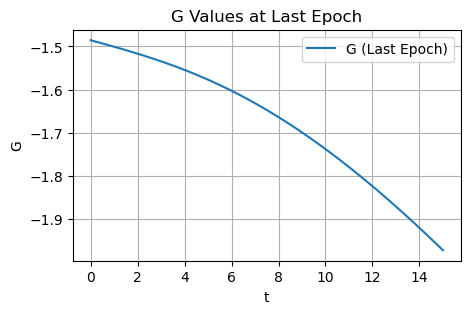

It 00500: loss = 1.05e-01,loss_G = 3.15e+01, alpha21 = 3.3218, alpha22 = 4.0722
Initial Condition: [20.01 0.04 0.04 0.06]


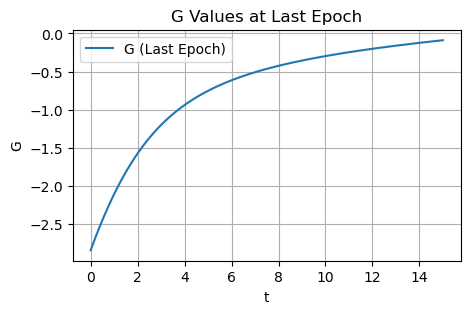

It 01000: loss = 4.68e-02,loss_G = 2.31e+01, alpha21 = 3.0787, alpha22 = 4.1802
Initial Condition: [20.00 0.03 0.01 0.03]


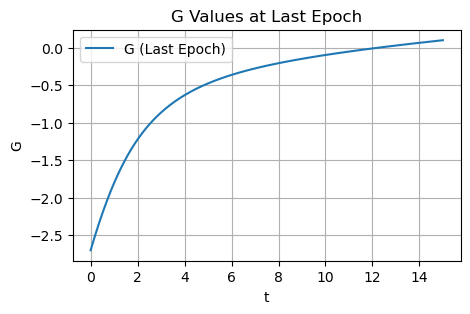

It 01500: loss = 4.18e-01,loss_G = 2.26e+01, alpha21 = 2.9801, alpha22 = 4.2691
Initial Condition: [20.09 0.01 0.04 0.00]


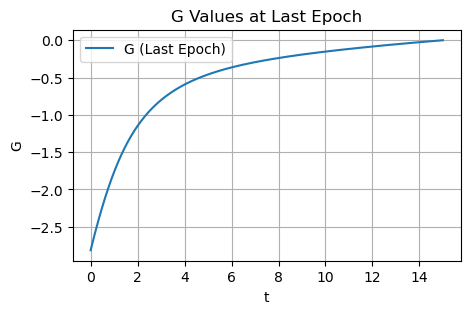

It 02000: loss = 3.97e-02,loss_G = 2.04e+01, alpha21 = 2.9691, alpha22 = 4.3442
Initial Condition: [20.01 0.03 0.02 0.00]


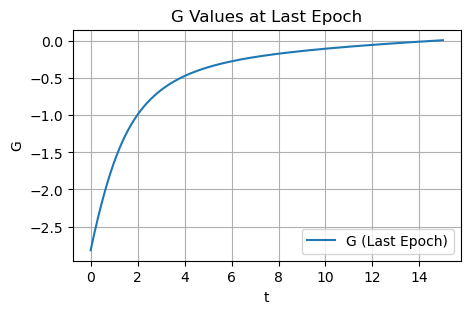

It 02500: loss = 3.35e-02,loss_G = 1.99e+01, alpha21 = 2.9645, alpha22 = 4.4114
Initial Condition: [20.01 0.03 0.01 0.00]


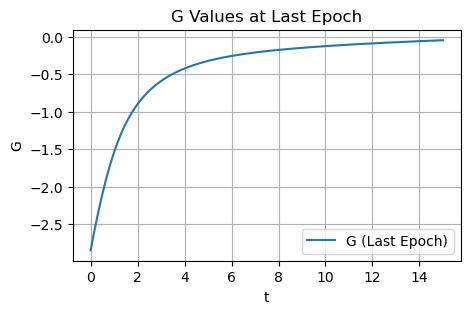

It 03000: loss = 2.18e-02,loss_G = 1.33e+01, alpha21 = 2.9791, alpha22 = 4.4798
Initial Condition: [19.98 0.03 -0.00 0.03]


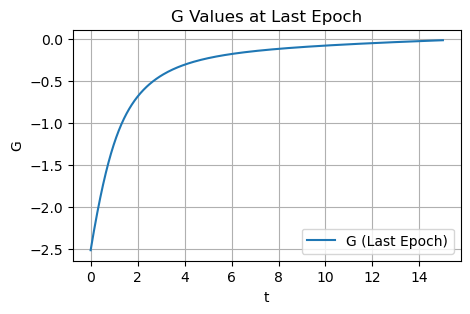

It 03500: loss = 2.21e-02,loss_G = 1.45e+01, alpha21 = 3.0156, alpha22 = 4.5381
Initial Condition: [19.97 0.03 0.00 0.02]


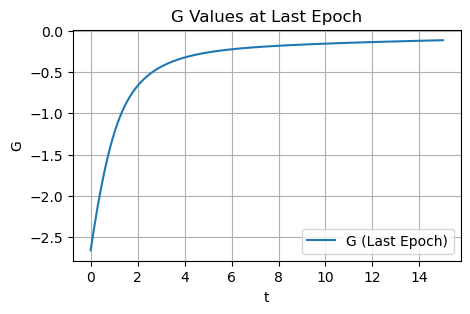

It 04000: loss = 1.99e-01,loss_G = 1.58e+01, alpha21 = 3.0044, alpha22 = 4.5941
Initial Condition: [19.91 0.02 -0.02 0.01]


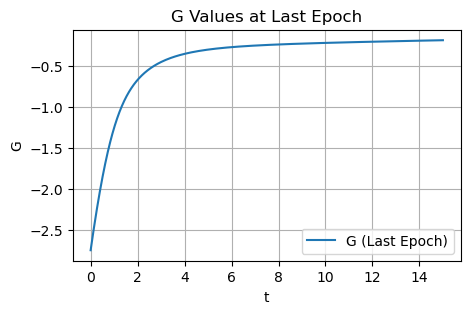

It 04500: loss = 4.84e-01,loss_G = 1.10e+01, alpha21 = 3.0133, alpha22 = 4.6475
Initial Condition: [19.71 0.01 -0.01 0.02]


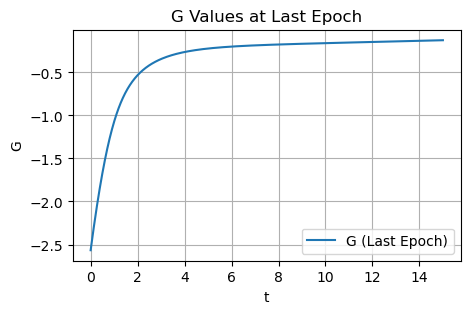

It 05000: loss = 1.17e-01,loss_G = 2.08e+01, alpha21 = 3.0181, alpha22 = 4.6617
Initial Condition: [19.77 0.06 0.04 -0.05]


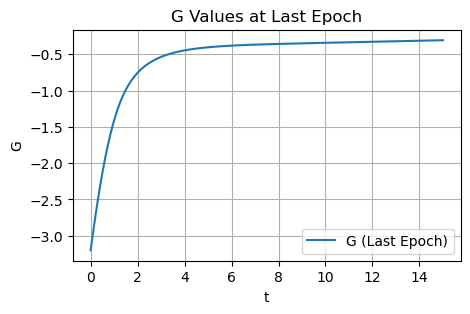

It 05500: loss = 3.68e-02,loss_G = 1.50e+01, alpha21 = 3.0576, alpha22 = 4.6810
Initial Condition: [19.97 0.04 -0.00 0.00]


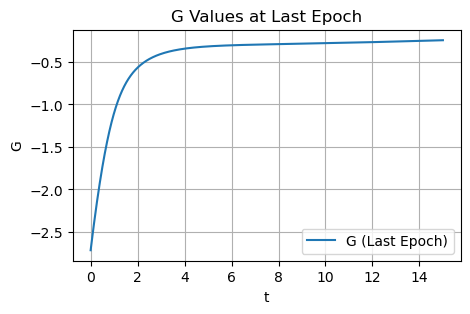

It 06000: loss = 1.57e-02,loss_G = 1.21e+01, alpha21 = 3.0850, alpha22 = 4.7211
Initial Condition: [20.03 0.03 0.00 0.05]


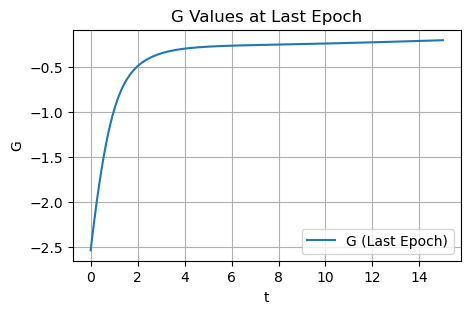

It 06500: loss = 2.55e-01,loss_G = 1.24e+01, alpha21 = 3.0190, alpha22 = 4.7635
Initial Condition: [19.63 0.05 0.02 -0.01]


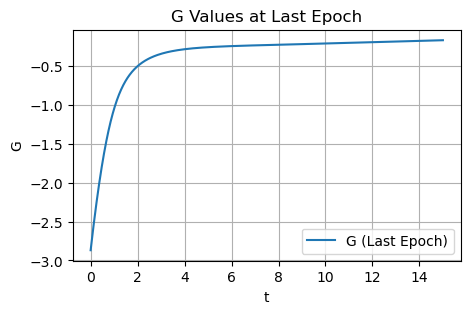

It 07000: loss = 1.65e-02,loss_G = 9.18e+00, alpha21 = 3.0466, alpha22 = 4.7869
Initial Condition: [20.00 0.03 -0.00 0.02]


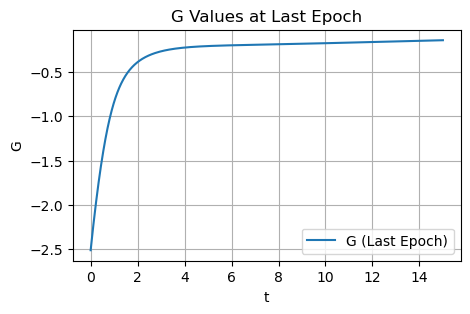

It 07500: loss = 1.37e-02,loss_G = 1.30e+01, alpha21 = 2.9366, alpha22 = 4.4036
Initial Condition: [20.02 0.04 -0.00 0.03]


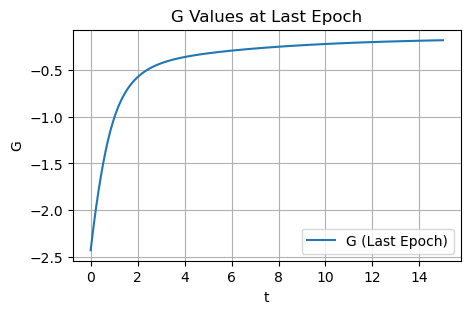

It 08000: loss = 2.73e-02,loss_G = 1.18e+01, alpha21 = 2.9046, alpha22 = 4.5847
Initial Condition: [19.98 0.04 0.03 -0.00]


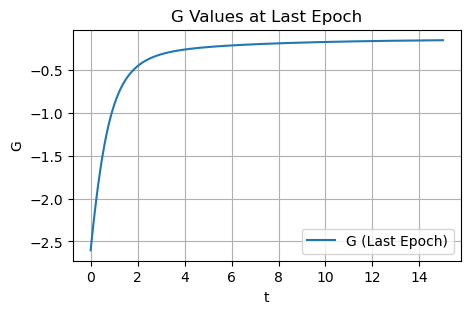

It 08500: loss = 1.46e-02,loss_G = 8.02e+00, alpha21 = 2.9571, alpha22 = 4.7028
Initial Condition: [20.00 0.03 -0.00 0.01]


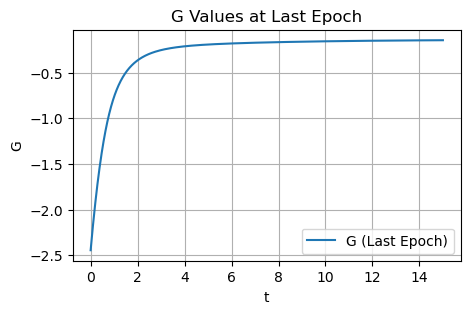

It 09000: loss = 1.83e-01,loss_G = 1.13e+01, alpha21 = 3.0024, alpha22 = 4.8015
Initial Condition: [19.91 0.04 -0.00 -0.02]


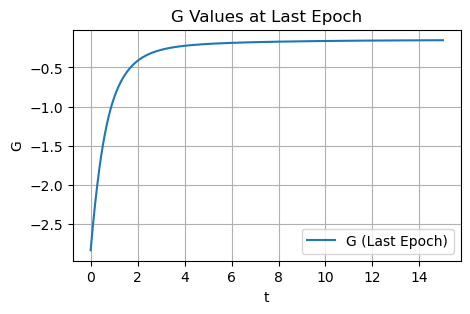

It 09500: loss = 1.53e-01,loss_G = 4.93e+00, alpha21 = 3.0206, alpha22 = 4.8571
Initial Condition: [19.84 0.05 -0.05 -0.02]


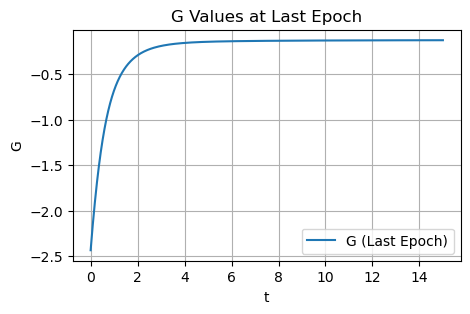

It 10000: loss = 6.20e-03,loss_G = 6.72e+00, alpha21 = 3.0418, alpha22 = 4.8801
Initial Condition: [20.00 0.03 -0.01 0.01]


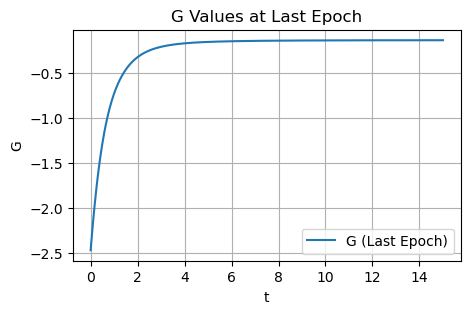

It 10500: loss = 1.25e-01,loss_G = 1.04e+01, alpha21 = 3.0572, alpha22 = 4.8963
Initial Condition: [20.08 0.03 0.01 -0.01]


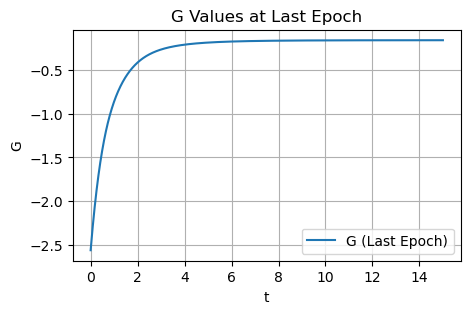

It 11000: loss = 7.43e-03,loss_G = 7.11e+00, alpha21 = 3.0715, alpha22 = 4.9310
Initial Condition: [20.04 0.03 -0.01 0.01]


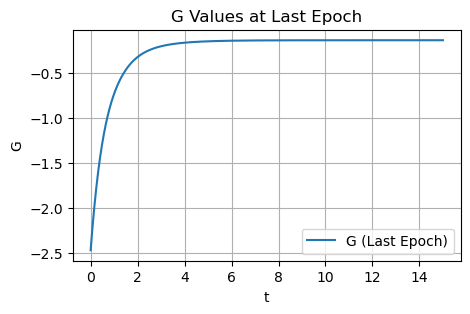

It 11500: loss = 1.42e-02,loss_G = 6.23e+00, alpha21 = 3.0714, alpha22 = 4.9571
Initial Condition: [20.01 0.04 -0.01 -0.00]


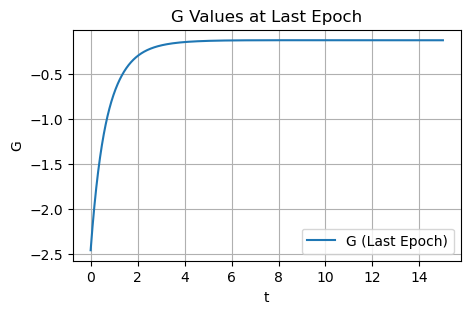

It 12000: loss = 3.50e-02,loss_G = 7.02e+00, alpha21 = 3.0929, alpha22 = 4.9697
Initial Condition: [19.95 0.04 -0.00 0.02]


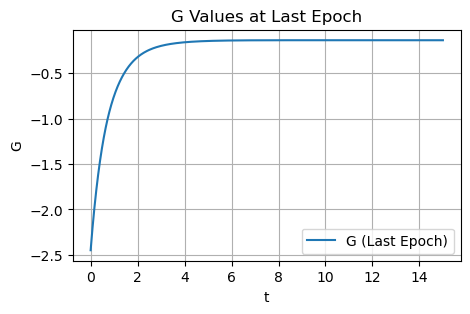

It 12500: loss = 8.85e-03,loss_G = 8.41e+00, alpha21 = 3.0770, alpha22 = 5.0013
Initial Condition: [19.95 0.03 0.01 0.00]


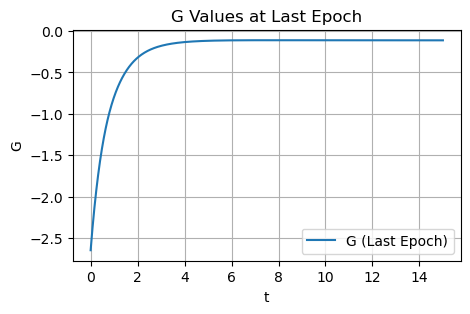

It 13000: loss = 1.56e-02,loss_G = 5.82e+00, alpha21 = 3.1021, alpha22 = 5.0406
Initial Condition: [20.03 0.04 -0.01 0.02]


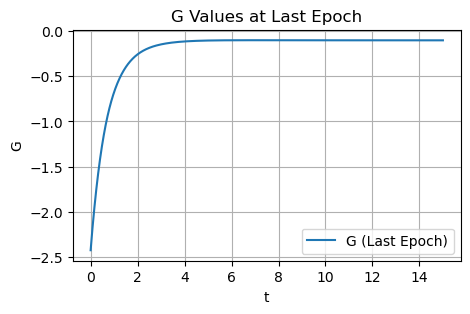

It 13500: loss = 6.30e-03,loss_G = 5.11e+00, alpha21 = 3.1112, alpha22 = 5.0684
Initial Condition: [20.03 0.04 -0.00 0.02]


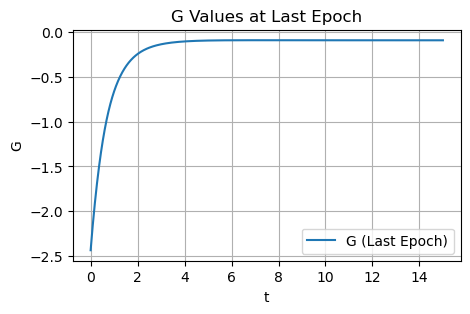

It 14000: loss = 9.71e-03,loss_G = 4.71e+00, alpha21 = 3.1189, alpha22 = 5.0961
Initial Condition: [20.02 0.04 -0.01 0.02]


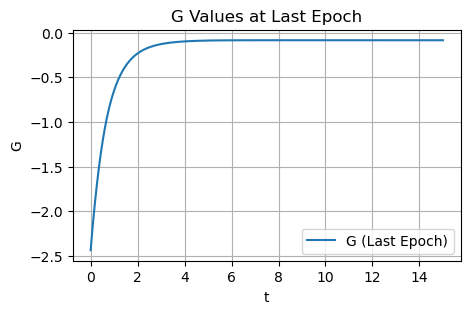

It 14500: loss = 9.29e-02,loss_G = 4.50e+00, alpha21 = 3.1200, alpha22 = 5.1248
Initial Condition: [20.05 0.02 0.00 0.00]


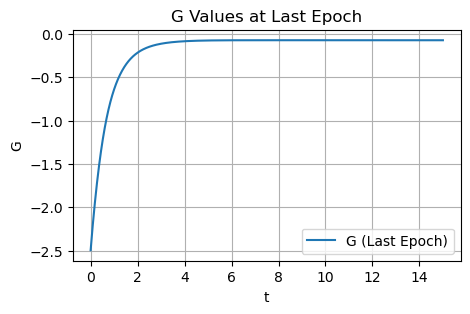

It 15000: loss = 8.92e-03,loss_G = 3.89e+00, alpha21 = 3.1433, alpha22 = 5.1354
Initial Condition: [19.96 0.03 -0.01 -0.00]


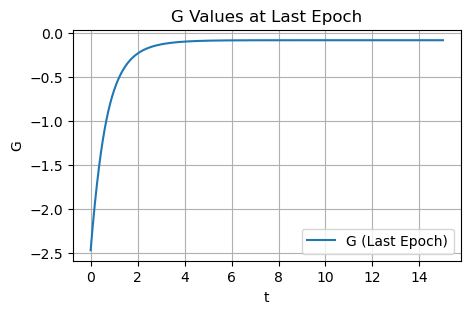

It 15500: loss = 3.31e-03,loss_G = 4.24e+00, alpha21 = 3.1420, alpha22 = 5.1451
Initial Condition: [20.00 0.03 -0.01 0.01]


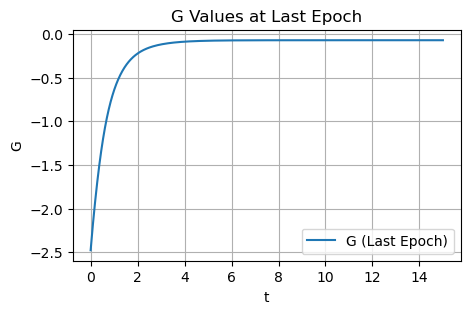

It 16000: loss = 2.87e-03,loss_G = 3.76e+00, alpha21 = 3.1403, alpha22 = 5.1612
Initial Condition: [20.00 0.03 -0.01 0.00]


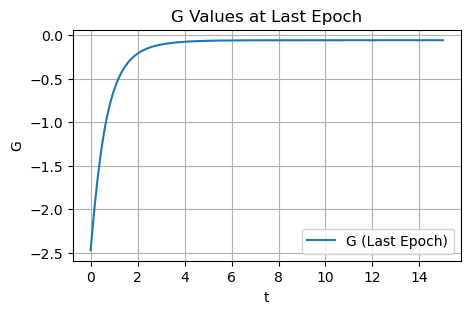

It 16500: loss = 3.55e-03,loss_G = 3.89e+00, alpha21 = 3.1544, alpha22 = 5.1734
Initial Condition: [19.99 0.03 -0.01 0.00]


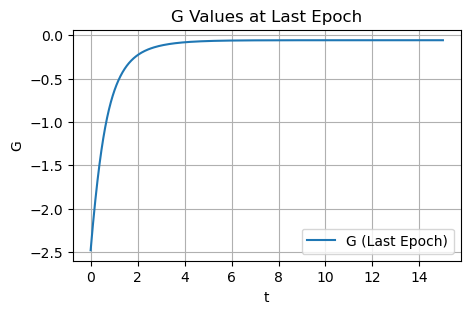

It 17000: loss = 2.88e-03,loss_G = 3.04e+00, alpha21 = 3.1405, alpha22 = 5.1979
Initial Condition: [20.00 0.03 -0.01 0.00]


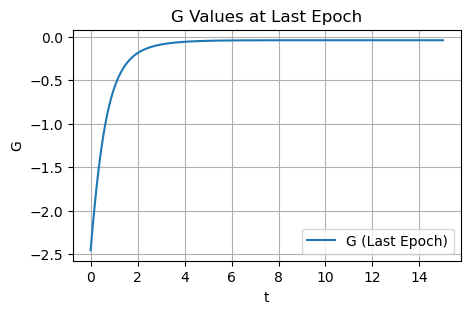

It 17500: loss = 2.64e-03,loss_G = 3.10e+00, alpha21 = 3.1465, alpha22 = 5.2053
Initial Condition: [20.00 0.04 -0.01 0.00]


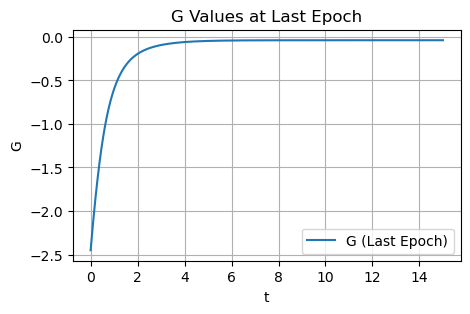

It 18000: loss = 3.05e-02,loss_G = 6.92e+00, alpha21 = 3.1467, alpha22 = 5.2237
Initial Condition: [20.23 0.04 -0.01 -0.08]


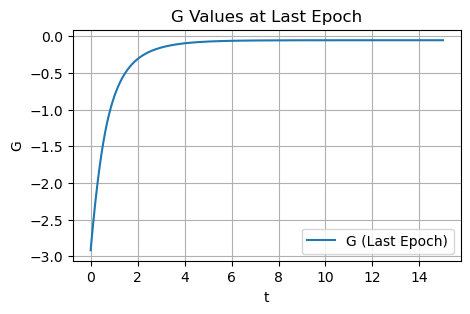

It 18500: loss = 2.61e-03,loss_G = 3.04e+00, alpha21 = 3.1552, alpha22 = 5.2262
Initial Condition: [20.00 0.04 -0.01 0.00]


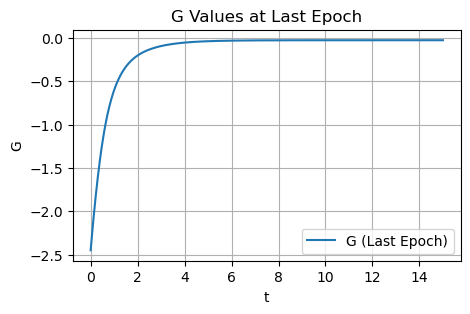

It 19000: loss = 2.53e-03,loss_G = 2.69e+00, alpha21 = 3.1662, alpha22 = 5.2622
Initial Condition: [20.00 0.04 -0.01 0.00]


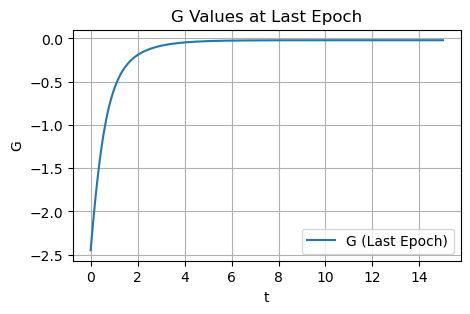

It 19500: loss = 1.27e-02,loss_G = 4.50e+00, alpha21 = 3.1869, alpha22 = 5.2521
Initial Condition: [20.09 0.03 -0.01 0.01]


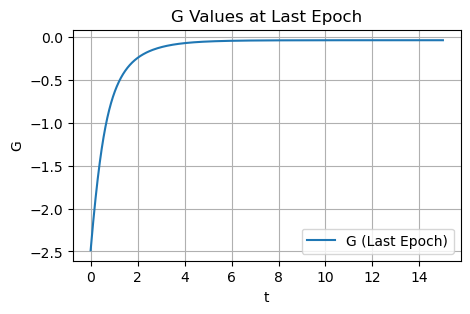

It 20000: loss = 7.85e-03,loss_G = 3.97e+00, alpha21 = 3.1975, alpha22 = 5.2506
Initial Condition: [19.93 0.04 -0.01 0.01]


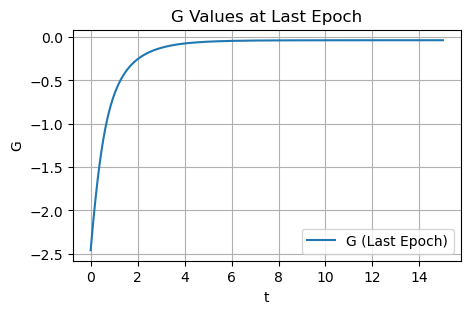

It 20500: loss = 2.52e-03,loss_G = 2.68e+00, alpha21 = 3.1717, alpha22 = 5.2658
Initial Condition: [20.00 0.03 -0.01 0.00]


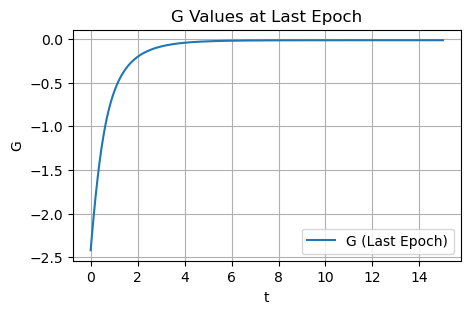

It 21000: loss = 2.79e-03,loss_G = 3.01e+00, alpha21 = 3.1803, alpha22 = 5.2580
Initial Condition: [20.00 0.03 -0.01 0.00]


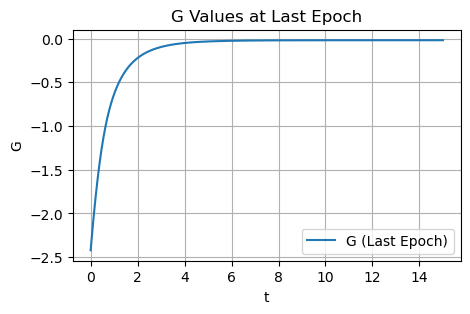

It 21500: loss = 2.42e-03,loss_G = 2.11e+00, alpha21 = 3.1677, alpha22 = 5.2792
Initial Condition: [20.00 0.03 -0.01 0.00]


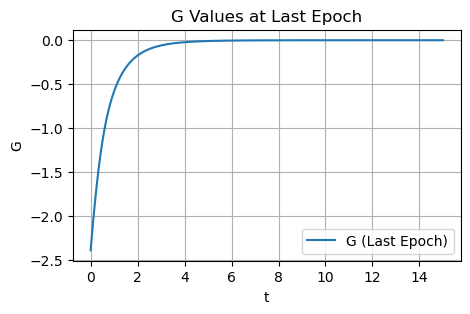

It 22000: loss = 2.46e-03,loss_G = 2.50e+00, alpha21 = 3.1721, alpha22 = 5.2688
Initial Condition: [20.00 0.03 -0.01 0.00]


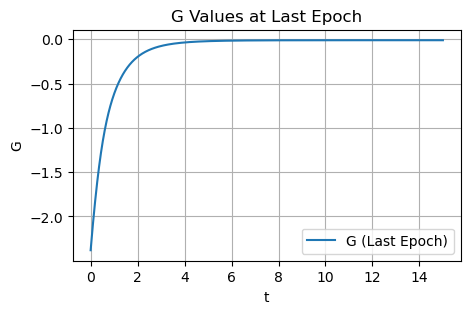

It 22500: loss = 2.50e-03,loss_G = 2.65e+00, alpha21 = 3.1802, alpha22 = 5.2741
Initial Condition: [20.00 0.03 -0.01 0.00]


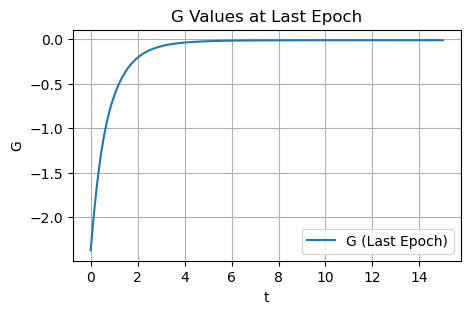

It 23000: loss = 9.74e-02,loss_G = 2.30e+00, alpha21 = 3.1710, alpha22 = 5.2874
Initial Condition: [20.03 0.02 0.00 -0.00]


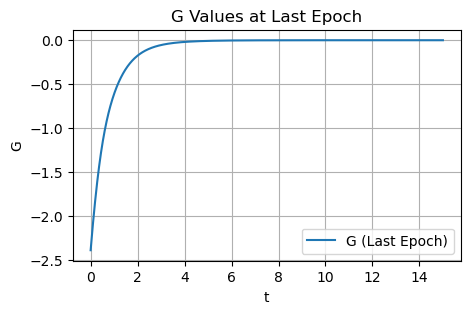

It 23500: loss = 9.16e-03,loss_G = 3.33e+00, alpha21 = 3.1968, alpha22 = 5.2874
Initial Condition: [20.06 0.03 -0.01 -0.01]


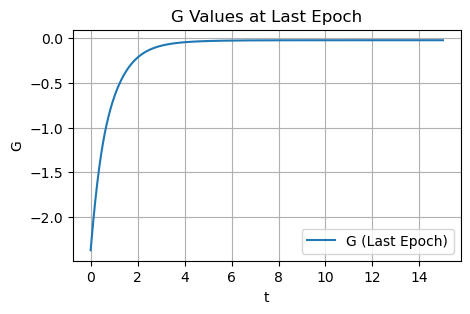

It 24000: loss = 2.70e-02,loss_G = 3.08e+00, alpha21 = 3.1986, alpha22 = 5.2963
Initial Condition: [20.01 0.04 -0.01 -0.01]


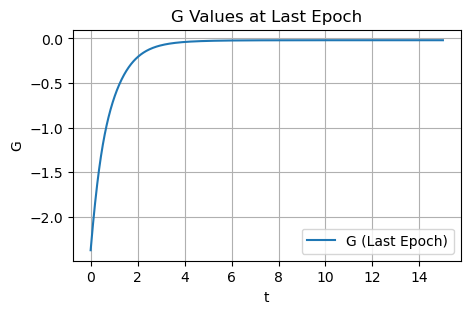

It 24500: loss = 2.46e-03,loss_G = 2.14e+00, alpha21 = 3.1913, alpha22 = 5.3096
Initial Condition: [20.00 0.03 -0.01 0.00]


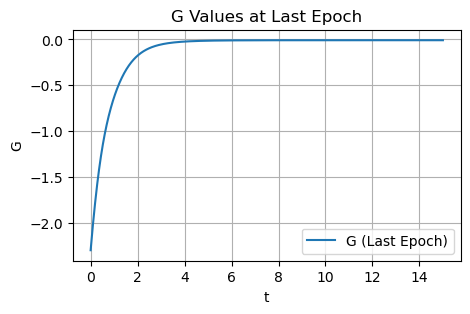

It 25000: loss = 8.73e-03,loss_G = 2.69e+00, alpha21 = 3.2082, alpha22 = 5.3048
Initial Condition: [20.02 0.03 -0.01 -0.01]


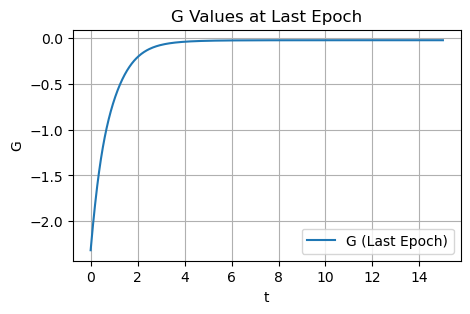

It 25500: loss = 2.81e-03,loss_G = 2.34e+00, alpha21 = 3.2008, alpha22 = 5.3190
Initial Condition: [20.00 0.03 -0.01 0.00]


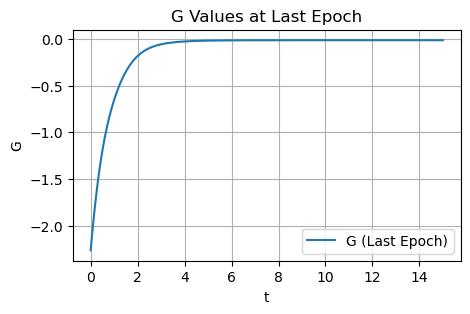

It 26000: loss = 2.96e-03,loss_G = 2.23e+00, alpha21 = 3.2044, alpha22 = 5.3283
Initial Condition: [20.01 0.03 -0.00 0.00]


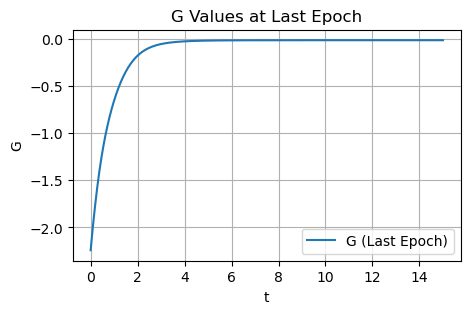

It 26500: loss = 3.08e-03,loss_G = 2.34e+00, alpha21 = 3.2140, alpha22 = 5.3393
Initial Condition: [20.00 0.03 -0.01 0.00]


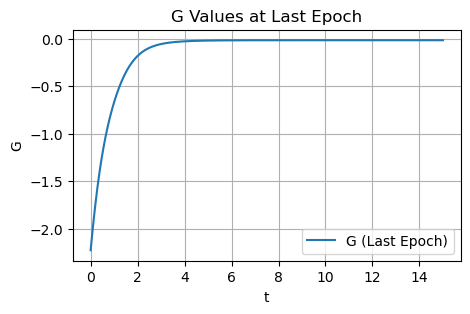

It 27000: loss = 3.41e-02,loss_G = 2.58e+00, alpha21 = 3.2050, alpha22 = 5.3567
Initial Condition: [20.01 0.04 -0.00 0.03]


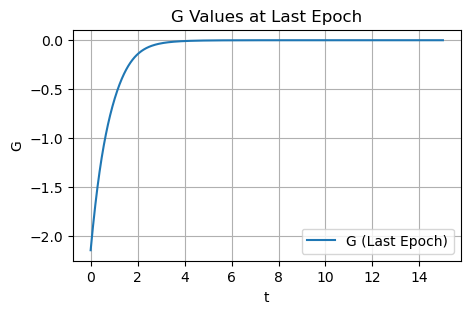

It 27500: loss = 3.65e-03,loss_G = 2.45e+00, alpha21 = 3.2237, alpha22 = 5.3470
Initial Condition: [20.02 0.03 -0.00 0.00]


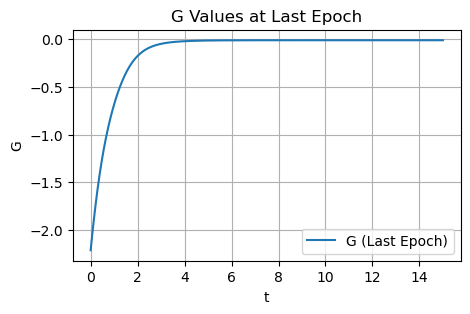

It 28000: loss = 1.06e-02,loss_G = 2.59e+00, alpha21 = 3.2208, alpha22 = 5.3685
Initial Condition: [19.98 0.03 -0.01 -0.01]


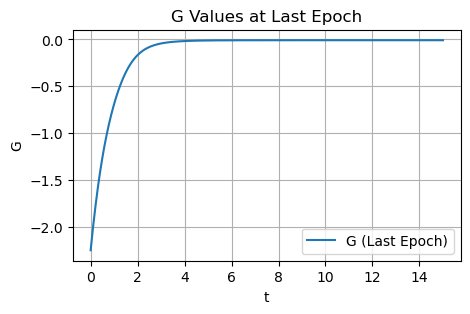

It 28500: loss = 1.53e-02,loss_G = 2.24e+00, alpha21 = 3.2302, alpha22 = 5.3856
Initial Condition: [19.95 0.03 0.00 0.00]


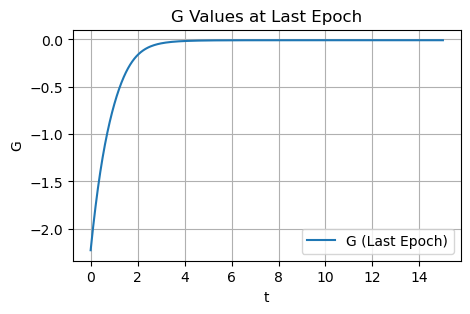

It 29000: loss = 2.36e-03,loss_G = 2.79e+00, alpha21 = 3.2435, alpha22 = 5.3714
Initial Condition: [20.01 0.03 -0.00 0.00]


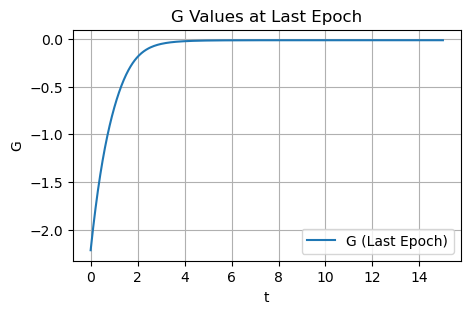

It 29500: loss = 4.26e-03,loss_G = 2.50e+00, alpha21 = 3.2582, alpha22 = 5.4156
Initial Condition: [20.02 0.03 -0.01 -0.00]


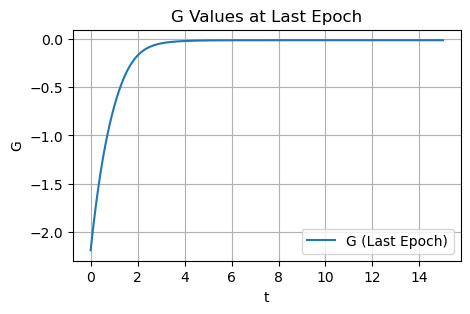

It 30000: loss = 1.35e-02,loss_G = 2.69e+00, alpha21 = 3.2655, alpha22 = 5.4334
Initial Condition: [20.03 0.03 -0.00 -0.00]


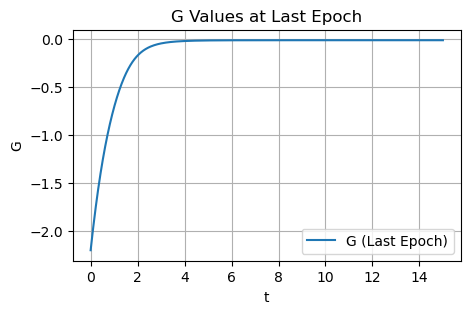

It 30500: loss = 5.28e-03,loss_G = 2.66e+00, alpha21 = 3.2795, alpha22 = 5.4584
Initial Condition: [20.01 0.02 0.00 0.01]


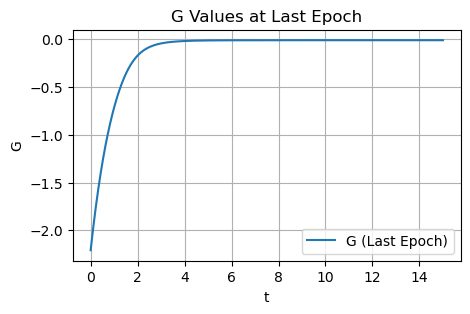

It 31000: loss = 1.53e-03,loss_G = 1.55e+00, alpha21 = 3.2785, alpha22 = 5.4800
Initial Condition: [20.00 0.02 -0.00 0.00]


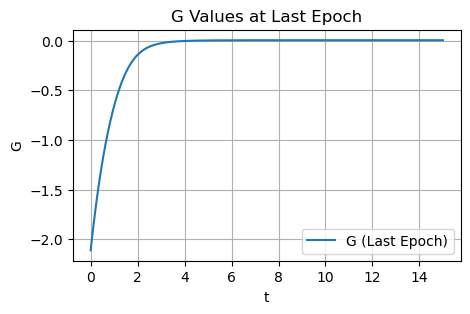

It 31500: loss = 2.85e-03,loss_G = 3.18e+00, alpha21 = 3.3065, alpha22 = 5.4921
Initial Condition: [20.05 0.02 -0.00 0.00]


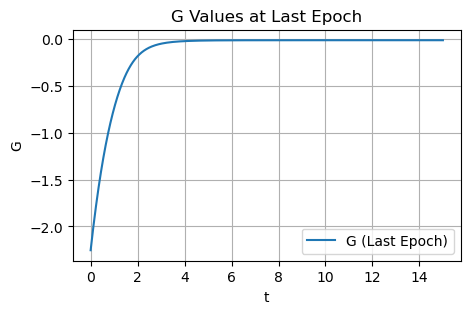

It 32000: loss = 1.17e-01,loss_G = 1.68e+00, alpha21 = 3.2932, alpha22 = 5.5233
Initial Condition: [20.04 0.00 0.01 -0.01]


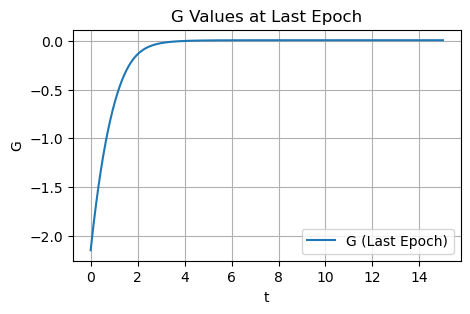

It 32500: loss = 1.10e-03,loss_G = 1.28e+00, alpha21 = 3.3055, alpha22 = 5.5421
Initial Condition: [20.00 0.01 -0.00 0.00]


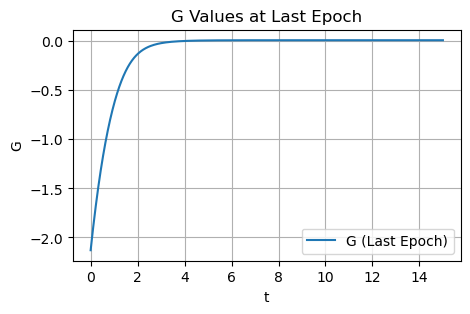

It 33000: loss = 1.06e-03,loss_G = 1.33e+00, alpha21 = 3.3135, alpha22 = 5.5554
Initial Condition: [20.00 0.01 -0.00 0.00]


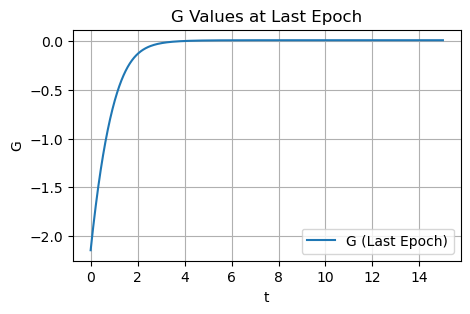

It 33500: loss = 1.05e-03,loss_G = 1.52e+00, alpha21 = 3.3264, alpha22 = 5.5723
Initial Condition: [20.00 0.01 -0.00 0.00]


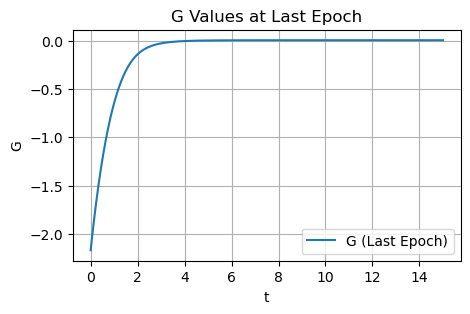

It 34000: loss = 7.95e-03,loss_G = 3.14e+00, alpha21 = 3.3450, alpha22 = 5.5827
Initial Condition: [19.99 0.01 0.00 0.02]


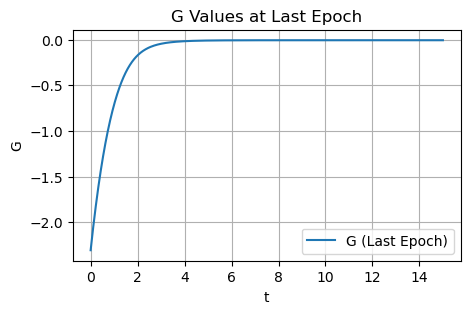

It 34500: loss = 1.32e-03,loss_G = 1.19e+00, alpha21 = 3.3347, alpha22 = 5.6023
Initial Condition: [20.00 0.00 0.00 0.00]


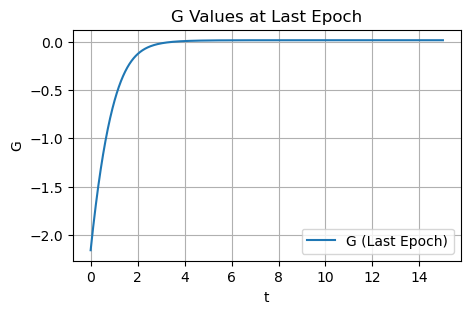

It 35000: loss = 9.86e-04,loss_G = 1.47e+00, alpha21 = 3.3480, alpha22 = 5.6155
Initial Condition: [20.00 0.01 -0.00 0.00]


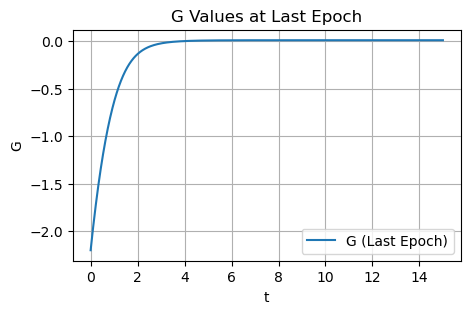

It 35500: loss = 1.91e-03,loss_G = 2.48e+00, alpha21 = 3.3651, alpha22 = 5.6099
Initial Condition: [20.01 0.01 -0.00 -0.00]


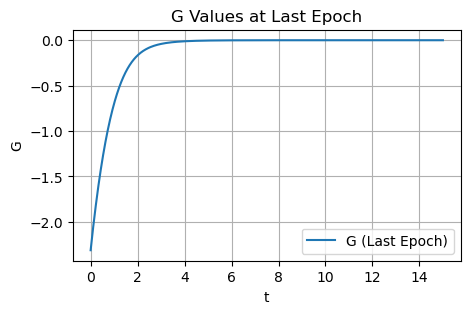

It 36000: loss = 1.10e-03,loss_G = 1.84e+00, alpha21 = 3.3657, alpha22 = 5.6314
Initial Condition: [20.00 0.01 -0.00 0.00]


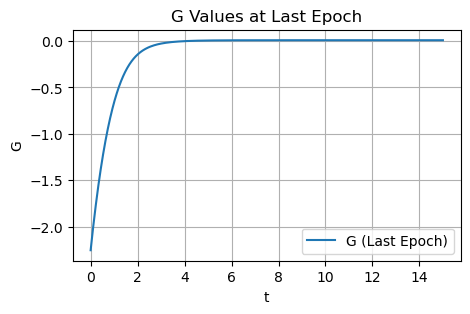

It 36500: loss = 1.48e-03,loss_G = 2.23e+00, alpha21 = 3.3701, alpha22 = 5.6384
Initial Condition: [20.00 0.01 -0.00 0.00]


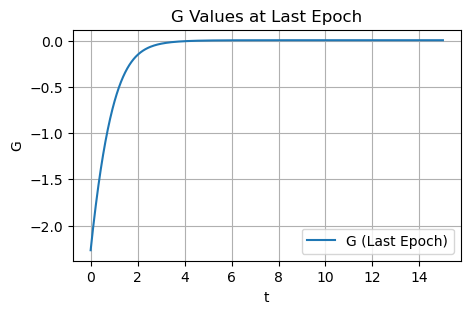

It 37000: loss = 1.00e-03,loss_G = 1.81e+00, alpha21 = 3.3711, alpha22 = 5.6429
Initial Condition: [20.00 0.01 -0.00 0.00]


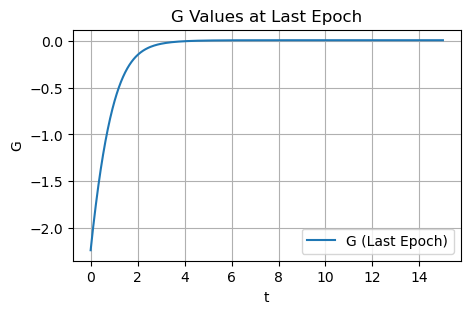

It 37500: loss = 9.52e-04,loss_G = 1.46e+00, alpha21 = 3.3703, alpha22 = 5.6576
Initial Condition: [20.00 0.00 -0.00 0.00]


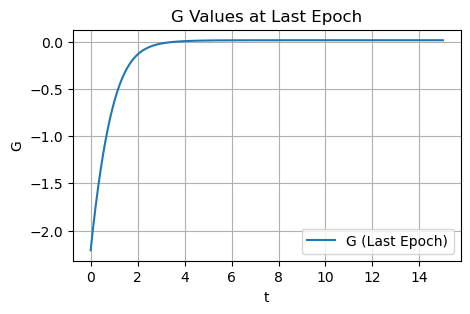

It 38000: loss = 2.44e-03,loss_G = 2.52e+00, alpha21 = 3.3867, alpha22 = 5.6566
Initial Condition: [20.01 0.01 -0.00 0.00]


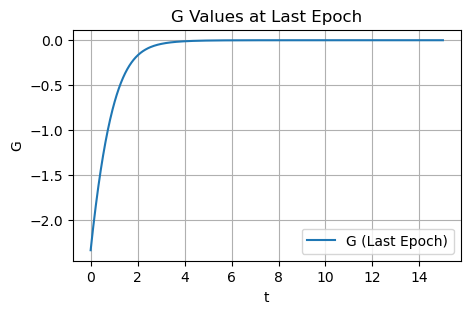

It 38500: loss = 1.96e-02,loss_G = 2.82e+00, alpha21 = 3.3838, alpha22 = 5.6637
Initial Condition: [20.06 0.00 0.00 -0.00]


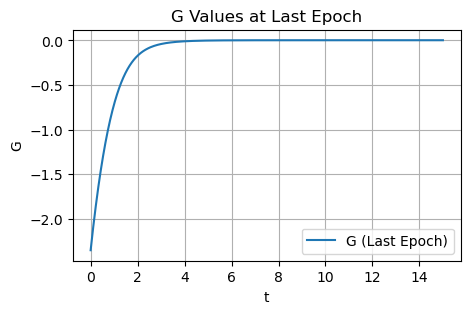

It 39000: loss = 6.79e-03,loss_G = 2.22e+00, alpha21 = 3.3844, alpha22 = 5.6711
Initial Condition: [20.01 0.00 -0.00 -0.00]


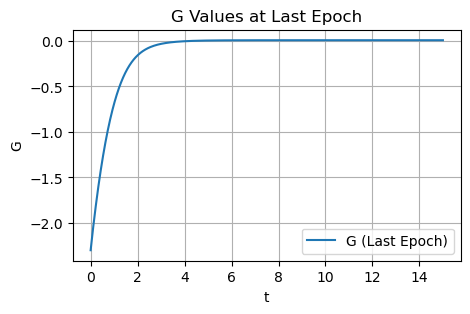

It 39500: loss = 9.60e-04,loss_G = 1.31e+00, alpha21 = 3.3792, alpha22 = 5.6809
Initial Condition: [20.00 0.00 0.00 0.00]


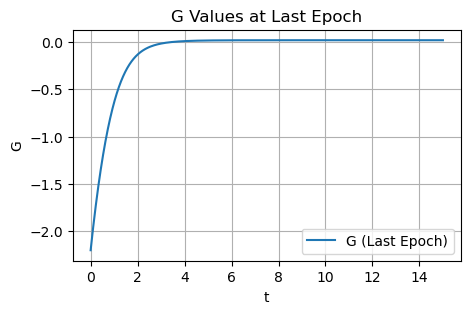

It 40000: loss = 9.60e-04,loss_G = 1.52e+00, alpha21 = 3.3853, alpha22 = 5.6821
Initial Condition: [20.00 0.00 -0.00 0.00]


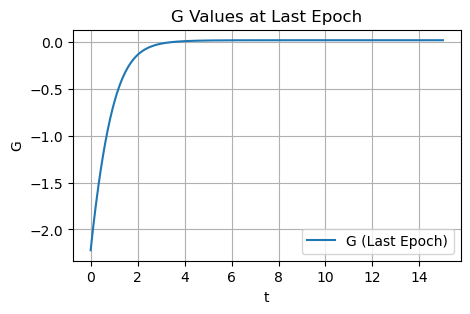

It 40500: loss = 9.64e-04,loss_G = 1.66e+00, alpha21 = 3.3892, alpha22 = 5.6860
Initial Condition: [20.00 0.00 -0.00 0.00]


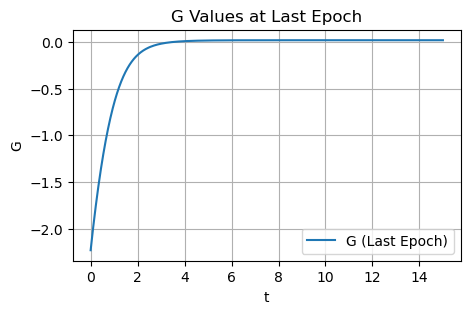

It 41000: loss = 1.47e-02,loss_G = 1.26e+00, alpha21 = 3.3840, alpha22 = 5.6920
Initial Condition: [20.02 -0.00 0.00 -0.00]


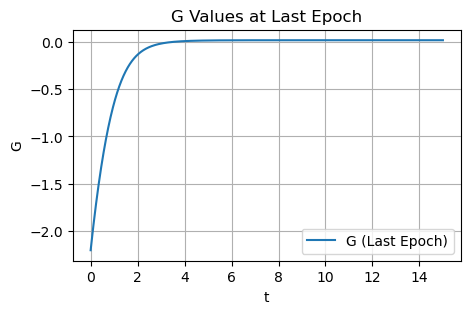

It 41500: loss = 2.43e-02,loss_G = 2.29e+00, alpha21 = 3.3919, alpha22 = 5.6903
Initial Condition: [20.04 0.00 0.00 -0.00]


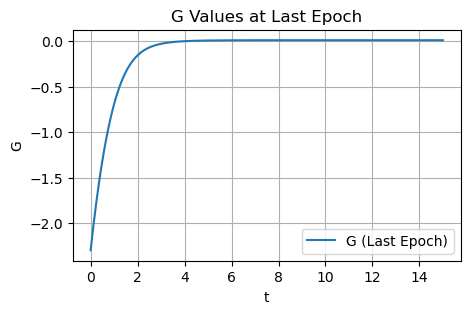

It 42000: loss = 1.07e-03,loss_G = 1.87e+00, alpha21 = 3.3958, alpha22 = 5.6926
Initial Condition: [20.00 0.00 0.00 0.00]


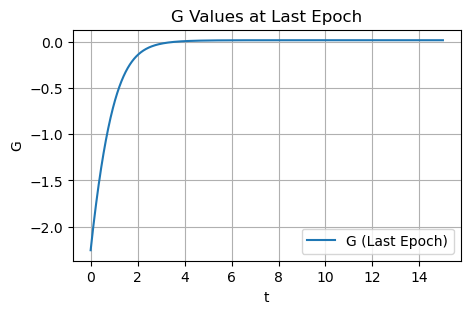

It 42500: loss = 1.24e-03,loss_G = 1.26e+00, alpha21 = 3.3886, alpha22 = 5.7016
Initial Condition: [20.00 0.00 -0.00 0.00]


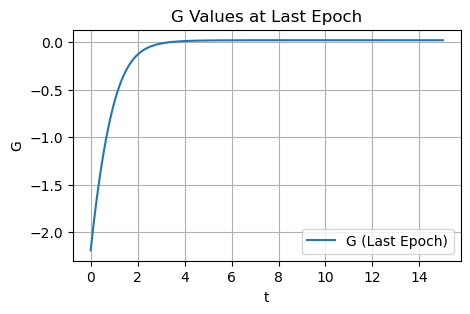

It 43000: loss = 2.26e-02,loss_G = 1.94e+00, alpha21 = 3.3934, alpha22 = 5.6997
Initial Condition: [19.95 0.01 -0.01 0.00]


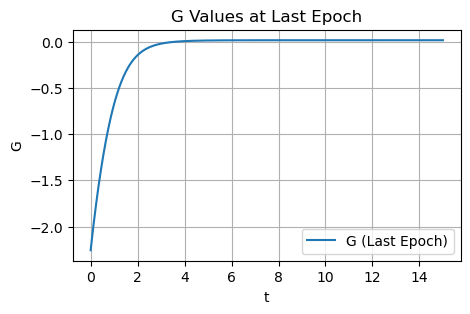

It 43500: loss = 6.63e-03,loss_G = 2.36e+00, alpha21 = 3.3991, alpha22 = 5.6998
Initial Condition: [20.02 0.00 0.00 0.00]


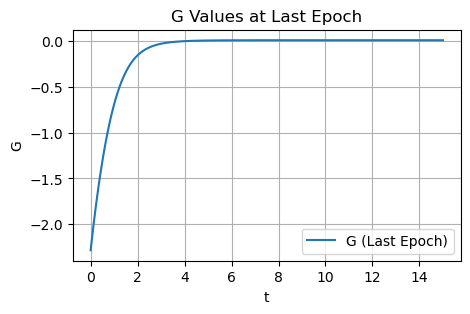

It 44000: loss = 9.54e-04,loss_G = 1.49e+00, alpha21 = 3.3955, alpha22 = 5.7025
Initial Condition: [20.00 0.00 0.00 0.00]


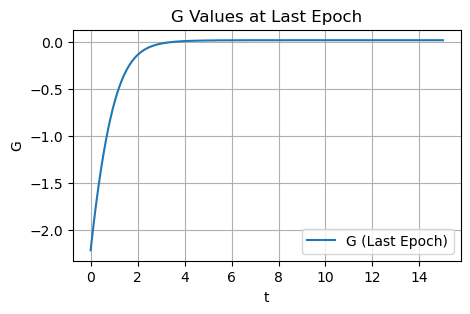

It 44500: loss = 9.25e-04,loss_G = 1.23e+00, alpha21 = 3.3918, alpha22 = 5.7071
Initial Condition: [20.00 0.00 -0.00 0.00]


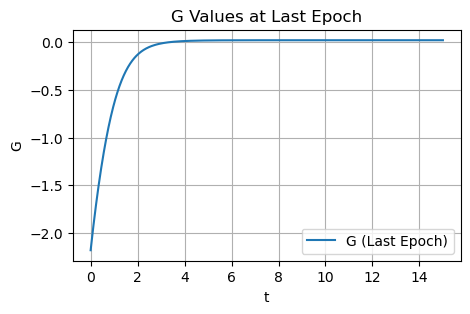

It 45000: loss = 7.50e-03,loss_G = 1.98e+00, alpha21 = 3.4018, alpha22 = 5.7012
Initial Condition: [20.01 0.00 0.00 -0.00]


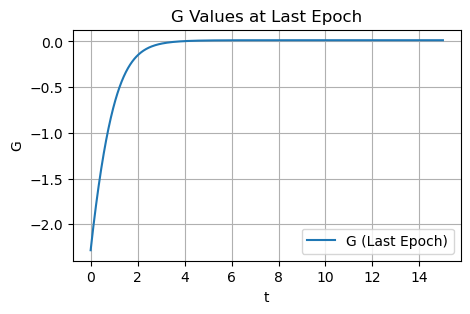

It 45500: loss = 9.63e-04,loss_G = 1.50e+00, alpha21 = 3.3972, alpha22 = 5.7041
Initial Condition: [20.00 0.00 0.00 0.00]


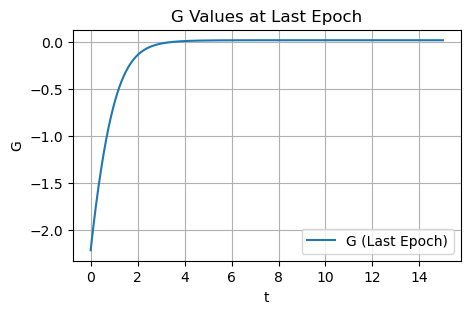

It 46000: loss = 9.09e-04,loss_G = 1.22e+00, alpha21 = 3.3920, alpha22 = 5.7075
Initial Condition: [20.00 0.00 0.00 0.00]


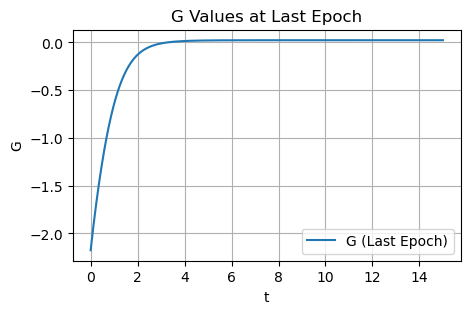

It 46500: loss = 6.13e-03,loss_G = 2.31e+00, alpha21 = 3.4030, alpha22 = 5.6892
Initial Condition: [20.01 0.00 -0.00 0.00]


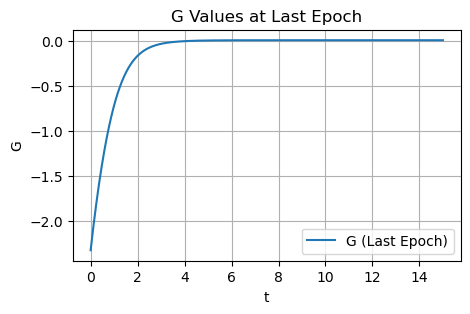

It 47000: loss = 9.23e-04,loss_G = 1.52e+00, alpha21 = 3.3948, alpha22 = 5.7012
Initial Condition: [20.00 0.00 -0.00 0.00]


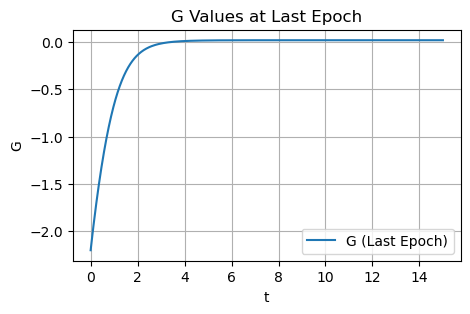

It 47500: loss = 1.12e-03,loss_G = 1.69e+00, alpha21 = 3.3962, alpha22 = 5.6998
Initial Condition: [20.00 0.00 0.00 0.00]


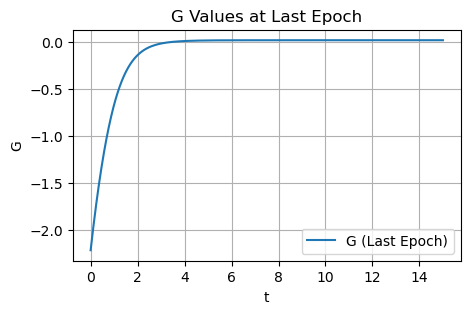

It 48000: loss = 9.79e-04,loss_G = 1.53e+00, alpha21 = 3.3936, alpha22 = 5.7003
Initial Condition: [20.00 0.00 -0.00 0.00]


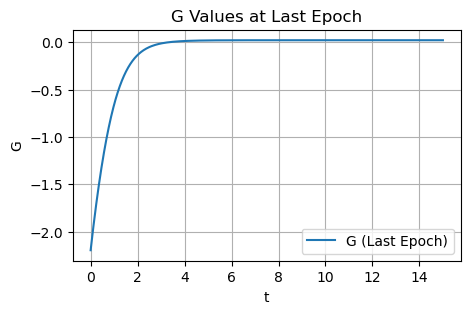

It 48500: loss = 9.11e-04,loss_G = 1.27e+00, alpha21 = 3.3902, alpha22 = 5.7011
Initial Condition: [20.00 0.00 0.00 0.00]


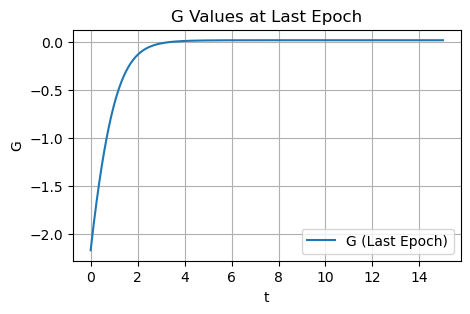

It 49000: loss = 9.05e-04,loss_G = 1.24e+00, alpha21 = 3.3883, alpha22 = 5.6992
Initial Condition: [20.00 0.00 0.00 0.00]


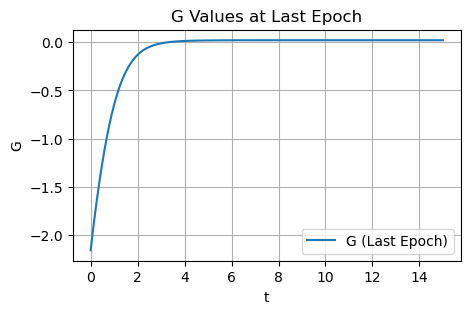

It 49500: loss = 9.03e-04,loss_G = 1.15e+00, alpha21 = 3.3857, alpha22 = 5.6968
Initial Condition: [20.00 0.00 0.00 0.00]


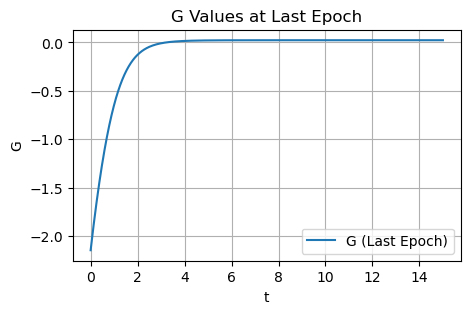

It 50000: loss = 9.01e-04,loss_G = 1.15e+00, alpha21 = 3.3833, alpha22 = 5.6924
Initial Condition: [20.00 0.00 0.00 0.00]


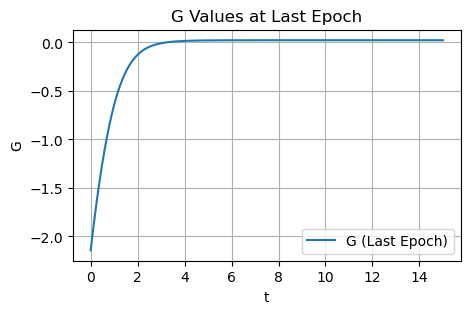

It 50500: loss = 9.03e-04,loss_G = 1.21e+00, alpha21 = 3.3814, alpha22 = 5.6866
Initial Condition: [20.00 0.00 0.00 0.00]


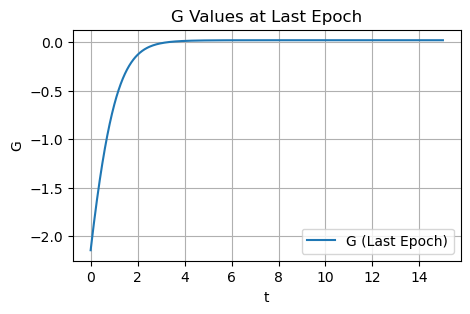

It 51000: loss = 3.48e-03,loss_G = 1.35e+00, alpha21 = 3.3849, alpha22 = 5.6761
Initial Condition: [20.00 0.00 -0.00 0.00]


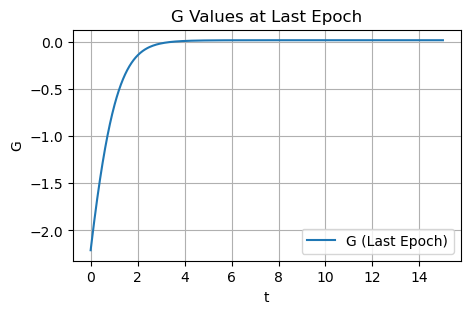

It 51500: loss = 9.03e-04,loss_G = 1.11e+00, alpha21 = 3.3745, alpha22 = 5.6768
Initial Condition: [20.00 0.00 0.00 0.00]


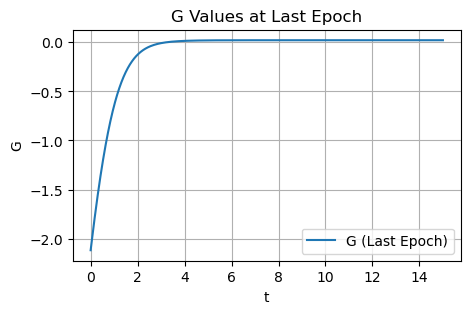

It 52000: loss = 9.72e-04,loss_G = 1.09e+00, alpha21 = 3.3708, alpha22 = 5.6706
Initial Condition: [20.00 0.00 -0.00 0.00]


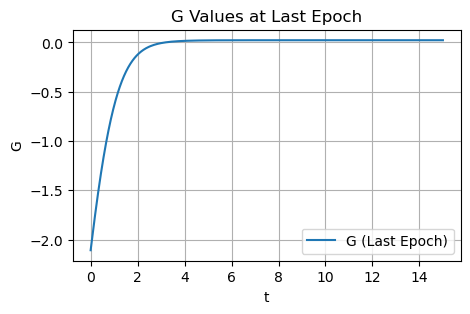

It 52500: loss = 8.99e-04,loss_G = 1.15e+00, alpha21 = 3.3679, alpha22 = 5.6628
Initial Condition: [20.00 0.00 0.00 0.00]


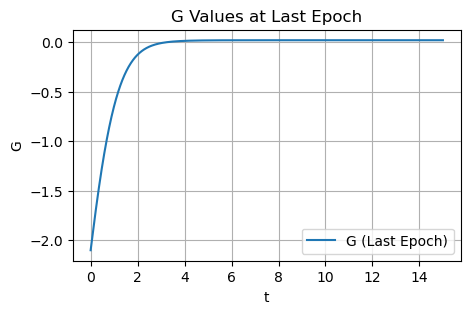

It 53000: loss = 9.20e-04,loss_G = 1.28e+00, alpha21 = 3.3653, alpha22 = 5.6544
Initial Condition: [20.00 0.00 -0.00 0.00]


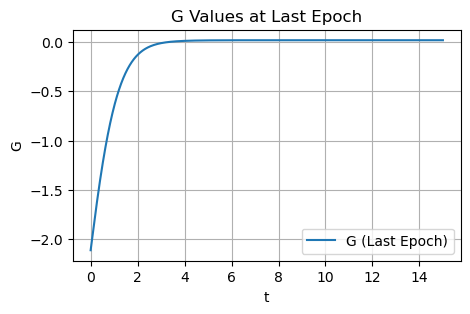

It 53500: loss = 3.41e-03,loss_G = 2.08e+00, alpha21 = 3.3658, alpha22 = 5.6411
Initial Condition: [20.01 -0.00 0.00 -0.00]


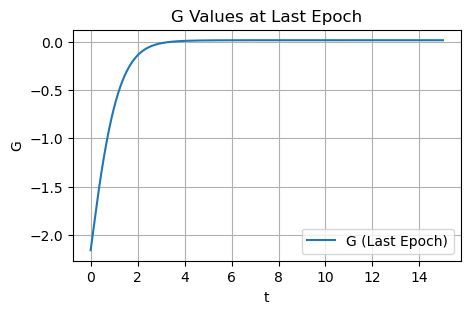

It 54000: loss = 7.94e-03,loss_G = 1.74e+00, alpha21 = 3.3583, alpha22 = 5.6342
Initial Condition: [20.03 -0.00 0.00 -0.00]


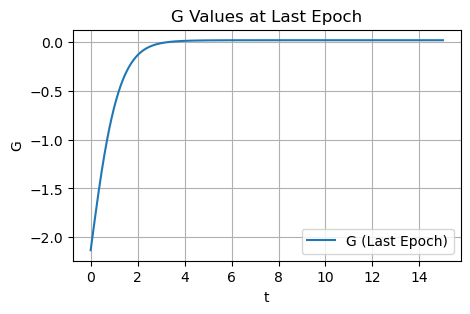

It 54500: loss = 3.24e-02,loss_G = 1.30e+00, alpha21 = 3.3490, alpha22 = 5.6250
Initial Condition: [20.03 -0.00 0.01 -0.01]


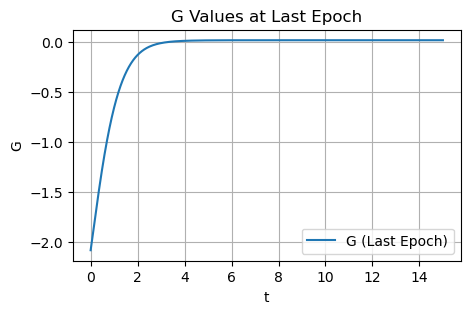

It 55000: loss = 8.93e-04,loss_G = 1.04e+00, alpha21 = 3.3448, alpha22 = 5.6224
Initial Condition: [20.00 0.00 0.00 0.00]


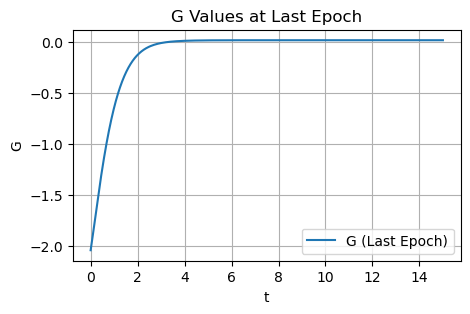

It 55500: loss = 8.93e-04,loss_G = 1.08e+00, alpha21 = 3.3402, alpha22 = 5.6124
Initial Condition: [20.00 0.00 0.00 0.00]


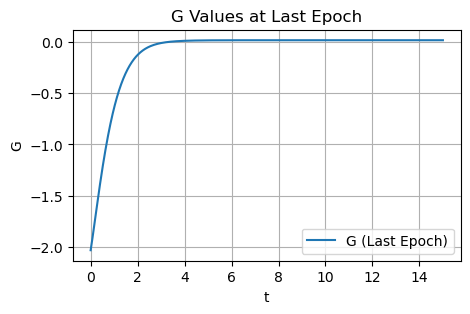

It 56000: loss = 8.91e-04,loss_G = 1.03e+00, alpha21 = 3.3349, alpha22 = 5.6036
Initial Condition: [20.00 0.00 0.00 0.00]


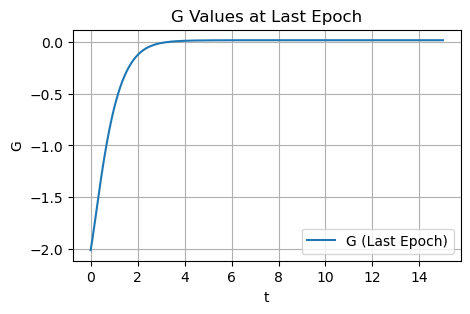

It 56500: loss = 9.46e-04,loss_G = 1.32e+00, alpha21 = 3.3356, alpha22 = 5.5934
Initial Condition: [20.00 0.00 0.00 0.00]


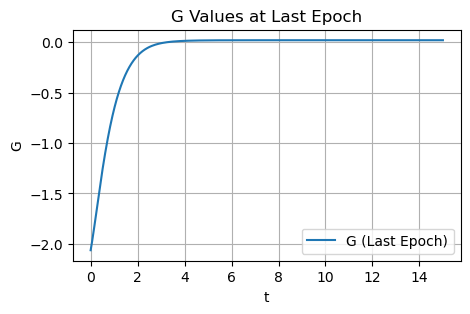

It 57000: loss = 3.50e-02,loss_G = 1.19e+00, alpha21 = 3.3236, alpha22 = 5.5865
Initial Condition: [19.95 0.01 -0.01 0.01]


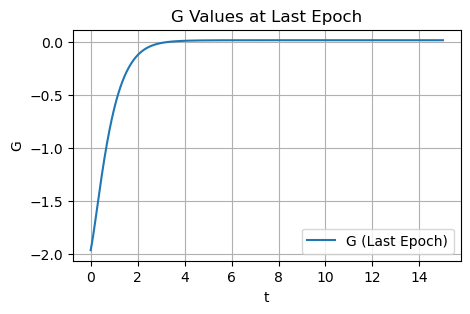

It 57500: loss = 8.90e-04,loss_G = 1.03e+00, alpha21 = 3.3205, alpha22 = 5.5763
Initial Condition: [20.00 0.00 0.00 0.00]


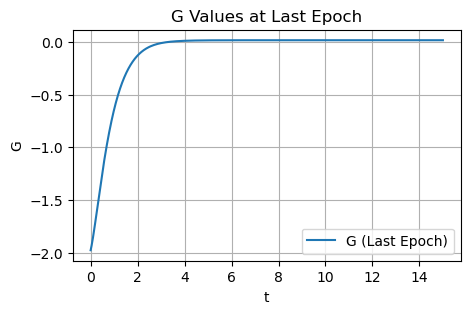

It 58000: loss = 9.14e-04,loss_G = 1.01e+00, alpha21 = 3.3166, alpha22 = 5.5682
Initial Condition: [20.00 0.00 -0.00 0.00]


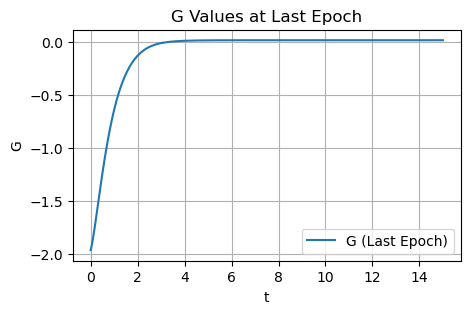

It 58500: loss = 8.86e-04,loss_G = 9.76e-01, alpha21 = 3.3095, alpha22 = 5.5568
Initial Condition: [20.00 0.00 0.00 0.00]


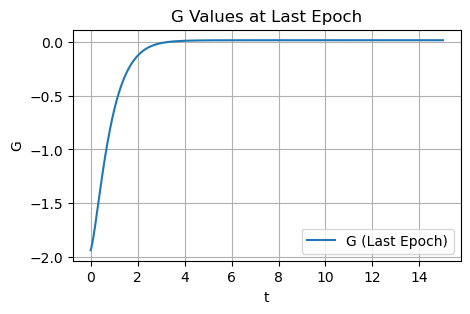

It 59000: loss = 6.07e-03,loss_G = 9.14e-01, alpha21 = 3.3051, alpha22 = 5.5471
Initial Condition: [20.02 -0.00 0.00 -0.00]


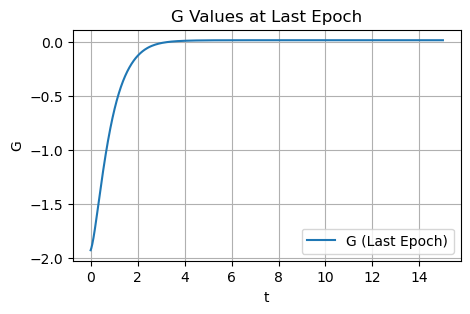

It 59500: loss = 6.11e-03,loss_G = 8.54e-01, alpha21 = 3.2998, alpha22 = 5.5378
Initial Condition: [20.02 -0.00 0.00 -0.00]


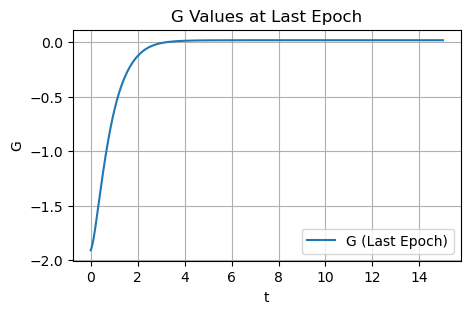

It 60000: loss = 1.03e-03,loss_G = 1.11e+00, alpha21 = 3.2960, alpha22 = 5.5295
Initial Condition: [20.00 0.00 0.00 0.00]


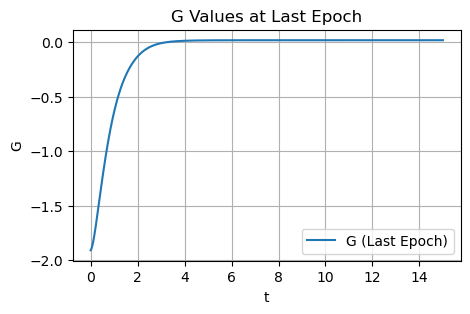

It 60500: loss = 9.77e-04,loss_G = 9.69e-01, alpha21 = 3.2906, alpha22 = 5.5192
Initial Condition: [20.00 0.00 0.00 -0.00]


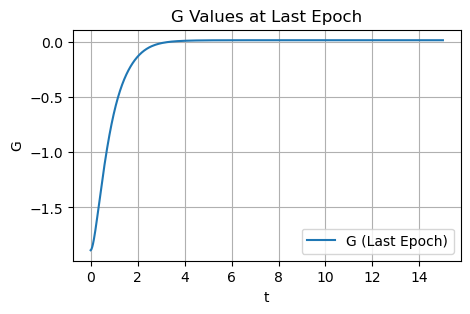

It 61000: loss = 8.20e-03,loss_G = 9.46e-01, alpha21 = 3.2845, alpha22 = 5.5092
Initial Condition: [19.99 0.00 -0.00 0.00]


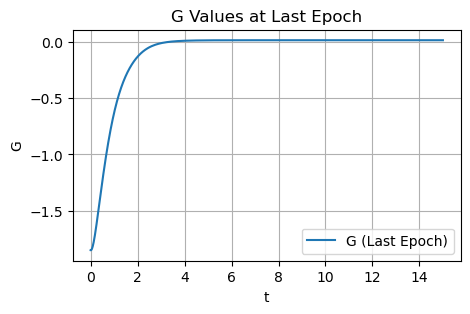

It 61500: loss = 9.48e-04,loss_G = 8.43e-01, alpha21 = 3.2792, alpha22 = 5.5034
Initial Condition: [20.00 0.00 -0.00 0.00]


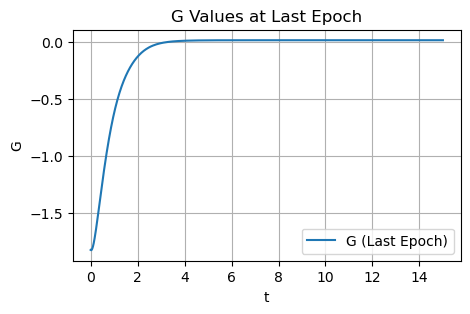

It 62000: loss = 8.76e-04,loss_G = 8.66e-01, alpha21 = 3.2744, alpha22 = 5.4936
Initial Condition: [20.00 0.00 0.00 0.00]


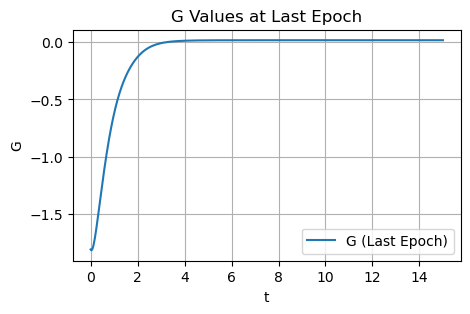

It 62500: loss = 8.76e-04,loss_G = 8.44e-01, alpha21 = 3.2700, alpha22 = 5.4853
Initial Condition: [20.00 0.00 0.00 0.00]


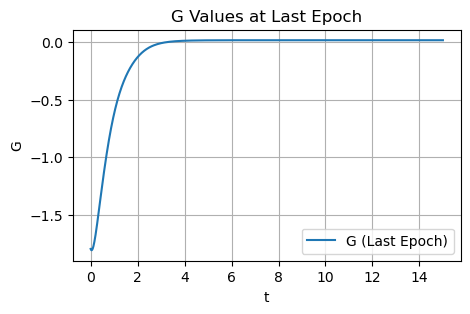

It 63000: loss = 7.75e-03,loss_G = 1.04e+00, alpha21 = 3.2667, alpha22 = 5.4752
Initial Condition: [19.98 0.00 -0.00 0.00]


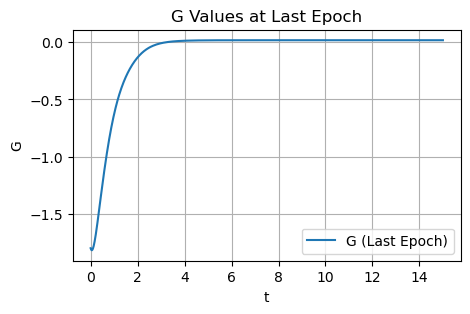

It 63500: loss = 8.90e-04,loss_G = 7.95e-01, alpha21 = 3.2604, alpha22 = 5.4694
Initial Condition: [20.00 0.00 0.00 0.00]


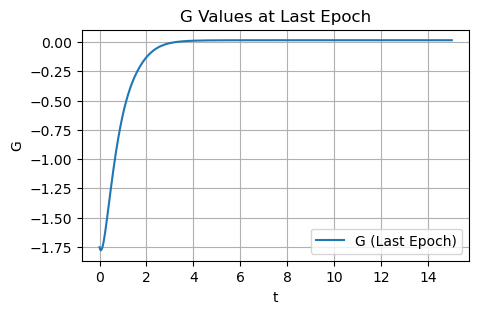

It 64000: loss = 5.62e-03,loss_G = 1.09e+00, alpha21 = 3.2623, alpha22 = 5.4537
Initial Condition: [20.00 0.00 -0.00 -0.00]


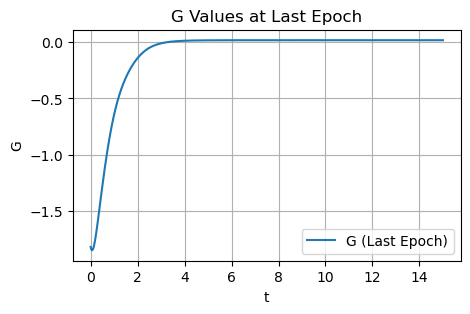

It 64500: loss = 8.70e-04,loss_G = 7.67e-01, alpha21 = 3.2515, alpha22 = 5.4532
Initial Condition: [20.00 0.00 0.00 0.00]


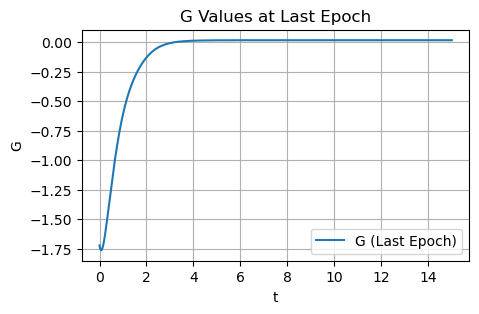

It 65000: loss = 8.70e-04,loss_G = 7.49e-01, alpha21 = 3.2454, alpha22 = 5.4422
Initial Condition: [20.00 0.00 0.00 0.00]


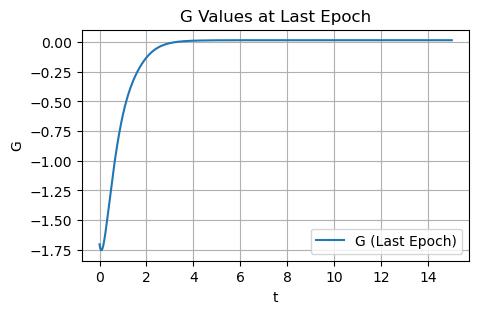

It 65500: loss = 8.68e-04,loss_G = 7.45e-01, alpha21 = 3.2454, alpha22 = 5.4422
Initial Condition: [20.00 0.00 0.00 0.00]


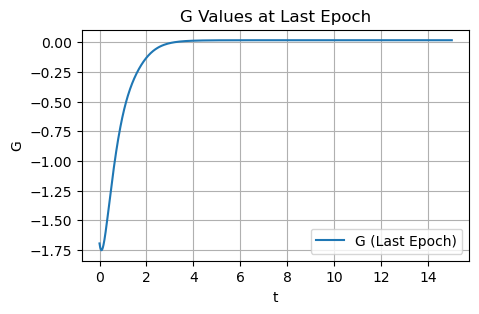

It 66000: loss = 8.76e-04,loss_G = 7.31e-01, alpha21 = 3.2408, alpha22 = 5.4325
Initial Condition: [20.00 0.00 0.00 0.00]


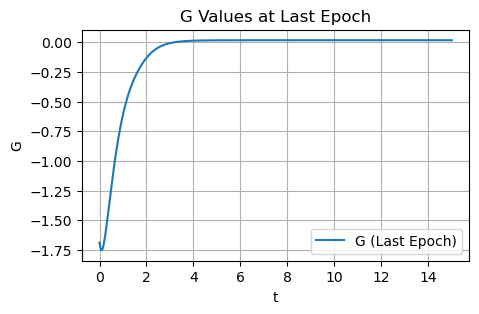

It 66500: loss = 1.57e-03,loss_G = 6.94e-01, alpha21 = 3.2344, alpha22 = 5.4233
Initial Condition: [20.00 0.00 -0.00 0.00]


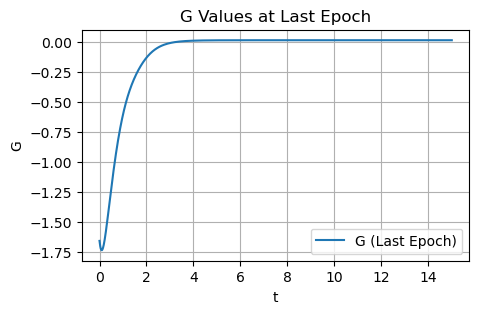

It 67000: loss = 8.67e-04,loss_G = 6.95e-01, alpha21 = 3.2319, alpha22 = 5.4178
Initial Condition: [20.00 0.00 0.00 0.00]


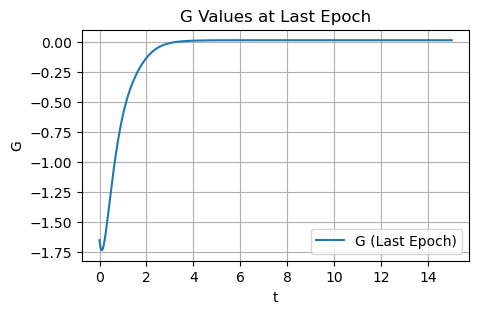

It 67500: loss = 9.07e-04,loss_G = 8.50e-01, alpha21 = 3.2294, alpha22 = 5.4070
Initial Condition: [20.00 0.00 0.00 0.00]


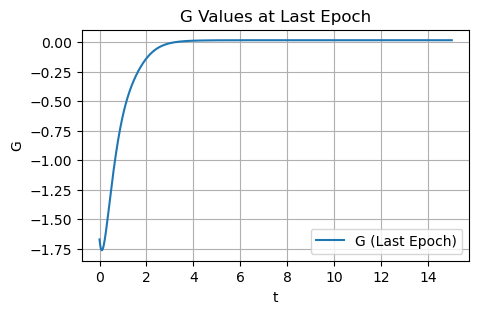

It 68000: loss = 8.65e-04,loss_G = 6.75e-01, alpha21 = 3.2256, alpha22 = 5.4066
Initial Condition: [20.00 0.00 0.00 0.00]


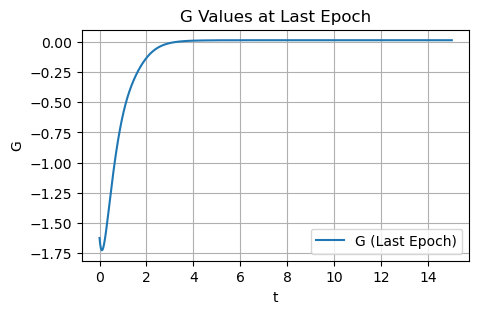

It 68500: loss = 8.66e-04,loss_G = 6.53e-01, alpha21 = 3.2176, alpha22 = 5.3924
Initial Condition: [20.00 0.00 0.00 0.00]


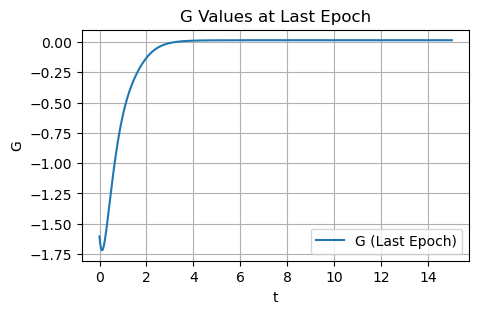

It 69000: loss = 8.92e-04,loss_G = 7.66e-01, alpha21 = 3.2194, alpha22 = 5.3927
Initial Condition: [20.00 0.00 0.00 0.00]


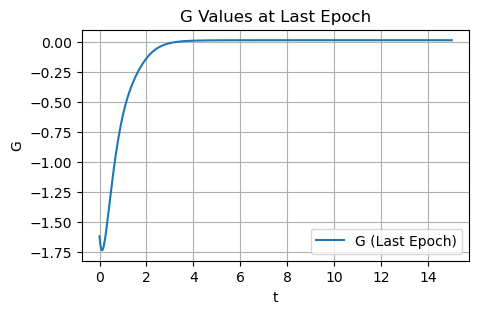

It 69500: loss = 1.11e-03,loss_G = 6.70e-01, alpha21 = 3.2143, alpha22 = 5.3855
Initial Condition: [20.00 0.00 -0.00 0.00]


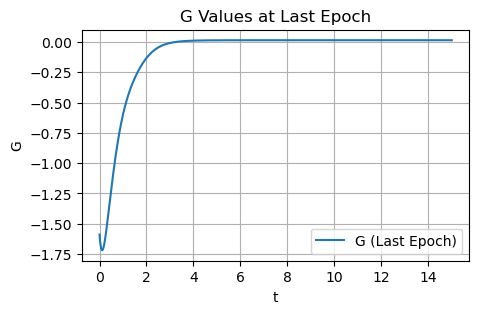

It 70000: loss = 1.08e-03,loss_G = 6.31e-01, alpha21 = 3.2136, alpha22 = 5.3791
Initial Condition: [20.00 0.00 -0.00 -0.00]


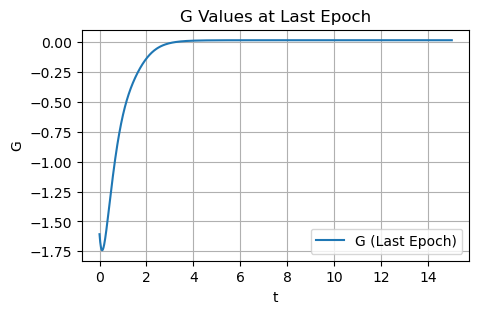

It 70500: loss = 8.65e-04,loss_G = 6.33e-01, alpha21 = 3.2108, alpha22 = 5.3793
Initial Condition: [20.00 0.00 0.00 -0.00]


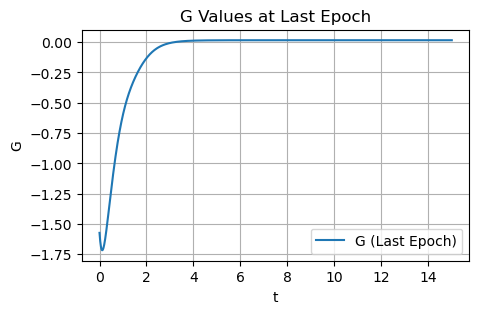

It 71000: loss = 5.13e-03,loss_G = 7.68e-01, alpha21 = 3.2077, alpha22 = 5.3700
Initial Condition: [19.99 0.00 -0.00 0.00]


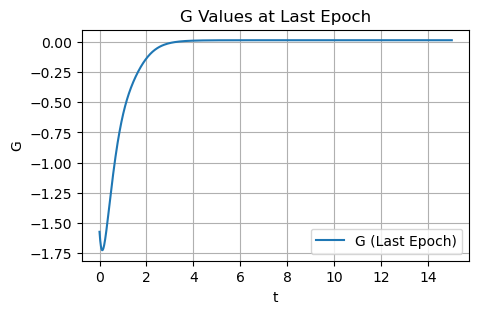

It 71500: loss = 8.63e-04,loss_G = 6.18e-01, alpha21 = 3.2049, alpha22 = 5.3690
Initial Condition: [20.00 0.00 0.00 0.00]


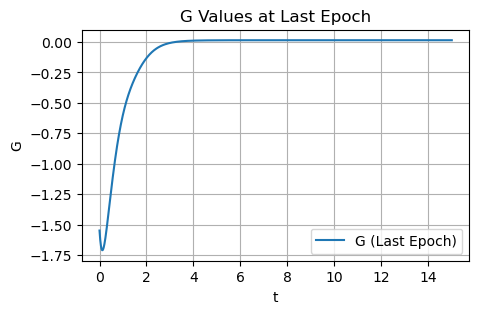

It 72000: loss = 1.24e-03,loss_G = 6.63e-01, alpha21 = 3.2024, alpha22 = 5.3597
Initial Condition: [20.00 0.00 0.00 0.00]


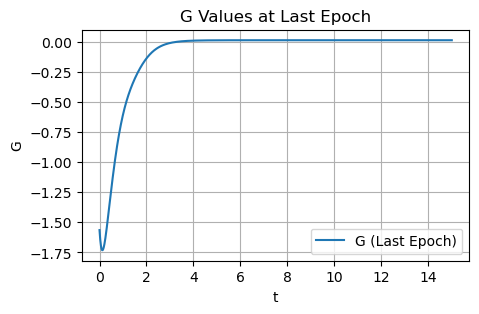

It 72500: loss = 8.62e-04,loss_G = 5.88e-01, alpha21 = 3.1993, alpha22 = 5.3592
Initial Condition: [20.00 0.00 0.00 0.00]


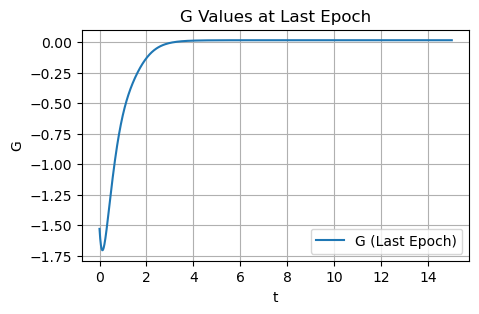

It 73000: loss = 8.62e-04,loss_G = 5.79e-01, alpha21 = 3.1943, alpha22 = 5.3504
Initial Condition: [20.00 0.00 0.00 0.00]


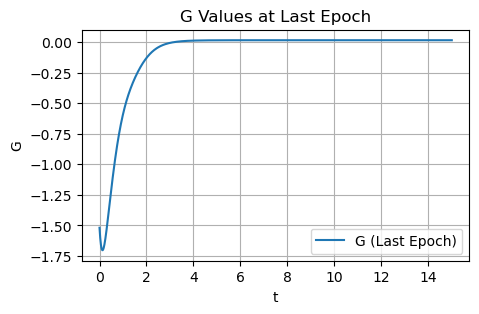

It 73500: loss = 8.61e-04,loss_G = 5.71e-01, alpha21 = 3.1922, alpha22 = 5.3466
Initial Condition: [20.00 0.00 0.00 0.00]


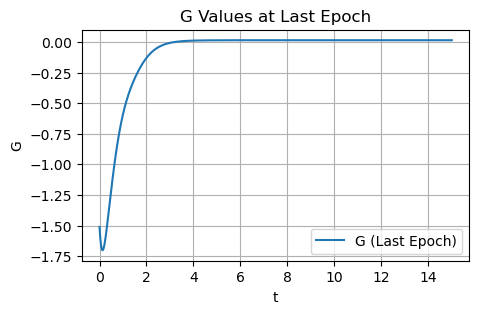

It 74000: loss = 5.19e-03,loss_G = 8.16e-01, alpha21 = 3.1887, alpha22 = 5.3291
Initial Condition: [20.00 0.00 -0.00 -0.00]


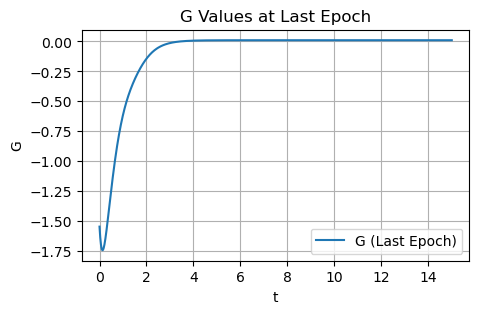

It 74500: loss = 8.64e-04,loss_G = 5.73e-01, alpha21 = 3.1878, alpha22 = 5.3374
Initial Condition: [20.00 0.00 0.00 0.00]


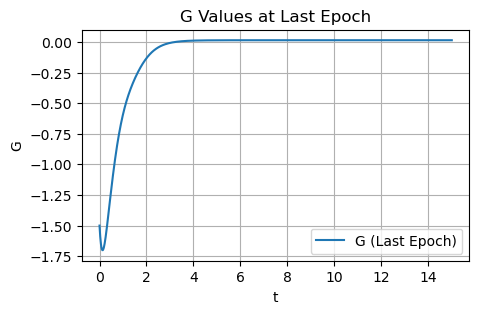

It 75000: loss = 1.11e-03,loss_G = 5.71e-01, alpha21 = 3.1846, alpha22 = 5.3329
Initial Condition: [20.00 0.00 -0.00 0.00]


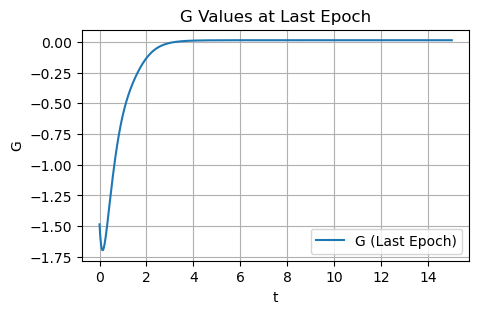

It 75500: loss = 9.02e-04,loss_G = 5.64e-01, alpha21 = 3.1835, alpha22 = 5.3288
Initial Condition: [20.00 0.00 0.00 -0.00]


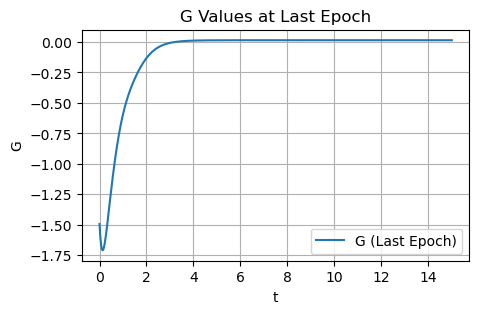

It 76000: loss = 8.84e-04,loss_G = 6.06e-01, alpha21 = 3.1819, alpha22 = 5.3258
Initial Condition: [20.00 0.00 -0.00 -0.00]


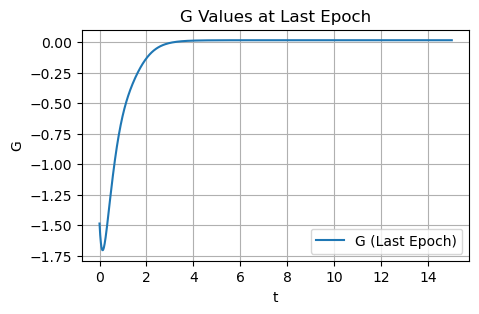

It 76500: loss = 4.90e-03,loss_G = 6.15e-01, alpha21 = 3.1762, alpha22 = 5.3204
Initial Condition: [19.99 0.00 -0.00 0.00]


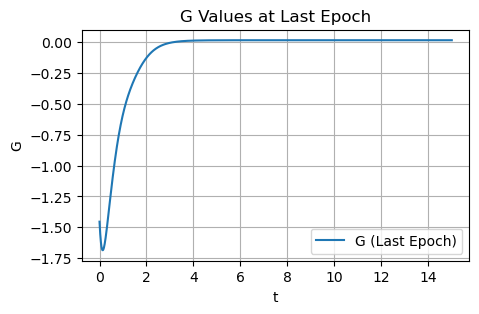

It 77000: loss = 3.92e-03,loss_G = 6.79e-01, alpha21 = 3.1776, alpha22 = 5.3122
Initial Condition: [20.01 -0.00 0.00 -0.00]


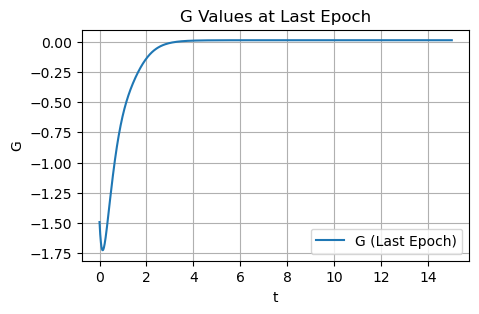

It 77500: loss = 6.42e-03,loss_G = 6.87e-01, alpha21 = 3.1778, alpha22 = 5.3054
Initial Condition: [20.01 -0.00 0.00 -0.00]


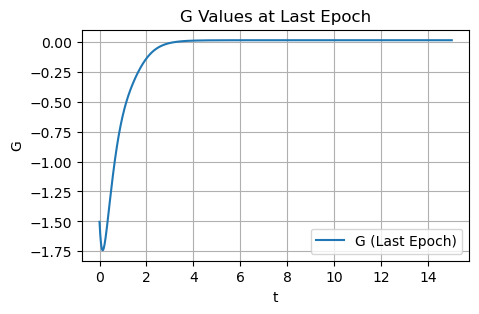

It 78000: loss = 8.60e-04,loss_G = 5.20e-01, alpha21 = 3.1707, alpha22 = 5.3075
Initial Condition: [20.00 0.00 0.00 0.00]


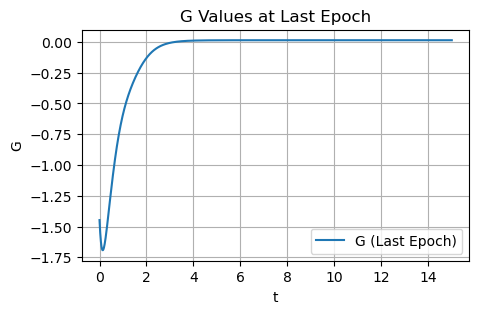

It 78500: loss = 8.60e-04,loss_G = 5.03e-01, alpha21 = 3.1693, alpha22 = 5.3056
Initial Condition: [20.00 0.00 0.00 0.00]


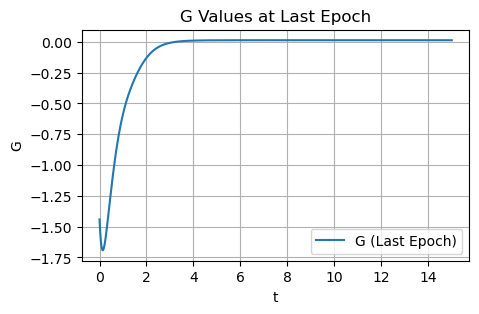

It 79000: loss = 2.70e-03,loss_G = 6.81e-01, alpha21 = 3.1702, alpha22 = 5.2936
Initial Condition: [19.99 0.00 0.00 0.01]


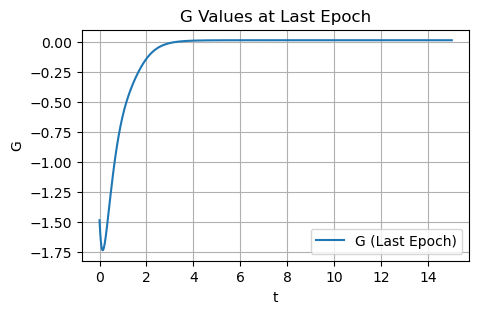

It 79500: loss = 8.59e-04,loss_G = 4.90e-01, alpha21 = 3.1633, alpha22 = 5.2949
Initial Condition: [20.00 0.00 0.00 0.00]


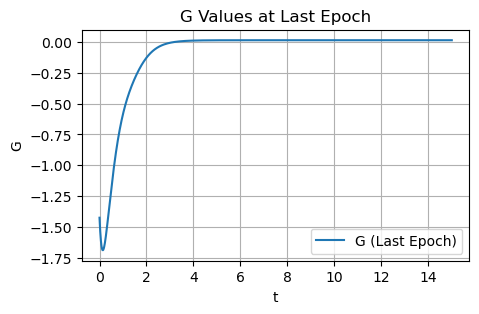

It 80000: loss = 8.59e-04,loss_G = 4.82e-01, alpha21 = 3.1612, alpha22 = 5.2911
Initial Condition: [20.00 0.00 0.00 0.00]


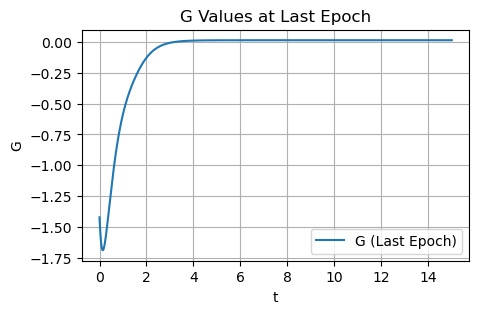

It 80500: loss = 8.59e-04,loss_G = 4.80e-01, alpha21 = 3.1595, alpha22 = 5.2879
Initial Condition: [20.00 0.00 0.00 0.00]


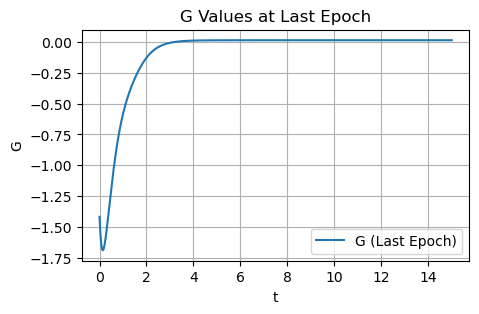

It 81000: loss = 8.59e-04,loss_G = 4.80e-01, alpha21 = 3.1595, alpha22 = 5.2879
Initial Condition: [20.00 0.00 0.00 0.00]


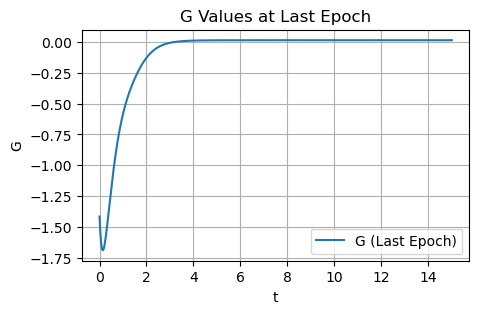

It 81500: loss = 8.84e-04,loss_G = 4.63e-01, alpha21 = 3.1550, alpha22 = 5.2802
Initial Condition: [20.00 0.00 0.00 0.00]


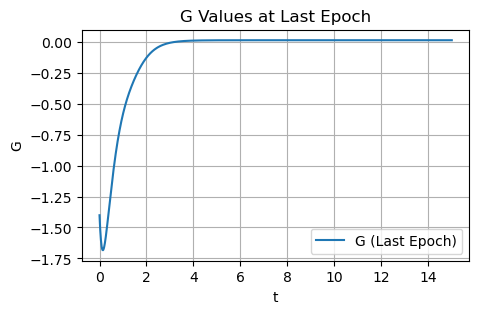

It 82000: loss = 1.04e-03,loss_G = 6.44e-01, alpha21 = 3.1549, alpha22 = 5.2700
Initial Condition: [20.00 0.00 -0.00 -0.00]


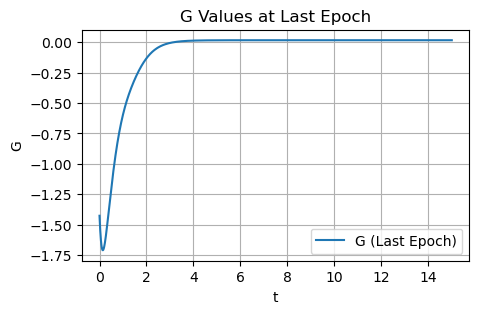

It 82500: loss = 8.77e-04,loss_G = 5.29e-01, alpha21 = 3.1524, alpha22 = 5.2722
Initial Condition: [20.00 0.00 0.00 0.00]


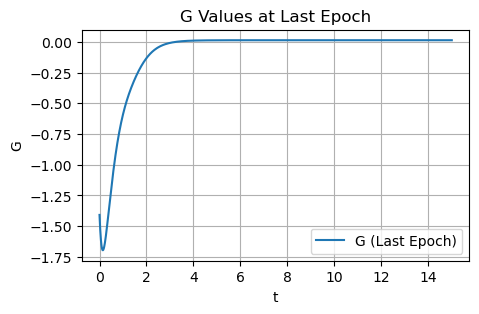

It 83000: loss = 8.60e-04,loss_G = 4.75e-01, alpha21 = 3.1507, alpha22 = 5.2707
Initial Condition: [20.00 0.00 0.00 0.00]


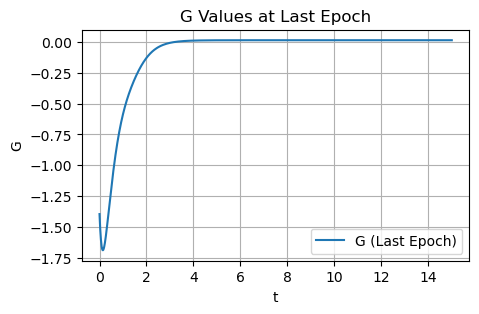

It 83500: loss = 8.59e-04,loss_G = 4.64e-01, alpha21 = 3.1497, alpha22 = 5.2699
Initial Condition: [20.00 0.00 0.00 0.00]


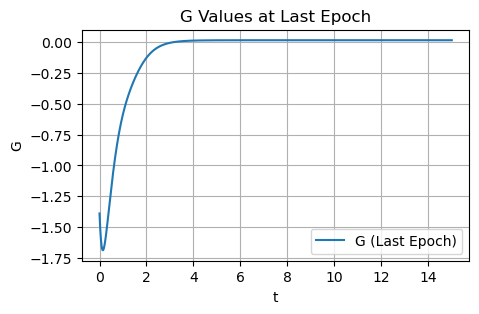

It 84000: loss = 8.59e-04,loss_G = 4.37e-01, alpha21 = 3.1459, alpha22 = 5.2639
Initial Condition: [20.00 0.00 0.00 0.00]


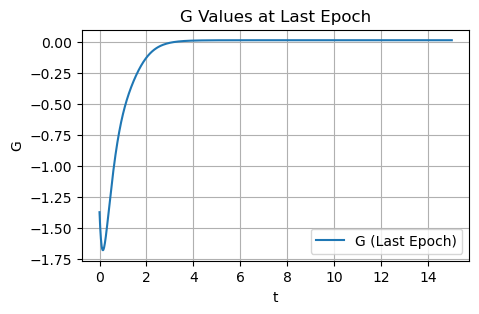

It 84500: loss = 1.43e-03,loss_G = 4.51e-01, alpha21 = 3.1466, alpha22 = 5.2549
Initial Condition: [20.01 0.00 -0.00 -0.00]


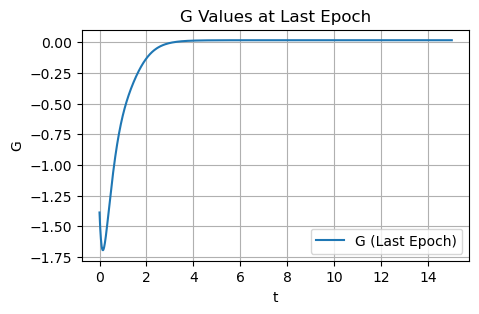

It 85000: loss = 8.66e-04,loss_G = 4.70e-01, alpha21 = 3.1436, alpha22 = 5.2578
Initial Condition: [20.00 0.00 0.00 0.00]


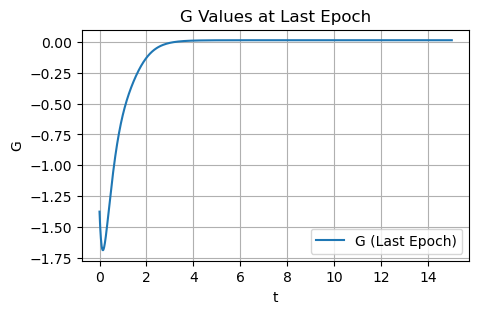

It 85500: loss = 9.59e-04,loss_G = 5.24e-01, alpha21 = 3.1417, alpha22 = 5.2510
Initial Condition: [20.00 0.00 -0.00 -0.00]


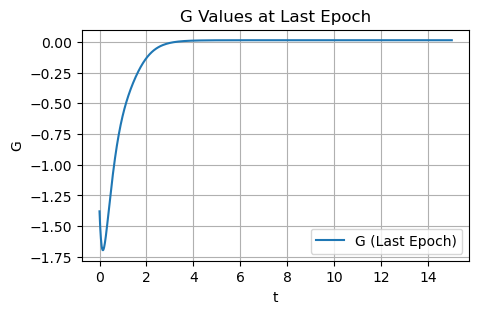

It 86000: loss = 8.96e-04,loss_G = 4.91e-01, alpha21 = 3.1396, alpha22 = 5.2500
Initial Condition: [20.00 0.00 -0.00 -0.00]


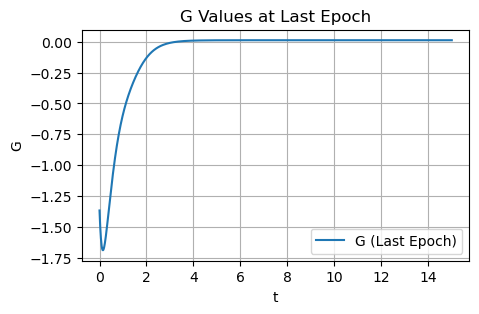

It 86500: loss = 8.63e-04,loss_G = 4.30e-01, alpha21 = 3.1376, alpha22 = 5.2477
Initial Condition: [20.00 0.00 0.00 0.00]


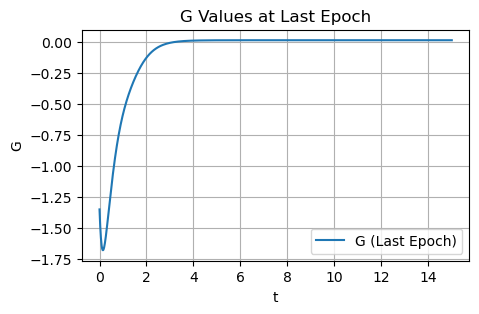

It 87000: loss = 8.58e-04,loss_G = 4.21e-01, alpha21 = 3.1359, alpha22 = 5.2454
Initial Condition: [20.00 0.00 0.00 0.00]


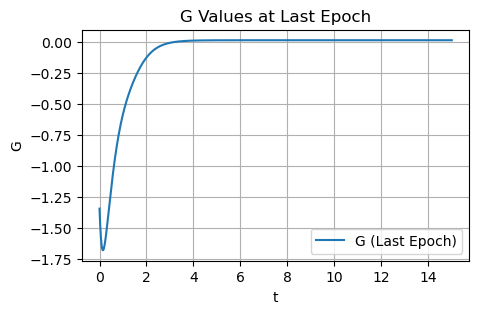

It 87500: loss = 8.58e-04,loss_G = 4.04e-01, alpha21 = 3.1342, alpha22 = 5.2428
Initial Condition: [20.00 0.00 0.00 0.00]


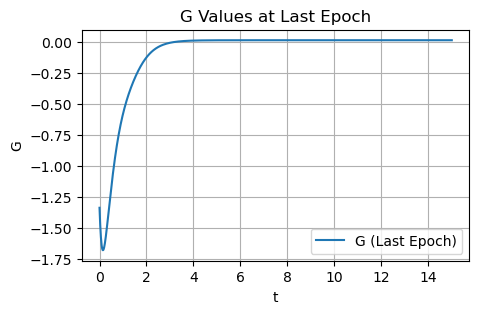

It 88000: loss = 1.27e-03,loss_G = 3.81e-01, alpha21 = 3.1326, alpha22 = 5.2394
Initial Condition: [20.00 -0.00 0.00 -0.00]


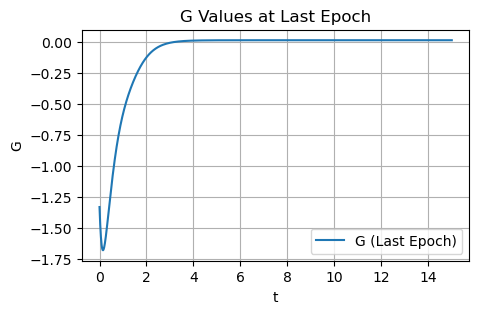

It 88500: loss = 9.25e-04,loss_G = 5.42e-01, alpha21 = 3.1339, alpha22 = 5.2366
Initial Condition: [20.00 0.00 -0.00 -0.00]


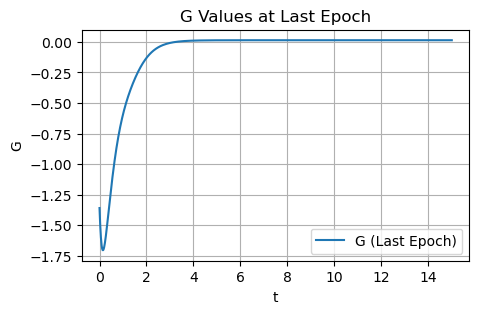

It 89000: loss = 8.58e-04,loss_G = 4.37e-01, alpha21 = 3.1323, alpha22 = 5.2377
Initial Condition: [20.00 0.00 0.00 0.00]


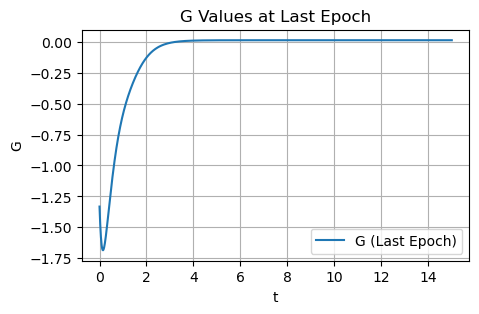

It 89500: loss = 8.63e-04,loss_G = 4.37e-01, alpha21 = 3.1309, alpha22 = 5.2349
Initial Condition: [20.00 0.00 0.00 0.00]


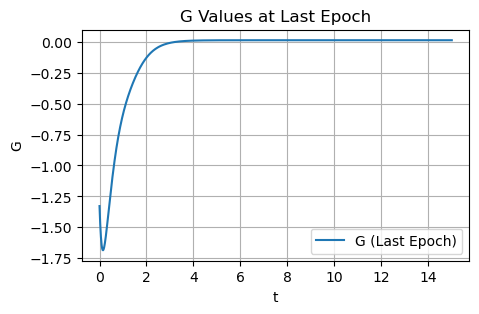

It 90000: loss = 2.25e-03,loss_G = 5.59e-01, alpha21 = 3.1302, alpha22 = 5.2275
Initial Condition: [19.99 0.00 -0.00 0.00]


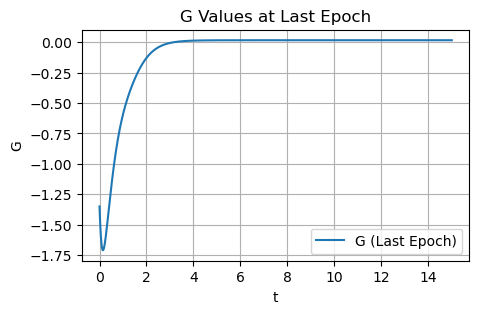

It 90500: loss = 3.91e-03,loss_G = 4.97e-01, alpha21 = 3.1313, alpha22 = 5.2233
Initial Condition: [20.01 0.00 -0.00 -0.00]


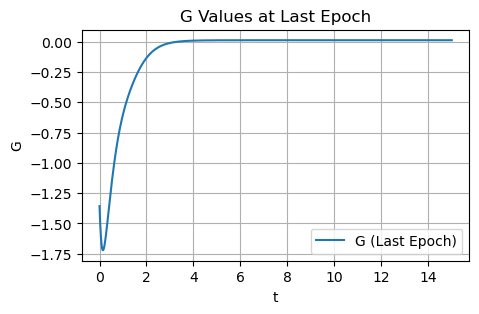

It 91000: loss = 4.92e-03,loss_G = 4.85e-01, alpha21 = 3.1300, alpha22 = 5.2208
Initial Condition: [20.01 0.00 0.00 -0.00]


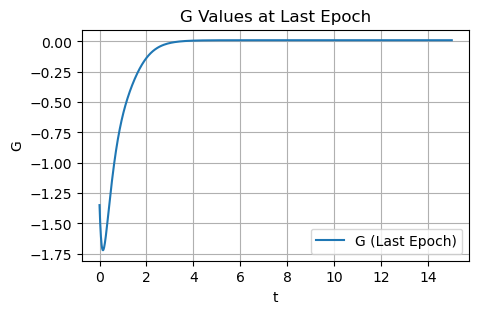

It 91500: loss = 1.34e-03,loss_G = 6.37e-01, alpha21 = 3.1269, alpha22 = 5.2233
Initial Condition: [20.00 0.00 0.00 0.00]


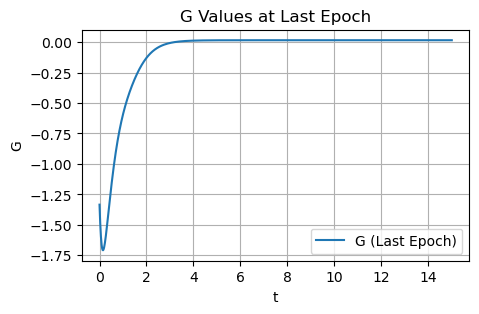

It 92000: loss = 6.46e-03,loss_G = 4.89e-01, alpha21 = 3.1263, alpha22 = 5.2209
Initial Condition: [20.00 -0.00 0.00 0.00]


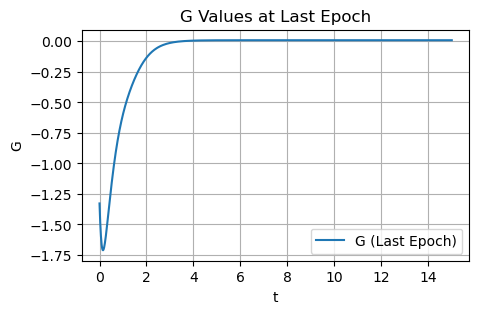

It 92500: loss = 9.83e-04,loss_G = 3.80e-01, alpha21 = 3.1225, alpha22 = 5.2217
Initial Condition: [20.00 0.00 -0.00 0.00]


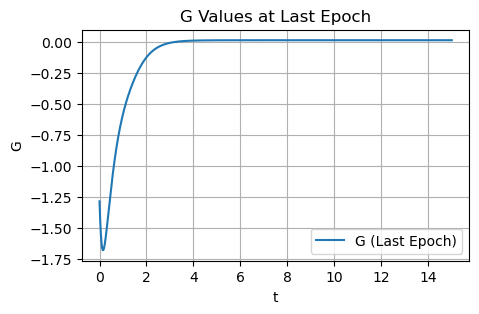

It 93000: loss = 8.57e-04,loss_G = 3.66e-01, alpha21 = 3.1219, alpha22 = 5.2209
Initial Condition: [20.00 0.00 0.00 0.00]


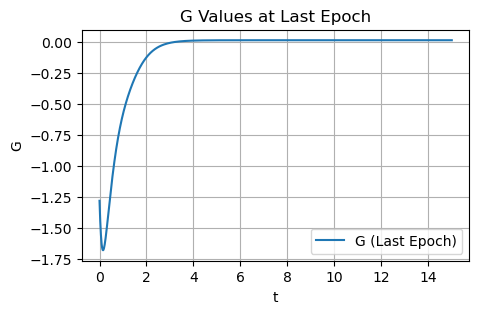

It 93500: loss = 5.64e-03,loss_G = 4.13e-01, alpha21 = 3.1238, alpha22 = 5.2199
Initial Condition: [20.01 -0.00 0.00 -0.00]


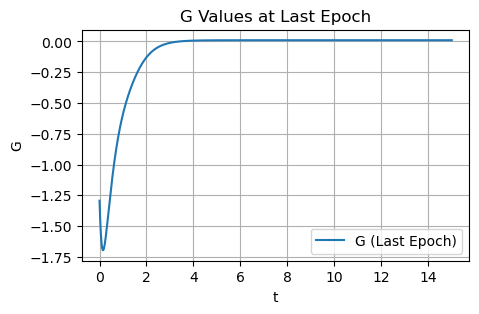

It 94000: loss = 8.81e-04,loss_G = 3.87e-01, alpha21 = 3.1217, alpha22 = 5.2191
Initial Condition: [20.00 0.00 -0.00 -0.00]


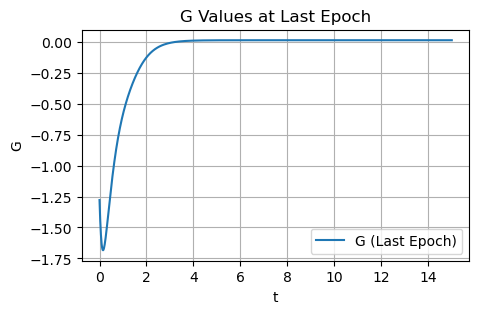

It 94500: loss = 8.56e-04,loss_G = 3.62e-01, alpha21 = 3.1214, alpha22 = 5.2202
Initial Condition: [20.00 0.00 0.00 0.00]


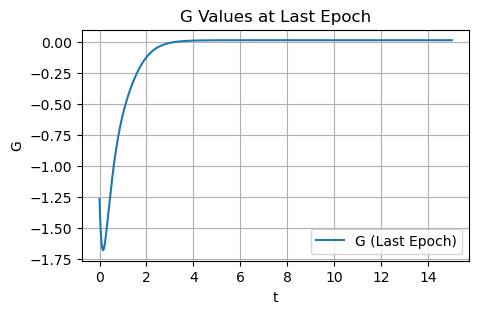

It 95000: loss = 8.59e-04,loss_G = 3.67e-01, alpha21 = 3.1213, alpha22 = 5.2192
Initial Condition: [20.00 0.00 0.00 0.00]


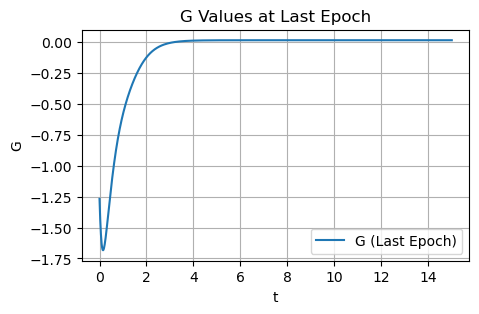

It 95500: loss = 3.07e-03,loss_G = 6.60e-01, alpha21 = 3.1221, alpha22 = 5.2124
Initial Condition: [20.02 -0.00 0.00 -0.01]


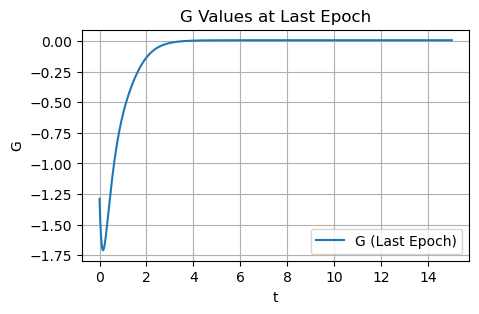

It 96000: loss = 8.56e-04,loss_G = 3.60e-01, alpha21 = 3.1187, alpha22 = 5.2150
Initial Condition: [20.00 0.00 0.00 0.00]


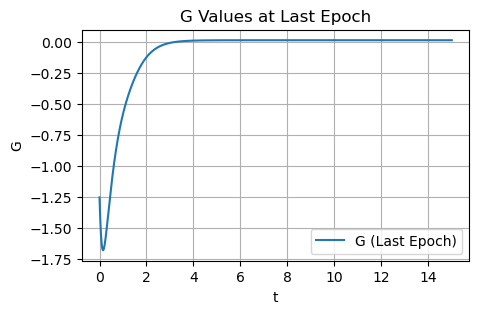

It 96500: loss = 2.26e-03,loss_G = 3.53e-01, alpha21 = 3.1152, alpha22 = 5.2102
Initial Condition: [20.00 0.00 -0.00 0.00]


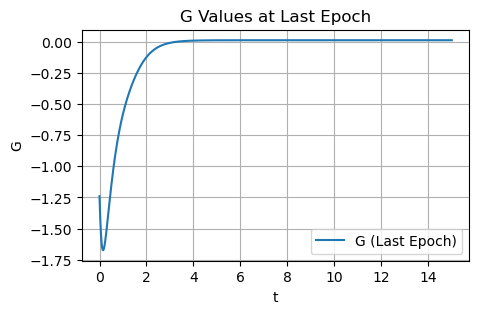

It 97000: loss = 8.58e-04,loss_G = 3.53e-01, alpha21 = 3.1152, alpha22 = 5.2085
Initial Condition: [20.00 0.00 0.00 0.00]


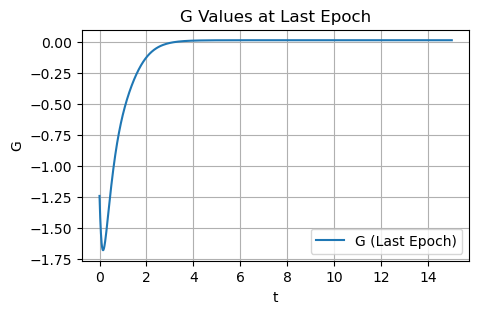

It 97500: loss = 7.29e-03,loss_G = 2.67e-01, alpha21 = 3.1178, alpha22 = 5.2050
Initial Condition: [20.00 0.00 -0.00 -0.00]


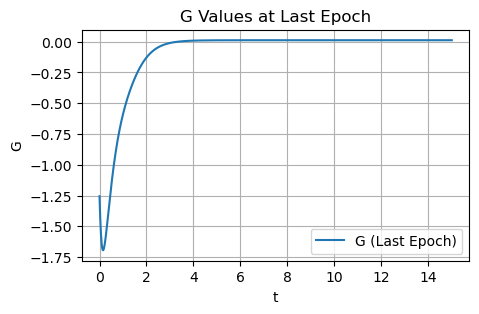

It 98000: loss = 2.39e-03,loss_G = 5.48e-01, alpha21 = 3.1204, alpha22 = 5.2031
Initial Condition: [20.00 0.00 -0.00 -0.00]


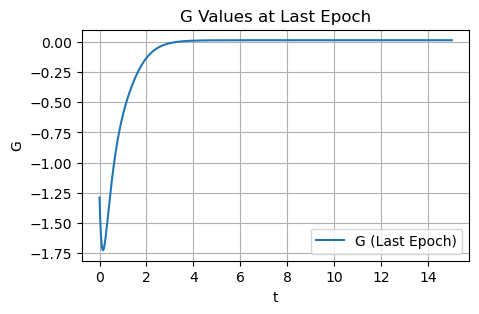

It 98500: loss = 8.83e-04,loss_G = 3.58e-01, alpha21 = 3.1151, alpha22 = 5.2099
Initial Condition: [20.00 0.00 0.00 0.00]


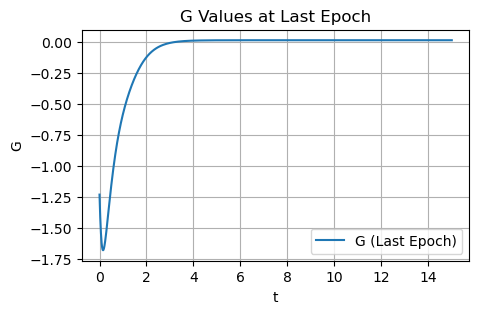

It 99000: loss = 8.56e-04,loss_G = 3.33e-01, alpha21 = 3.1120, alpha22 = 5.2035
Initial Condition: [20.00 0.00 0.00 0.00]


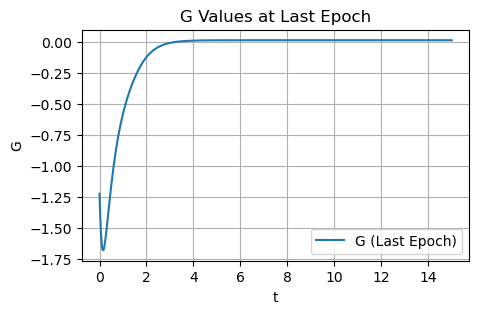

It 99500: loss = 1.11e-03,loss_G = 4.07e-01, alpha21 = 3.1126, alpha22 = 5.2015
Initial Condition: [20.00 0.00 -0.00 -0.00]


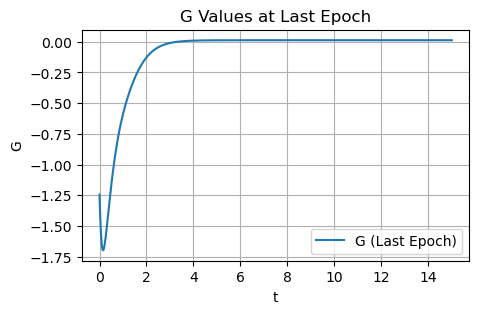

It 100000: loss = 1.10e-03,loss_G = 4.92e-01, alpha21 = 3.1117, alpha22 = 5.1994
Initial Condition: [20.00 0.00 -0.00 0.00]


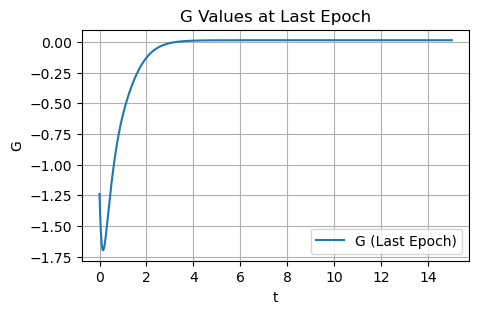

It 100500: loss = 9.43e-04,loss_G = 3.15e-01, alpha21 = 3.1088, alpha22 = 5.1974
Initial Condition: [20.00 -0.00 0.00 -0.00]


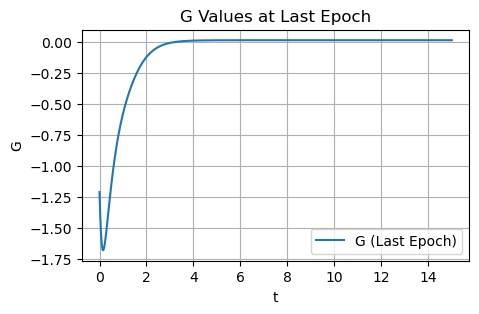

It 101000: loss = 8.55e-04,loss_G = 3.26e-01, alpha21 = 3.1072, alpha22 = 5.1946
Initial Condition: [20.00 0.00 0.00 0.00]


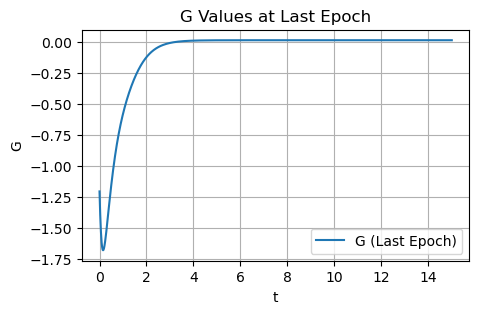

It 101500: loss = 7.14e-03,loss_G = 5.19e-01, alpha21 = 3.1078, alpha22 = 5.1947
Initial Condition: [19.99 0.00 -0.00 0.00]


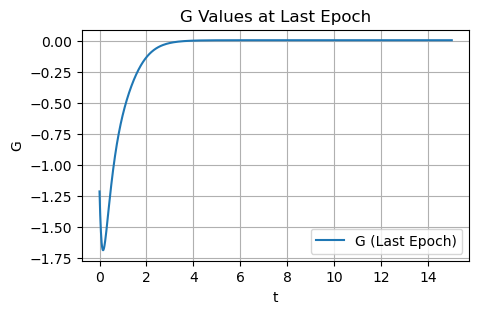

It 102000: loss = 2.25e-03,loss_G = 2.98e-01, alpha21 = 3.1088, alpha22 = 5.1897
Initial Condition: [20.01 0.00 -0.00 -0.00]


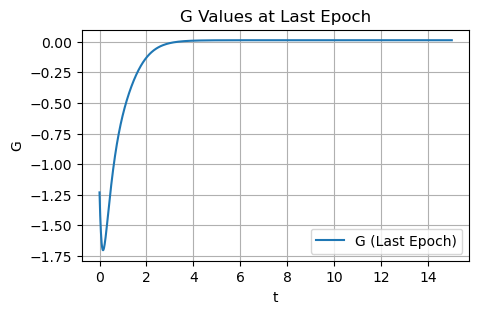

It 102500: loss = 8.59e-04,loss_G = 3.39e-01, alpha21 = 3.1088, alpha22 = 5.1962
Initial Condition: [20.00 0.00 0.00 0.00]


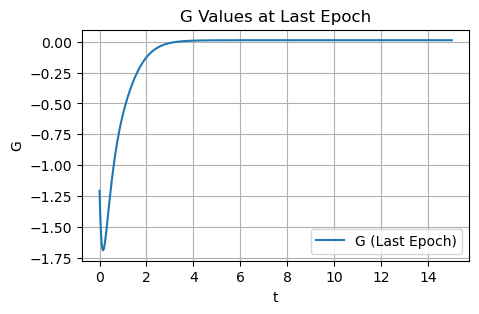

It 103000: loss = 1.09e-03,loss_G = 3.19e-01, alpha21 = 3.1055, alpha22 = 5.1912
Initial Condition: [20.00 -0.00 0.00 -0.00]


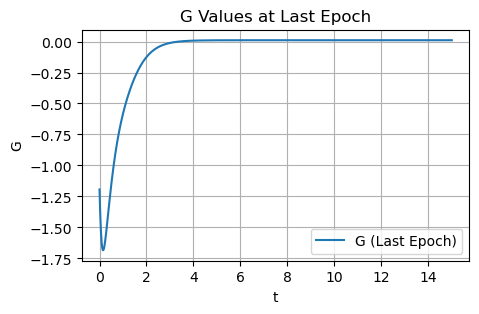

It 103500: loss = 8.59e-04,loss_G = 3.20e-01, alpha21 = 3.1048, alpha22 = 5.1895
Initial Condition: [20.00 0.00 0.00 -0.00]


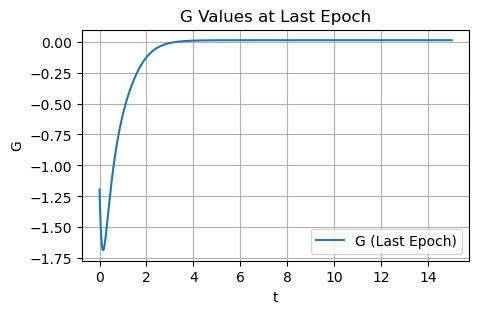

It 104000: loss = 8.64e-04,loss_G = 3.42e-01, alpha21 = 3.1047, alpha22 = 5.1887
Initial Condition: [20.00 0.00 0.00 -0.00]


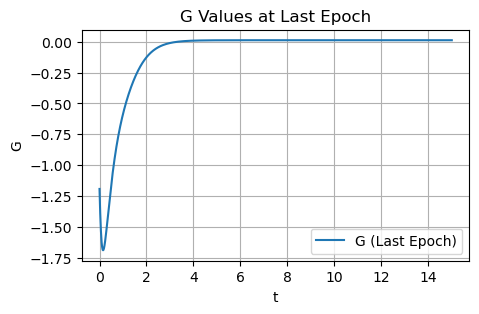

It 104500: loss = 8.60e-04,loss_G = 3.47e-01, alpha21 = 3.1031, alpha22 = 5.1855
Initial Condition: [20.00 0.00 0.00 0.00]


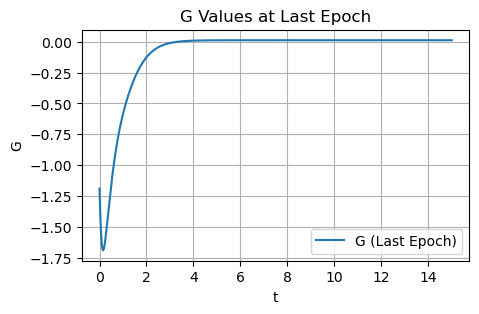

It 105000: loss = 1.08e-03,loss_G = 3.87e-01, alpha21 = 3.1030, alpha22 = 5.1830
Initial Condition: [20.00 0.00 0.00 -0.00]


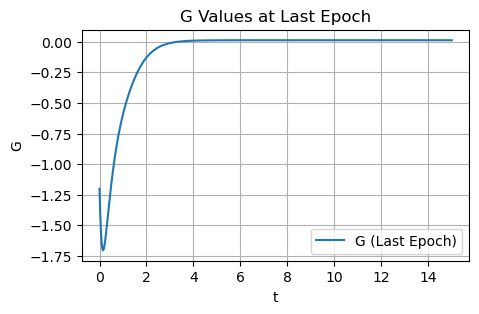

It 105500: loss = 8.55e-04,loss_G = 3.02e-01, alpha21 = 3.1017, alpha22 = 5.1850
Initial Condition: [20.00 0.00 0.00 0.00]


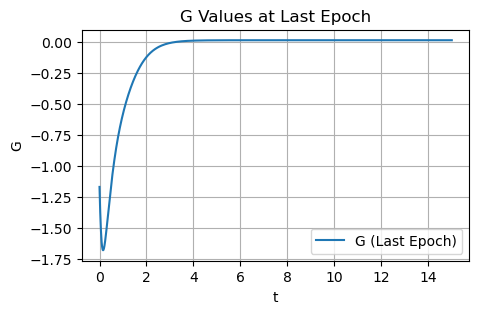

It 106000: loss = 8.55e-04,loss_G = 2.97e-01, alpha21 = 3.0996, alpha22 = 5.1815
Initial Condition: [20.00 0.00 0.00 0.00]


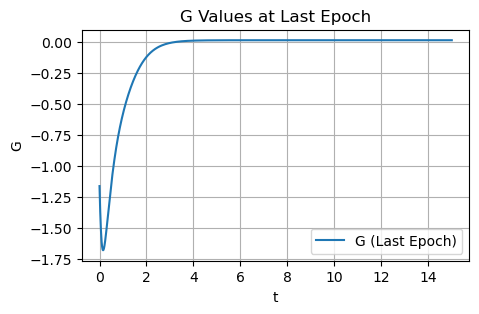

It 106500: loss = 8.55e-04,loss_G = 2.99e-01, alpha21 = 3.0988, alpha22 = 5.1798
Initial Condition: [20.00 0.00 0.00 0.00]


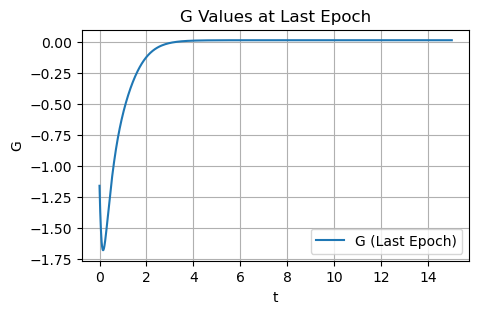

It 107000: loss = 8.55e-04,loss_G = 2.94e-01, alpha21 = 3.0984, alpha22 = 5.1791
Initial Condition: [20.00 0.00 0.00 0.00]


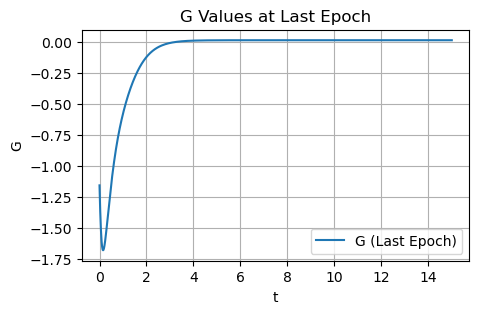

It 107500: loss = 9.98e-04,loss_G = 2.96e-01, alpha21 = 3.0971, alpha22 = 5.1760
Initial Condition: [20.00 -0.00 0.00 -0.00]


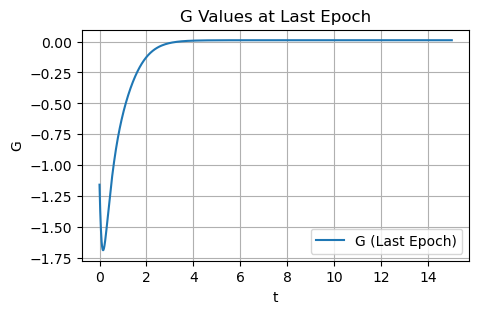

It 108000: loss = 9.18e-04,loss_G = 3.34e-01, alpha21 = 3.0954, alpha22 = 5.1723
Initial Condition: [20.00 0.00 0.00 0.00]


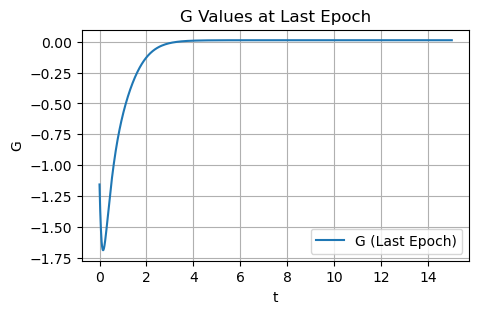

It 108500: loss = 8.55e-04,loss_G = 2.89e-01, alpha21 = 3.0955, alpha22 = 5.1737
Initial Condition: [20.00 0.00 0.00 0.00]


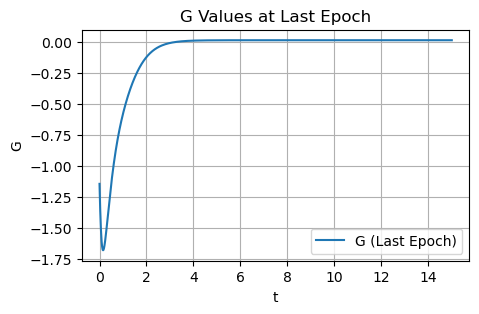

It 109000: loss = 8.55e-04,loss_G = 2.97e-01, alpha21 = 3.0965, alpha22 = 5.1751
Initial Condition: [20.00 0.00 0.00 0.00]


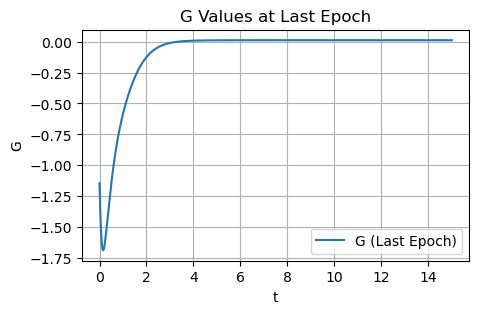

It 109500: loss = 1.74e-02,loss_G = 4.01e-01, alpha21 = 3.0938, alpha22 = 5.1709
Initial Condition: [20.01 -0.00 0.00 -0.00]


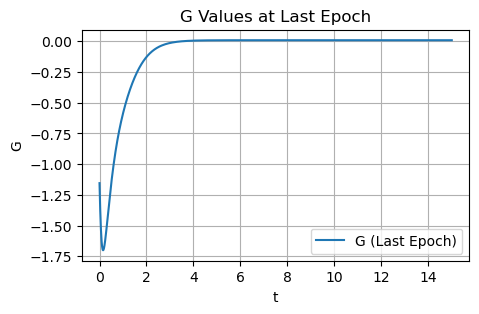

It 110000: loss = 8.55e-04,loss_G = 2.85e-01, alpha21 = 3.0945, alpha22 = 5.1717
Initial Condition: [20.00 0.00 0.00 0.00]


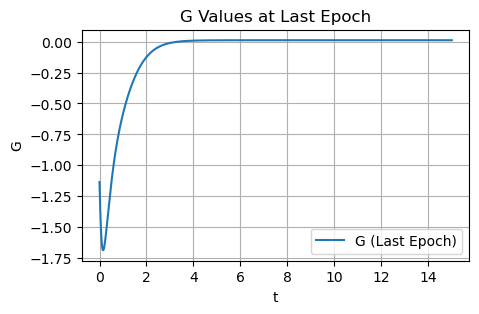

It 110500: loss = 9.39e-04,loss_G = 2.90e-01, alpha21 = 3.0924, alpha22 = 5.1693
Initial Condition: [20.00 0.00 0.00 0.00]


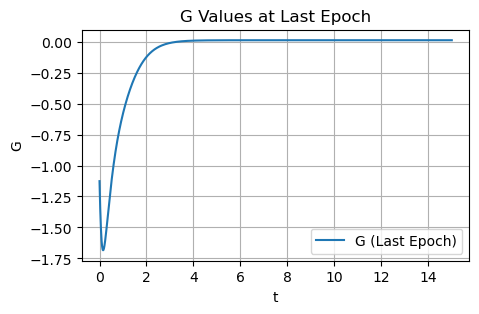

It 111000: loss = 8.54e-04,loss_G = 2.73e-01, alpha21 = 3.0917, alpha22 = 5.1672
Initial Condition: [20.00 0.00 0.00 0.00]


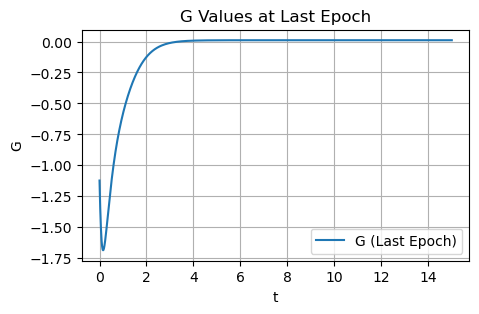

It 111500: loss = 8.62e-04,loss_G = 2.99e-01, alpha21 = 3.0915, alpha22 = 5.1661
Initial Condition: [20.00 0.00 0.00 0.00]


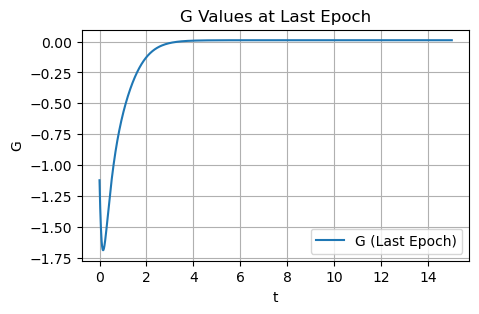

It 112000: loss = 9.06e-04,loss_G = 2.31e-01, alpha21 = 3.0909, alpha22 = 5.1646
Initial Condition: [20.00 0.00 -0.00 -0.00]


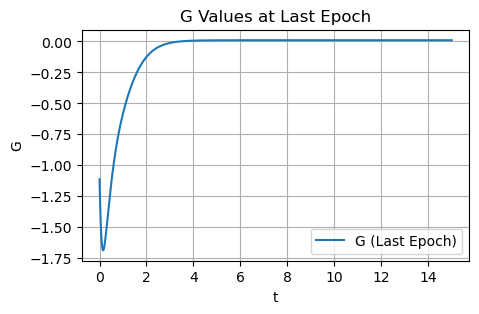

It 112500: loss = 9.71e-04,loss_G = 3.68e-01, alpha21 = 3.0897, alpha22 = 5.1618
Initial Condition: [20.00 0.00 0.00 0.00]


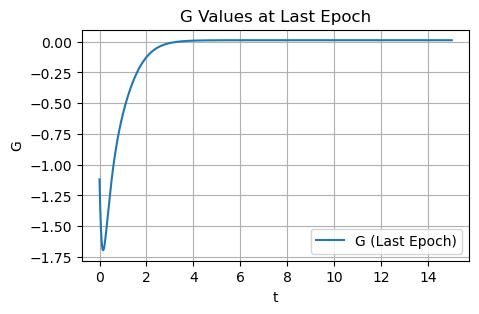

It 113000: loss = 8.65e-04,loss_G = 3.24e-01, alpha21 = 3.0892, alpha22 = 5.1600
Initial Condition: [20.00 -0.00 -0.00 0.00]


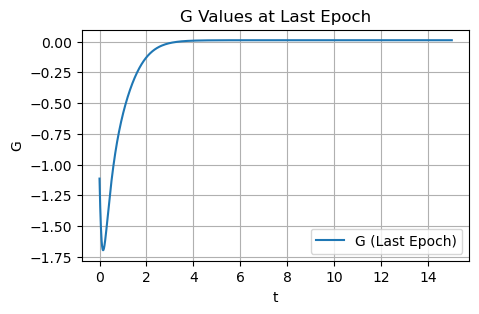

It 113500: loss = 8.54e-04,loss_G = 2.61e-01, alpha21 = 3.0879, alpha22 = 5.1602
Initial Condition: [20.00 0.00 0.00 -0.00]


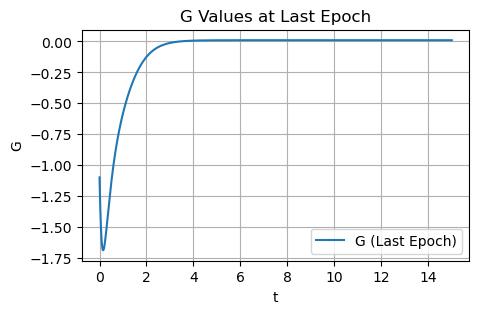

It 114000: loss = 8.54e-03,loss_G = 3.85e-01, alpha21 = 3.0852, alpha22 = 5.1570
Initial Condition: [19.99 0.00 0.00 0.00]


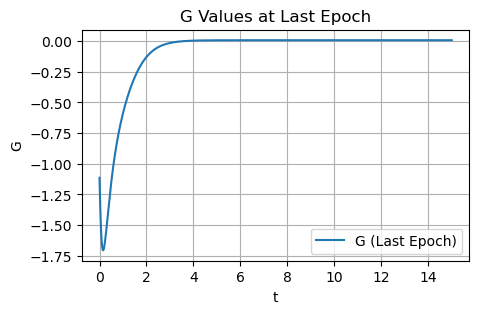

It 114500: loss = 7.63e-03,loss_G = 3.69e-01, alpha21 = 3.0832, alpha22 = 5.1559
Initial Condition: [19.99 0.00 0.00 0.01]


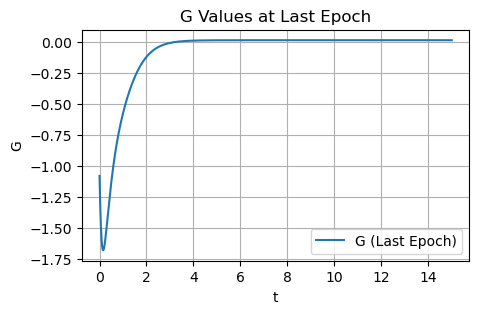

It 115000: loss = 8.54e-04,loss_G = 2.57e-01, alpha21 = 3.0853, alpha22 = 5.1554
Initial Condition: [20.00 0.00 0.00 -0.00]


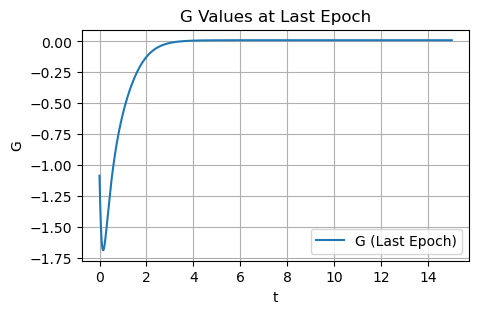

It 115500: loss = 8.54e-04,loss_G = 2.60e-01, alpha21 = 3.0845, alpha22 = 5.1536
Initial Condition: [20.00 0.00 0.00 0.00]


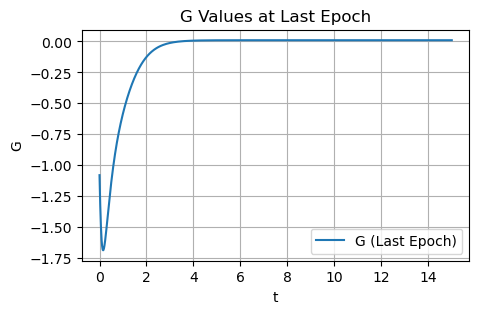

It 116000: loss = 1.02e-03,loss_G = 3.16e-01, alpha21 = 3.0819, alpha22 = 5.1484
Initial Condition: [20.00 -0.00 0.00 0.00]


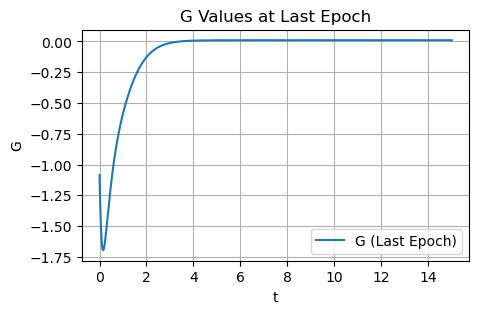

It 116500: loss = 9.33e-04,loss_G = 2.39e-01, alpha21 = 3.0827, alpha22 = 5.1492
Initial Condition: [20.00 -0.00 -0.00 -0.00]


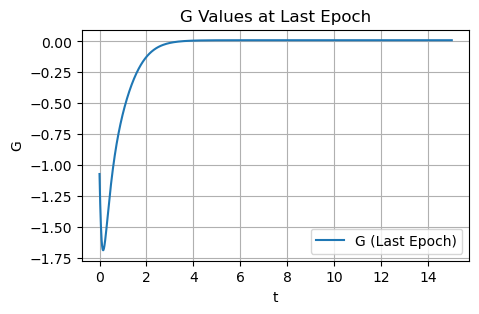

It 117000: loss = 2.82e-02,loss_G = 3.87e-01, alpha21 = 3.0775, alpha22 = 5.1495
Initial Condition: [19.98 0.01 -0.00 0.01]


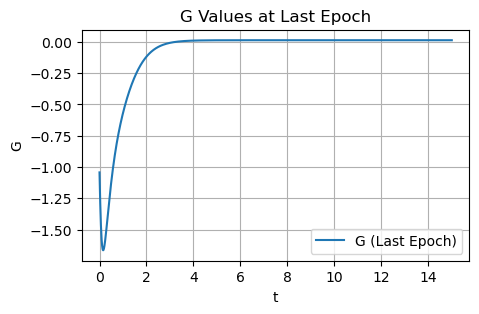

It 117500: loss = 8.98e-04,loss_G = 3.69e-01, alpha21 = 3.0812, alpha22 = 5.1442
Initial Condition: [20.00 -0.00 0.00 0.00]


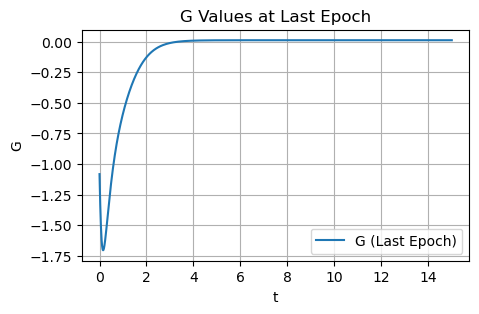

It 118000: loss = 8.55e-04,loss_G = 2.44e-01, alpha21 = 3.0796, alpha22 = 5.1454
Initial Condition: [20.00 0.00 0.00 0.00]


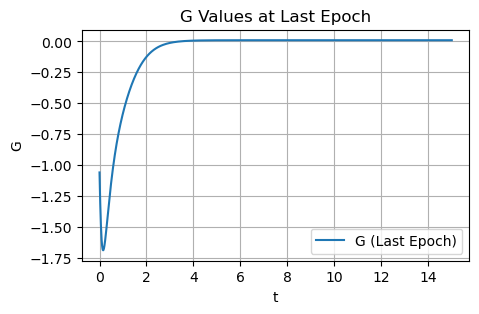

It 118500: loss = 8.62e-04,loss_G = 2.69e-01, alpha21 = 3.0790, alpha22 = 5.1419
Initial Condition: [20.00 0.00 -0.00 -0.00]


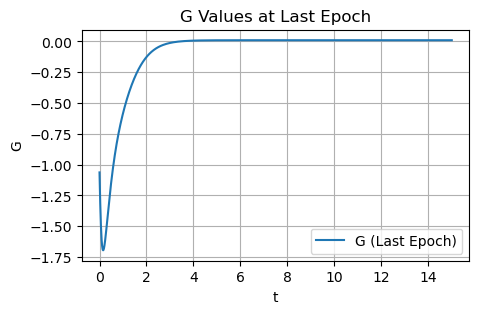

It 119000: loss = 9.29e-04,loss_G = 2.30e-01, alpha21 = 3.0762, alpha22 = 5.1389
Initial Condition: [20.00 -0.00 0.00 -0.00]


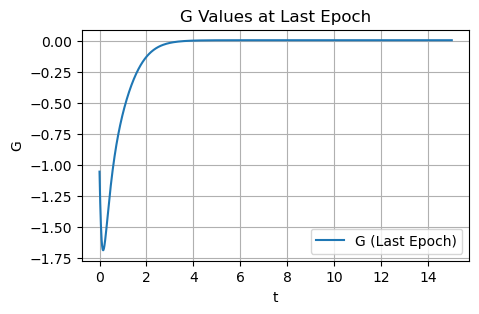

It 119500: loss = 8.53e-04,loss_G = 2.32e-01, alpha21 = 3.0754, alpha22 = 5.1379
Initial Condition: [20.00 0.00 0.00 0.00]


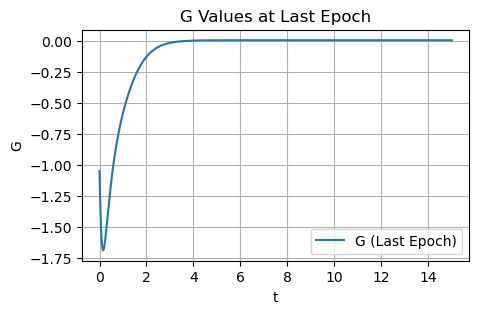

It 120000: loss = 8.53e-04,loss_G = 2.31e-01, alpha21 = 3.0742, alpha22 = 5.1356
Initial Condition: [20.00 0.00 0.00 0.00]


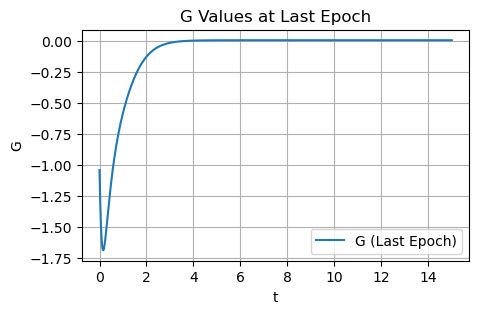

It 120500: loss = 8.53e-04,loss_G = 2.31e-01, alpha21 = 3.0742, alpha22 = 5.1353
Initial Condition: [20.00 0.00 0.00 0.00]


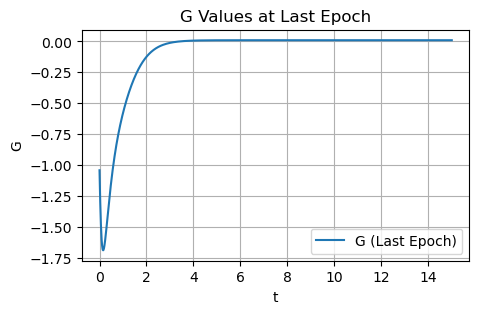

It 121000: loss = 8.53e-04,loss_G = 2.30e-01, alpha21 = 3.0735, alpha22 = 5.1341
Initial Condition: [20.00 0.00 0.00 0.00]


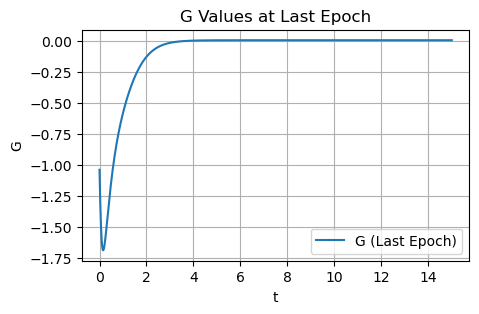

It 121500: loss = 2.10e-03,loss_G = 2.84e-01, alpha21 = 3.0735, alpha22 = 5.1281
Initial Condition: [20.01 -0.00 0.00 -0.00]


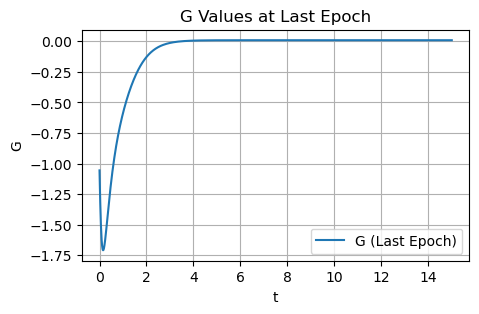

It 122000: loss = 8.54e-04,loss_G = 2.19e-01, alpha21 = 3.0711, alpha22 = 5.1299
Initial Condition: [20.00 0.00 0.00 0.00]


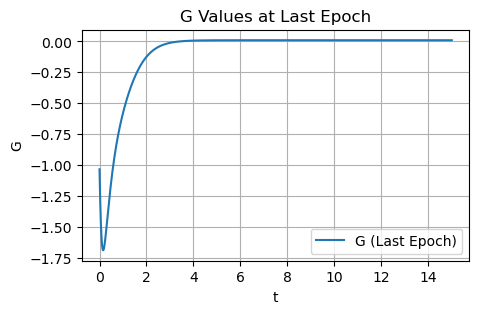

It 122500: loss = 8.58e-04,loss_G = 2.32e-01, alpha21 = 3.0701, alpha22 = 5.1276
Initial Condition: [20.00 0.00 0.00 0.00]


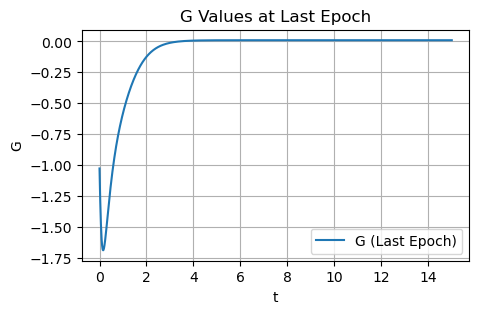

It 123000: loss = 8.70e-04,loss_G = 2.23e-01, alpha21 = 3.0701, alpha22 = 5.1258
Initial Condition: [20.00 0.00 -0.00 -0.00]


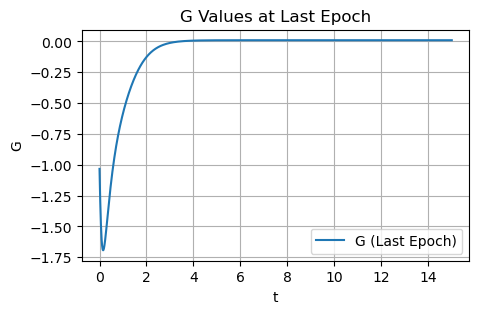

It 123500: loss = 1.21e-03,loss_G = 2.72e-01, alpha21 = 3.0706, alpha22 = 5.1221
Initial Condition: [20.00 -0.00 0.00 -0.00]


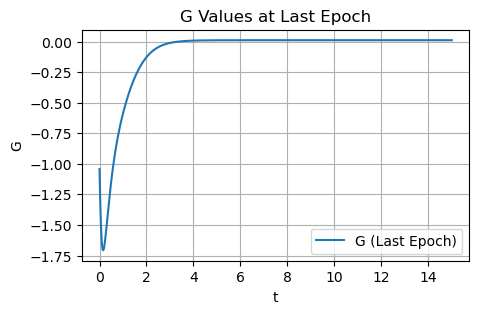

It 124000: loss = 8.53e-04,loss_G = 2.15e-01, alpha21 = 3.0685, alpha22 = 5.1255
Initial Condition: [20.00 0.00 0.00 0.00]


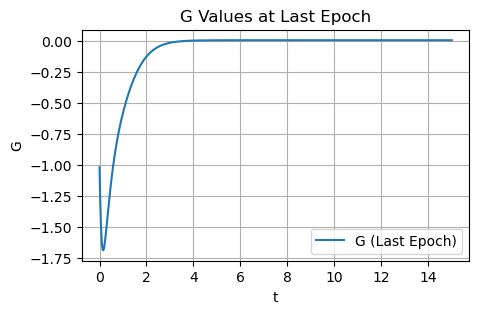

It 124500: loss = 8.53e-04,loss_G = 2.12e-01, alpha21 = 3.0684, alpha22 = 5.1253
Initial Condition: [20.00 0.00 0.00 0.00]


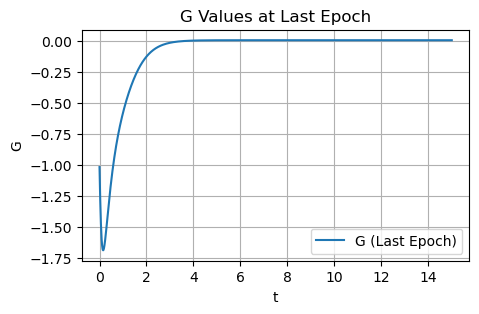

It 125000: loss = 8.56e-04,loss_G = 2.35e-01, alpha21 = 3.0673, alpha22 = 5.1222
Initial Condition: [20.00 0.00 0.00 0.00]


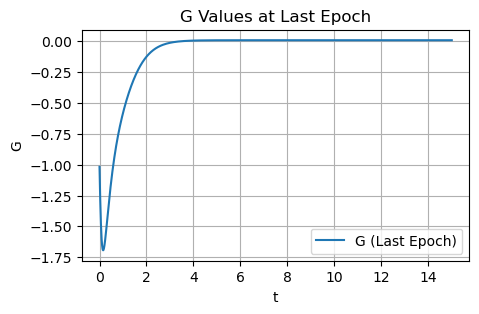

It 125500: loss = 1.38e-03,loss_G = 3.35e-01, alpha21 = 3.0653, alpha22 = 5.1152
Initial Condition: [19.99 0.00 0.00 0.00]


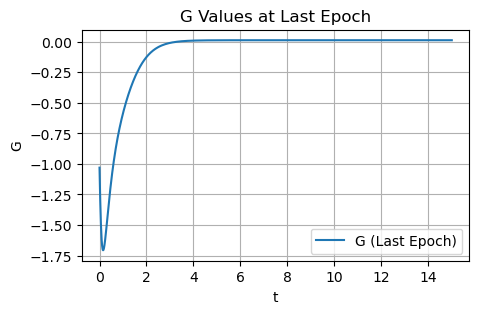

It 126000: loss = 8.53e-04,loss_G = 2.07e-01, alpha21 = 3.0656, alpha22 = 5.1202
Initial Condition: [20.00 0.00 0.00 0.00]


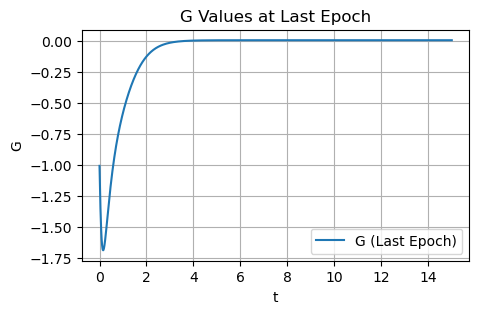

It 126500: loss = 8.54e-04,loss_G = 2.10e-01, alpha21 = 3.0656, alpha22 = 5.1200
Initial Condition: [20.00 0.00 0.00 0.00]


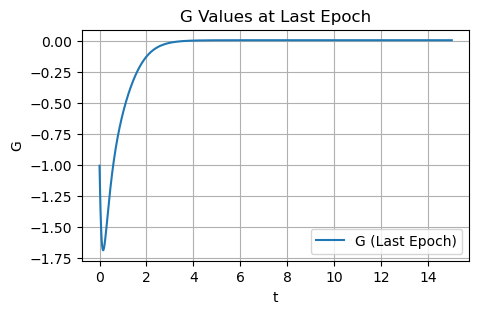

It 127000: loss = 8.53e-04,loss_G = 2.05e-01, alpha21 = 3.0651, alpha22 = 5.1193
Initial Condition: [20.00 0.00 0.00 0.00]


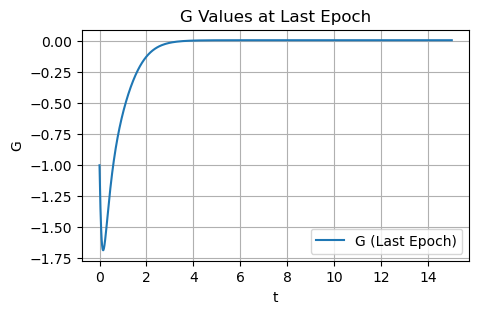

It 127500: loss = 9.07e-04,loss_G = 2.30e-01, alpha21 = 3.0645, alpha22 = 5.1170
Initial Condition: [20.00 0.00 -0.00 0.00]


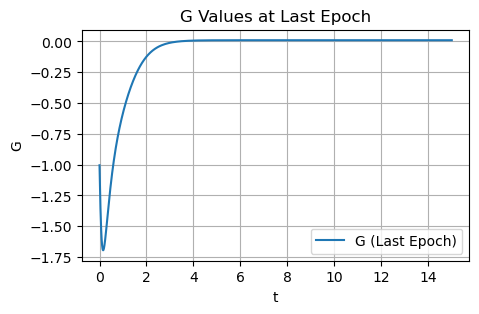

It 128000: loss = 8.75e-04,loss_G = 1.94e-01, alpha21 = 3.0623, alpha22 = 5.1143
Initial Condition: [20.00 -0.00 0.00 -0.00]


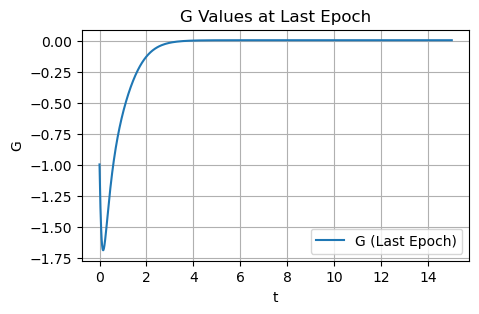

It 128500: loss = 9.37e-04,loss_G = 2.94e-01, alpha21 = 3.0624, alpha22 = 5.1110
Initial Condition: [20.00 0.00 -0.00 -0.00]


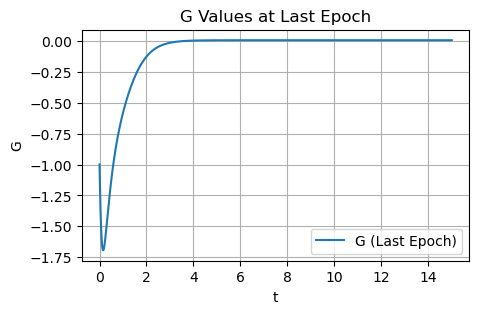

It 129000: loss = 8.53e-04,loss_G = 2.00e-01, alpha21 = 3.0634, alpha22 = 5.1160
Initial Condition: [20.00 0.00 0.00 0.00]


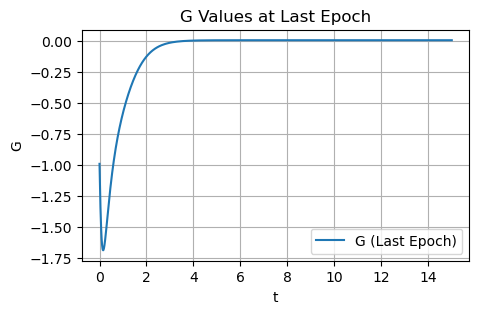

It 129500: loss = 8.53e-04,loss_G = 1.96e-01, alpha21 = 3.0619, alpha22 = 5.1136
Initial Condition: [20.00 0.00 0.00 0.00]


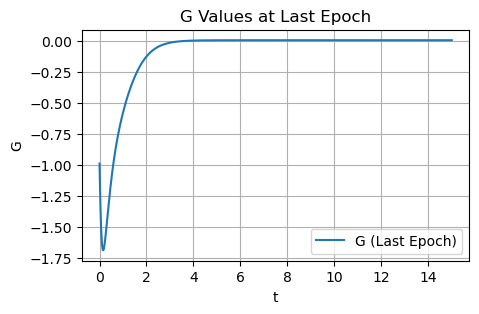

It 130000: loss = 8.53e-04,loss_G = 1.94e-01, alpha21 = 3.0616, alpha22 = 5.1131
Initial Condition: [20.00 0.00 0.00 0.00]


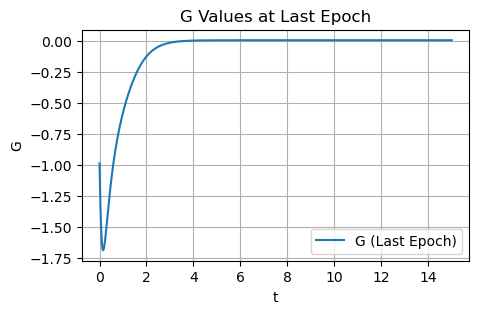

It 130500: loss = 1.21e-03,loss_G = 1.96e-01, alpha21 = 3.0612, alpha22 = 5.1131
Initial Condition: [20.00 0.00 -0.00 0.00]


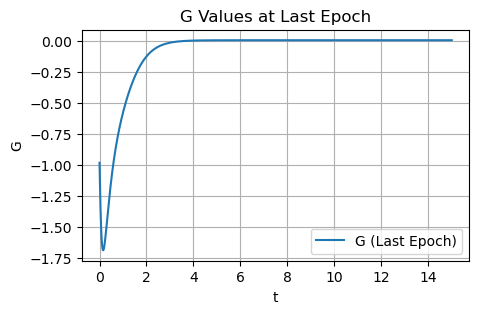

It 131000: loss = 8.54e-04,loss_G = 1.92e-01, alpha21 = 3.0611, alpha22 = 5.1122
Initial Condition: [20.00 0.00 0.00 0.00]


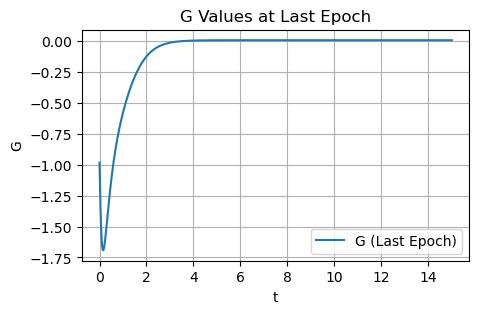

It 131500: loss = 1.15e-03,loss_G = 2.80e-01, alpha21 = 3.0604, alpha22 = 5.1093
Initial Condition: [20.00 0.00 0.00 0.00]


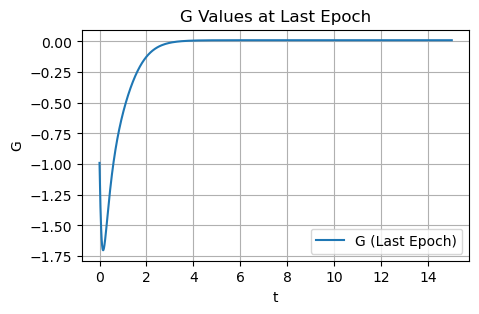

It 132000: loss = 8.97e-04,loss_G = 2.10e-01, alpha21 = 3.0602, alpha22 = 5.1086
Initial Condition: [20.00 -0.00 0.00 -0.00]


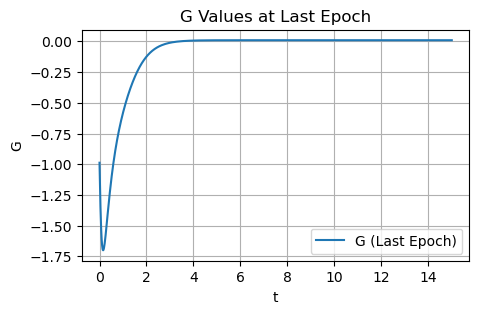

It 132500: loss = 8.53e-04,loss_G = 1.97e-01, alpha21 = 3.0589, alpha22 = 5.1078
Initial Condition: [20.00 0.00 0.00 0.00]


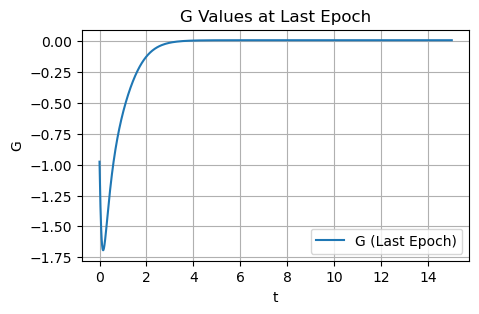

It 133000: loss = 8.53e-04,loss_G = 1.84e-01, alpha21 = 3.0580, alpha22 = 5.1065
Initial Condition: [20.00 0.00 0.00 0.00]


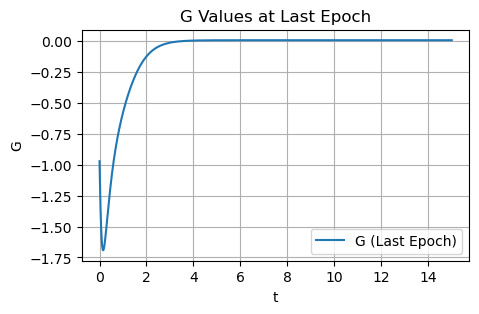

It 133500: loss = 1.23e-03,loss_G = 2.00e-01, alpha21 = 3.0580, alpha22 = 5.1045
Initial Condition: [20.00 0.00 -0.00 0.00]


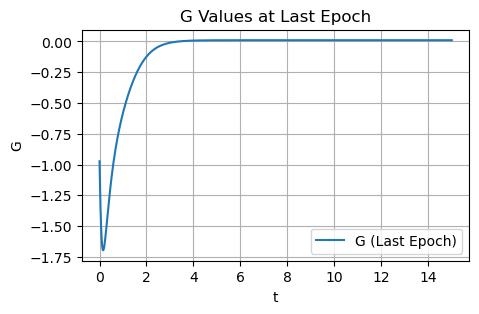

It 134000: loss = 8.53e-04,loss_G = 1.89e-01, alpha21 = 3.0594, alpha22 = 5.1091
Initial Condition: [20.00 0.00 0.00 0.00]


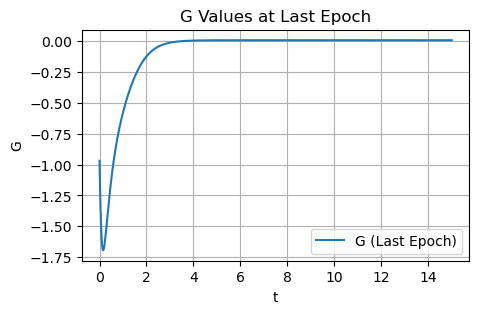

It 134500: loss = 8.56e-04,loss_G = 2.12e-01, alpha21 = 3.0589, alpha22 = 5.1073
Initial Condition: [20.00 -0.00 0.00 0.00]


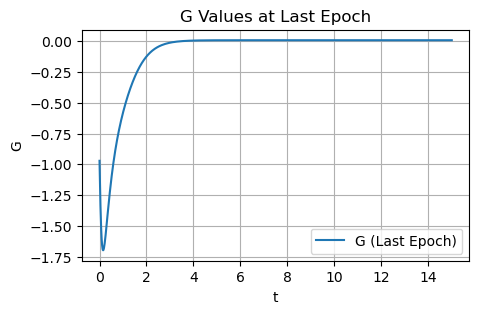

It 135000: loss = 8.85e-04,loss_G = 2.09e-01, alpha21 = 3.0587, alpha22 = 5.1055
Initial Condition: [20.00 -0.00 0.00 0.00]


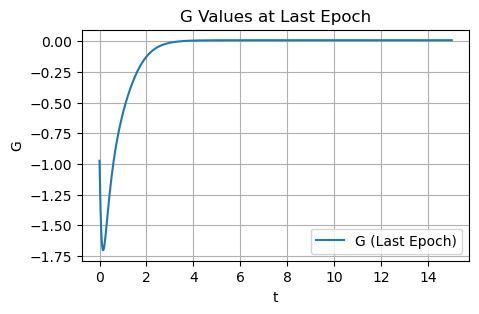

It 135500: loss = 8.53e-04,loss_G = 1.83e-01, alpha21 = 3.0575, alpha22 = 5.1058
Initial Condition: [20.00 0.00 0.00 0.00]


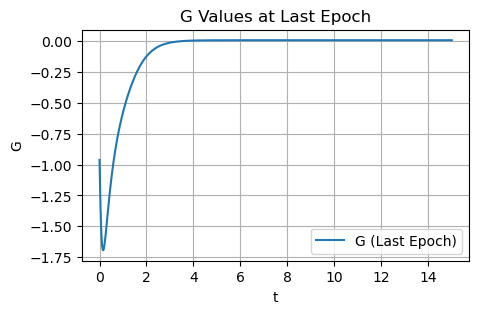

It 136000: loss = 8.53e-04,loss_G = 1.85e-01, alpha21 = 3.0574, alpha22 = 5.1054
Initial Condition: [20.00 0.00 0.00 0.00]


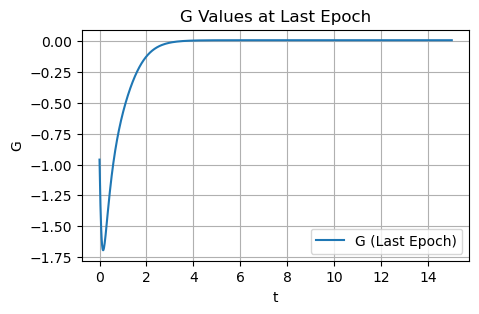

It 136500: loss = 1.11e-03,loss_G = 2.49e-01, alpha21 = 3.0563, alpha22 = 5.1023
Initial Condition: [20.00 0.00 0.00 0.00]


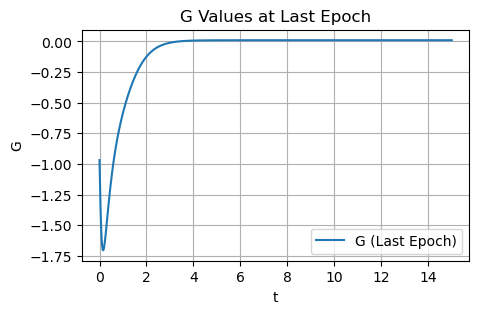

It 137000: loss = 1.08e-03,loss_G = 2.32e-01, alpha21 = 3.0552, alpha22 = 5.0998
Initial Condition: [20.00 -0.00 0.00 0.00]


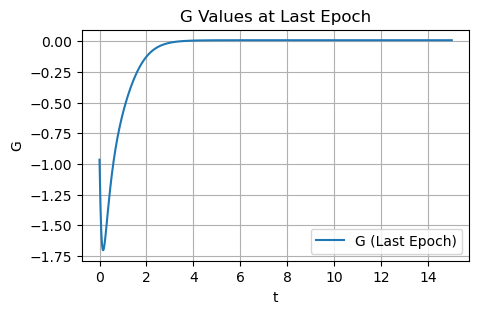

It 137500: loss = 8.53e-04,loss_G = 1.82e-01, alpha21 = 3.0563, alpha22 = 5.1033
Initial Condition: [20.00 0.00 0.00 0.00]


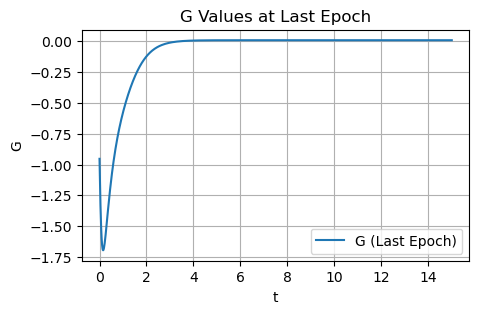

It 138000: loss = 8.53e-04,loss_G = 1.88e-01, alpha21 = 3.0572, alpha22 = 5.1045
Initial Condition: [20.00 0.00 0.00 0.00]


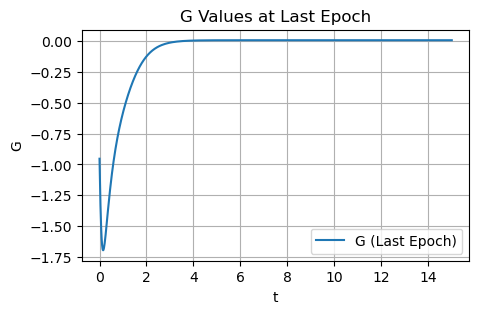

It 138500: loss = 1.01e-03,loss_G = 2.21e-01, alpha21 = 3.0564, alpha22 = 5.1011
Initial Condition: [20.00 0.00 -0.00 0.00]


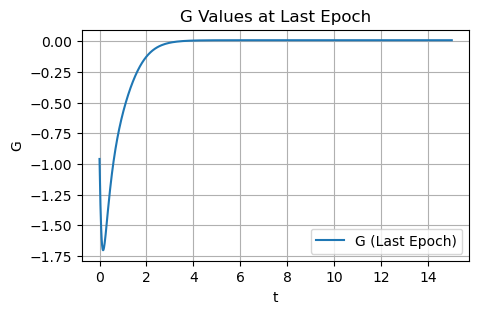

It 139000: loss = 8.53e-04,loss_G = 1.89e-01, alpha21 = 3.0558, alpha22 = 5.1017
Initial Condition: [20.00 0.00 0.00 -0.00]


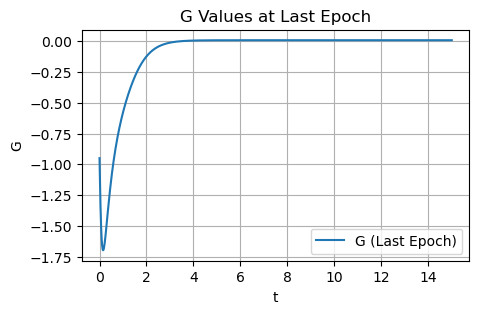

It 139500: loss = 8.63e-04,loss_G = 1.97e-01, alpha21 = 3.0552, alpha22 = 5.0998
Initial Condition: [20.00 -0.00 -0.00 -0.00]


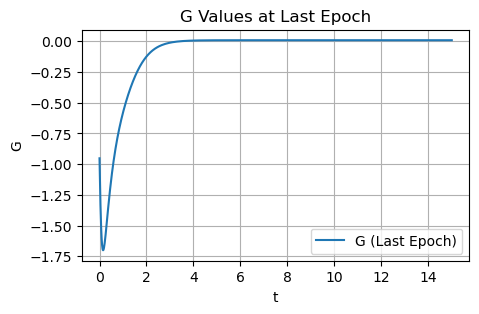

It 140000: loss = 1.43e-03,loss_G = 3.00e-01, alpha21 = 3.0540, alpha22 = 5.0912
Initial Condition: [20.00 -0.00 -0.00 -0.00]


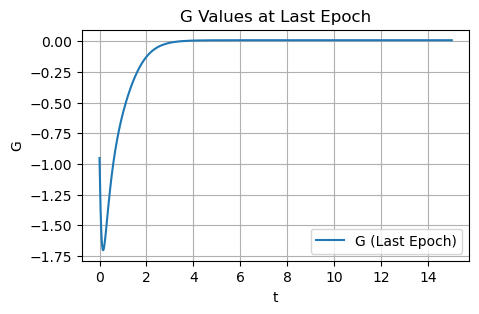

It 140500: loss = 8.78e-04,loss_G = 2.57e-01, alpha21 = 3.0546, alpha22 = 5.0949
Initial Condition: [20.00 -0.00 0.00 -0.00]


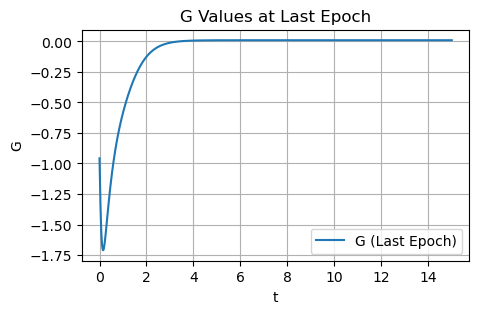

It 141000: loss = 8.53e-04,loss_G = 1.69e-01, alpha21 = 3.0527, alpha22 = 5.0971
Initial Condition: [20.00 0.00 0.00 0.00]


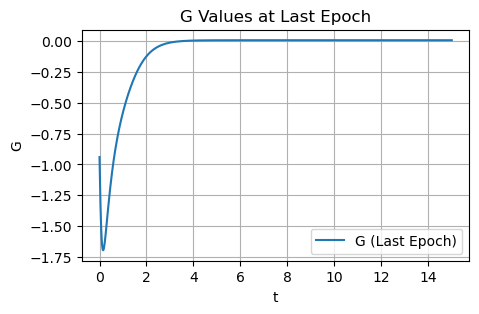

It 141500: loss = 8.53e-04,loss_G = 1.76e-01, alpha21 = 3.0547, alpha22 = 5.1005
Initial Condition: [20.00 0.00 0.00 0.00]


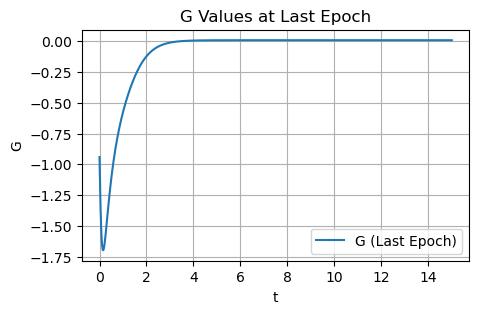

It 142000: loss = 1.13e-03,loss_G = 2.27e-01, alpha21 = 3.0542, alpha22 = 5.0953
Initial Condition: [20.00 0.00 0.00 0.00]


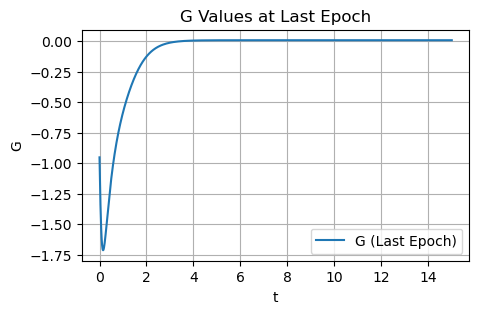

It 142500: loss = 7.72e-03,loss_G = 1.61e-01, alpha21 = 3.0537, alpha22 = 5.0963
Initial Condition: [20.00 0.00 -0.00 -0.00]


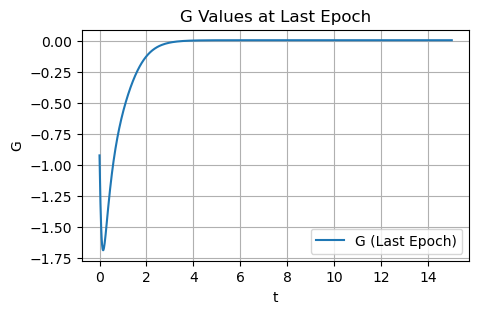

It 143000: loss = 5.70e-03,loss_G = 1.61e-01, alpha21 = 3.0506, alpha22 = 5.0958
Initial Condition: [19.99 0.00 -0.00 0.00]


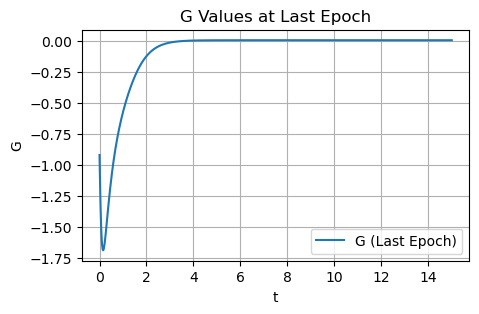

It 143500: loss = 1.01e-03,loss_G = 1.67e-01, alpha21 = 3.0517, alpha22 = 5.0954
Initial Condition: [20.00 0.00 0.00 0.00]


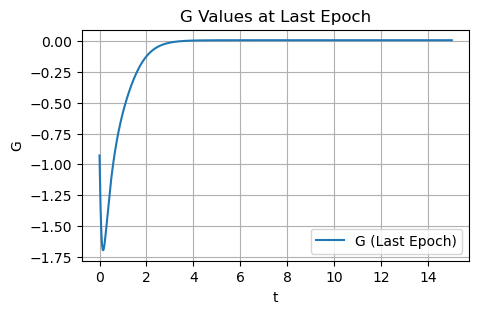

It 144000: loss = 1.96e-03,loss_G = 2.99e-01, alpha21 = 3.0524, alpha22 = 5.0947
Initial Condition: [20.00 0.00 0.00 0.00]


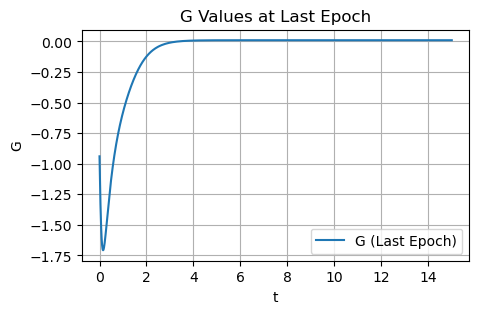

It 144500: loss = 8.71e-04,loss_G = 1.77e-01, alpha21 = 3.0519, alpha22 = 5.0949
Initial Condition: [20.00 -0.00 0.00 -0.00]


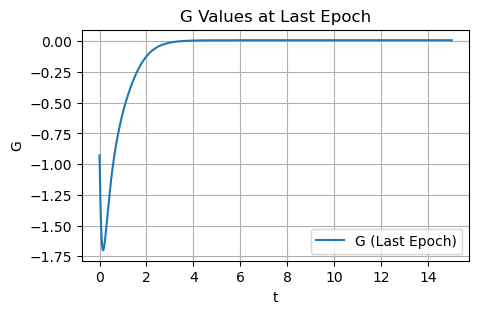

It 145000: loss = 4.03e-03,loss_G = 1.69e-01, alpha21 = 3.0513, alpha22 = 5.0926
Initial Condition: [20.00 -0.00 0.00 -0.00]


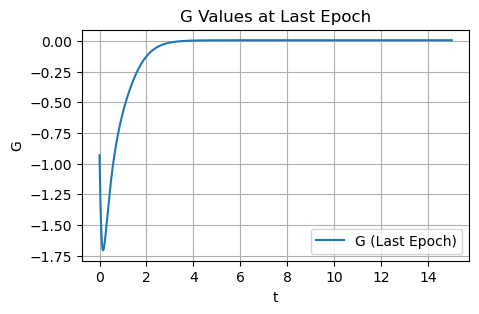

It 145500: loss = 9.94e-03,loss_G = 1.88e-01, alpha21 = 3.0524, alpha22 = 5.0926
Initial Condition: [20.01 -0.00 0.00 -0.00]


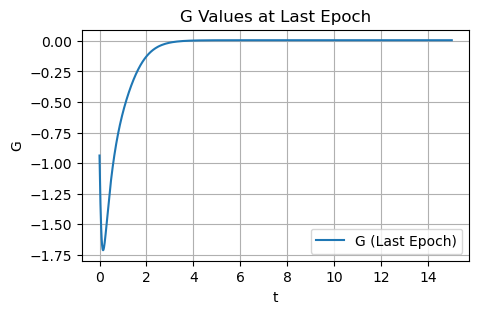

It 146000: loss = 3.86e-03,loss_G = 1.71e-01, alpha21 = 3.0498, alpha22 = 5.0939
Initial Condition: [20.00 0.00 -0.00 0.00]


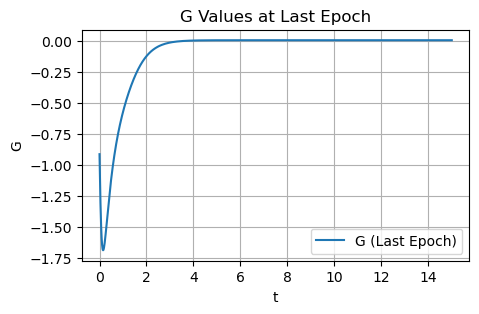

It 146500: loss = 1.09e-03,loss_G = 1.65e-01, alpha21 = 3.0504, alpha22 = 5.0904
Initial Condition: [20.00 -0.00 -0.00 -0.00]


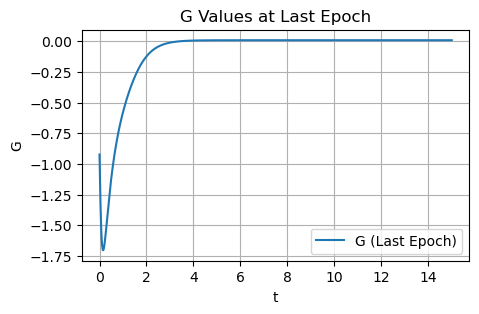

It 147000: loss = 8.53e-04,loss_G = 1.72e-01, alpha21 = 3.0519, alpha22 = 5.0954
Initial Condition: [20.00 0.00 0.00 0.00]


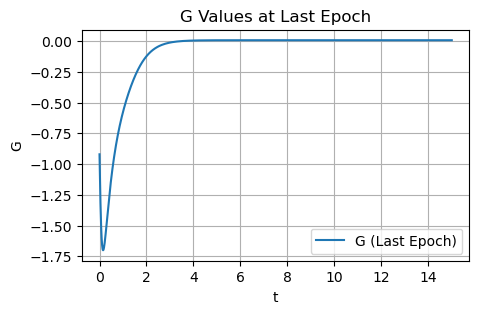

It 147500: loss = 1.19e-03,loss_G = 1.83e-01, alpha21 = 3.0503, alpha22 = 5.0904
Initial Condition: [20.00 -0.00 -0.00 -0.00]


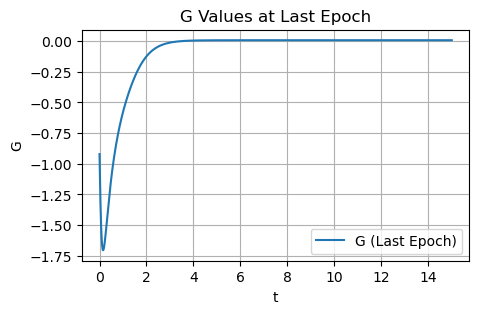

It 148000: loss = 8.52e-04,loss_G = 1.63e-01, alpha21 = 3.0502, alpha22 = 5.0923
Initial Condition: [20.00 0.00 0.00 0.00]


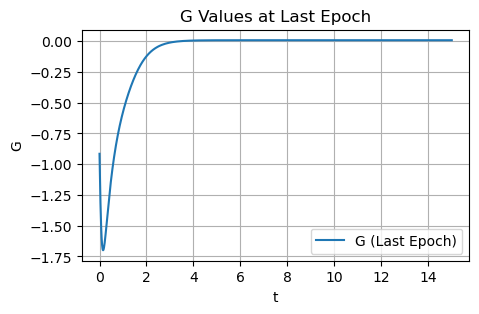

It 148500: loss = 8.52e-04,loss_G = 1.62e-01, alpha21 = 3.0485, alpha22 = 5.0892
Initial Condition: [20.00 0.00 0.00 0.00]


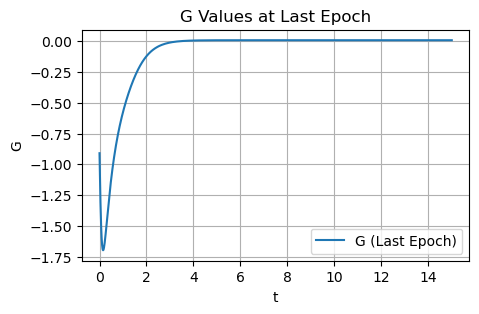

It 149000: loss = 8.58e-04,loss_G = 1.96e-01, alpha21 = 3.0497, alpha22 = 5.0904
Initial Condition: [20.00 0.00 0.00 0.00]


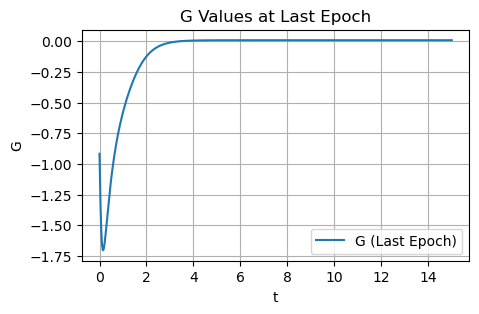

It 149500: loss = 8.63e-04,loss_G = 1.66e-01, alpha21 = 3.0484, alpha22 = 5.0888
Initial Condition: [20.00 0.00 0.00 0.00]


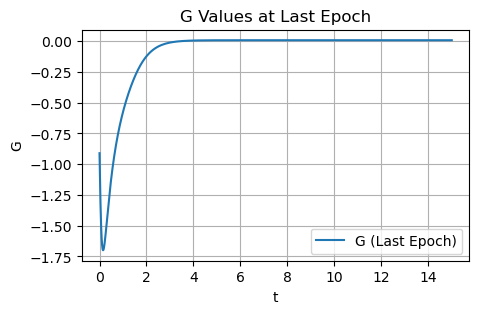

It 150000: loss = 1.16e-03,loss_G = 2.09e-01, alpha21 = 3.0480, alpha22 = 5.0885
Initial Condition: [20.00 0.00 0.00 0.00]


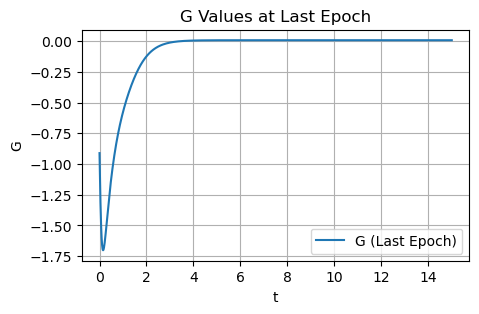

It 150500: loss = 8.52e-04,loss_G = 1.71e-01, alpha21 = 3.0492, alpha22 = 5.0902
Initial Condition: [20.00 0.00 0.00 0.00]


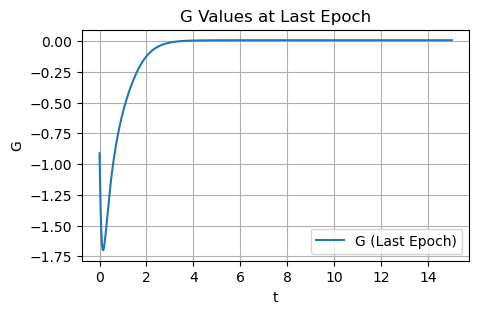

It 151000: loss = 8.52e-04,loss_G = 1.64e-01, alpha21 = 3.0495, alpha22 = 5.0911
Initial Condition: [20.00 0.00 0.00 0.00]


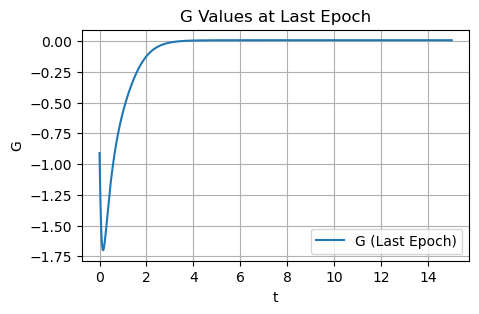

It 151500: loss = 8.52e-04,loss_G = 1.60e-01, alpha21 = 3.0482, alpha22 = 5.0889
Initial Condition: [20.00 0.00 0.00 0.00]


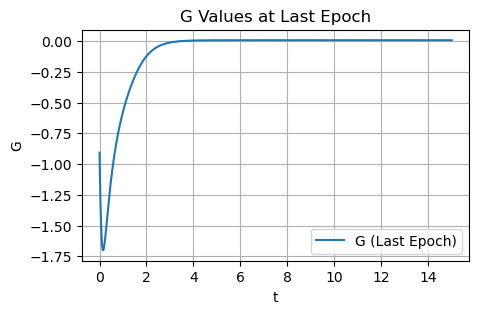

It 152000: loss = 1.08e-03,loss_G = 1.99e-01, alpha21 = 3.0485, alpha22 = 5.0863
Initial Condition: [20.00 -0.00 0.00 -0.00]


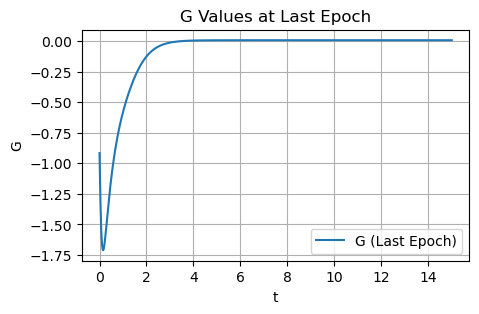

It 152500: loss = 8.52e-04,loss_G = 1.57e-01, alpha21 = 3.0466, alpha22 = 5.0858
Initial Condition: [20.00 0.00 0.00 0.00]


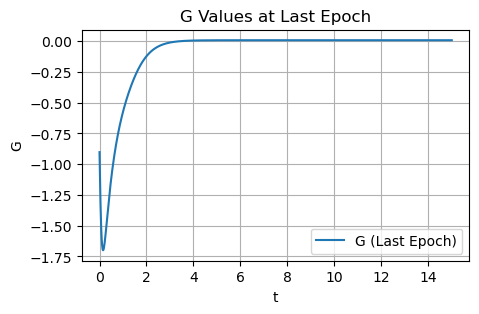

It 153000: loss = 8.52e-04,loss_G = 1.61e-01, alpha21 = 3.0482, alpha22 = 5.0889
Initial Condition: [20.00 0.00 0.00 0.00]


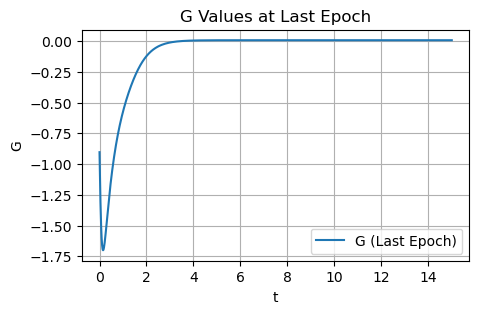

It 153500: loss = 9.07e-04,loss_G = 2.09e-01, alpha21 = 3.0472, alpha22 = 5.0856
Initial Condition: [20.00 0.00 0.00 0.00]


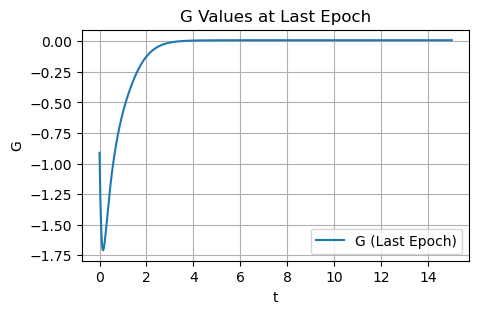

It 154000: loss = 8.52e-04,loss_G = 1.62e-01, alpha21 = 3.0468, alpha22 = 5.0860
Initial Condition: [20.00 0.00 0.00 0.00]


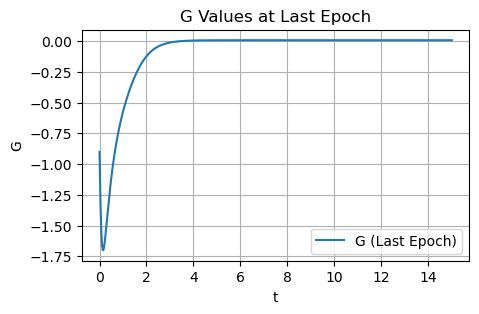

It 154500: loss = 2.53e-03,loss_G = 1.37e-01, alpha21 = 3.0472, alpha22 = 5.0824
Initial Condition: [20.00 -0.00 -0.00 -0.00]


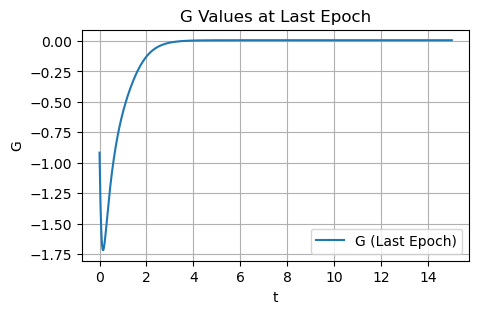

It 155000: loss = 8.61e-04,loss_G = 1.65e-01, alpha21 = 3.0454, alpha22 = 5.0832
Initial Condition: [20.00 0.00 0.00 0.00]


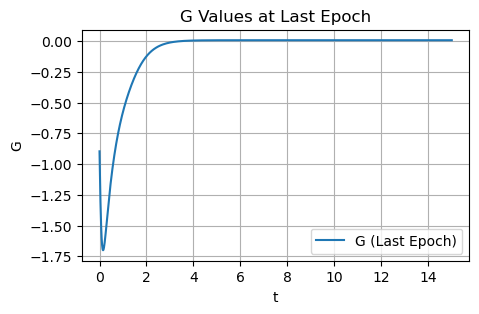

It 155500: loss = 9.59e-03,loss_G = 1.73e-01, alpha21 = 3.0465, alpha22 = 5.0829
Initial Condition: [20.00 -0.00 0.00 -0.00]


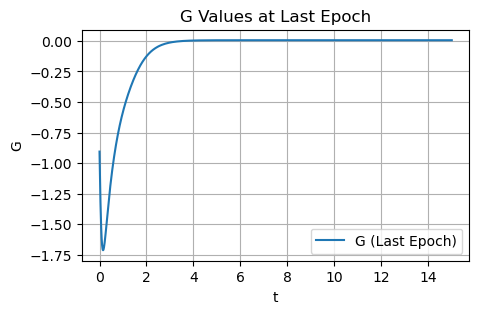

It 156000: loss = 3.57e-03,loss_G = 2.06e-01, alpha21 = 3.0461, alpha22 = 5.0832
Initial Condition: [20.00 0.00 -0.00 0.00]


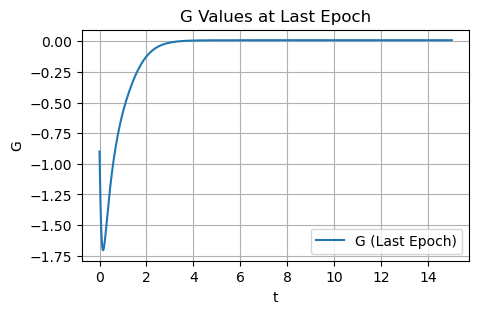

It 156500: loss = 8.58e-04,loss_G = 1.68e-01, alpha21 = 3.0449, alpha22 = 5.0821
Initial Condition: [20.00 0.00 0.00 0.00]


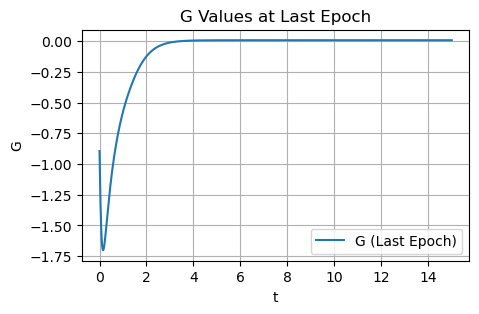

It 157000: loss = 8.52e-04,loss_G = 1.58e-01, alpha21 = 3.0465, alpha22 = 5.0856
Initial Condition: [20.00 0.00 0.00 0.00]


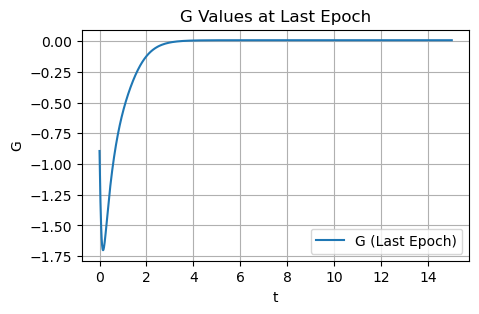

It 157500: loss = 8.60e-04,loss_G = 1.71e-01, alpha21 = 3.0449, alpha22 = 5.0822
Initial Condition: [20.00 0.00 0.00 0.00]


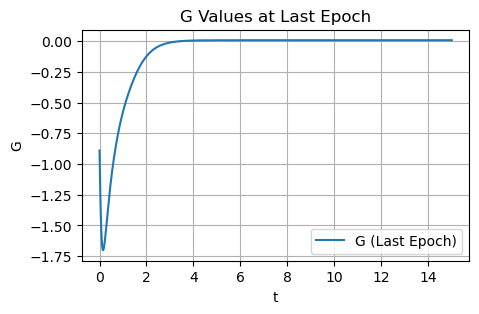

It 158000: loss = 8.52e-04,loss_G = 1.55e-01, alpha21 = 3.0452, alpha22 = 5.0833
Initial Condition: [20.00 0.00 0.00 0.00]


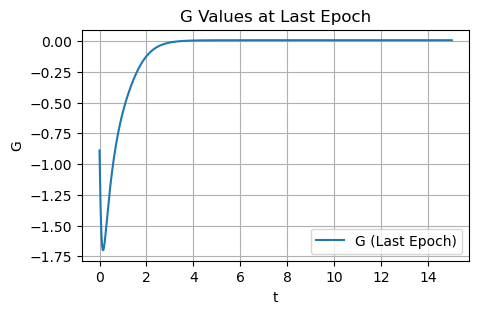

It 158500: loss = 8.53e-04,loss_G = 1.64e-01, alpha21 = 3.0450, alpha22 = 5.0823
Initial Condition: [20.00 0.00 0.00 0.00]


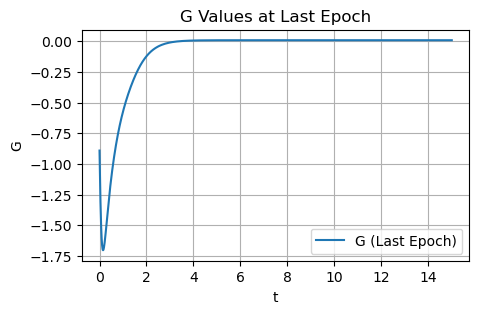

It 159000: loss = 1.06e-03,loss_G = 1.95e-01, alpha21 = 3.0448, alpha22 = 5.0785
Initial Condition: [20.00 -0.00 -0.00 -0.00]


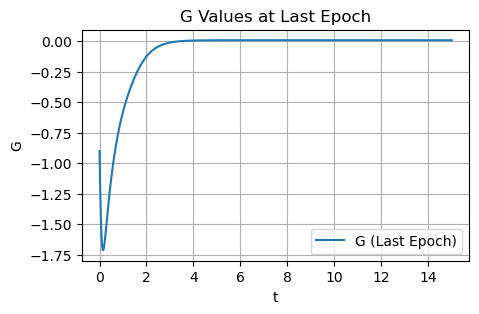

It 159500: loss = 1.21e-03,loss_G = 1.95e-01, alpha21 = 3.0437, alpha22 = 5.0787
Initial Condition: [20.00 -0.00 0.00 0.00]


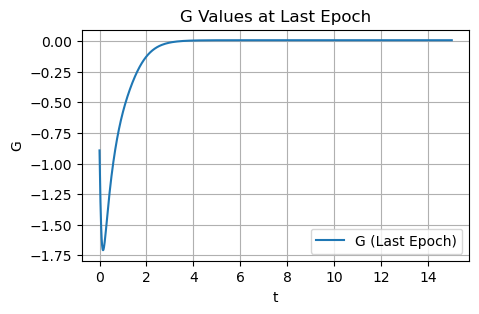

It 160000: loss = 1.22e-03,loss_G = 1.48e-01, alpha21 = 3.0429, alpha22 = 5.0799
Initial Condition: [20.00 -0.00 0.00 0.00]


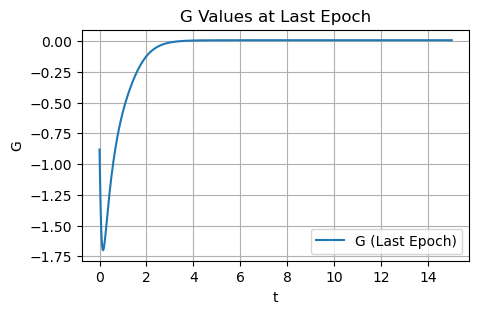

It 160500: loss = 5.06e-03,loss_G = 1.58e-01, alpha21 = 3.0443, alpha22 = 5.0793
Initial Condition: [20.00 -0.00 0.00 -0.00]


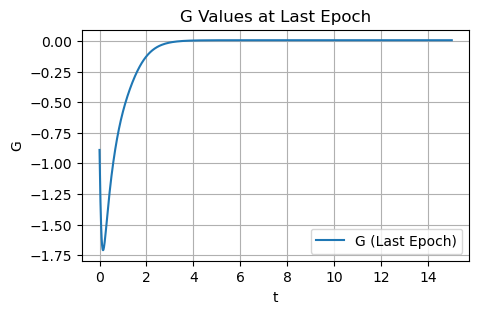

It 161000: loss = 1.10e-03,loss_G = 1.81e-01, alpha21 = 3.0437, alpha22 = 5.0785
Initial Condition: [20.00 -0.00 0.00 -0.00]


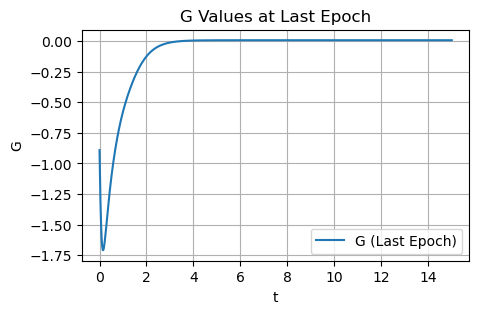

It 161500: loss = 8.54e-04,loss_G = 1.54e-01, alpha21 = 3.0431, alpha22 = 5.0791
Initial Condition: [20.00 0.00 0.00 0.00]


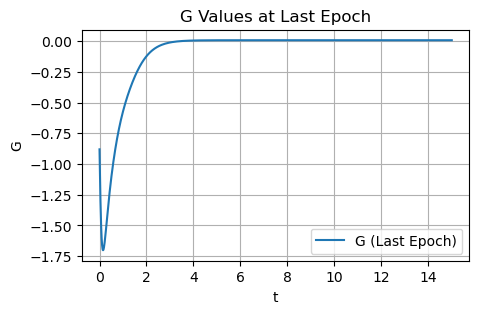

It 162000: loss = 8.54e-04,loss_G = 1.74e-01, alpha21 = 3.0429, alpha22 = 5.0776
Initial Condition: [20.00 -0.00 0.00 -0.00]


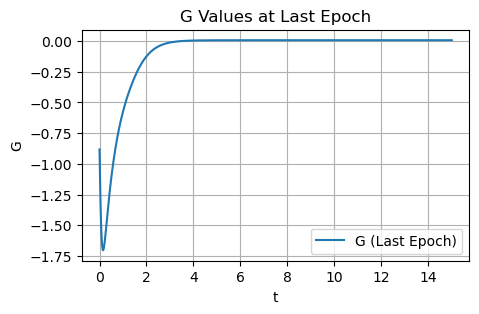

It 162500: loss = 1.14e-03,loss_G = 1.74e-01, alpha21 = 3.0423, alpha22 = 5.0766
Initial Condition: [20.00 -0.00 0.00 -0.00]


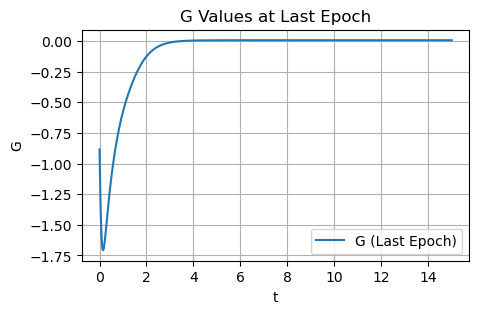

It 163000: loss = 2.72e-03,loss_G = 1.84e-01, alpha21 = 3.0429, alpha22 = 5.0750
Initial Condition: [20.00 0.00 -0.00 -0.00]


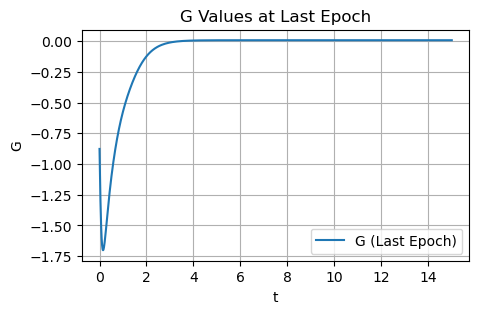

It 163500: loss = 8.52e-04,loss_G = 1.52e-01, alpha21 = 3.0434, alpha22 = 5.0799
Initial Condition: [20.00 0.00 0.00 0.00]


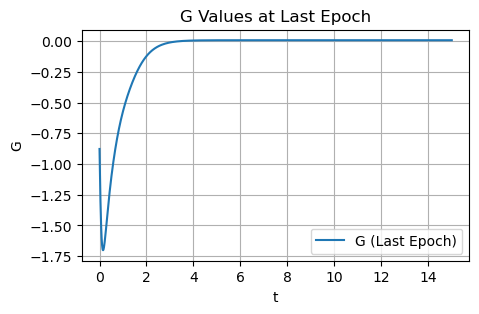

It 164000: loss = 8.53e-04,loss_G = 1.68e-01, alpha21 = 3.0434, alpha22 = 5.0791
Initial Condition: [20.00 0.00 0.00 0.00]


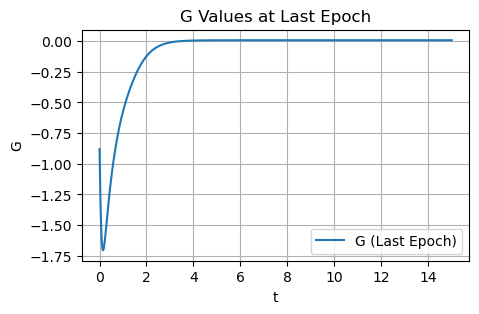

It 164500: loss = 8.77e-04,loss_G = 1.71e-01, alpha21 = 3.0427, alpha22 = 5.0779
Initial Condition: [20.00 0.00 0.00 0.00]


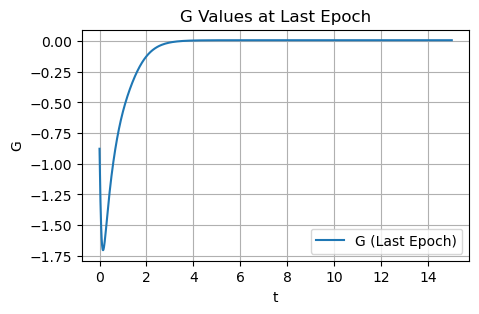

It 165000: loss = 1.16e-03,loss_G = 1.79e-01, alpha21 = 3.0426, alpha22 = 5.0757
Initial Condition: [20.00 -0.00 0.00 -0.00]


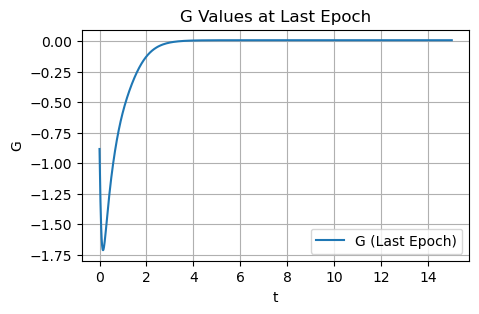

It 165500: loss = 8.52e-04,loss_G = 1.51e-01, alpha21 = 3.0415, alpha22 = 5.0764
Initial Condition: [20.00 0.00 0.00 0.00]


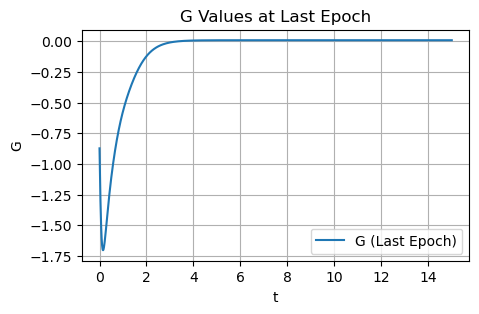

It 166000: loss = 8.52e-04,loss_G = 1.46e-01, alpha21 = 3.0414, alpha22 = 5.0764
Initial Condition: [20.00 0.00 0.00 0.00]


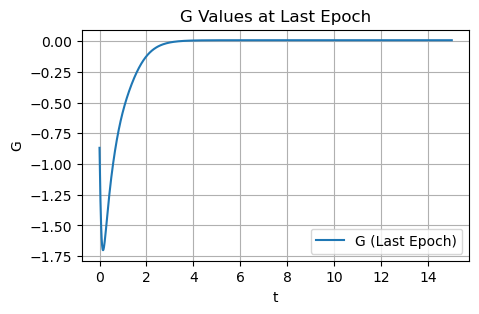

It 166500: loss = 1.03e-03,loss_G = 1.51e-01, alpha21 = 3.0399, alpha22 = 5.0738
Initial Condition: [20.00 0.00 -0.00 0.00]


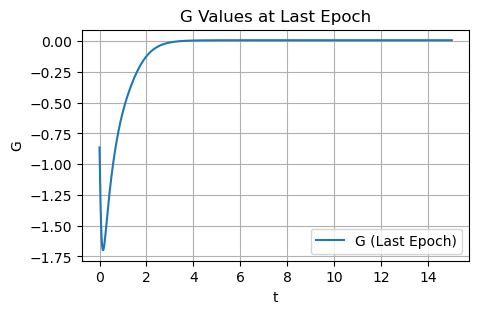

It 167000: loss = 9.51e-03,loss_G = 1.57e-01, alpha21 = 3.0421, alpha22 = 5.0738
Initial Condition: [20.01 -0.00 0.00 -0.00]


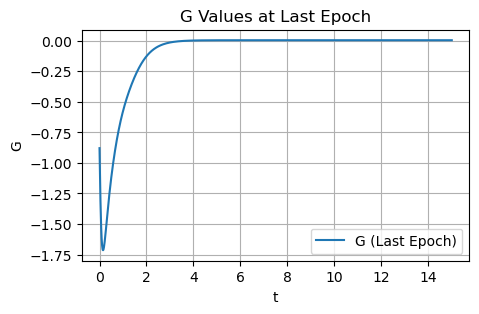

It 167500: loss = 8.52e-04,loss_G = 1.46e-01, alpha21 = 3.0407, alpha22 = 5.0750
Initial Condition: [20.00 0.00 0.00 0.00]


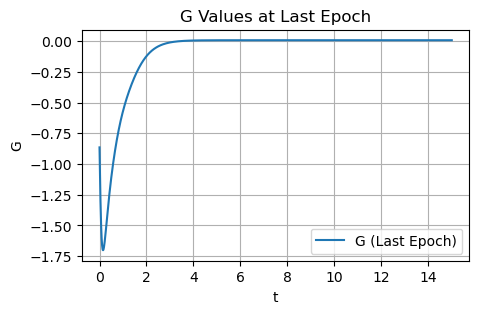

It 168000: loss = 8.65e-04,loss_G = 1.44e-01, alpha21 = 3.0399, alpha22 = 5.0737
Initial Condition: [20.00 -0.00 0.00 -0.00]


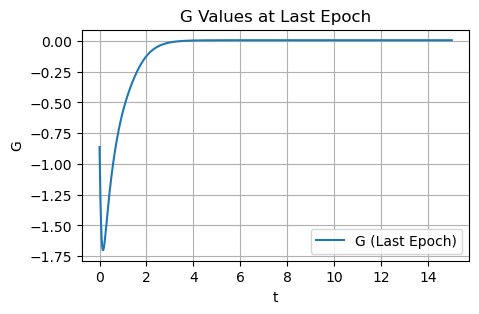

It 168500: loss = 8.52e-04,loss_G = 1.46e-01, alpha21 = 3.0403, alpha22 = 5.0744
Initial Condition: [20.00 0.00 0.00 0.00]


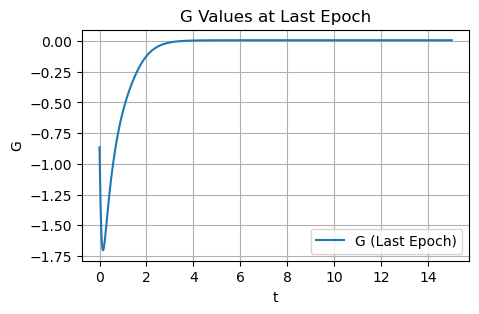

It 169000: loss = 1.05e-02,loss_G = 1.53e-01, alpha21 = 3.0425, alpha22 = 5.0724
Initial Condition: [20.01 -0.00 0.00 -0.01]


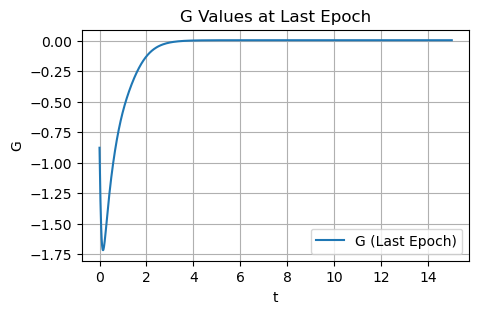

It 169500: loss = 8.54e-04,loss_G = 1.45e-01, alpha21 = 3.0403, alpha22 = 5.0744
Initial Condition: [20.00 -0.00 0.00 -0.00]


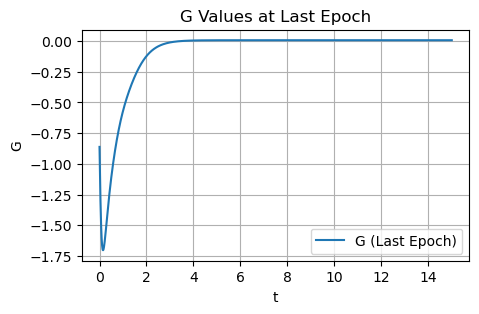

It 170000: loss = 8.52e-04,loss_G = 1.33e-01, alpha21 = 3.0355, alpha22 = 5.0658
Initial Condition: [20.00 0.00 0.00 0.00]


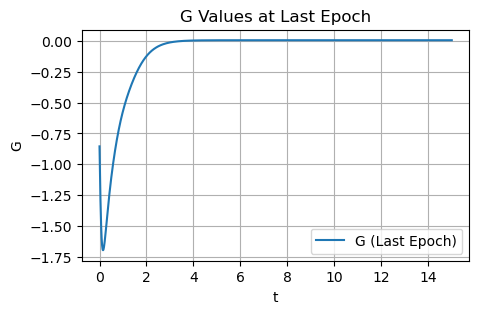

It 170500: loss = 8.52e-04,loss_G = 1.43e-01, alpha21 = 3.0391, alpha22 = 5.0722
Initial Condition: [20.00 0.00 0.00 0.00]


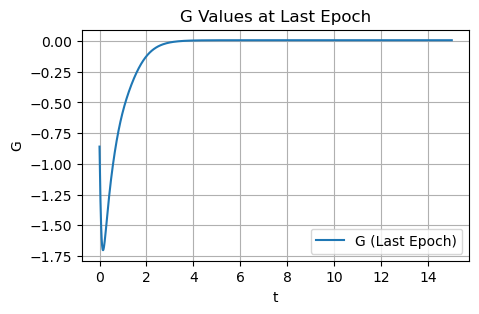

It 171000: loss = 8.61e-04,loss_G = 1.41e-01, alpha21 = 3.0384, alpha22 = 5.0708
Initial Condition: [20.00 -0.00 0.00 -0.00]


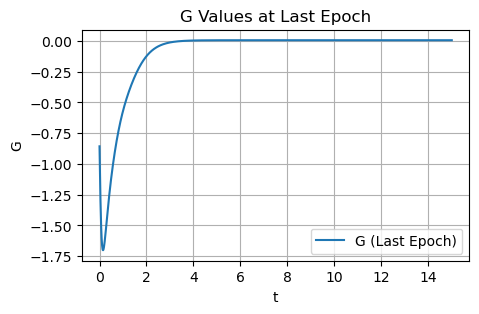

It 171500: loss = 1.06e-03,loss_G = 1.40e-01, alpha21 = 3.0381, alpha22 = 5.0692
Initial Condition: [20.00 -0.00 0.00 -0.00]


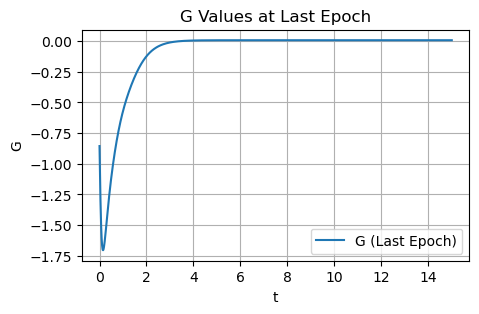

It 172000: loss = 2.36e-03,loss_G = 1.45e-01, alpha21 = 3.0386, alpha22 = 5.0693
Initial Condition: [20.00 -0.00 -0.00 -0.00]


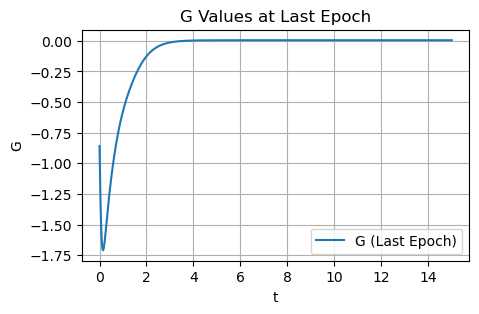

It 172500: loss = 9.15e-04,loss_G = 1.62e-01, alpha21 = 3.0387, alpha22 = 5.0699
Initial Condition: [20.00 -0.00 0.00 -0.00]


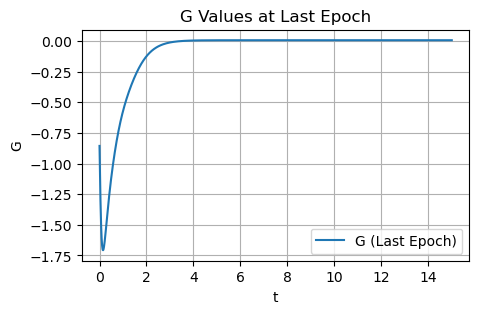

It 173000: loss = 1.15e-03,loss_G = 1.85e-01, alpha21 = 3.0382, alpha22 = 5.0706
Initial Condition: [20.00 -0.00 0.00 0.00]


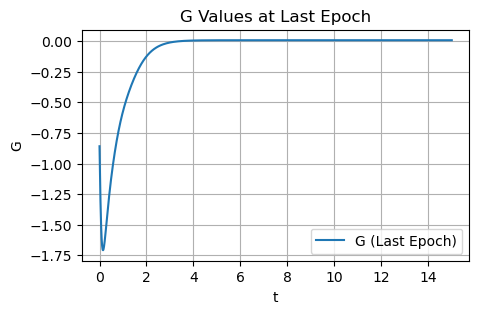

It 173500: loss = 1.40e-03,loss_G = 2.01e-01, alpha21 = 3.0392, alpha22 = 5.0636
Initial Condition: [20.01 0.00 -0.00 -0.00]


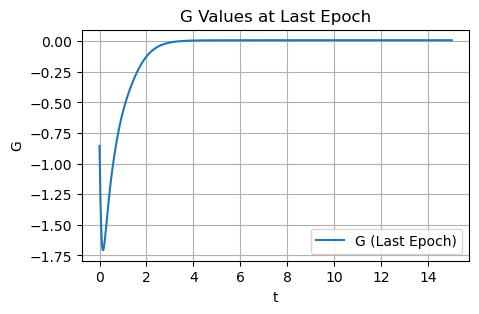

It 174000: loss = 8.52e-04,loss_G = 1.40e-01, alpha21 = 3.0373, alpha22 = 5.0690
Initial Condition: [20.00 0.00 0.00 0.00]


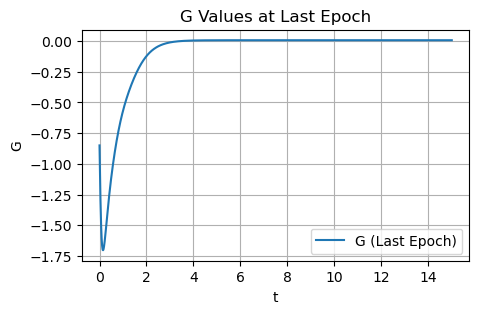

It 174500: loss = 8.52e-04,loss_G = 1.40e-01, alpha21 = 3.0371, alpha22 = 5.0685
Initial Condition: [20.00 0.00 0.00 0.00]


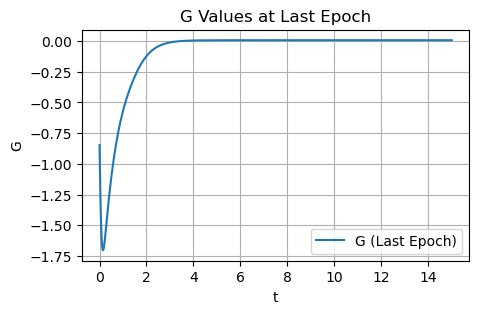

It 175000: loss = 8.52e-04,loss_G = 1.39e-01, alpha21 = 3.0366, alpha22 = 5.0676
Initial Condition: [20.00 0.00 0.00 0.00]


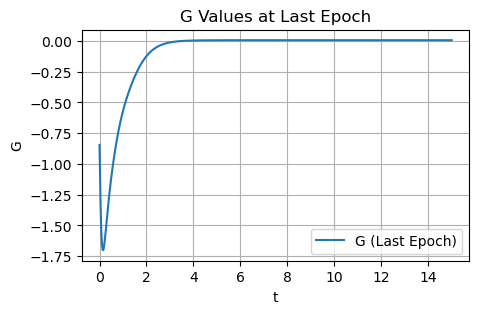

It 175500: loss = 8.52e-04,loss_G = 1.45e-01, alpha21 = 3.0372, alpha22 = 5.0685
Initial Condition: [20.00 0.00 0.00 0.00]


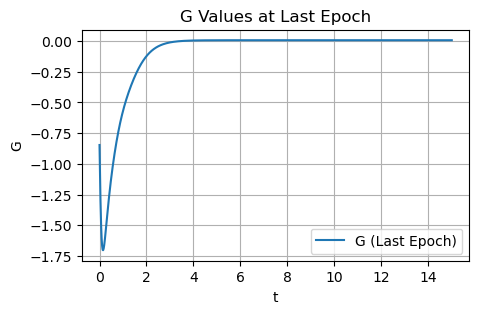

It 176000: loss = 8.52e-04,loss_G = 1.44e-01, alpha21 = 3.0363, alpha22 = 5.0668
Initial Condition: [20.00 0.00 0.00 0.00]


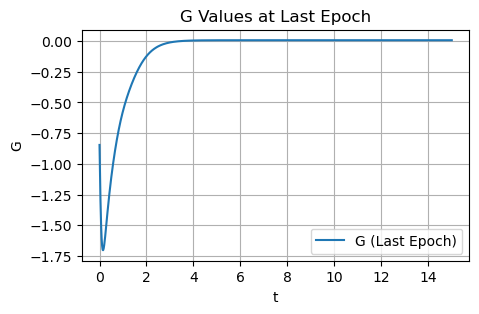

It 176500: loss = 8.54e-04,loss_G = 1.45e-01, alpha21 = 3.0346, alpha22 = 5.0631
Initial Condition: [20.00 0.00 0.00 0.00]


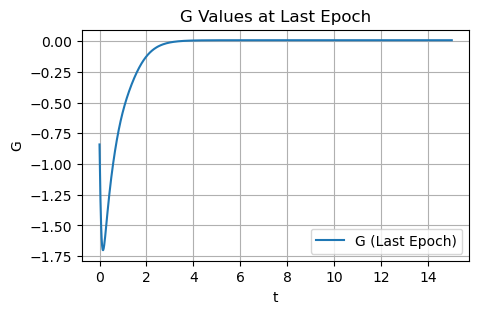

It 177000: loss = 8.96e-04,loss_G = 1.69e-01, alpha21 = 3.0367, alpha22 = 5.0655
Initial Condition: [20.00 0.00 0.00 0.00]


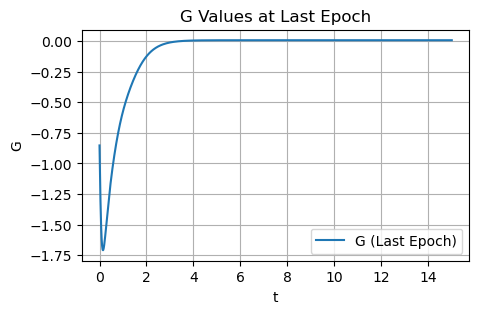

It 177500: loss = 1.03e-02,loss_G = 1.83e-01, alpha21 = 3.0341, alpha22 = 5.0682
Initial Condition: [19.99 0.01 -0.00 0.01]


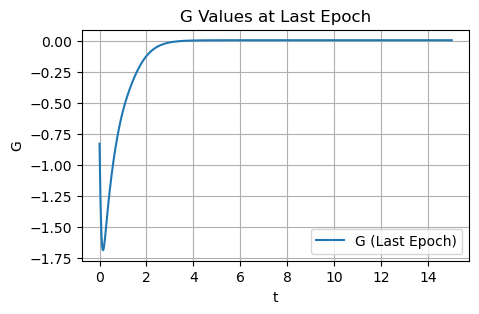

It 178000: loss = 8.52e-04,loss_G = 1.42e-01, alpha21 = 3.0366, alpha22 = 5.0674
Initial Condition: [20.00 0.00 0.00 0.00]


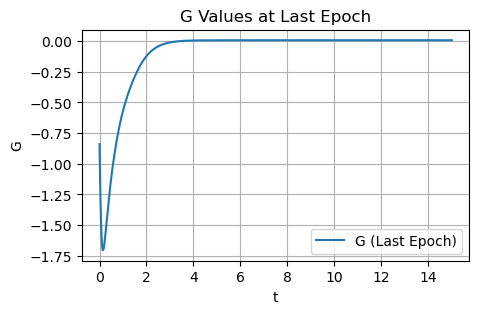

It 178500: loss = 9.01e-04,loss_G = 1.96e-01, alpha21 = 3.0367, alpha22 = 5.0655
Initial Condition: [20.00 0.00 0.00 0.00]


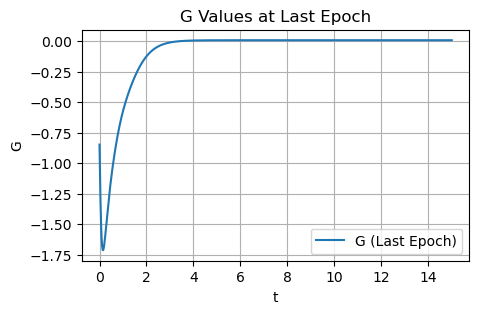

It 179000: loss = 9.46e-04,loss_G = 1.66e-01, alpha21 = 3.0367, alpha22 = 5.0660
Initial Condition: [20.00 -0.00 0.00 -0.00]


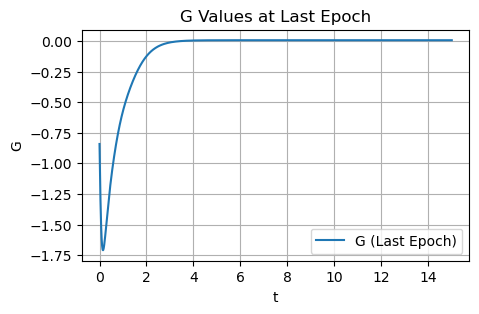

It 179500: loss = 8.52e-04,loss_G = 1.38e-01, alpha21 = 3.0346, alpha22 = 5.0637
Initial Condition: [20.00 0.00 0.00 0.00]


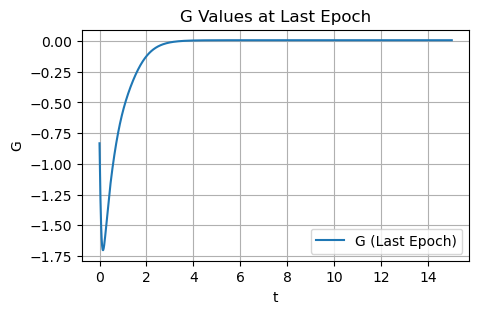

It 180000: loss = 9.66e-04,loss_G = 1.30e-01, alpha21 = 3.0372, alpha22 = 5.0658
Initial Condition: [20.00 -0.00 -0.00 -0.00]


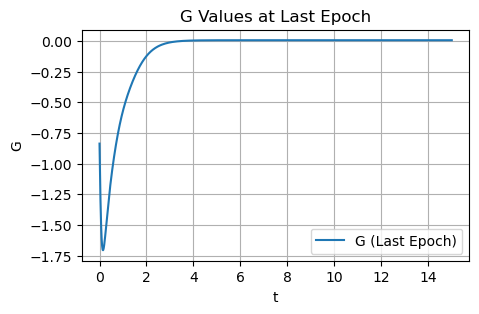

It 180500: loss = 8.77e-04,loss_G = 1.71e-01, alpha21 = 3.0343, alpha22 = 5.0618
Initial Condition: [20.00 -0.00 0.00 -0.00]


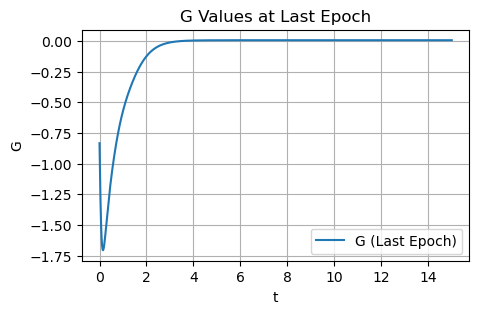

It 181000: loss = 8.52e-04,loss_G = 1.44e-01, alpha21 = 3.0360, alpha22 = 5.0663
Initial Condition: [20.00 0.00 0.00 0.00]


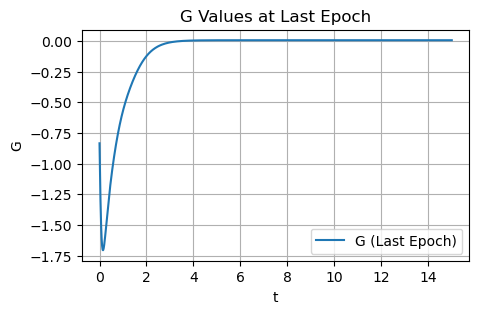

It 181500: loss = 4.09e-03,loss_G = 1.28e-01, alpha21 = 3.0359, alpha22 = 5.0629
Initial Condition: [20.00 -0.00 0.00 -0.00]


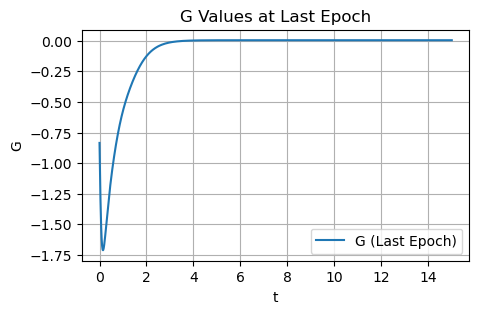

It 182000: loss = 8.59e-04,loss_G = 1.55e-01, alpha21 = 3.0354, alpha22 = 5.0646
Initial Condition: [20.00 0.00 0.00 0.00]


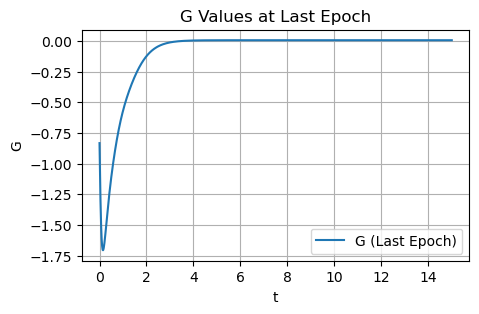

It 182500: loss = 3.70e-03,loss_G = 2.24e-01, alpha21 = 3.0343, alpha22 = 5.0631
Initial Condition: [20.00 0.00 0.00 0.00]


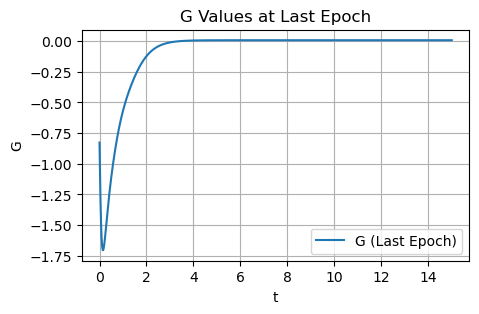

It 183000: loss = 9.66e-04,loss_G = 1.36e-01, alpha21 = 3.0349, alpha22 = 5.0634
Initial Condition: [20.00 -0.00 -0.00 -0.00]


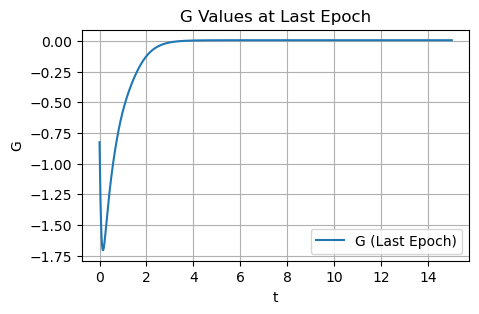

It 183500: loss = 8.53e-04,loss_G = 1.59e-01, alpha21 = 3.0338, alpha22 = 5.0610
Initial Condition: [20.00 -0.00 0.00 -0.00]


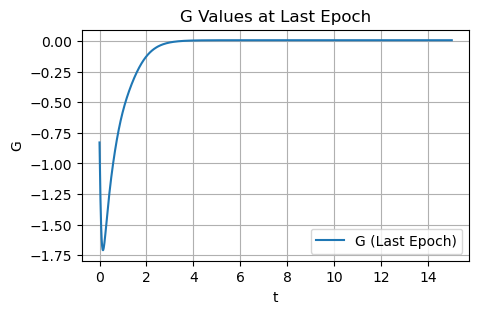

It 184000: loss = 8.61e-04,loss_G = 1.46e-01, alpha21 = 3.0338, alpha22 = 5.0618
Initial Condition: [20.00 0.00 0.00 0.00]


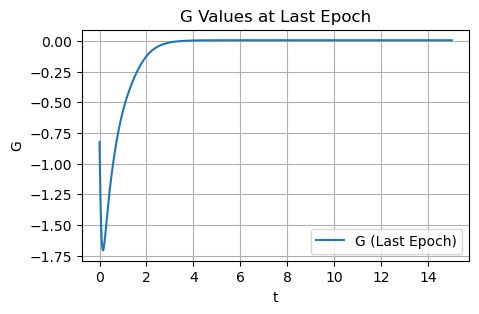

It 184500: loss = 8.53e-04,loss_G = 1.46e-01, alpha21 = 3.0336, alpha22 = 5.0618
Initial Condition: [20.00 0.00 0.00 0.00]


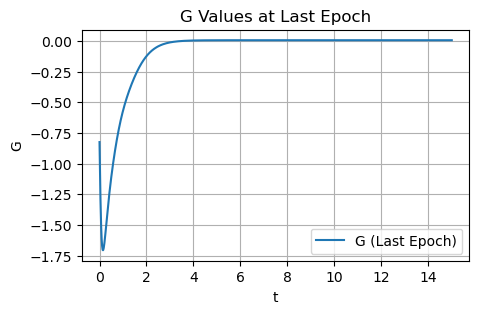

It 185000: loss = 8.55e-04,loss_G = 1.53e-01, alpha21 = 3.0334, alpha22 = 5.0611
Initial Condition: [20.00 0.00 0.00 0.00]


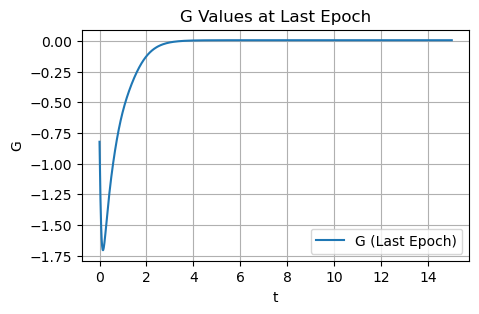

It 185500: loss = 8.52e-04,loss_G = 1.37e-01, alpha21 = 3.0332, alpha22 = 5.0614
Initial Condition: [20.00 0.00 0.00 -0.00]


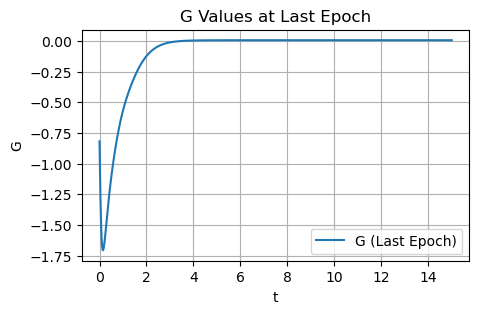

It 186000: loss = 8.52e-04,loss_G = 1.39e-01, alpha21 = 3.0331, alpha22 = 5.0609
Initial Condition: [20.00 0.00 0.00 0.00]


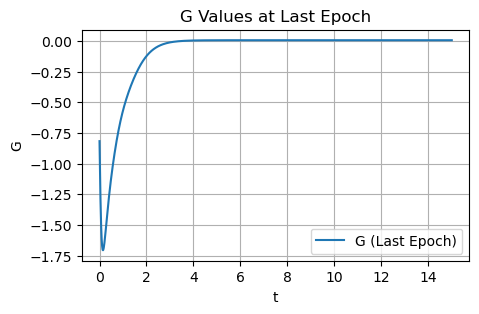

It 186500: loss = 8.74e-04,loss_G = 1.41e-01, alpha21 = 3.0327, alpha22 = 5.0598
Initial Condition: [20.00 -0.00 0.00 -0.00]


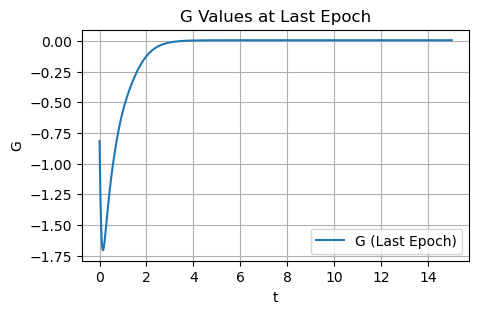

It 187000: loss = 2.32e-03,loss_G = 2.10e-01, alpha21 = 3.0327, alpha22 = 5.0587
Initial Condition: [20.00 0.00 -0.00 0.00]


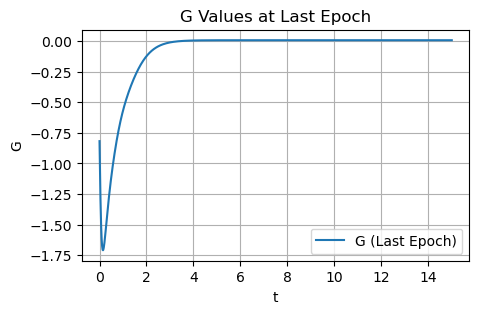

It 187500: loss = 8.52e-04,loss_G = 1.41e-01, alpha21 = 3.0323, alpha22 = 5.0593
Initial Condition: [20.00 0.00 0.00 0.00]


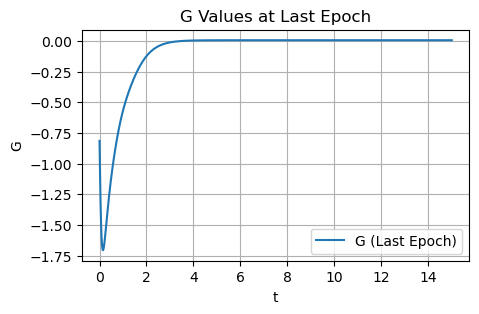

It 188000: loss = 8.54e-04,loss_G = 1.40e-01, alpha21 = 3.0303, alpha22 = 5.0555
Initial Condition: [20.00 0.00 0.00 0.00]


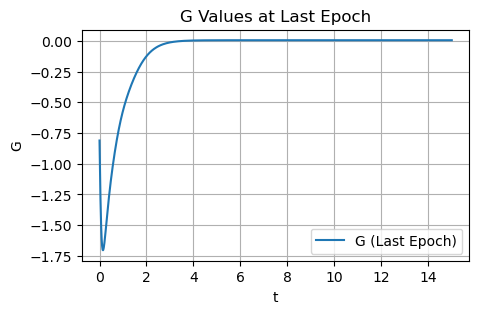

It 188500: loss = 8.52e-04,loss_G = 1.42e-01, alpha21 = 3.0322, alpha22 = 5.0592
Initial Condition: [20.00 0.00 0.00 0.00]


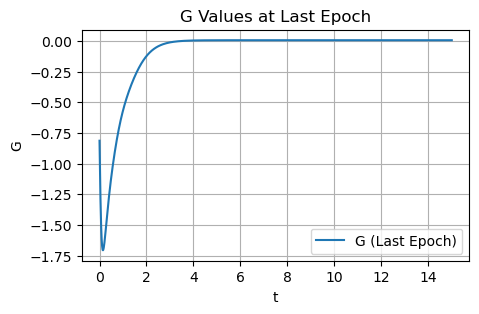

It 189000: loss = 9.41e-04,loss_G = 1.61e-01, alpha21 = 3.0317, alpha22 = 5.0570
Initial Condition: [20.00 0.00 -0.00 0.00]


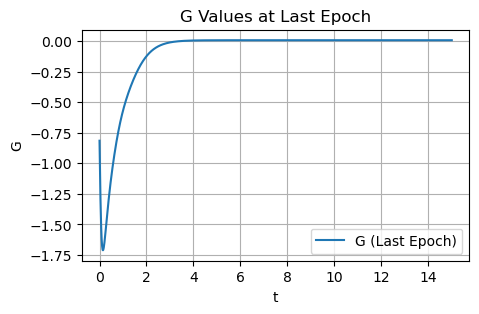

It 189500: loss = 8.84e-04,loss_G = 1.57e-01, alpha21 = 3.0318, alpha22 = 5.0576
Initial Condition: [20.00 0.00 0.00 0.00]


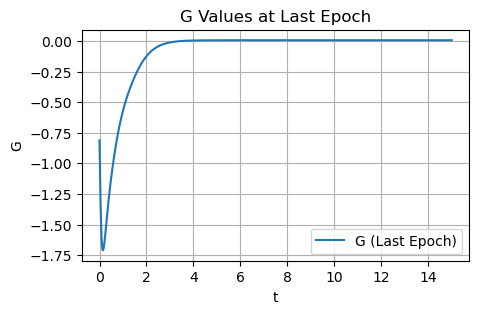

It 190000: loss = 8.52e-04,loss_G = 1.37e-01, alpha21 = 3.0315, alpha22 = 5.0580
Initial Condition: [20.00 0.00 0.00 -0.00]


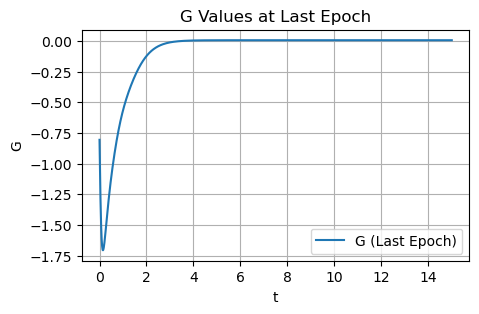

It 190500: loss = 8.52e-04,loss_G = 1.35e-01, alpha21 = 3.0317, alpha22 = 5.0586
Initial Condition: [20.00 0.00 0.00 0.00]


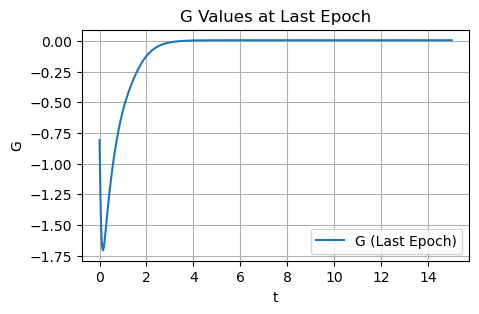

It 191000: loss = 8.52e-04,loss_G = 1.33e-01, alpha21 = 3.0308, alpha22 = 5.0568
Initial Condition: [20.00 0.00 0.00 -0.00]


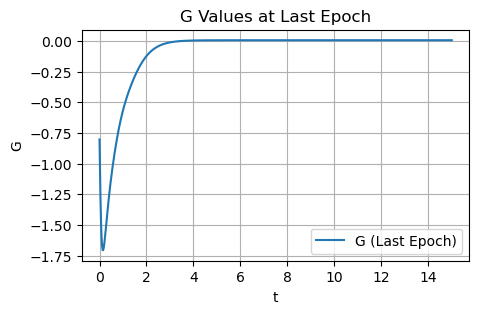

It 191500: loss = 8.52e-04,loss_G = 1.40e-01, alpha21 = 3.0310, alpha22 = 5.0568
Initial Condition: [20.00 0.00 0.00 0.00]


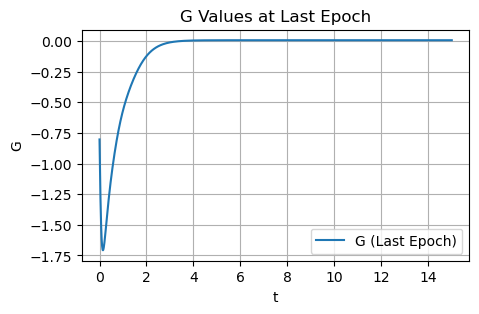

It 192000: loss = 9.07e-04,loss_G = 1.60e-01, alpha21 = 3.0311, alpha22 = 5.0559
Initial Condition: [20.00 -0.00 0.00 -0.00]


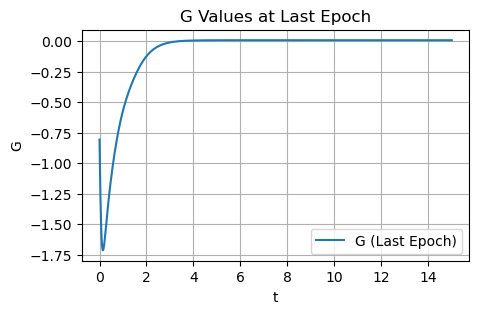

It 192500: loss = 8.52e-04,loss_G = 1.35e-01, alpha21 = 3.0303, alpha22 = 5.0558
Initial Condition: [20.00 0.00 0.00 0.00]


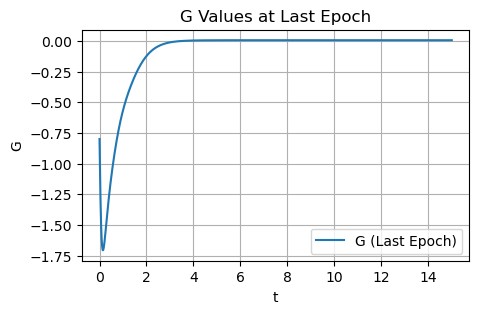

It 193000: loss = 8.53e-04,loss_G = 1.50e-01, alpha21 = 3.0303, alpha22 = 5.0553
Initial Condition: [20.00 0.00 0.00 0.00]


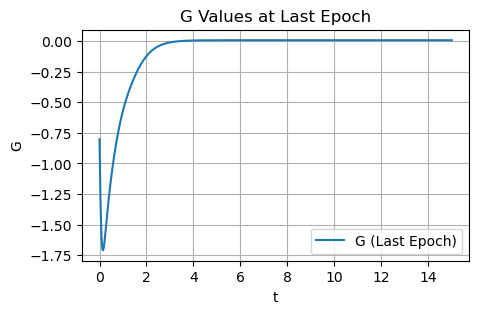

It 193500: loss = 9.03e-04,loss_G = 1.51e-01, alpha21 = 3.0286, alpha22 = 5.0530
Initial Condition: [20.00 0.00 0.00 0.00]


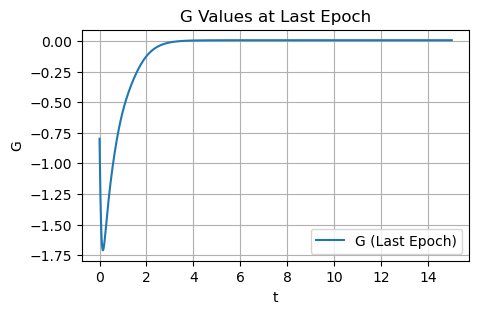

It 194000: loss = 8.52e-04,loss_G = 1.32e-01, alpha21 = 3.0288, alpha22 = 5.0532
Initial Condition: [20.00 0.00 0.00 0.00]


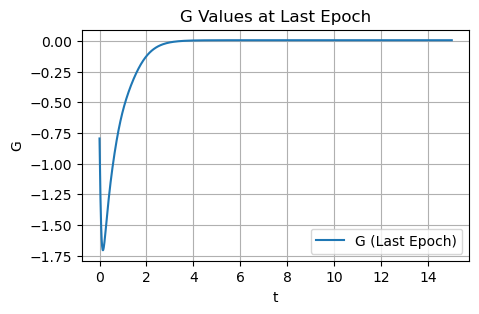

It 194500: loss = 1.84e-03,loss_G = 1.26e-01, alpha21 = 3.0287, alpha22 = 5.0516
Initial Condition: [20.00 -0.00 0.00 -0.00]


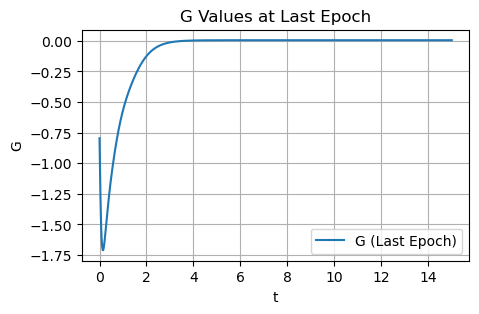

It 195000: loss = 8.52e-04,loss_G = 1.33e-01, alpha21 = 3.0280, alpha22 = 5.0513
Initial Condition: [20.00 0.00 0.00 -0.00]


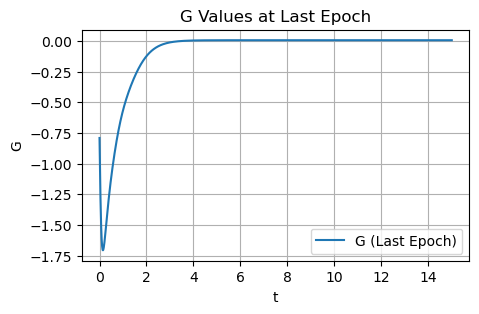

It 195500: loss = 9.43e-04,loss_G = 1.27e-01, alpha21 = 3.0279, alpha22 = 5.0517
Initial Condition: [20.00 0.00 0.00 0.00]


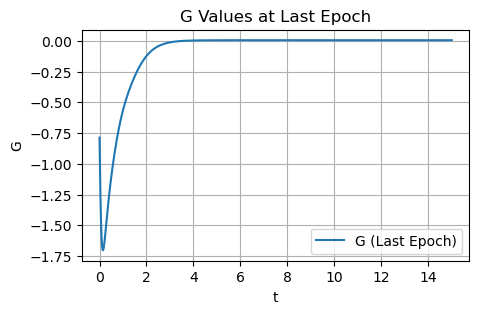

It 196000: loss = 8.59e-04,loss_G = 1.36e-01, alpha21 = 3.0282, alpha22 = 5.0516
Initial Condition: [20.00 -0.00 0.00 -0.00]


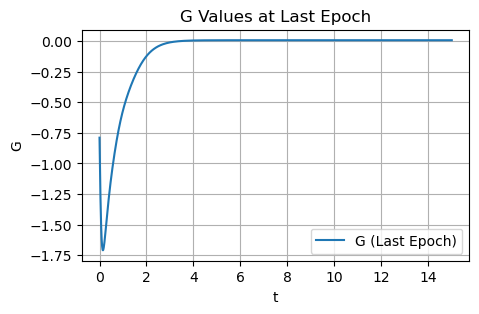

It 196500: loss = 9.33e-04,loss_G = 1.55e-01, alpha21 = 3.0286, alpha22 = 5.0507
Initial Condition: [20.00 -0.00 -0.00 -0.00]


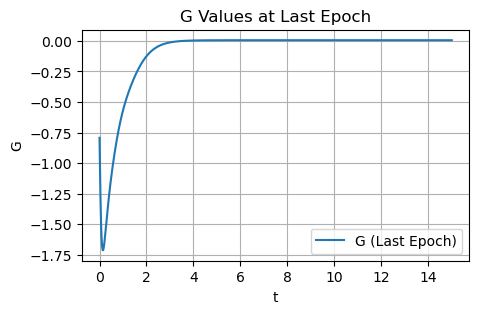

It 197000: loss = 5.05e-03,loss_G = 1.95e-01, alpha21 = 3.0267, alpha22 = 5.0514
Initial Condition: [20.00 0.00 0.00 0.00]


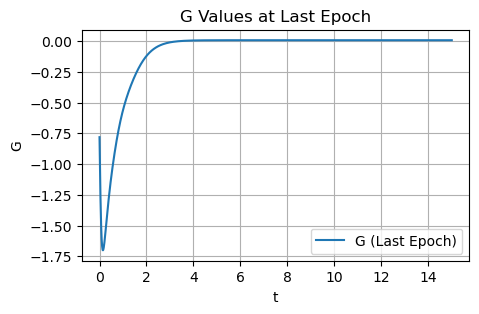

It 197500: loss = 9.31e-04,loss_G = 1.55e-01, alpha21 = 3.0277, alpha22 = 5.0504
Initial Condition: [20.00 0.00 0.00 0.00]


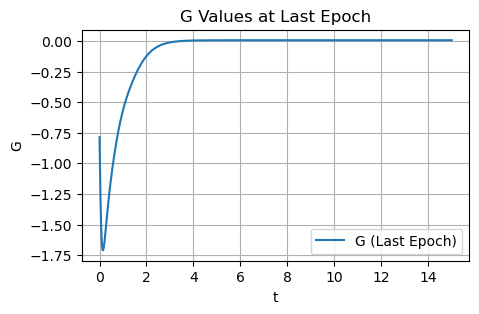

It 198000: loss = 8.70e-04,loss_G = 1.56e-01, alpha21 = 3.0283, alpha22 = 5.0500
Initial Condition: [20.00 -0.00 -0.00 -0.00]


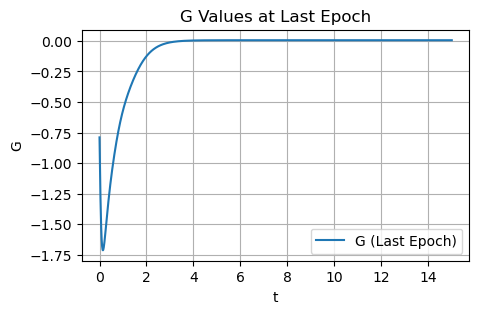

It 198500: loss = 8.53e-04,loss_G = 1.32e-01, alpha21 = 3.0267, alpha22 = 5.0489
Initial Condition: [20.00 0.00 0.00 0.00]


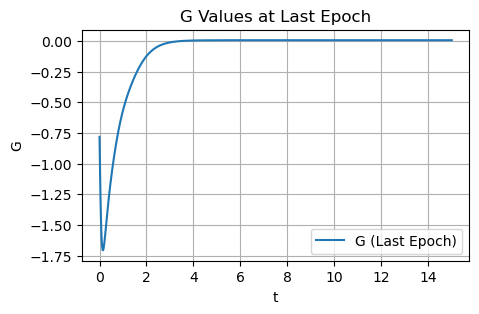

It 199000: loss = 9.06e-04,loss_G = 1.65e-01, alpha21 = 3.0281, alpha22 = 5.0504
Initial Condition: [20.00 0.00 -0.00 0.00]


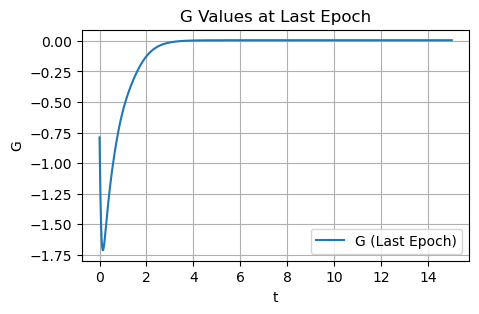

It 199500: loss = 1.02e-03,loss_G = 1.60e-01, alpha21 = 3.0274, alpha22 = 5.0490
Initial Condition: [20.00 0.00 -0.00 0.00]


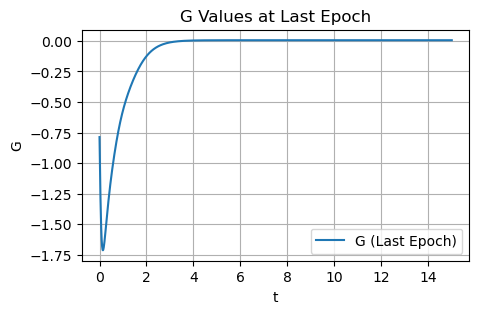

It 200000: loss = 8.52e-04,loss_G = 1.29e-01, alpha21 = 3.0272, alpha22 = 5.0503
Initial Condition: [20.00 0.00 0.00 0.00]


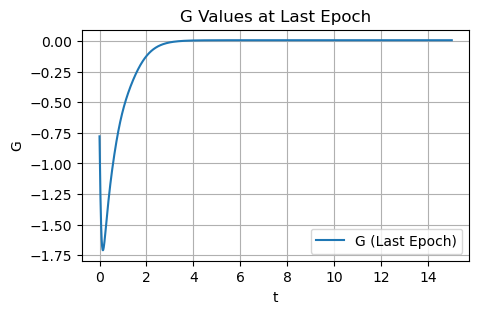

It 200500: loss = 8.52e-04,loss_G = 1.28e-01, alpha21 = 3.0266, alpha22 = 5.0493
Initial Condition: [20.00 0.00 0.00 0.00]


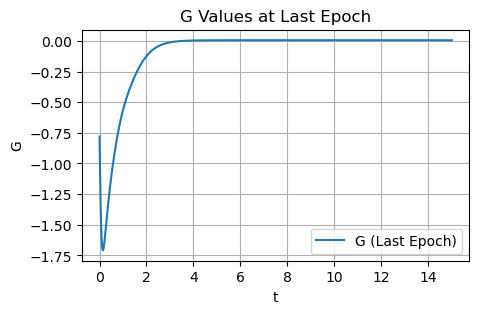

It 201000: loss = 8.52e-04,loss_G = 1.31e-01, alpha21 = 3.0276, alpha22 = 5.0510
Initial Condition: [20.00 0.00 0.00 0.00]


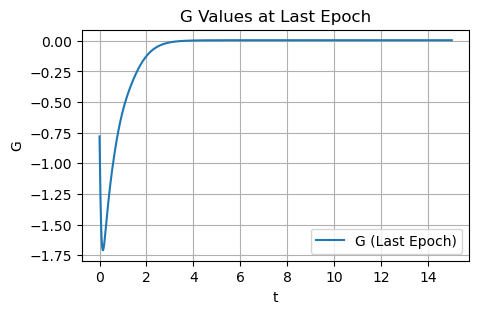

It 201500: loss = 8.53e-04,loss_G = 1.41e-01, alpha21 = 3.0270, alpha22 = 5.0491
Initial Condition: [20.00 -0.00 0.00 -0.00]


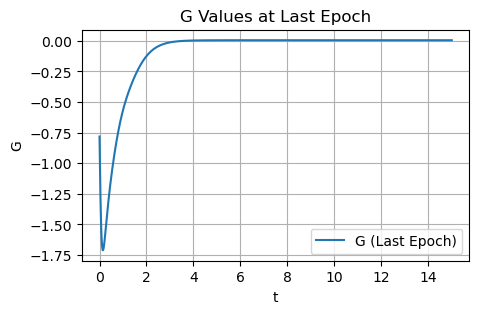

It 202000: loss = 8.52e-04,loss_G = 1.35e-01, alpha21 = 3.0268, alpha22 = 5.0492
Initial Condition: [20.00 0.00 0.00 0.00]


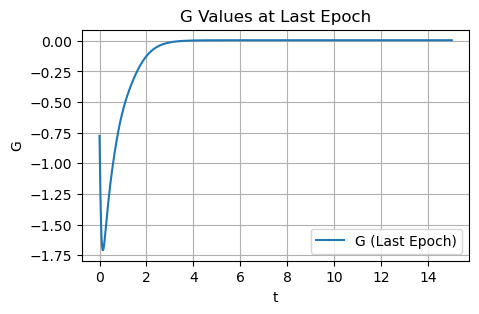

It 202500: loss = 8.52e-04,loss_G = 1.30e-01, alpha21 = 3.0269, alpha22 = 5.0498
Initial Condition: [20.00 0.00 0.00 0.00]


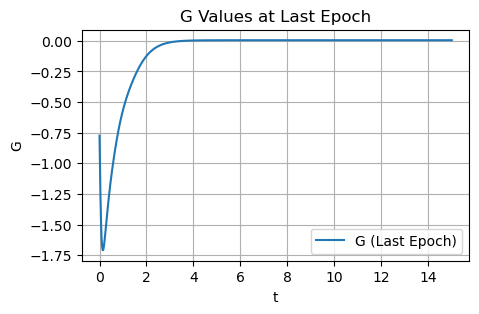

It 203000: loss = 8.52e-04,loss_G = 1.31e-01, alpha21 = 3.0265, alpha22 = 5.0488
Initial Condition: [20.00 0.00 0.00 0.00]


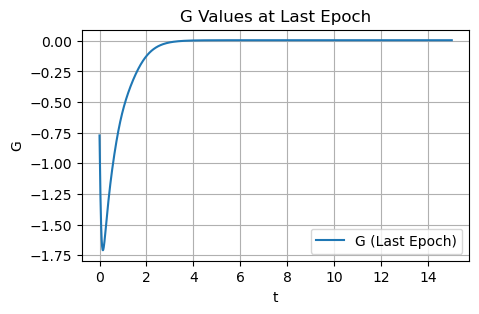

It 203500: loss = 8.93e-04,loss_G = 1.47e-01, alpha21 = 3.0262, alpha22 = 5.0471
Initial Condition: [20.00 0.00 0.00 0.00]


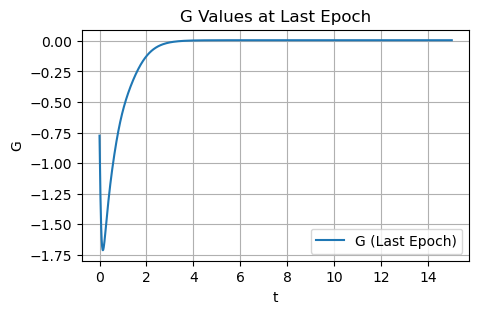

It 204000: loss = 8.53e-04,loss_G = 1.34e-01, alpha21 = 3.0260, alpha22 = 5.0477
Initial Condition: [20.00 0.00 0.00 0.00]


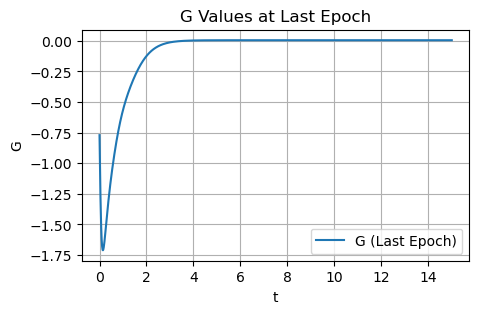

It 204500: loss = 8.54e-04,loss_G = 1.26e-01, alpha21 = 3.0257, alpha22 = 5.0474
Initial Condition: [20.00 -0.00 0.00 -0.00]


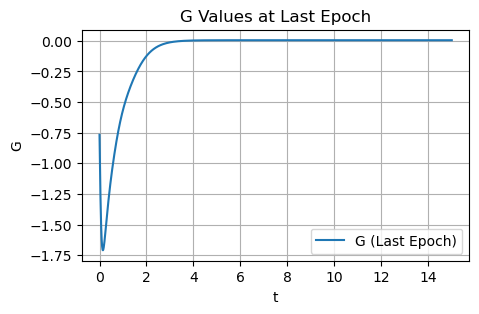

It 205000: loss = 8.52e-04,loss_G = 1.25e-01, alpha21 = 3.0251, alpha22 = 5.0464
Initial Condition: [20.00 0.00 0.00 -0.00]


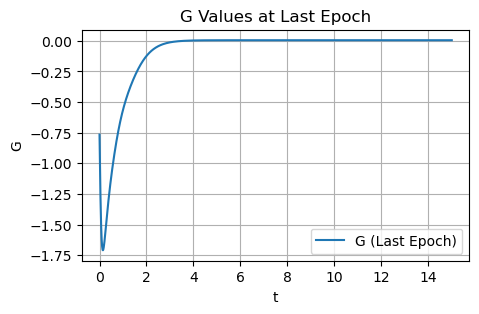

It 205500: loss = 1.12e-03,loss_G = 1.26e-01, alpha21 = 3.0237, alpha22 = 5.0447
Initial Condition: [20.00 0.00 -0.00 0.00]


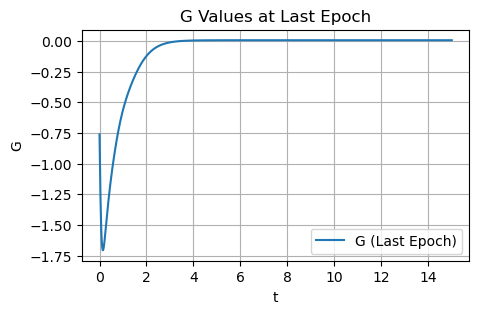

It 206000: loss = 8.73e-04,loss_G = 1.26e-01, alpha21 = 3.0238, alpha22 = 5.0435
Initial Condition: [20.00 -0.00 0.00 -0.00]


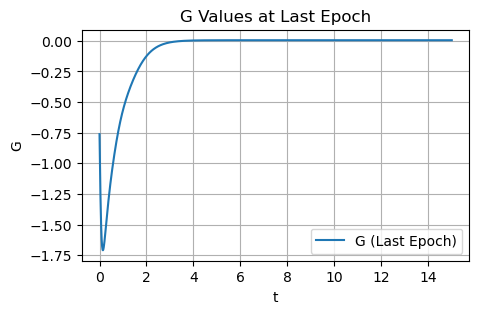

It 206500: loss = 1.45e-03,loss_G = 1.46e-01, alpha21 = 3.0256, alpha22 = 5.0438
Initial Condition: [20.00 0.00 -0.00 -0.00]


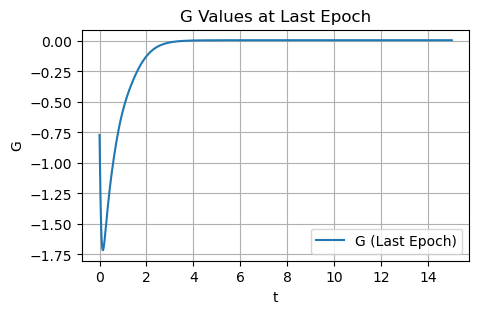

It 207000: loss = 8.55e-04,loss_G = 1.32e-01, alpha21 = 3.0240, alpha22 = 5.0438
Initial Condition: [20.00 0.00 0.00 0.00]


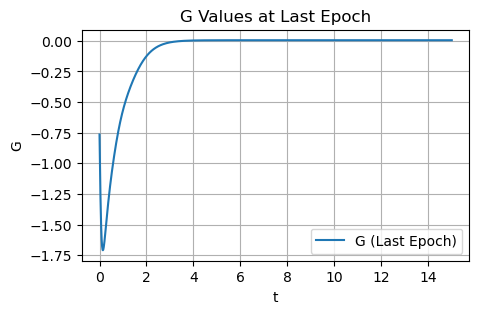

It 207500: loss = 8.79e-04,loss_G = 1.44e-01, alpha21 = 3.0241, alpha22 = 5.0422
Initial Condition: [20.00 -0.00 -0.00 -0.00]


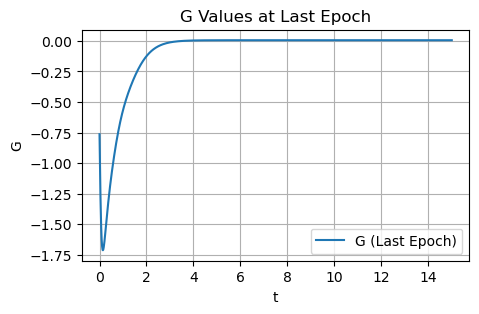

It 208000: loss = 1.00e-03,loss_G = 1.69e-01, alpha21 = 3.0232, alpha22 = 5.0406
Initial Condition: [20.00 0.00 -0.00 -0.00]


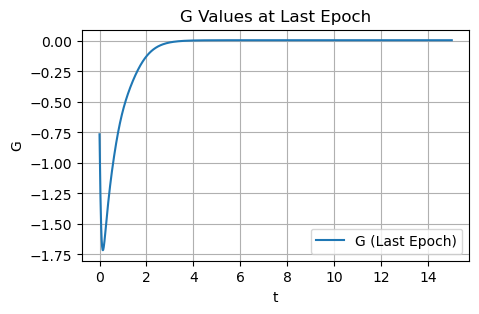

It 208500: loss = 4.43e-03,loss_G = 1.63e-01, alpha21 = 3.0227, alpha22 = 5.0392
Initial Condition: [20.00 -0.00 0.00 0.00]


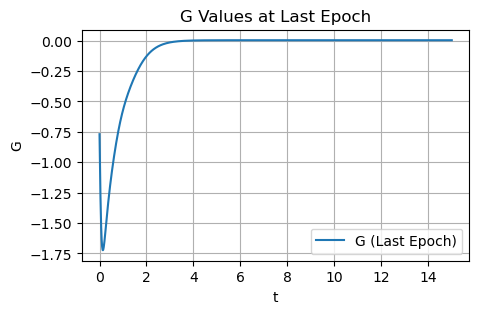

It 209000: loss = 1.18e-03,loss_G = 1.61e-01, alpha21 = 3.0233, alpha22 = 5.0419
Initial Condition: [20.00 0.00 -0.00 0.00]


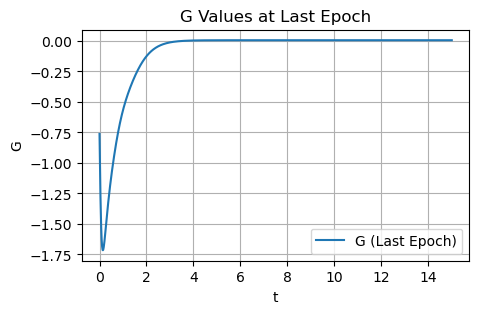

It 209500: loss = 8.52e-04,loss_G = 1.30e-01, alpha21 = 3.0232, alpha22 = 5.0426
Initial Condition: [20.00 0.00 0.00 0.00]


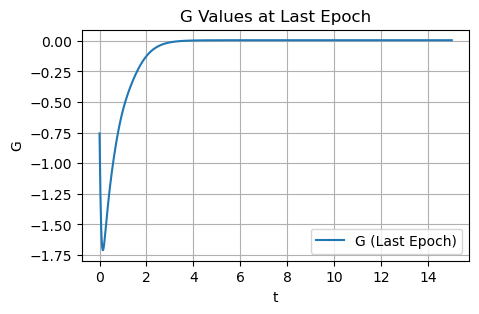

It 210000: loss = 8.52e-04,loss_G = 1.24e-01, alpha21 = 3.0228, alpha22 = 5.0421
Initial Condition: [20.00 0.00 0.00 0.00]


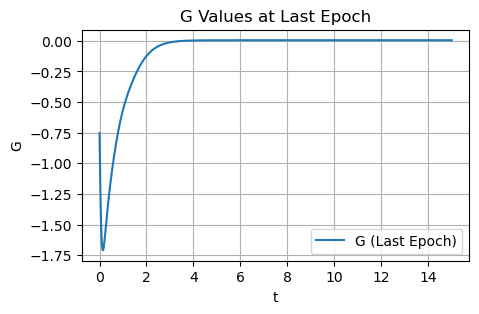

It 210500: loss = 1.52e-03,loss_G = 1.72e-01, alpha21 = 3.0235, alpha22 = 5.0396
Initial Condition: [20.00 -0.00 0.00 -0.00]


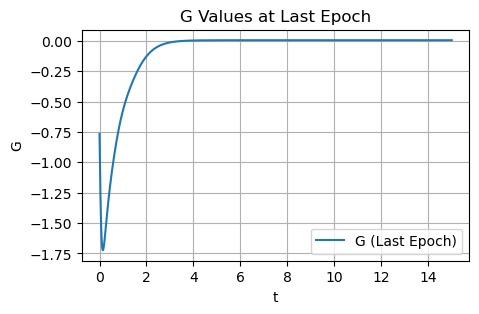

It 211000: loss = 1.10e-03,loss_G = 1.56e-01, alpha21 = 3.0227, alpha22 = 5.0398
Initial Condition: [20.00 0.00 -0.00 0.00]


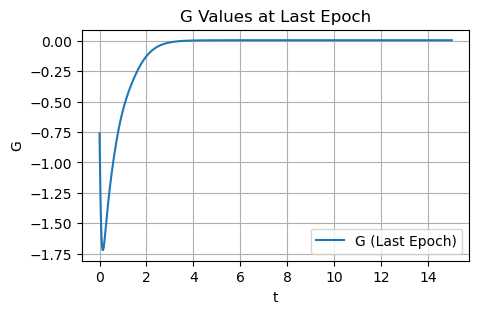

It 211500: loss = 2.40e-03,loss_G = 1.15e-01, alpha21 = 3.0222, alpha22 = 5.0400
Initial Condition: [20.00 -0.00 0.00 -0.00]


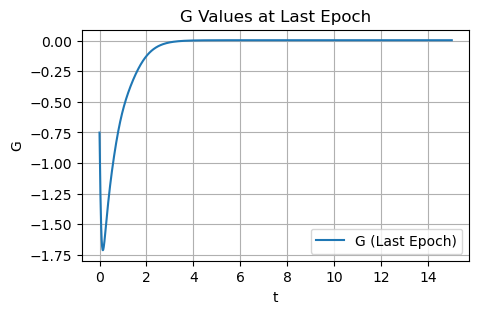

It 212000: loss = 8.52e-04,loss_G = 1.25e-01, alpha21 = 3.0217, alpha22 = 5.0399
Initial Condition: [20.00 0.00 0.00 0.00]


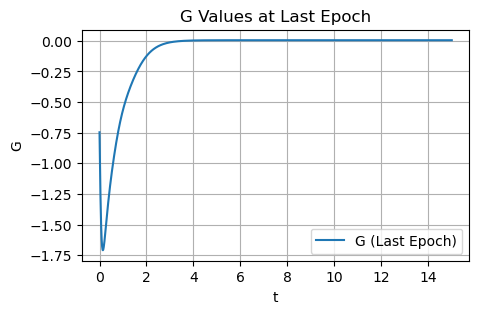

It 212500: loss = 8.52e-04,loss_G = 1.22e-01, alpha21 = 3.0220, alpha22 = 5.0407
Initial Condition: [20.00 0.00 0.00 0.00]


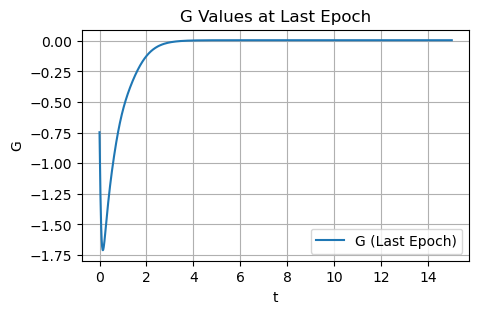

It 213000: loss = 8.52e-04,loss_G = 1.19e-01, alpha21 = 3.0216, alpha22 = 5.0403
Initial Condition: [20.00 0.00 0.00 0.00]


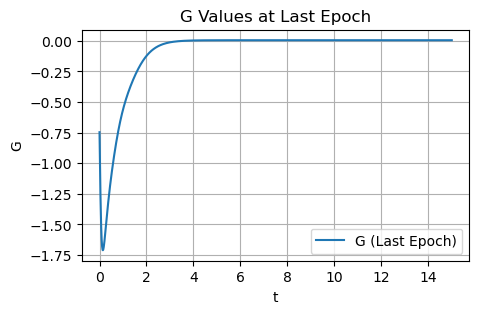

It 213500: loss = 8.52e-04,loss_G = 1.22e-01, alpha21 = 3.0220, alpha22 = 5.0407
Initial Condition: [20.00 0.00 0.00 0.00]


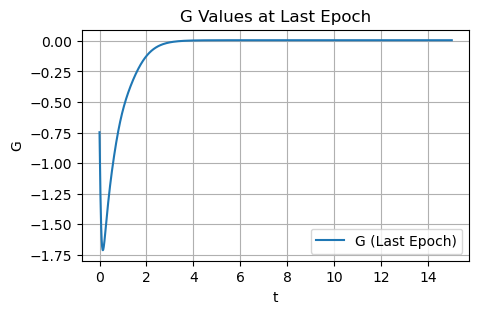

It 214000: loss = 1.09e-03,loss_G = 1.47e-01, alpha21 = 3.0213, alpha22 = 5.0398
Initial Condition: [20.00 0.00 -0.00 0.00]


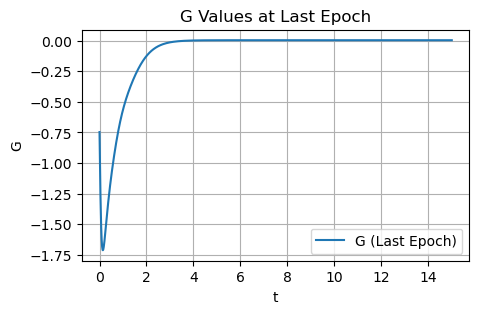

It 214500: loss = 8.52e-04,loss_G = 1.23e-01, alpha21 = 3.0217, alpha22 = 5.0401
Initial Condition: [20.00 0.00 0.00 -0.00]


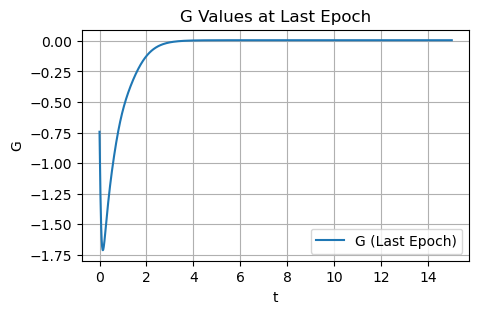

It 215000: loss = 8.53e-04,loss_G = 1.31e-01, alpha21 = 3.0214, alpha22 = 5.0390
Initial Condition: [20.00 0.00 0.00 0.00]


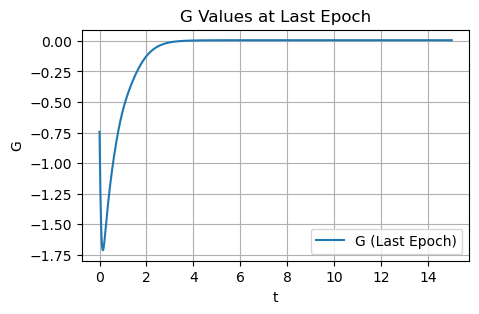

It 215500: loss = 8.63e-04,loss_G = 1.30e-01, alpha21 = 3.0214, alpha22 = 5.0393
Initial Condition: [20.00 0.00 0.00 0.00]


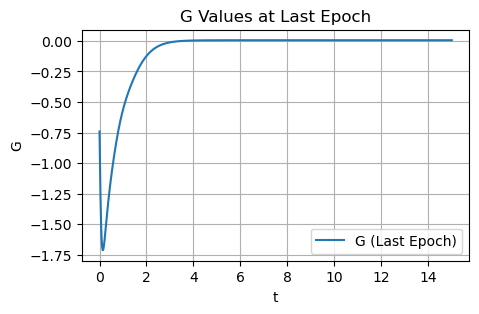

It 216000: loss = 8.52e-04,loss_G = 1.22e-01, alpha21 = 3.0209, alpha22 = 5.0386
Initial Condition: [20.00 0.00 0.00 0.00]


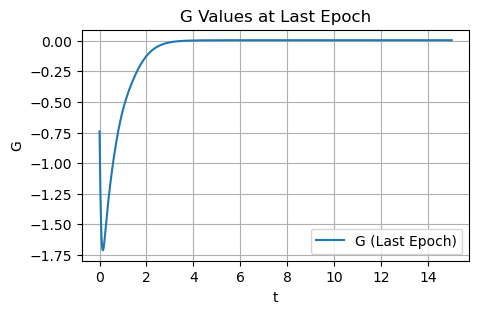

It 216500: loss = 5.30e-03,loss_G = 1.09e-01, alpha21 = 3.0212, alpha22 = 5.0363
Initial Condition: [20.00 -0.00 0.00 -0.00]


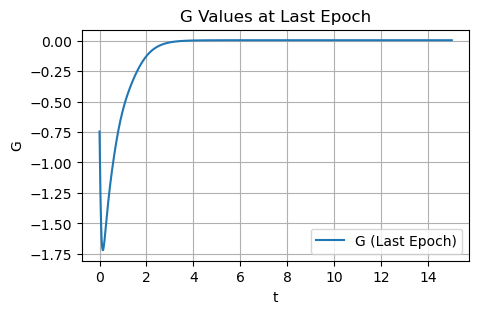

It 217000: loss = 9.19e-04,loss_G = 1.12e-01, alpha21 = 3.0210, alpha22 = 5.0374
Initial Condition: [20.00 -0.00 -0.00 -0.00]


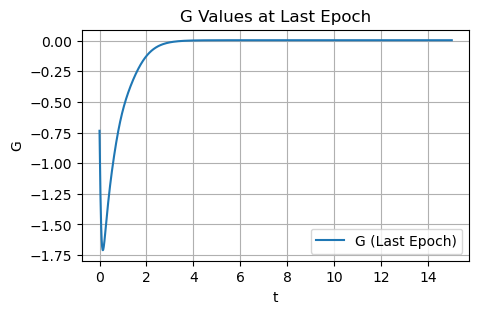

It 217500: loss = 8.60e-04,loss_G = 1.27e-01, alpha21 = 3.0203, alpha22 = 5.0370
Initial Condition: [20.00 0.00 0.00 0.00]


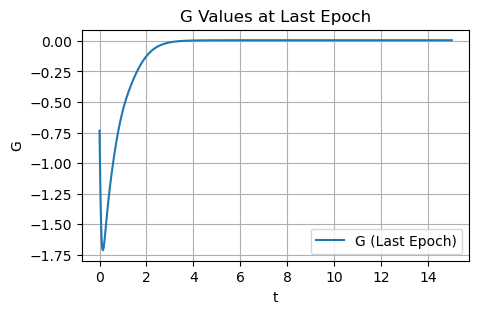

It 218000: loss = 8.53e-04,loss_G = 1.23e-01, alpha21 = 3.0207, alpha22 = 5.0382
Initial Condition: [20.00 0.00 0.00 0.00]


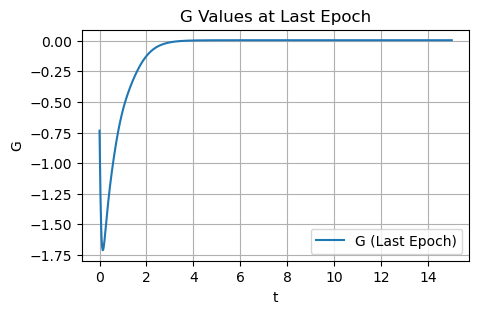

It 218500: loss = 8.52e-04,loss_G = 1.23e-01, alpha21 = 3.0203, alpha22 = 5.0374
Initial Condition: [20.00 0.00 0.00 0.00]


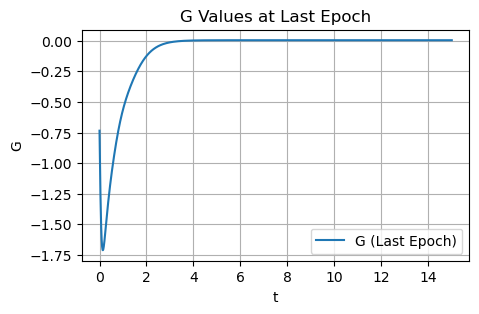

It 219000: loss = 3.28e-03,loss_G = 1.71e-01, alpha21 = 3.0189, alpha22 = 5.0361
Initial Condition: [20.00 0.00 0.00 0.00]


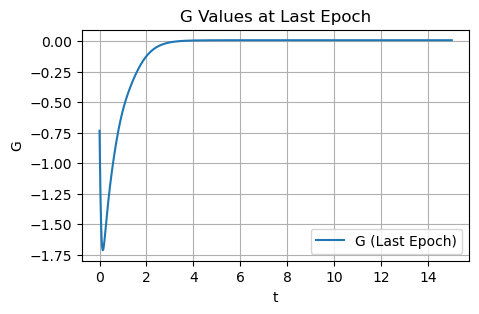

It 219500: loss = 9.22e-04,loss_G = 1.21e-01, alpha21 = 3.0195, alpha22 = 5.0357
Initial Condition: [20.00 0.00 -0.00 0.00]


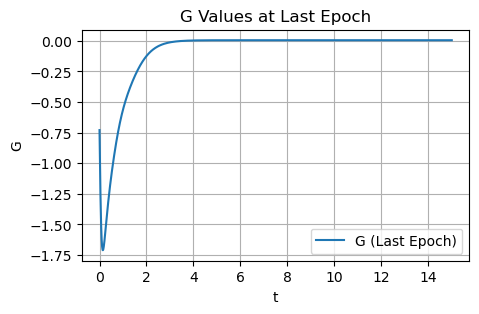

It 220000: loss = 1.08e-03,loss_G = 1.37e-01, alpha21 = 3.0194, alpha22 = 5.0361
Initial Condition: [20.00 0.00 -0.00 0.00]


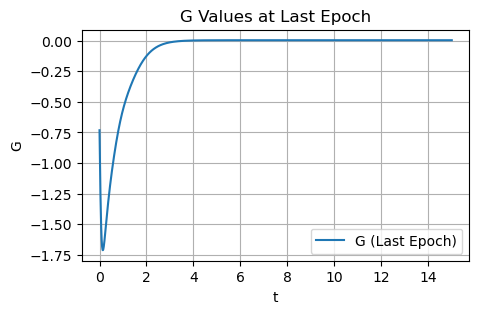

It 220500: loss = 1.88e-03,loss_G = 1.45e-01, alpha21 = 3.0188, alpha22 = 5.0358
Initial Condition: [20.00 0.00 -0.00 0.00]


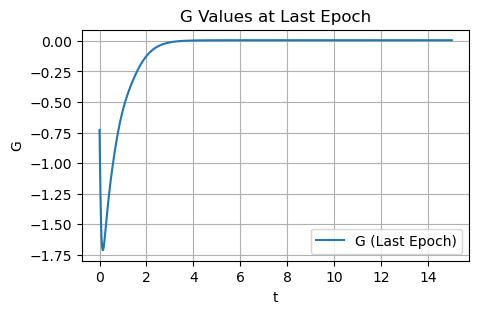

It 221000: loss = 8.63e-04,loss_G = 1.20e-01, alpha21 = 3.0200, alpha22 = 5.0368
Initial Condition: [20.00 -0.00 0.00 -0.00]


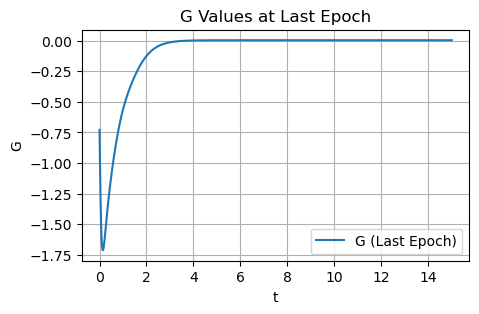

It 221500: loss = 8.52e-04,loss_G = 1.24e-01, alpha21 = 3.0196, alpha22 = 5.0360
Initial Condition: [20.00 0.00 0.00 -0.00]


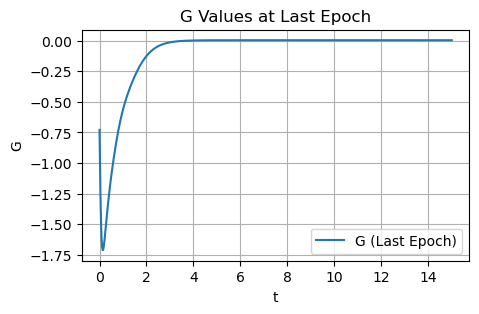

It 222000: loss = 6.92e-03,loss_G = 1.57e-01, alpha21 = 3.0182, alpha22 = 5.0378
Initial Condition: [19.99 0.00 -0.00 0.00]


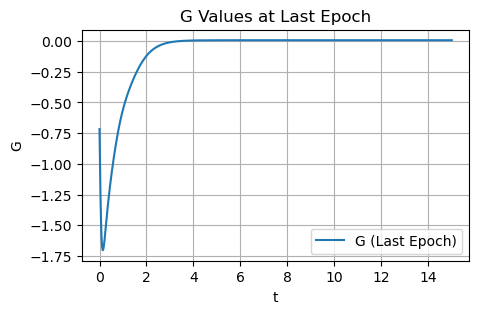

It 222500: loss = 8.70e-04,loss_G = 1.34e-01, alpha21 = 3.0196, alpha22 = 5.0355
Initial Condition: [20.00 0.00 0.00 0.00]


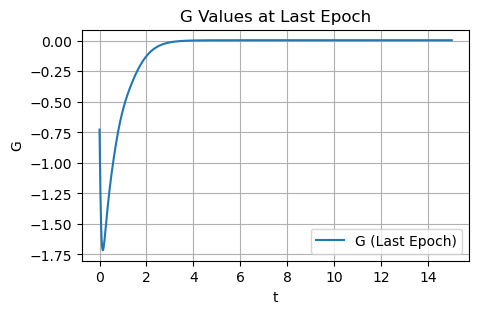

It 223000: loss = 1.03e-03,loss_G = 1.38e-01, alpha21 = 3.0201, alpha22 = 5.0352
Initial Condition: [20.00 -0.00 -0.00 -0.00]


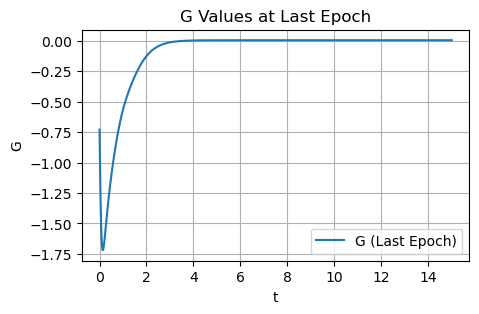

It 223500: loss = 8.52e-04,loss_G = 1.20e-01, alpha21 = 3.0198, alpha22 = 5.0366
Initial Condition: [20.00 0.00 0.00 -0.00]


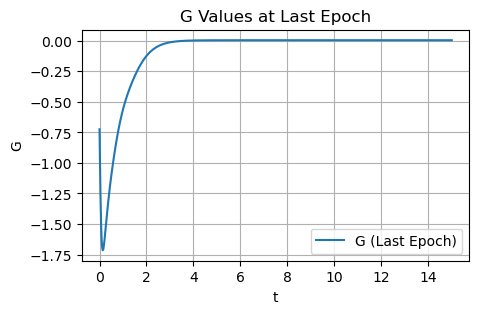

It 224000: loss = 8.51e-04,loss_G = 1.20e-01, alpha21 = 3.0201, alpha22 = 5.0372
Initial Condition: [20.00 0.00 0.00 0.00]


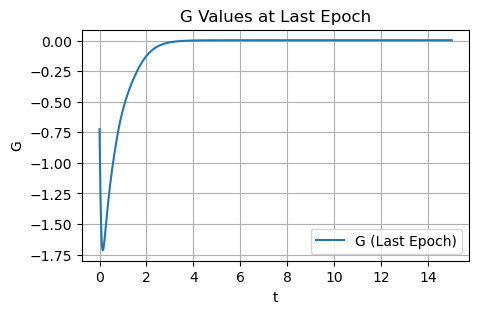

It 224500: loss = 8.63e-04,loss_G = 1.35e-01, alpha21 = 3.0196, alpha22 = 5.0354
Initial Condition: [20.00 -0.00 0.00 0.00]


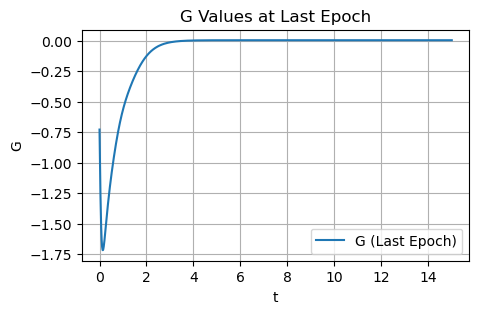

It 225000: loss = 8.52e-04,loss_G = 1.19e-01, alpha21 = 3.0191, alpha22 = 5.0354
Initial Condition: [20.00 0.00 0.00 0.00]


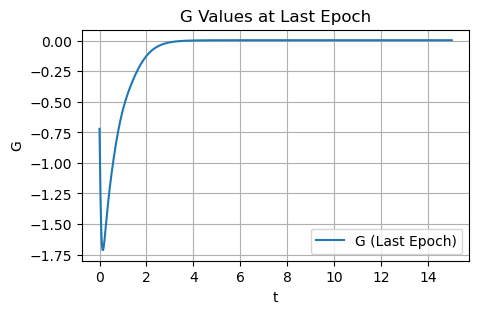

It 225500: loss = 9.15e-04,loss_G = 1.36e-01, alpha21 = 3.0194, alpha22 = 5.0348
Initial Condition: [20.00 -0.00 0.00 -0.00]


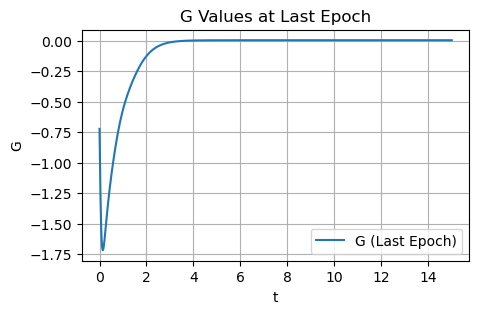

It 226000: loss = 8.52e-04,loss_G = 1.22e-01, alpha21 = 3.0185, alpha22 = 5.0337
Initial Condition: [20.00 0.00 -0.00 -0.00]


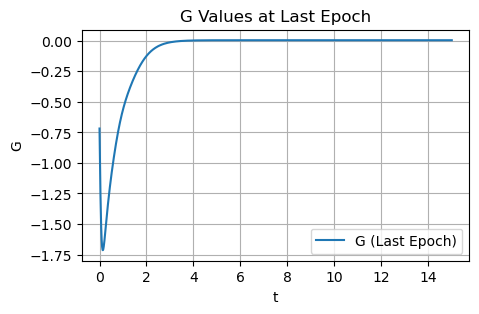

It 226500: loss = 8.52e-04,loss_G = 1.14e-01, alpha21 = 3.0168, alpha22 = 5.0310
Initial Condition: [20.00 0.00 0.00 0.00]


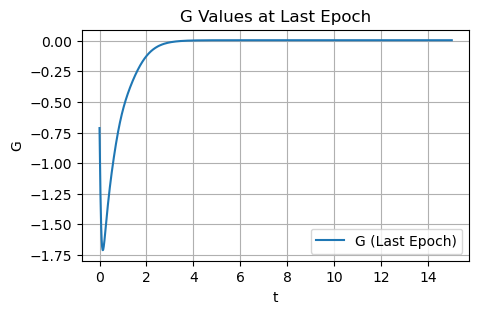

It 227000: loss = 8.52e-04,loss_G = 1.23e-01, alpha21 = 3.0190, alpha22 = 5.0349
Initial Condition: [20.00 0.00 0.00 0.00]


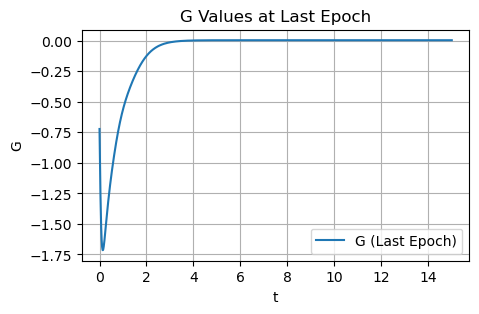

It 227500: loss = 1.29e-03,loss_G = 1.42e-01, alpha21 = 3.0188, alpha22 = 5.0329
Initial Condition: [20.00 -0.00 0.00 -0.00]


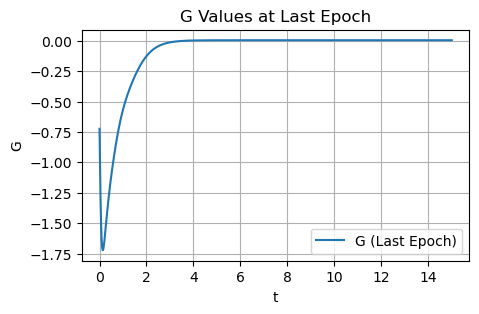

It 228000: loss = 1.26e-03,loss_G = 1.57e-01, alpha21 = 3.0185, alpha22 = 5.0331
Initial Condition: [20.00 0.00 -0.00 0.00]


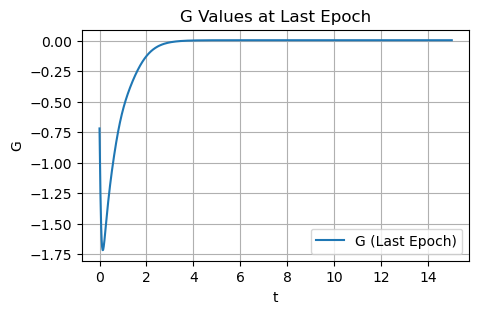

It 228500: loss = 8.52e-04,loss_G = 1.25e-01, alpha21 = 3.0187, alpha22 = 5.0342
Initial Condition: [20.00 0.00 0.00 0.00]


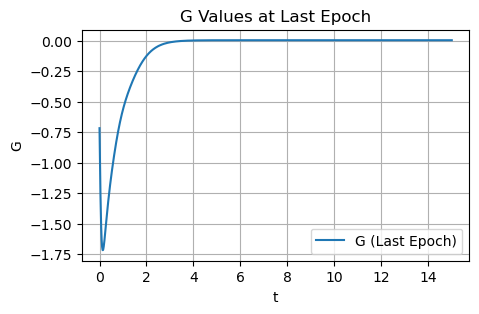

It 229000: loss = 8.51e-04,loss_G = 1.14e-01, alpha21 = 3.0170, alpha22 = 5.0315
Initial Condition: [20.00 0.00 0.00 0.00]


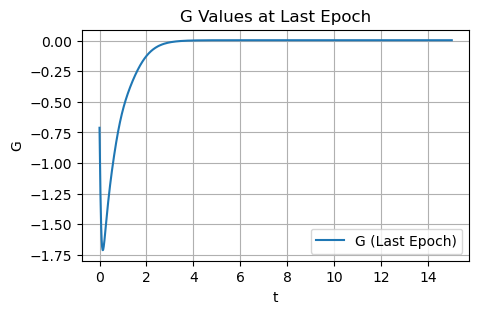

It 229500: loss = 1.33e-03,loss_G = 1.16e-01, alpha21 = 3.0175, alpha22 = 5.0332
Initial Condition: [20.00 0.00 0.00 0.00]


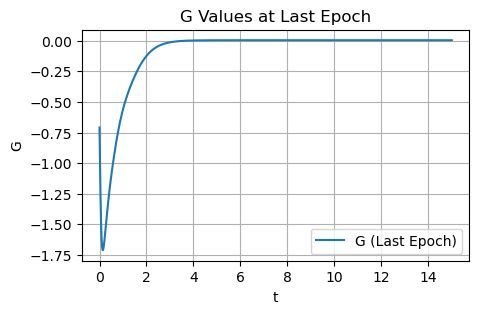

It 230000: loss = 8.52e-04,loss_G = 1.14e-01, alpha21 = 3.0167, alpha22 = 5.0308
Initial Condition: [20.00 0.00 0.00 -0.00]


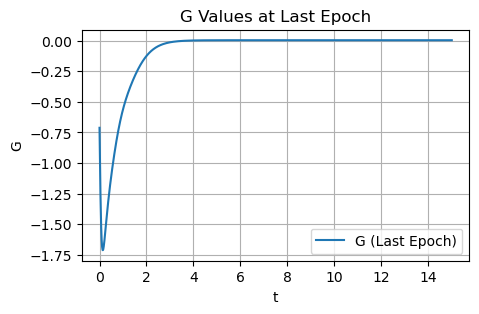

It 230500: loss = 9.35e-03,loss_G = 1.30e-01, alpha21 = 3.0150, alpha22 = 5.0323
Initial Condition: [19.99 0.00 -0.00 0.00]


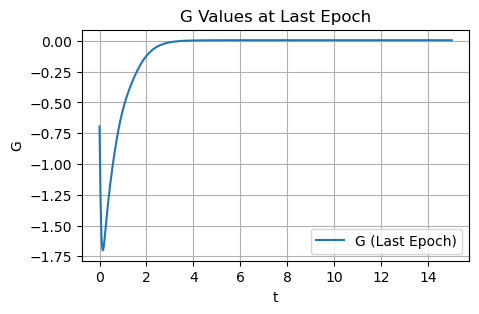

It 231000: loss = 8.53e-04,loss_G = 1.28e-01, alpha21 = 3.0179, alpha22 = 5.0324
Initial Condition: [20.00 0.00 0.00 0.00]


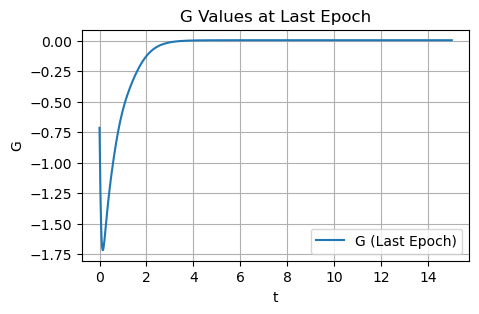

It 231500: loss = 8.52e-04,loss_G = 1.25e-01, alpha21 = 3.0176, alpha22 = 5.0322
Initial Condition: [20.00 0.00 0.00 0.00]


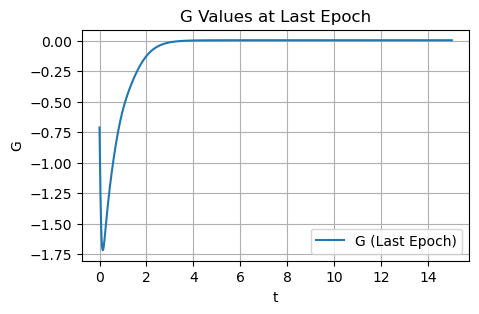

It 232000: loss = 9.01e-04,loss_G = 1.27e-01, alpha21 = 3.0171, alpha22 = 5.0311
Initial Condition: [20.00 -0.00 0.00 -0.00]


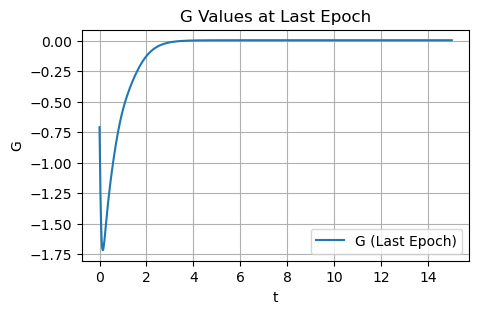

It 232500: loss = 8.52e-04,loss_G = 1.20e-01, alpha21 = 3.0167, alpha22 = 5.0306
Initial Condition: [20.00 0.00 0.00 0.00]


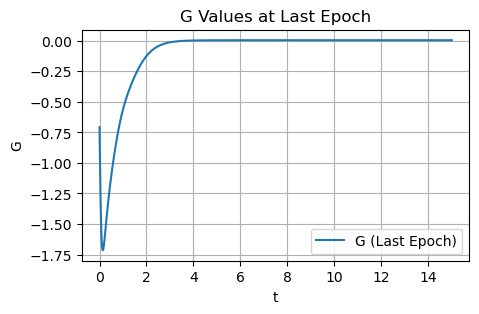

It 233000: loss = 8.53e-04,loss_G = 1.32e-01, alpha21 = 3.0182, alpha22 = 5.0328
Initial Condition: [20.00 0.00 0.00 0.00]


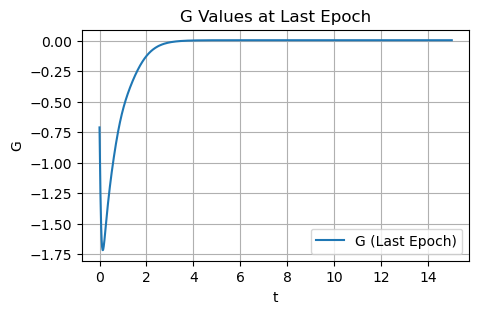

It 233500: loss = 8.52e-04,loss_G = 1.21e-01, alpha21 = 3.0167, alpha22 = 5.0306
Initial Condition: [20.00 0.00 0.00 0.00]


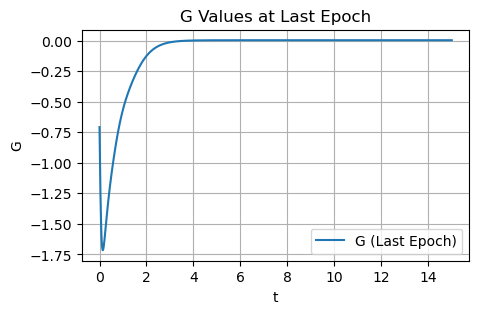

It 234000: loss = 8.60e-04,loss_G = 1.22e-01, alpha21 = 3.0157, alpha22 = 5.0288
Initial Condition: [20.00 0.00 0.00 0.00]


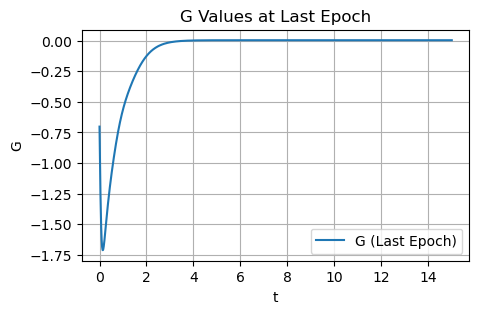

It 234500: loss = 8.53e-04,loss_G = 1.25e-01, alpha21 = 3.0174, alpha22 = 5.0316
Initial Condition: [20.00 0.00 0.00 -0.00]


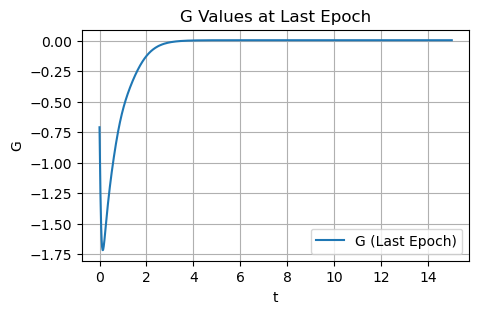

It 235000: loss = 8.51e-04,loss_G = 1.17e-01, alpha21 = 3.0165, alpha22 = 5.0304
Initial Condition: [20.00 0.00 0.00 0.00]


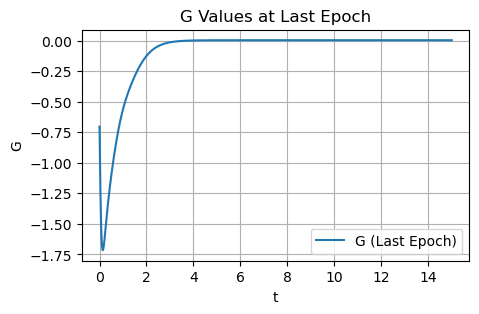

It 235500: loss = 9.17e-04,loss_G = 1.35e-01, alpha21 = 3.0168, alpha22 = 5.0293
Initial Condition: [20.00 -0.00 0.00 -0.00]


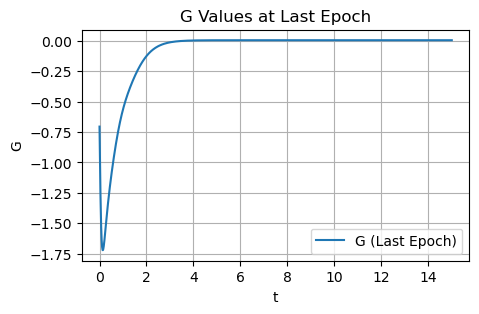

It 236000: loss = 6.11e-03,loss_G = 1.70e-01, alpha21 = 3.0154, alpha22 = 5.0308
Initial Condition: [20.00 0.00 0.00 0.00]


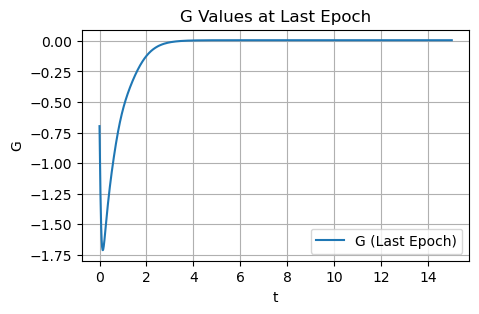

It 236500: loss = 8.79e-04,loss_G = 1.42e-01, alpha21 = 3.0160, alpha22 = 5.0284
Initial Condition: [20.00 0.00 0.00 0.00]


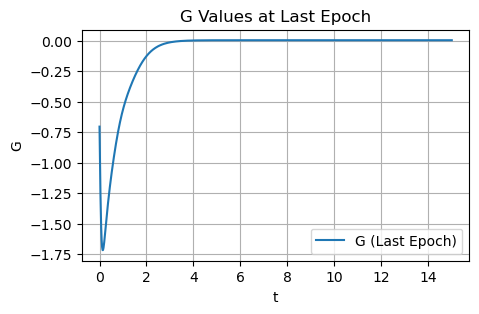

It 237000: loss = 8.51e-04,loss_G = 1.16e-01, alpha21 = 3.0169, alpha22 = 5.0313
Initial Condition: [20.00 0.00 0.00 0.00]


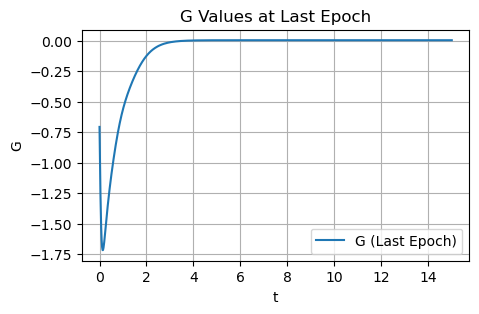

It 237500: loss = 8.61e-04,loss_G = 1.30e-01, alpha21 = 3.0166, alpha22 = 5.0300
Initial Condition: [20.00 0.00 0.00 0.00]


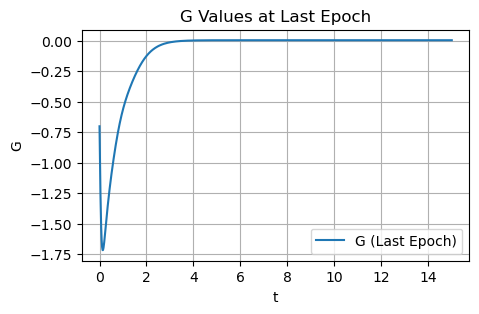

It 238000: loss = 9.28e-04,loss_G = 1.28e-01, alpha21 = 3.0151, alpha22 = 5.0280
Initial Condition: [20.00 0.00 0.00 0.00]


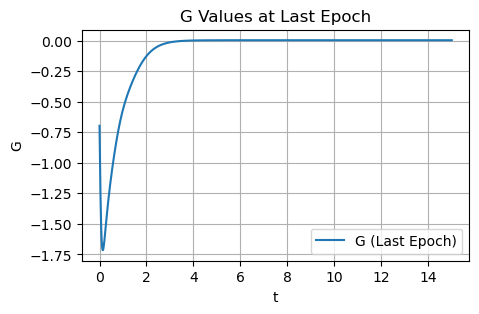

It 238500: loss = 1.19e-03,loss_G = 1.05e-01, alpha21 = 3.0180, alpha22 = 5.0294
Initial Condition: [20.00 -0.00 -0.00 -0.00]


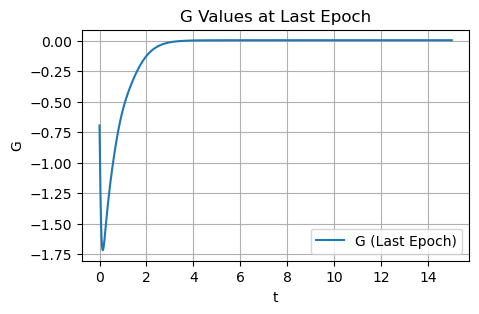

It 239000: loss = 8.52e-04,loss_G = 1.28e-01, alpha21 = 3.0161, alpha22 = 5.0288
Initial Condition: [20.00 -0.00 0.00 -0.00]


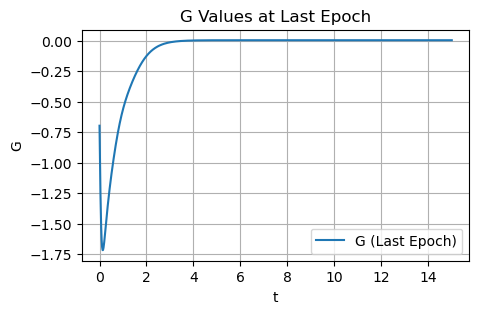

It 239500: loss = 8.51e-04,loss_G = 1.14e-01, alpha21 = 3.0160, alpha22 = 5.0297
Initial Condition: [20.00 0.00 0.00 -0.00]


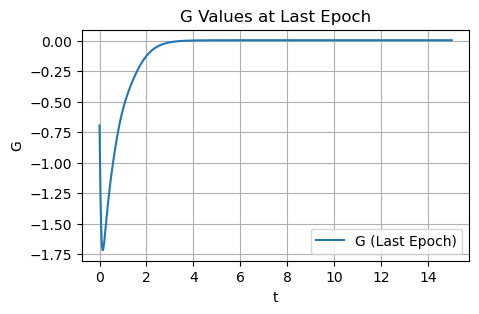

It 240000: loss = 3.59e-03,loss_G = 1.14e-01, alpha21 = 3.0172, alpha22 = 5.0274
Initial Condition: [20.00 -0.00 0.00 -0.00]


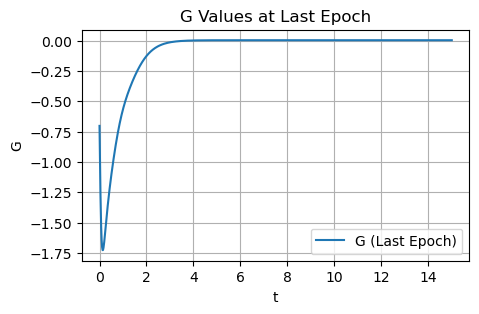

It 240500: loss = 8.93e-04,loss_G = 1.27e-01, alpha21 = 3.0164, alpha22 = 5.0290
Initial Condition: [20.00 -0.00 0.00 -0.00]


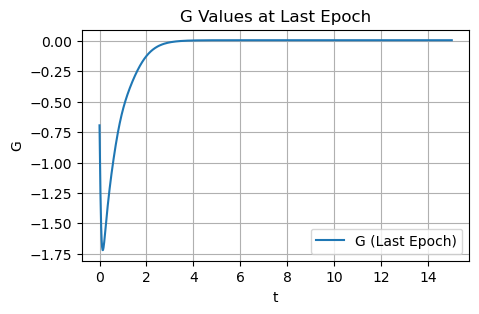

It 241000: loss = 8.84e-04,loss_G = 1.15e-01, alpha21 = 3.0171, alpha22 = 5.0301
Initial Condition: [20.00 -0.00 -0.00 -0.00]


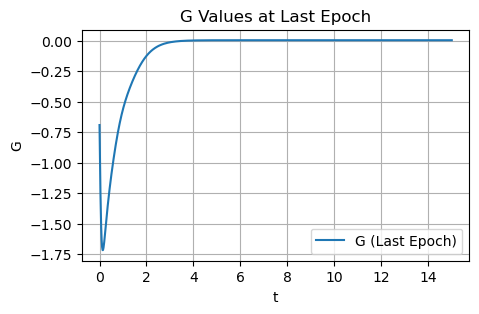

It 241500: loss = 8.52e-04,loss_G = 1.19e-01, alpha21 = 3.0157, alpha22 = 5.0285
Initial Condition: [20.00 -0.00 0.00 -0.00]


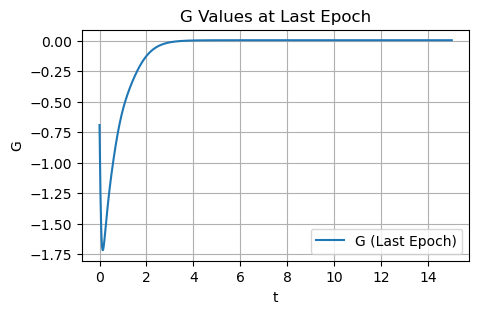

It 242000: loss = 1.03e-03,loss_G = 1.14e-01, alpha21 = 3.0153, alpha22 = 5.0275
Initial Condition: [20.00 -0.00 0.00 -0.00]


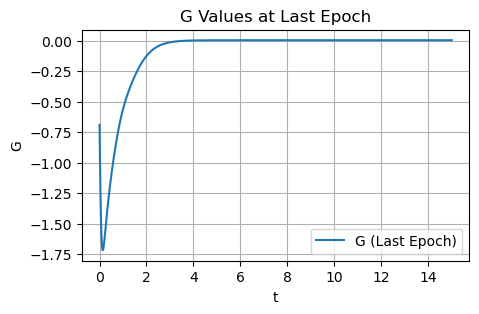

It 242500: loss = 8.96e-04,loss_G = 1.11e-01, alpha21 = 3.0149, alpha22 = 5.0280
Initial Condition: [20.00 0.00 0.00 0.00]


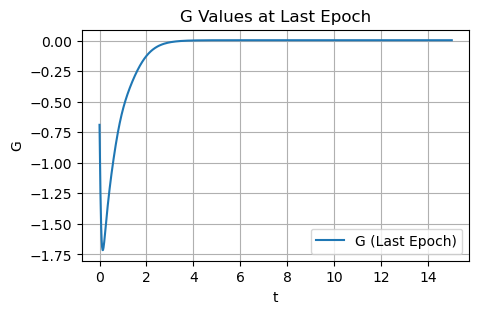

It 243000: loss = 1.49e-03,loss_G = 1.29e-01, alpha21 = 3.0147, alpha22 = 5.0278
Initial Condition: [20.00 0.00 -0.00 0.00]


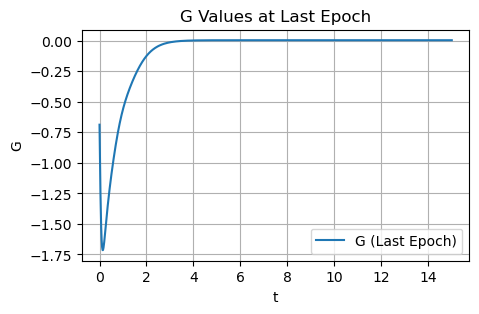

It 243500: loss = 8.63e-04,loss_G = 1.24e-01, alpha21 = 3.0155, alpha22 = 5.0281
Initial Condition: [20.00 0.00 0.00 0.00]


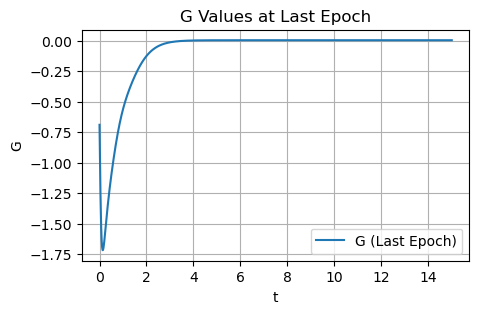

It 244000: loss = 8.52e-04,loss_G = 1.16e-01, alpha21 = 3.0153, alpha22 = 5.0281
Initial Condition: [20.00 0.00 0.00 0.00]


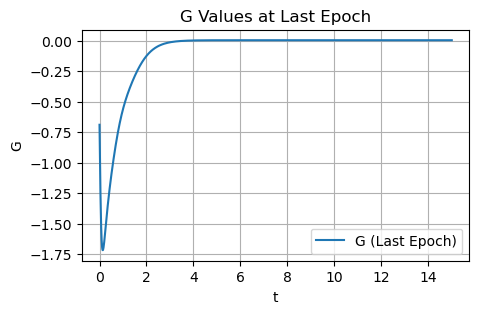

It 244500: loss = 8.51e-04,loss_G = 1.10e-01, alpha21 = 3.0148, alpha22 = 5.0275
Initial Condition: [20.00 0.00 0.00 -0.00]


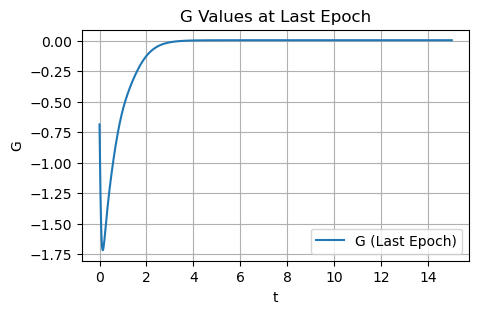

It 245000: loss = 8.51e-04,loss_G = 1.17e-01, alpha21 = 3.0163, alpha22 = 5.0300
Initial Condition: [20.00 0.00 0.00 -0.00]


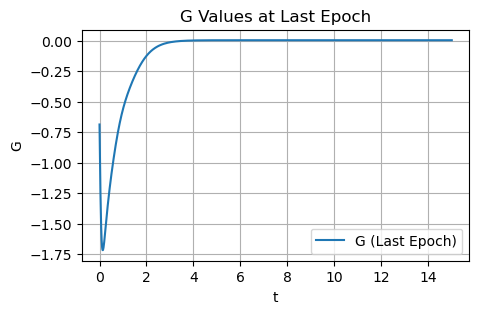

It 245500: loss = 8.59e-04,loss_G = 1.24e-01, alpha21 = 3.0164, alpha22 = 5.0295
Initial Condition: [20.00 -0.00 0.00 -0.00]


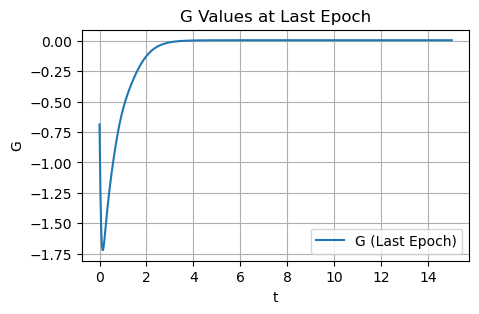

It 246000: loss = 8.51e-04,loss_G = 1.16e-01, alpha21 = 3.0159, alpha22 = 5.0293
Initial Condition: [20.00 0.00 0.00 0.00]


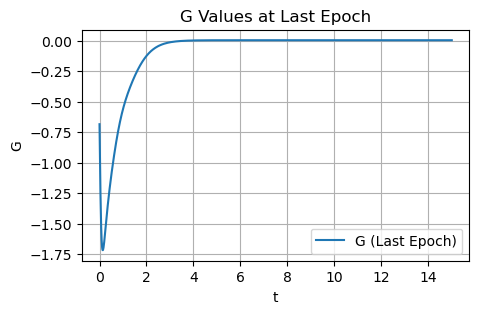

It 246500: loss = 8.51e-04,loss_G = 1.11e-01, alpha21 = 3.0155, alpha22 = 5.0289
Initial Condition: [20.00 0.00 0.00 0.00]


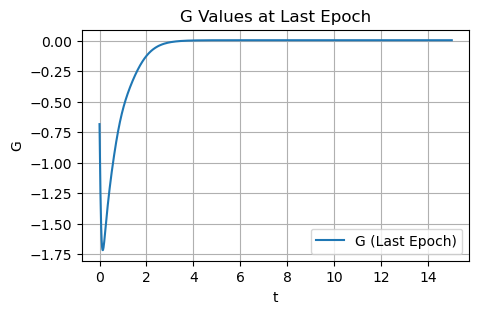

It 247000: loss = 8.51e-04,loss_G = 1.14e-01, alpha21 = 3.0159, alpha22 = 5.0295
Initial Condition: [20.00 0.00 0.00 0.00]


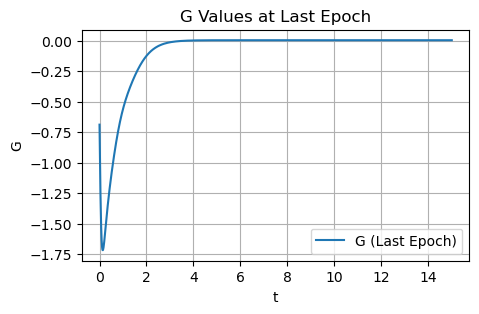

It 247500: loss = 9.93e-04,loss_G = 1.35e-01, alpha21 = 3.0155, alpha22 = 5.0276
Initial Condition: [20.00 -0.00 0.00 0.00]


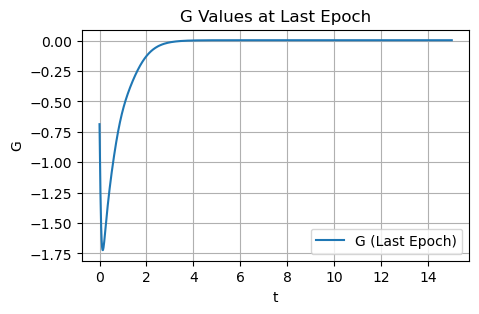

It 248000: loss = 8.51e-04,loss_G = 1.04e-01, alpha21 = 3.0131, alpha22 = 5.0245
Initial Condition: [20.00 0.00 0.00 0.00]


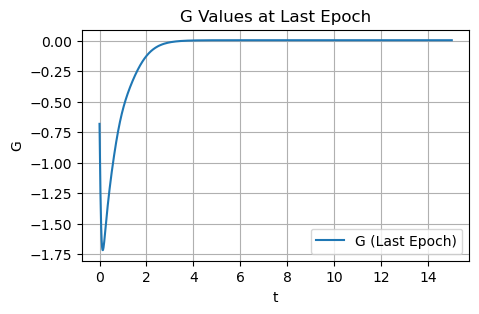

It 248500: loss = 8.51e-04,loss_G = 1.19e-01, alpha21 = 3.0159, alpha22 = 5.0290
Initial Condition: [20.00 0.00 0.00 -0.00]


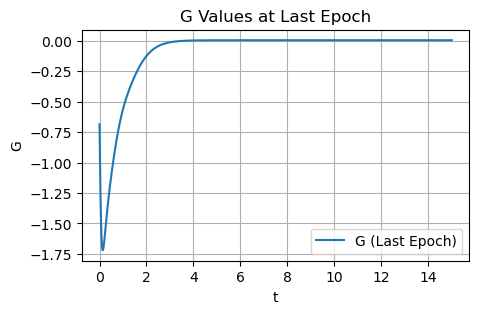

It 249000: loss = 1.71e-03,loss_G = 1.18e-01, alpha21 = 3.0166, alpha22 = 5.0255
Initial Condition: [20.00 -0.00 -0.00 -0.00]


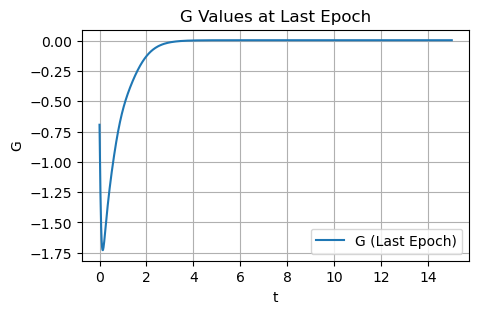

It 249500: loss = 1.80e-03,loss_G = 1.11e-01, alpha21 = 3.0154, alpha22 = 5.0276
Initial Condition: [20.00 -0.00 0.00 -0.00]


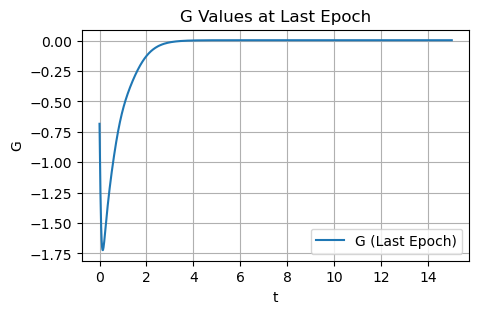

It 250000: loss = 1.07e-03,loss_G = 1.36e-01, alpha21 = 3.0156, alpha22 = 5.0291
Initial Condition: [20.00 0.00 0.00 0.00]


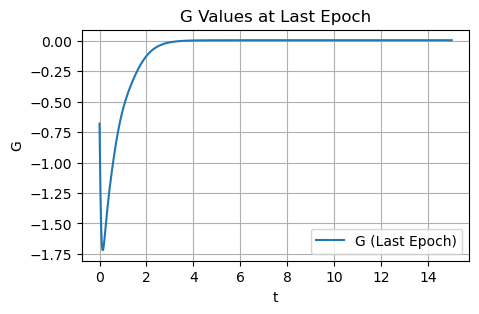

It 250500: loss = 8.51e-04,loss_G = 1.14e-01, alpha21 = 3.0163, alpha22 = 5.0301
Initial Condition: [20.00 0.00 0.00 0.00]


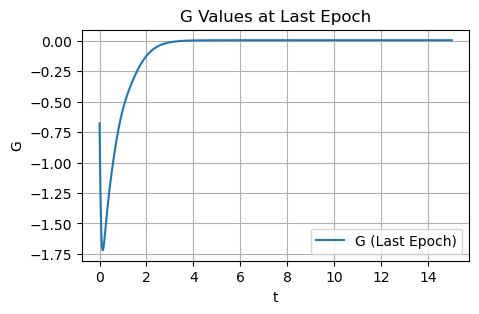

It 251000: loss = 8.51e-04,loss_G = 1.11e-01, alpha21 = 3.0158, alpha22 = 5.0293
Initial Condition: [20.00 0.00 0.00 -0.00]


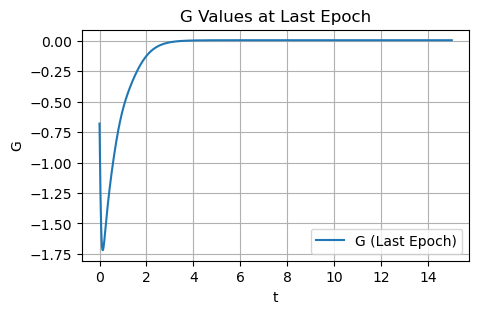

It 251500: loss = 8.52e-04,loss_G = 1.17e-01, alpha21 = 3.0161, alpha22 = 5.0295
Initial Condition: [20.00 -0.00 0.00 -0.00]


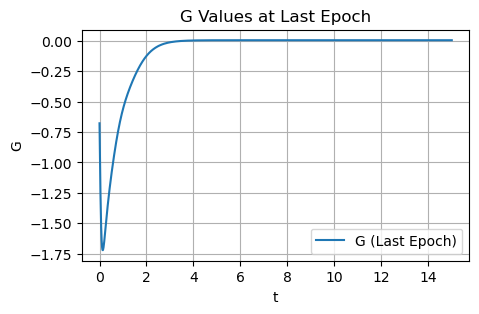

It 252000: loss = 1.97e-03,loss_G = 1.27e-01, alpha21 = 3.0156, alpha22 = 5.0315
Initial Condition: [20.00 0.00 -0.00 0.00]


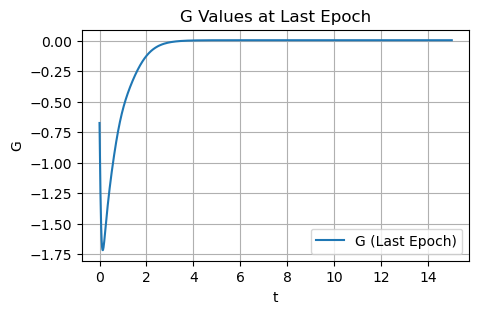

It 252500: loss = 9.69e-04,loss_G = 1.13e-01, alpha21 = 3.0178, alpha22 = 5.0302
Initial Condition: [20.00 -0.00 -0.00 -0.00]


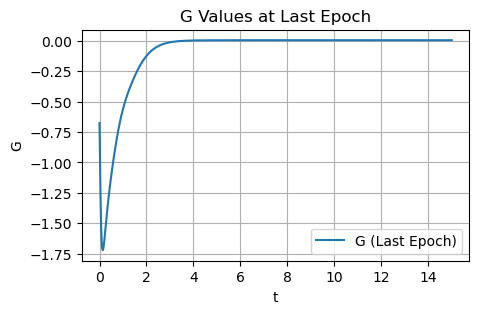

It 253000: loss = 8.57e-04,loss_G = 1.17e-01, alpha21 = 3.0162, alpha22 = 5.0294
Initial Condition: [20.00 -0.00 0.00 -0.00]


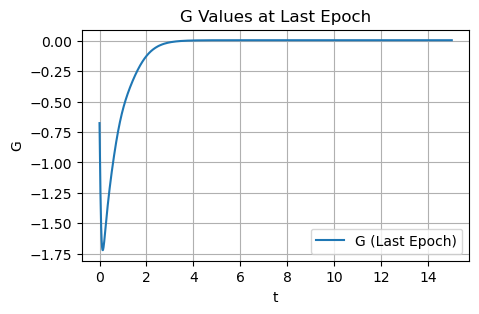

It 253500: loss = 8.51e-04,loss_G = 1.14e-01, alpha21 = 3.0167, alpha22 = 5.0309
Initial Condition: [20.00 0.00 0.00 -0.00]


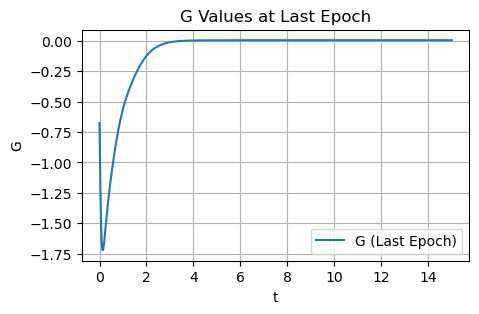

It 254000: loss = 8.52e-04,loss_G = 1.18e-01, alpha21 = 3.0163, alpha22 = 5.0297
Initial Condition: [20.00 -0.00 0.00 -0.00]


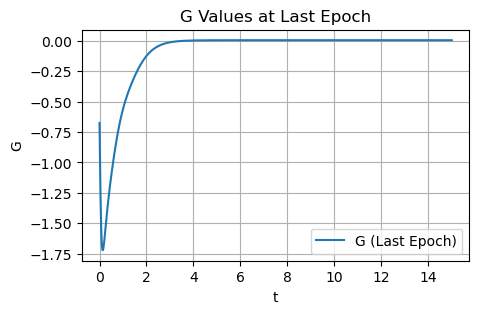

It 254500: loss = 8.93e-04,loss_G = 1.27e-01, alpha21 = 3.0156, alpha22 = 5.0285
Initial Condition: [20.00 0.00 0.00 0.00]


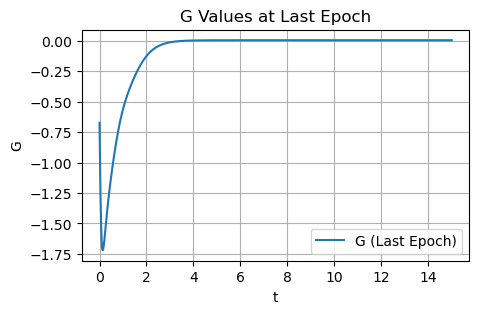

It 255000: loss = 5.93e-03,loss_G = 1.15e-01, alpha21 = 3.0174, alpha22 = 5.0297
Initial Condition: [20.00 -0.00 0.00 -0.00]


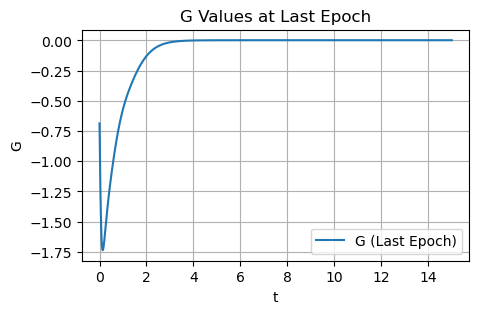

It 255500: loss = 8.51e-04,loss_G = 1.07e-01, alpha21 = 3.0151, alpha22 = 5.0281
Initial Condition: [20.00 0.00 0.00 0.00]


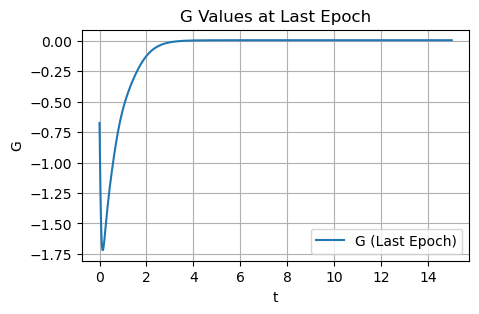

It 256000: loss = 8.51e-04,loss_G = 1.16e-01, alpha21 = 3.0172, alpha22 = 5.0317
Initial Condition: [20.00 0.00 0.00 0.00]


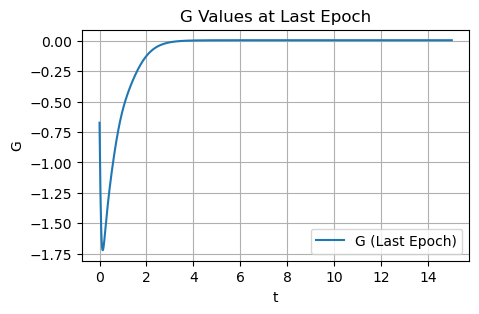

It 256500: loss = 8.51e-04,loss_G = 1.18e-01, alpha21 = 3.0181, alpha22 = 5.0335
Initial Condition: [20.00 0.00 0.00 0.00]


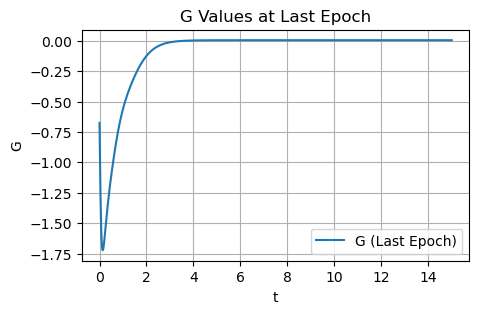

It 257000: loss = 9.54e-04,loss_G = 1.36e-01, alpha21 = 3.0175, alpha22 = 5.0317
Initial Condition: [20.00 -0.00 0.00 0.00]


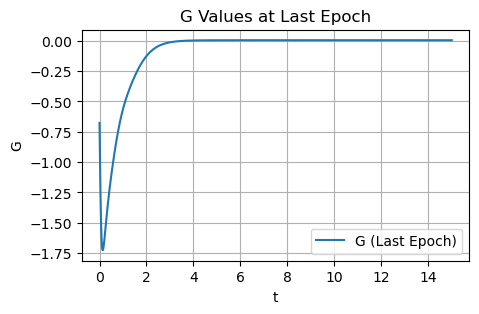

It 257500: loss = 8.51e-04,loss_G = 1.13e-01, alpha21 = 3.0172, alpha22 = 5.0319
Initial Condition: [20.00 0.00 0.00 0.00]


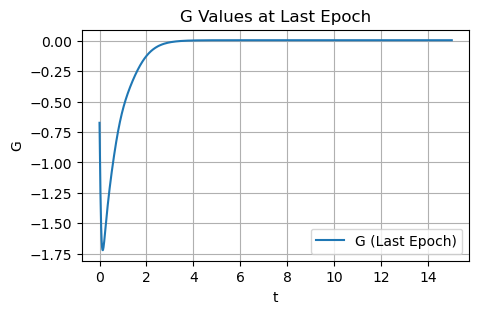

It 258000: loss = 8.51e-04,loss_G = 1.20e-01, alpha21 = 3.0187, alpha22 = 5.0345
Initial Condition: [20.00 0.00 0.00 0.00]


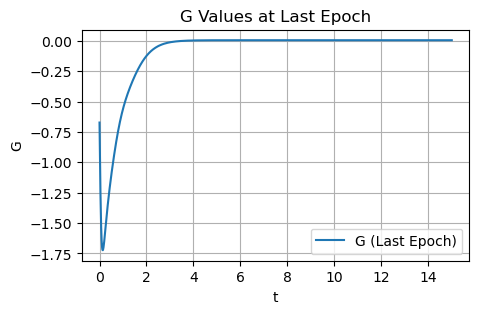

It 258500: loss = 8.51e-04,loss_G = 1.17e-01, alpha21 = 3.0186, alpha22 = 5.0345
Initial Condition: [20.00 0.00 0.00 0.00]


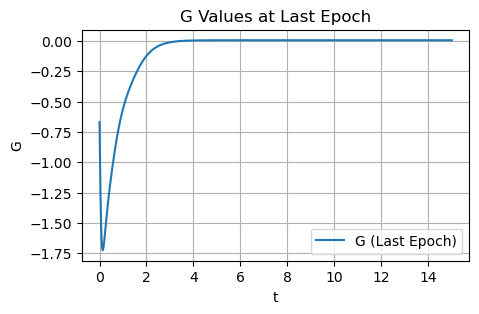

It 259000: loss = 8.56e-04,loss_G = 1.15e-01, alpha21 = 3.0190, alpha22 = 5.0351
Initial Condition: [20.00 -0.00 0.00 -0.00]


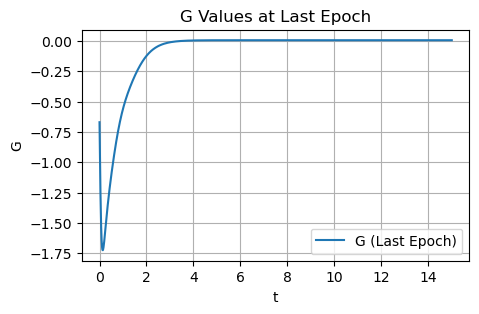

It 259500: loss = 8.52e-04,loss_G = 1.21e-01, alpha21 = 3.0189, alpha22 = 5.0346
Initial Condition: [20.00 -0.00 0.00 -0.00]


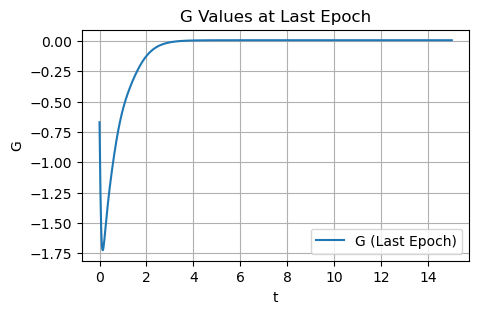

It 260000: loss = 8.68e-04,loss_G = 1.27e-01, alpha21 = 3.0197, alpha22 = 5.0348
Initial Condition: [20.00 0.00 -0.00 -0.00]


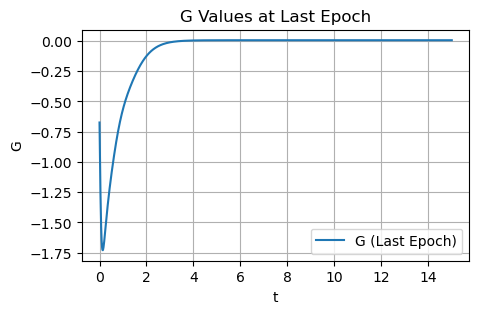

It 260500: loss = 8.52e-04,loss_G = 1.26e-01, alpha21 = 3.0197, alpha22 = 5.0359
Initial Condition: [20.00 0.00 0.00 -0.00]


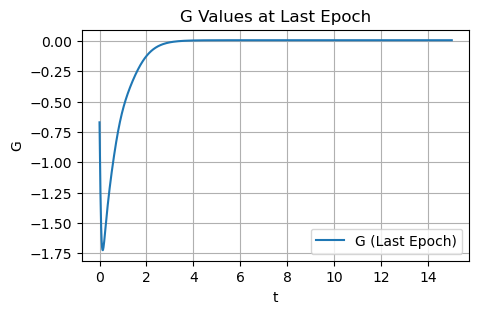

It 261000: loss = 8.56e-04,loss_G = 1.30e-01, alpha21 = 3.0203, alpha22 = 5.0368
Initial Condition: [20.00 0.00 0.00 0.00]


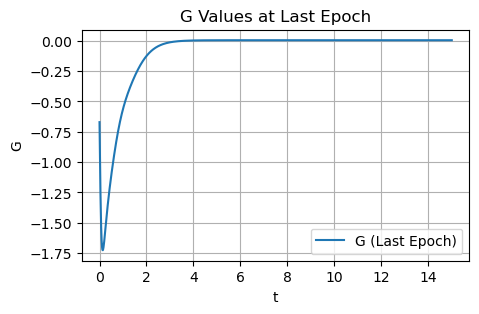

It 261500: loss = 8.69e-04,loss_G = 1.30e-01, alpha21 = 3.0204, alpha22 = 5.0369
Initial Condition: [20.00 0.00 -0.00 0.00]


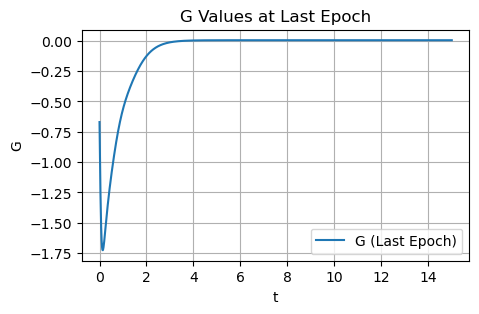

It 262000: loss = 5.50e-03,loss_G = 1.63e-01, alpha21 = 3.0198, alpha22 = 5.0384
Initial Condition: [20.00 0.00 -0.00 0.00]


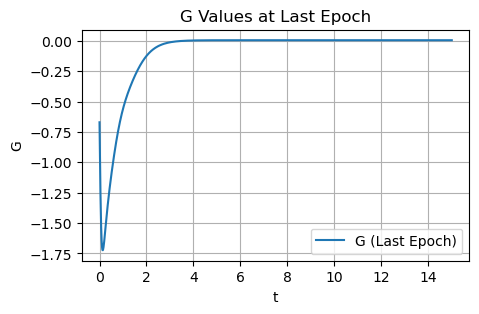

It 262500: loss = 1.57e-02,loss_G = 1.00e-01, alpha21 = 3.0220, alpha22 = 5.0355
Initial Condition: [20.01 -0.01 0.00 -0.01]


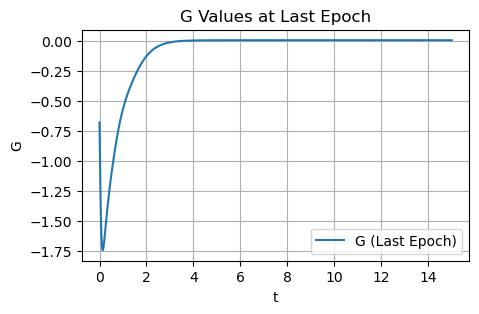

It 263000: loss = 8.51e-04,loss_G = 1.19e-01, alpha21 = 3.0226, alpha22 = 5.0418
Initial Condition: [20.00 0.00 0.00 -0.00]


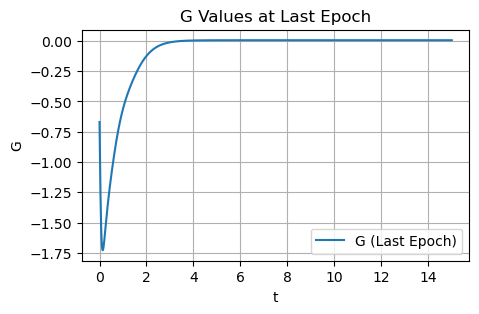

It 263500: loss = 8.51e-04,loss_G = 1.17e-01, alpha21 = 3.0222, alpha22 = 5.0411
Initial Condition: [20.00 0.00 0.00 -0.00]


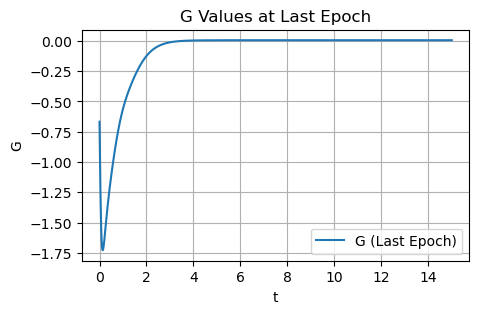

It 264000: loss = 1.10e-03,loss_G = 1.18e-01, alpha21 = 3.0217, alpha22 = 5.0411
Initial Condition: [20.00 0.00 -0.00 0.00]


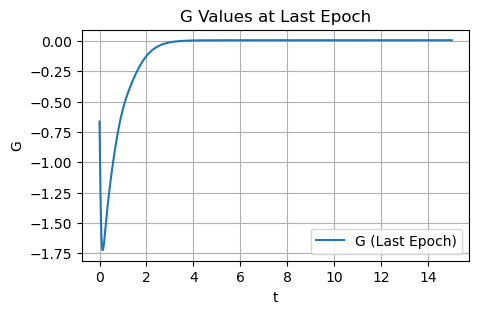

It 264500: loss = 8.51e-04,loss_G = 1.22e-01, alpha21 = 3.0242, alpha22 = 5.0447
Initial Condition: [20.00 0.00 0.00 0.00]


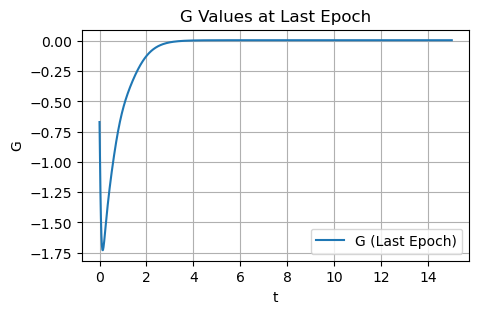

It 265000: loss = 8.51e-04,loss_G = 1.21e-01, alpha21 = 3.0233, alpha22 = 5.0430
Initial Condition: [20.00 0.00 0.00 0.00]


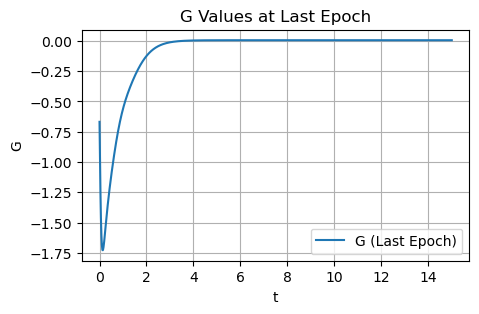

It 265500: loss = 8.51e-04,loss_G = 1.20e-01, alpha21 = 3.0228, alpha22 = 5.0421
Initial Condition: [20.00 0.00 0.00 0.00]


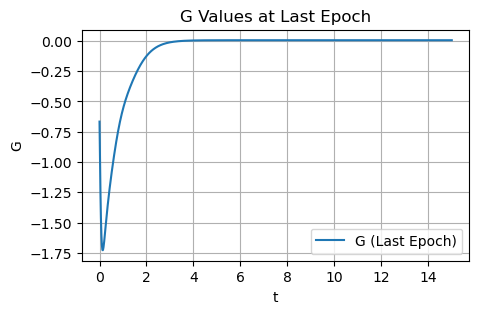

It 266000: loss = 8.51e-04,loss_G = 1.27e-01, alpha21 = 3.0253, alpha22 = 5.0466
Initial Condition: [20.00 0.00 0.00 0.00]


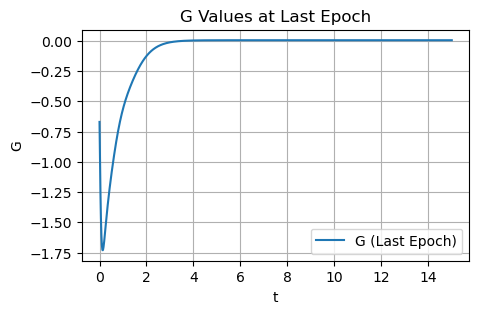

It 266500: loss = 9.80e-04,loss_G = 1.18e-01, alpha21 = 3.0247, alpha22 = 5.0467
Initial Condition: [20.00 -0.00 0.00 0.00]


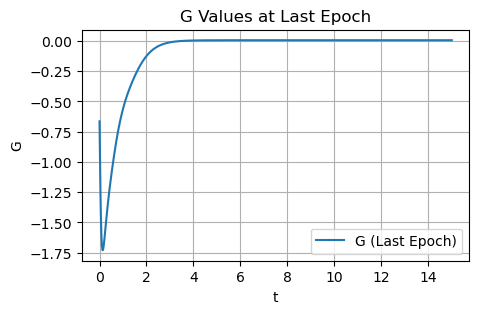

It 267000: loss = 8.51e-04,loss_G = 1.27e-01, alpha21 = 3.0250, alpha22 = 5.0459
Initial Condition: [20.00 0.00 0.00 -0.00]


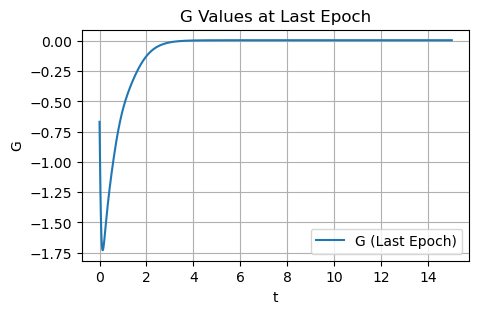

It 267500: loss = 8.05e-03,loss_G = 1.85e-01, alpha21 = 3.0253, alpha22 = 5.0469
Initial Condition: [20.00 0.00 -0.00 0.00]


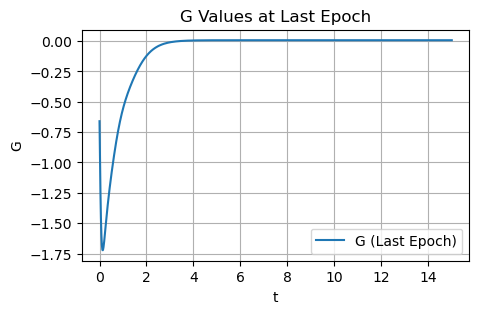

It 268000: loss = 2.83e-03,loss_G = 1.55e-01, alpha21 = 3.0260, alpha22 = 5.0479
Initial Condition: [20.00 0.00 -0.00 0.00]


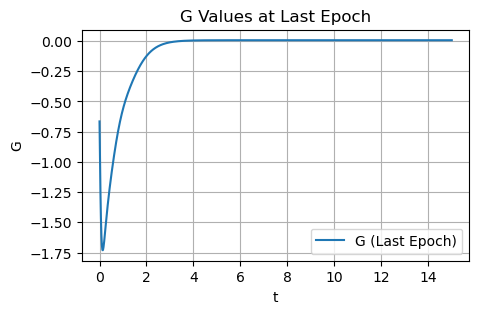

It 268500: loss = 2.16e-03,loss_G = 1.36e-01, alpha21 = 3.0276, alpha22 = 5.0486
Initial Condition: [20.00 -0.00 0.00 -0.00]


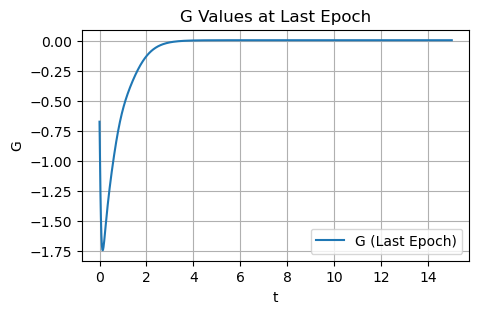

It 269000: loss = 8.66e-04,loss_G = 1.44e-01, alpha21 = 3.0275, alpha22 = 5.0498
Initial Condition: [20.00 0.00 0.00 0.00]


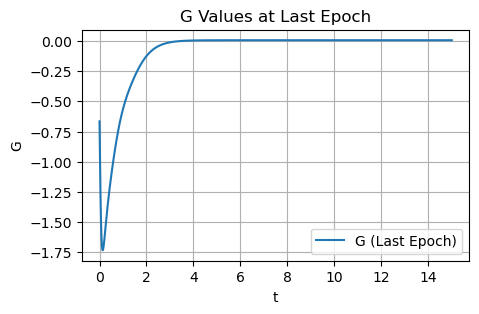

It 269500: loss = 8.51e-04,loss_G = 1.33e-01, alpha21 = 3.0279, alpha22 = 5.0512
Initial Condition: [20.00 0.00 0.00 -0.00]


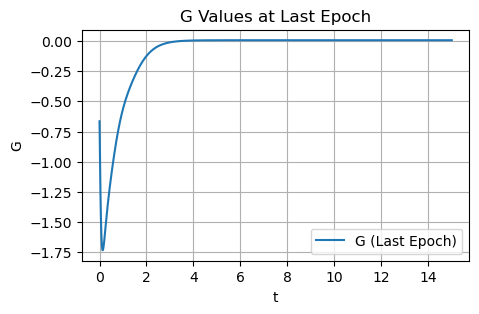

It 270000: loss = 8.51e-04,loss_G = 1.31e-01, alpha21 = 3.0279, alpha22 = 5.0513
Initial Condition: [20.00 0.00 0.00 0.00]


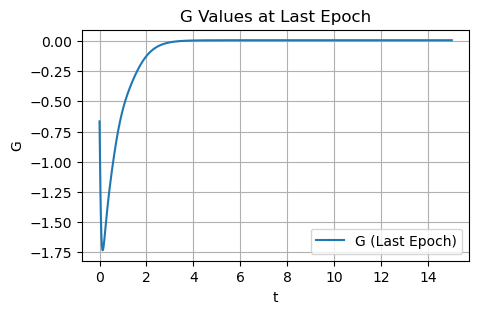

It 270500: loss = 8.51e-04,loss_G = 1.26e-01, alpha21 = 3.0256, alpha22 = 5.0472
Initial Condition: [20.00 0.00 0.00 0.00]


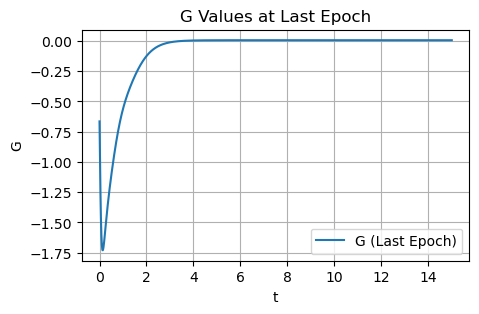

It 271000: loss = 8.53e-04,loss_G = 1.40e-01, alpha21 = 3.0280, alpha22 = 5.0510
Initial Condition: [20.00 0.00 0.00 0.00]


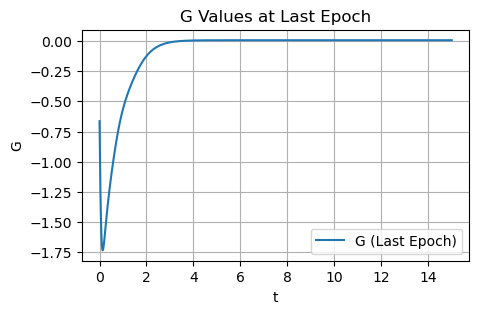

It 271500: loss = 3.23e-03,loss_G = 1.48e-01, alpha21 = 3.0275, alpha22 = 5.0531
Initial Condition: [20.00 0.00 -0.00 0.00]


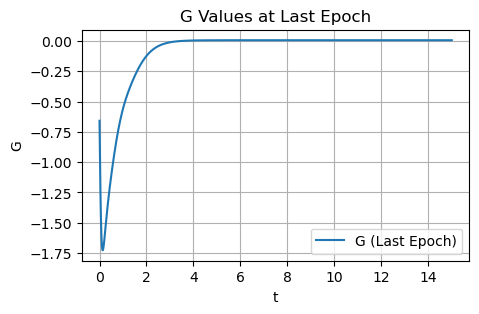

It 272000: loss = 8.53e-04,loss_G = 1.41e-01, alpha21 = 3.0289, alpha22 = 5.0523
Initial Condition: [20.00 -0.00 0.00 -0.00]


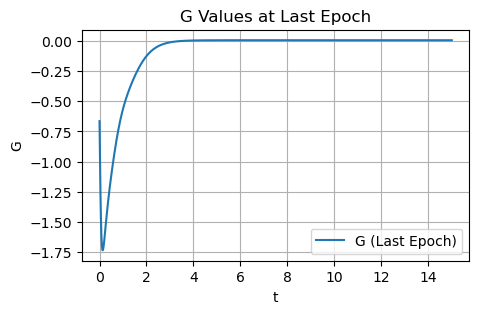

It 272500: loss = 9.40e-04,loss_G = 1.60e-01, alpha21 = 3.0286, alpha22 = 5.0519
Initial Condition: [20.00 0.00 0.00 0.00]


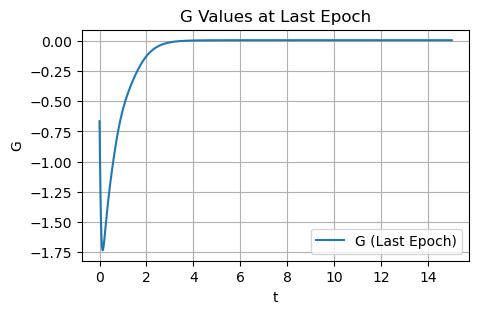

It 273000: loss = 2.32e-02,loss_G = 1.08e-01, alpha21 = 3.0325, alpha22 = 5.0508
Initial Condition: [20.01 -0.01 0.00 -0.01]


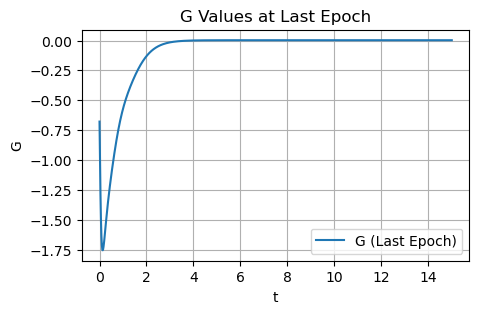

It 273500: loss = 9.16e-04,loss_G = 1.48e-01, alpha21 = 3.0298, alpha22 = 5.0542
Initial Condition: [20.00 -0.00 0.00 0.00]


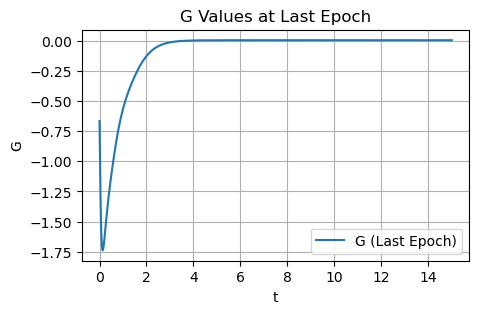

It 274000: loss = 1.04e-03,loss_G = 1.45e-01, alpha21 = 3.0298, alpha22 = 5.0532
Initial Condition: [20.00 -0.00 0.00 -0.00]


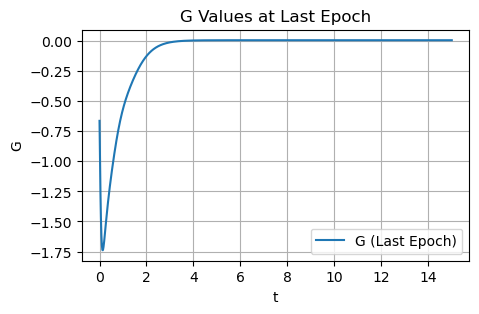

It 274500: loss = 8.51e-04,loss_G = 1.39e-01, alpha21 = 3.0297, alpha22 = 5.0543
Initial Condition: [20.00 0.00 0.00 -0.00]


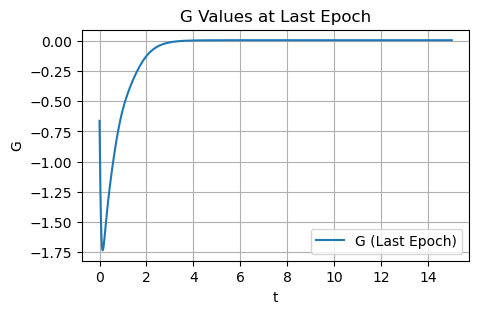

It 275000: loss = 8.53e-04,loss_G = 1.48e-01, alpha21 = 3.0299, alpha22 = 5.0541
Initial Condition: [20.00 -0.00 -0.00 -0.00]


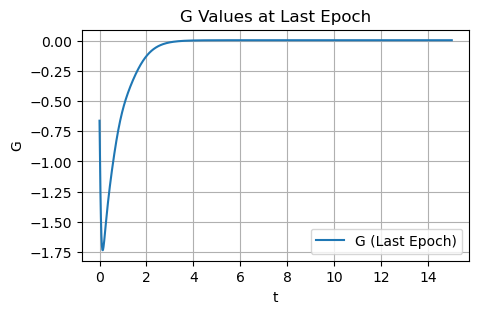

It 275500: loss = 1.33e-03,loss_G = 1.45e-01, alpha21 = 3.0307, alpha22 = 5.0538
Initial Condition: [20.00 -0.00 -0.00 -0.00]


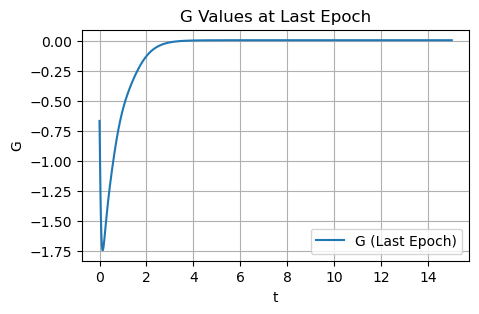

It 276000: loss = 8.53e-04,loss_G = 1.46e-01, alpha21 = 3.0305, alpha22 = 5.0555
Initial Condition: [20.00 0.00 0.00 -0.00]


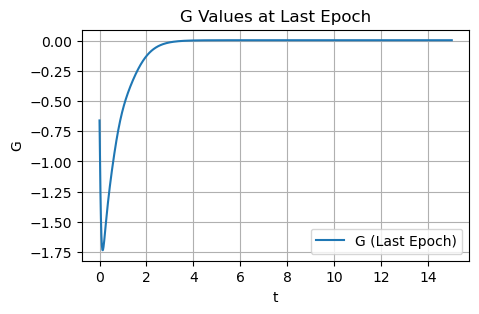

It 276500: loss = 8.51e-04,loss_G = 1.37e-01, alpha21 = 3.0304, alpha22 = 5.0558
Initial Condition: [20.00 0.00 0.00 -0.00]


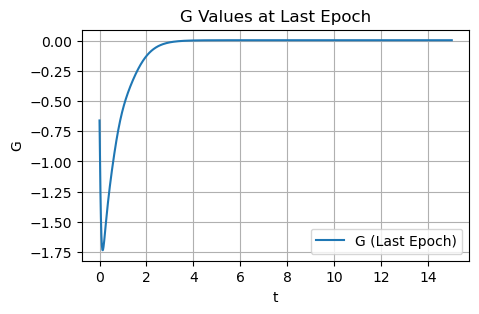

It 277000: loss = 8.52e-04,loss_G = 1.45e-01, alpha21 = 3.0306, alpha22 = 5.0558
Initial Condition: [20.00 -0.00 0.00 -0.00]


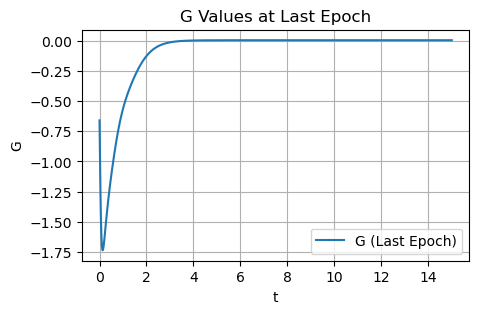

It 277500: loss = 8.51e-04,loss_G = 1.41e-01, alpha21 = 3.0300, alpha22 = 5.0549
Initial Condition: [20.00 0.00 0.00 -0.00]


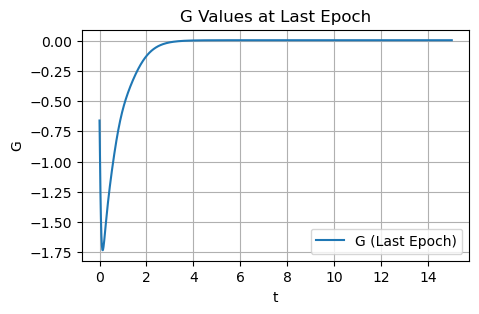

It 278000: loss = 1.46e-02,loss_G = 1.91e-01, alpha21 = 3.0283, alpha22 = 5.0575
Initial Condition: [19.99 0.00 -0.00 0.01]


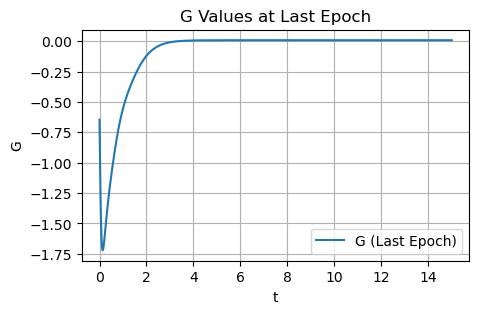

It 278500: loss = 8.54e-04,loss_G = 1.41e-01, alpha21 = 3.0304, alpha22 = 5.0557
Initial Condition: [20.00 0.00 0.00 0.00]


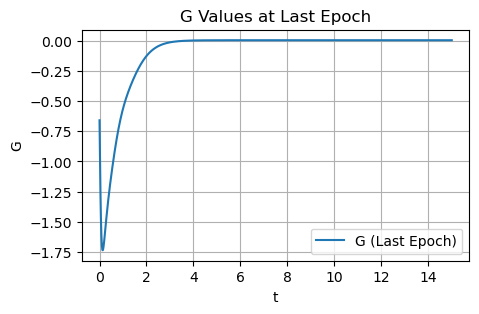

It 279000: loss = 8.91e-04,loss_G = 1.40e-01, alpha21 = 3.0285, alpha22 = 5.0508
Initial Condition: [20.00 -0.00 0.00 -0.00]


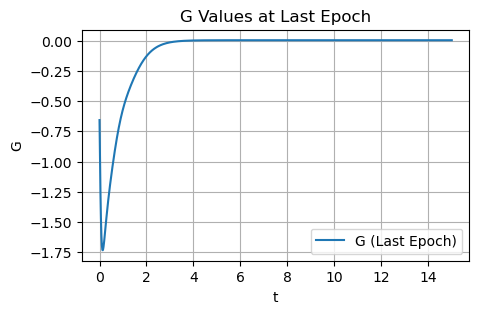

It 279500: loss = 8.51e-04,loss_G = 1.37e-01, alpha21 = 3.0302, alpha22 = 5.0555
Initial Condition: [20.00 0.00 0.00 0.00]


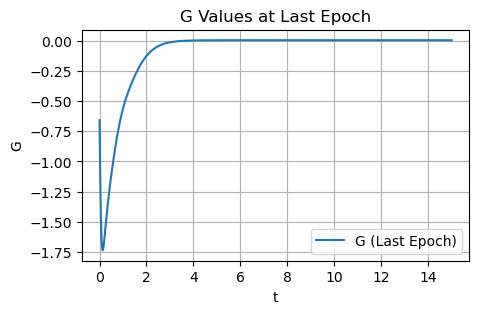

It 280000: loss = 8.51e-04,loss_G = 1.35e-01, alpha21 = 3.0288, alpha22 = 5.0528
Initial Condition: [20.00 0.00 0.00 0.00]


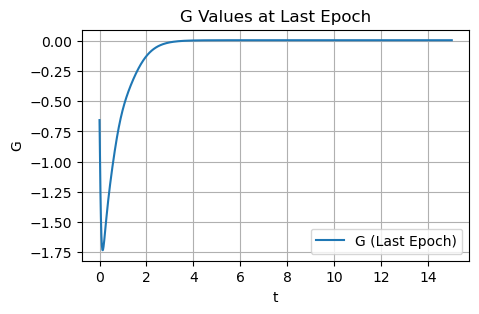

It 280500: loss = 8.51e-04,loss_G = 1.44e-01, alpha21 = 3.0306, alpha22 = 5.0558
Initial Condition: [20.00 0.00 0.00 0.00]


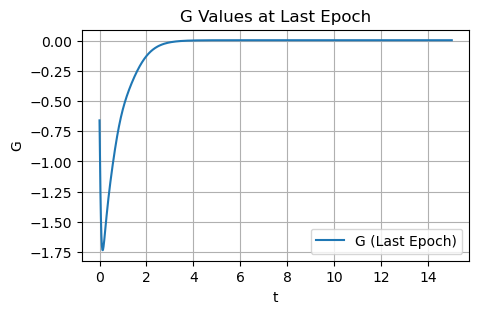

It 281000: loss = 8.51e-04,loss_G = 1.40e-01, alpha21 = 3.0303, alpha22 = 5.0556
Initial Condition: [20.00 0.00 0.00 -0.00]


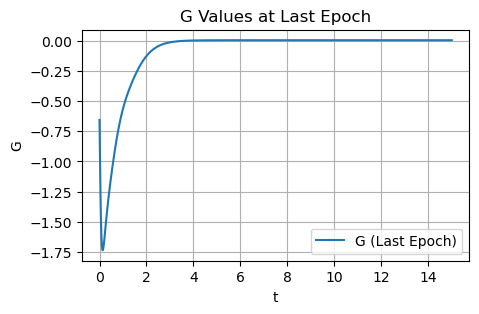

It 281500: loss = 8.51e-04,loss_G = 1.43e-01, alpha21 = 3.0304, alpha22 = 5.0555
Initial Condition: [20.00 0.00 0.00 0.00]


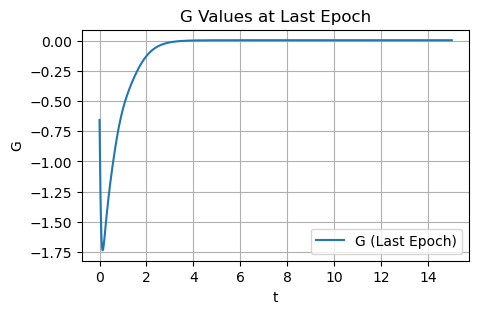

It 282000: loss = 8.91e-04,loss_G = 1.67e-01, alpha21 = 3.0301, alpha22 = 5.0553
Initial Condition: [20.00 -0.00 0.00 0.00]


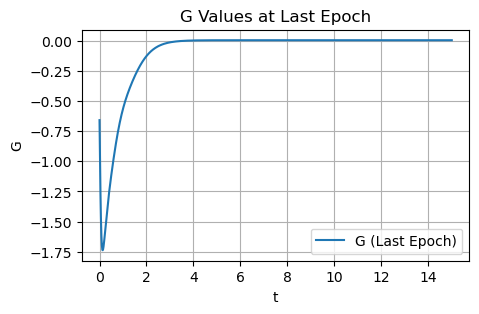

It 282500: loss = 4.99e-03,loss_G = 1.79e-01, alpha21 = 3.0294, alpha22 = 5.0541
Initial Condition: [20.00 0.00 -0.00 0.00]


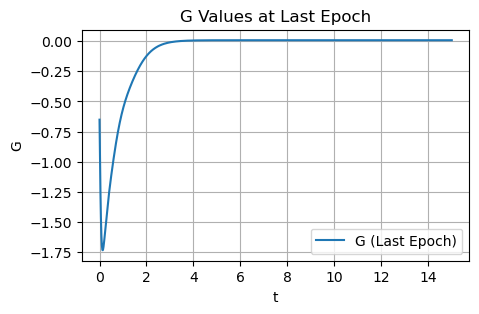

It 283000: loss = 8.51e-04,loss_G = 1.38e-01, alpha21 = 3.0303, alpha22 = 5.0556
Initial Condition: [20.00 0.00 0.00 0.00]


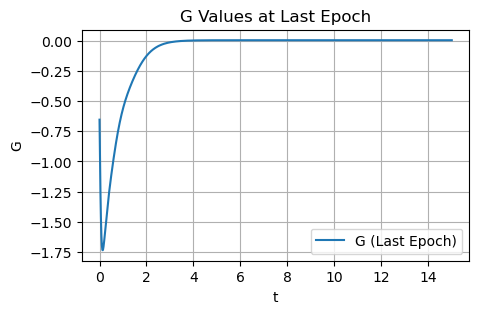

It 283500: loss = 8.51e-04,loss_G = 1.40e-01, alpha21 = 3.0303, alpha22 = 5.0556
Initial Condition: [20.00 0.00 0.00 -0.00]


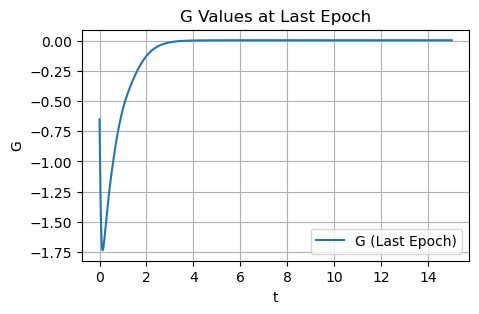

It 284000: loss = 8.51e-04,loss_G = 1.40e-01, alpha21 = 3.0303, alpha22 = 5.0556
Initial Condition: [20.00 0.00 0.00 -0.00]


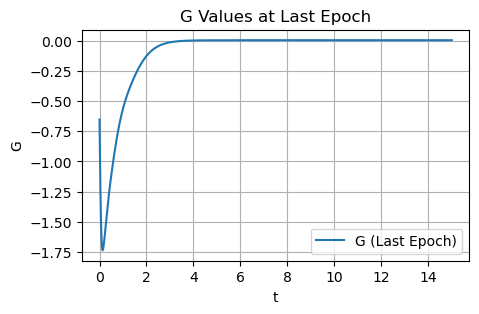

It 284500: loss = 8.51e-04,loss_G = 1.37e-01, alpha21 = 3.0296, alpha22 = 5.0544
Initial Condition: [20.00 0.00 0.00 0.00]


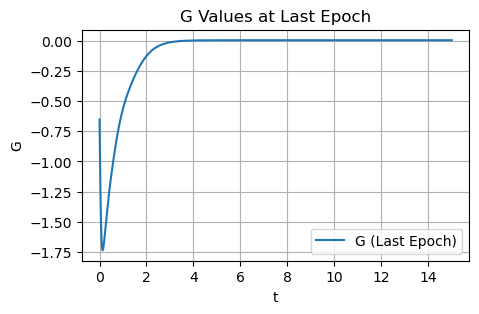

It 285000: loss = 8.51e-04,loss_G = 1.43e-01, alpha21 = 3.0313, alpha22 = 5.0573
Initial Condition: [20.00 0.00 0.00 -0.00]


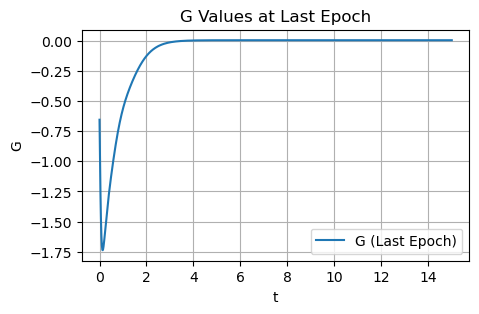

It 285500: loss = 8.79e-04,loss_G = 1.43e-01, alpha21 = 3.0307, alpha22 = 5.0572
Initial Condition: [20.00 0.00 -0.00 0.00]


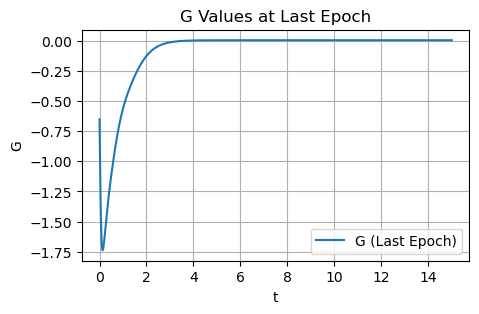

It 286000: loss = 8.51e-04,loss_G = 1.44e-01, alpha21 = 3.0300, alpha22 = 5.0547
Initial Condition: [20.00 0.00 0.00 0.00]


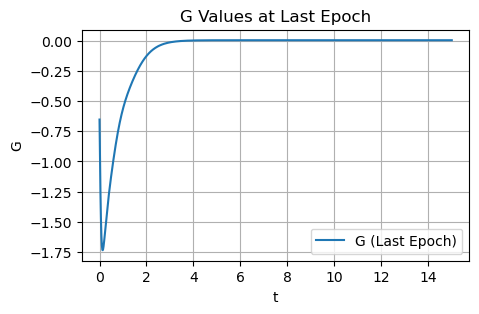

It 286500: loss = 8.51e-04,loss_G = 1.41e-01, alpha21 = 3.0302, alpha22 = 5.0552
Initial Condition: [20.00 0.00 0.00 -0.00]


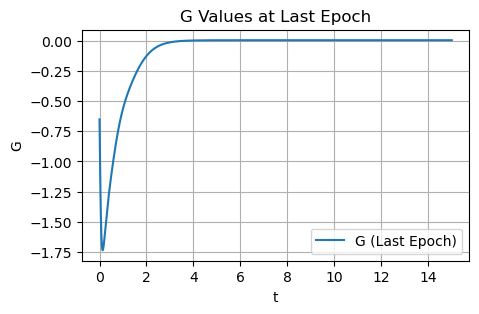

It 287000: loss = 8.51e-04,loss_G = 1.47e-01, alpha21 = 3.0304, alpha22 = 5.0554
Initial Condition: [20.00 0.00 0.00 -0.00]


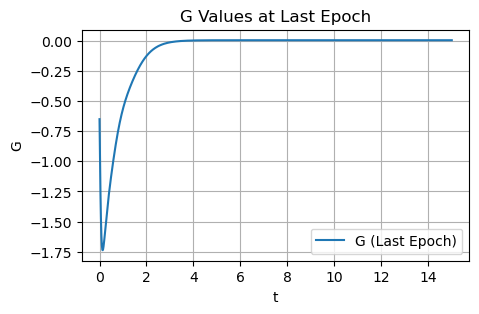

It 287500: loss = 8.60e-04,loss_G = 1.70e-01, alpha21 = 3.0305, alpha22 = 5.0524
Initial Condition: [20.00 -0.00 0.00 -0.00]


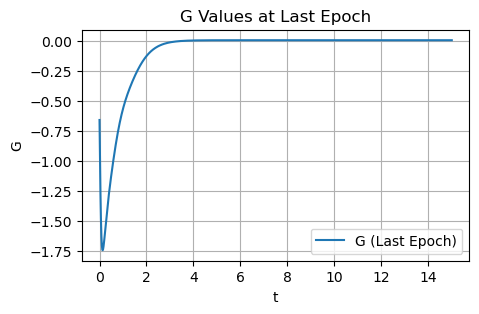

It 288000: loss = 2.56e-03,loss_G = 1.24e-01, alpha21 = 3.0308, alpha22 = 5.0535
Initial Condition: [20.00 -0.00 0.00 -0.00]


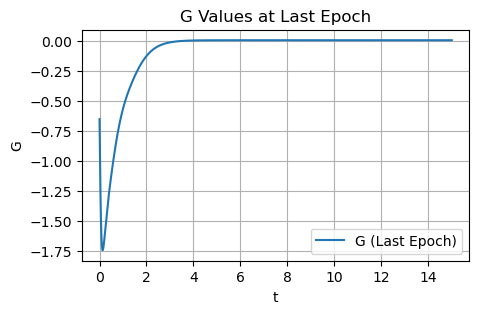

It 288500: loss = 8.60e-03,loss_G = 1.19e-01, alpha21 = 3.0316, alpha22 = 5.0539
Initial Condition: [20.00 -0.00 0.00 -0.00]


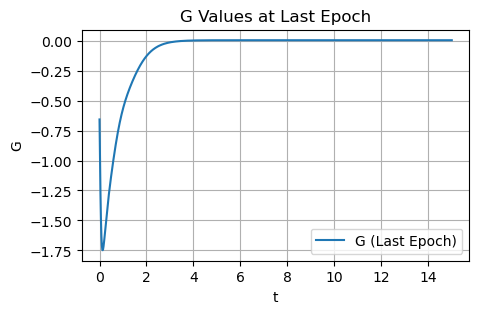

It 289000: loss = 8.51e-04,loss_G = 1.40e-01, alpha21 = 3.0303, alpha22 = 5.0556
Initial Condition: [20.00 0.00 0.00 0.00]


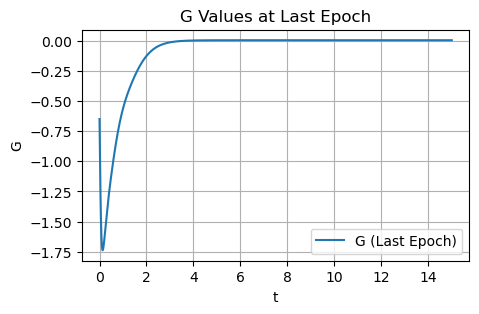

It 289500: loss = 8.63e-04,loss_G = 1.35e-01, alpha21 = 3.0306, alpha22 = 5.0552
Initial Condition: [20.00 -0.00 -0.00 -0.00]


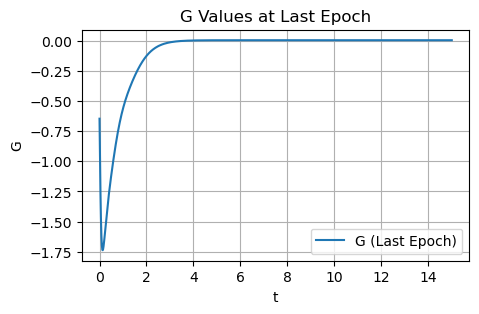

It 290000: loss = 6.04e-03,loss_G = 1.85e-01, alpha21 = 3.0290, alpha22 = 5.0558
Initial Condition: [20.00 0.00 0.00 0.00]


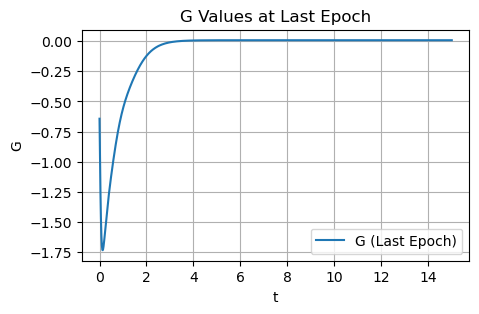

It 290500: loss = 8.53e-04,loss_G = 1.45e-01, alpha21 = 3.0305, alpha22 = 5.0558
Initial Condition: [20.00 0.00 0.00 0.00]


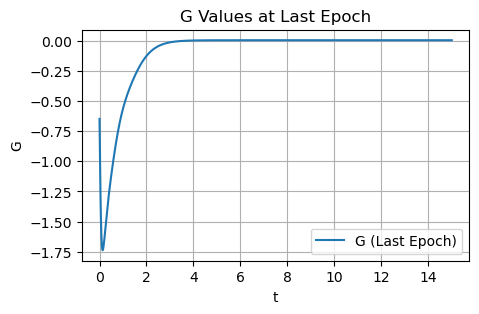

It 291000: loss = 8.55e-04,loss_G = 1.45e-01, alpha21 = 3.0311, alpha22 = 5.0565
Initial Condition: [20.00 -0.00 0.00 -0.00]


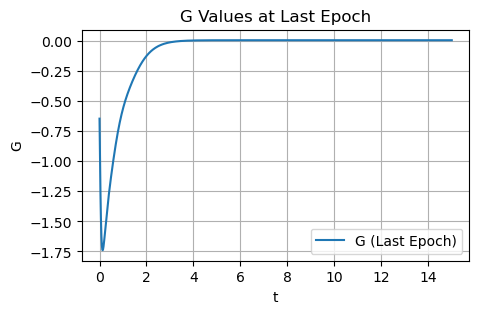

It 291500: loss = 8.51e-04,loss_G = 1.45e-01, alpha21 = 3.0302, alpha22 = 5.0551
Initial Condition: [20.00 0.00 0.00 -0.00]


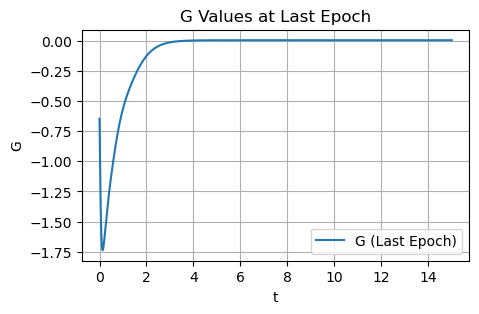

It 292000: loss = 8.51e-04,loss_G = 1.42e-01, alpha21 = 3.0288, alpha22 = 5.0527
Initial Condition: [20.00 0.00 0.00 0.00]


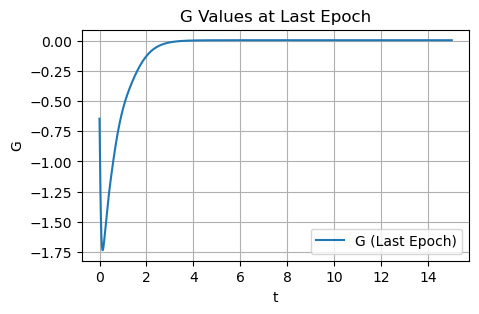

It 292500: loss = 8.90e-04,loss_G = 1.53e-01, alpha21 = 3.0305, alpha22 = 5.0550
Initial Condition: [20.00 -0.00 0.00 -0.00]


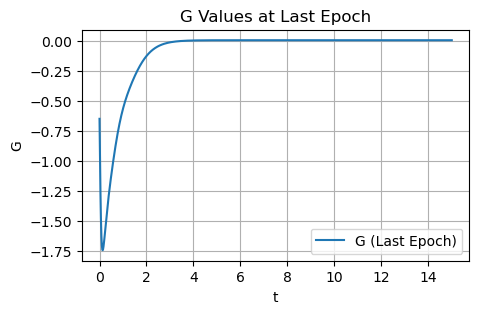

It 293000: loss = 8.51e-04,loss_G = 1.46e-01, alpha21 = 3.0304, alpha22 = 5.0554
Initial Condition: [20.00 0.00 0.00 0.00]


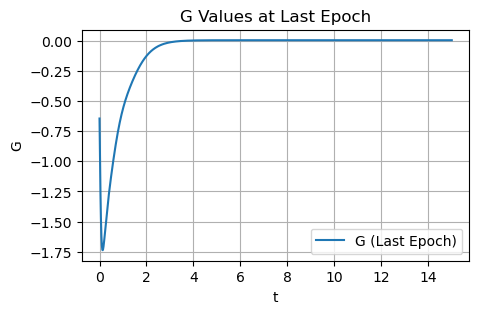

It 293500: loss = 8.51e-04,loss_G = 1.44e-01, alpha21 = 3.0297, alpha22 = 5.0540
Initial Condition: [20.00 0.00 0.00 -0.00]


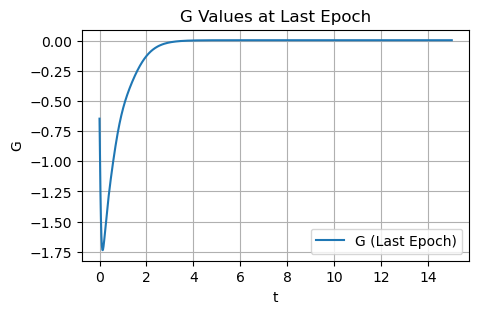

It 294000: loss = 8.51e-04,loss_G = 1.50e-01, alpha21 = 3.0309, alpha22 = 5.0562
Initial Condition: [20.00 0.00 0.00 -0.00]


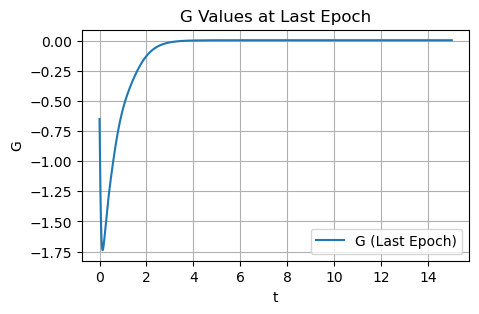

It 294500: loss = 1.07e-03,loss_G = 1.47e-01, alpha21 = 3.0304, alpha22 = 5.0567
Initial Condition: [20.00 0.00 0.00 0.00]


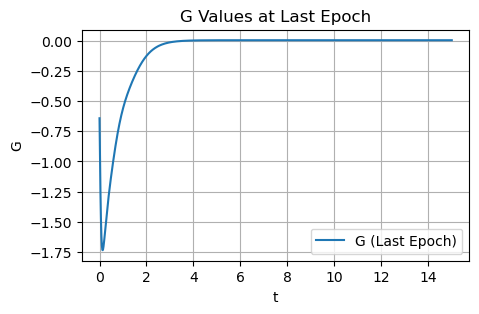

It 295000: loss = 1.60e-02,loss_G = 2.11e-01, alpha21 = 3.0287, alpha22 = 5.0578
Initial Condition: [19.99 0.00 -0.00 0.00]


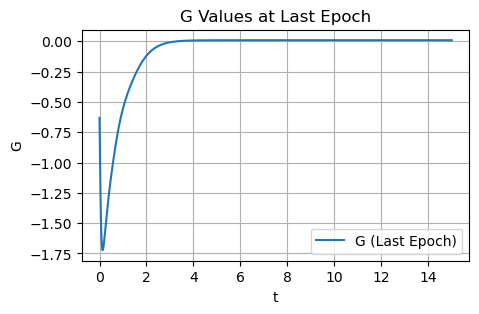

It 295500: loss = 8.51e-04,loss_G = 1.47e-01, alpha21 = 3.0307, alpha22 = 5.0559
Initial Condition: [20.00 0.00 0.00 0.00]


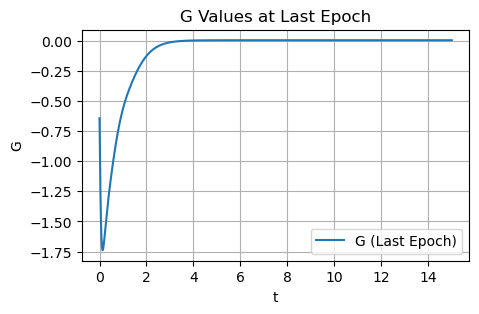

It 296000: loss = 8.51e-04,loss_G = 1.46e-01, alpha21 = 3.0311, alpha22 = 5.0569
Initial Condition: [20.00 0.00 0.00 -0.00]


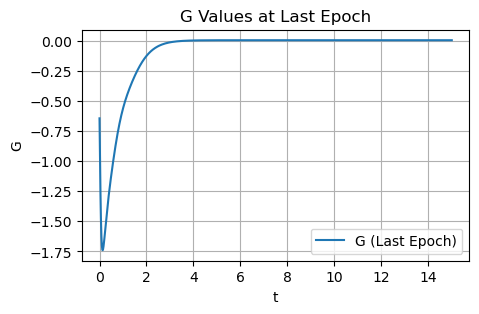

It 296500: loss = 8.88e-04,loss_G = 1.56e-01, alpha21 = 3.0305, alpha22 = 5.0551
Initial Condition: [20.00 0.00 -0.00 0.00]


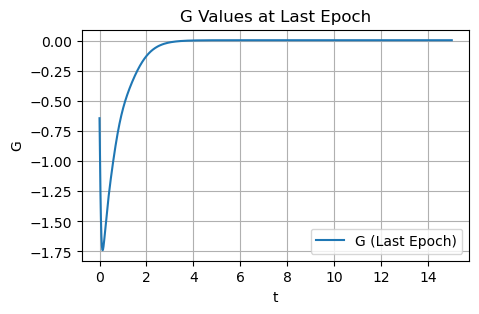

It 297000: loss = 1.14e-03,loss_G = 1.43e-01, alpha21 = 3.0306, alpha22 = 5.0569
Initial Condition: [20.00 -0.00 0.00 0.00]


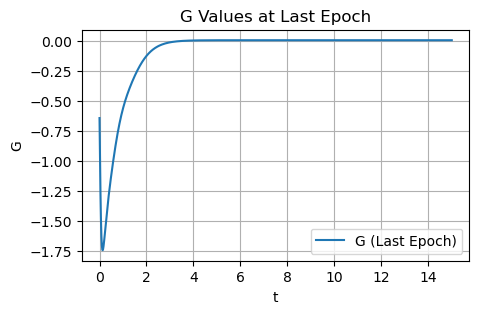

It 297500: loss = 8.51e-04,loss_G = 1.40e-01, alpha21 = 3.0297, alpha22 = 5.0544
Initial Condition: [20.00 0.00 0.00 -0.00]


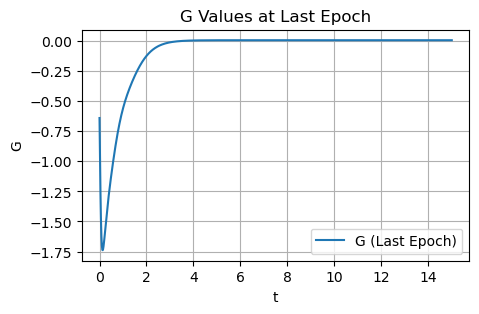

It 298000: loss = 8.51e-04,loss_G = 1.42e-01, alpha21 = 3.0299, alpha22 = 5.0548
Initial Condition: [20.00 0.00 0.00 0.00]


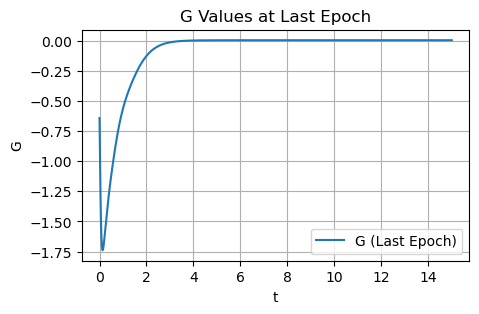

It 298500: loss = 1.58e-03,loss_G = 1.65e-01, alpha21 = 3.0304, alpha22 = 5.0526
Initial Condition: [20.00 -0.00 0.00 -0.00]


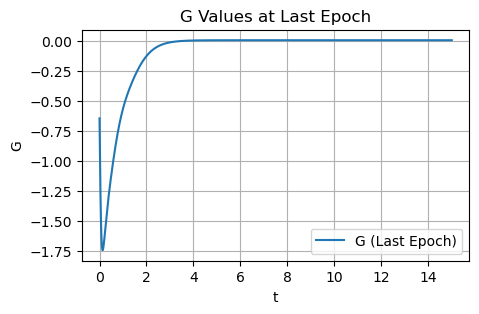

It 299000: loss = 1.01e-03,loss_G = 1.52e-01, alpha21 = 3.0299, alpha22 = 5.0531
Initial Condition: [20.00 -0.00 0.00 -0.00]


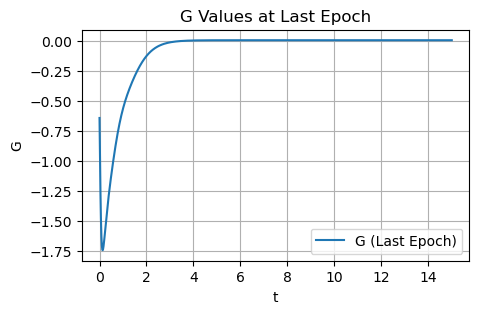

It 299500: loss = 8.54e-04,loss_G = 1.50e-01, alpha21 = 3.0293, alpha22 = 5.0532
Initial Condition: [20.00 0.00 0.00 0.00]


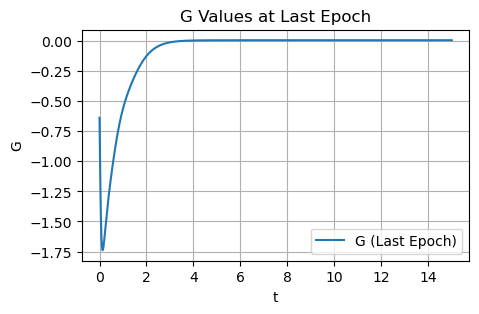

It 300000: loss = 8.51e-04,loss_G = 1.49e-01, alpha21 = 3.0295, alpha22 = 5.0540
Initial Condition: [20.00 0.00 0.00 0.00]


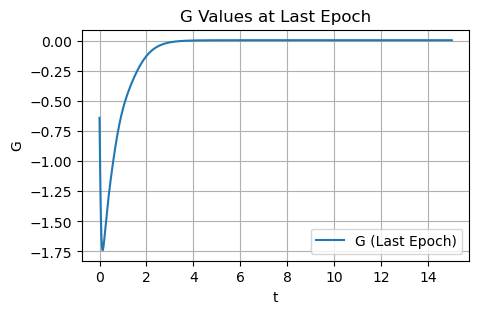

It 300500: loss = 8.51e-04,loss_G = 1.38e-01, alpha21 = 3.0274, alpha22 = 5.0502
Initial Condition: [20.00 0.00 0.00 -0.00]


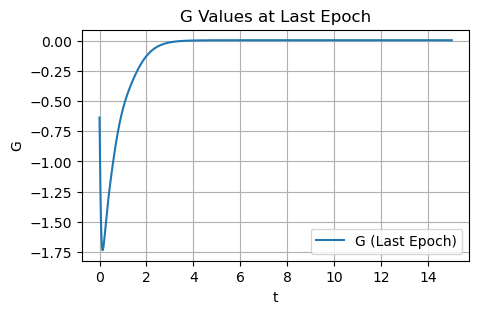

It 301000: loss = 8.51e-04,loss_G = 1.47e-01, alpha21 = 3.0295, alpha22 = 5.0537
Initial Condition: [20.00 0.00 0.00 0.00]


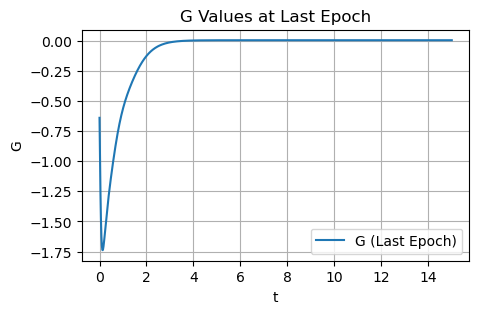

It 301500: loss = 8.51e-04,loss_G = 1.45e-01, alpha21 = 3.0289, alpha22 = 5.0527
Initial Condition: [20.00 0.00 0.00 -0.00]


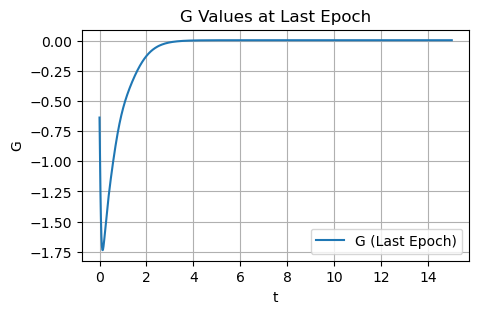

It 302000: loss = 8.55e-04,loss_G = 1.39e-01, alpha21 = 3.0288, alpha22 = 5.0526
Initial Condition: [20.00 -0.00 0.00 -0.00]


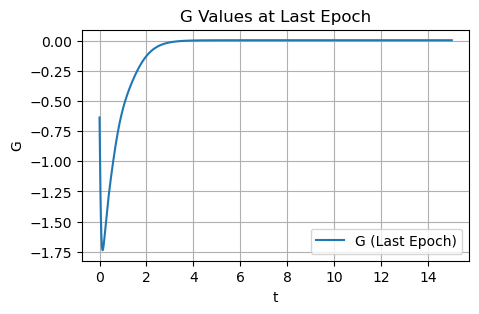

It 302500: loss = 8.52e-04,loss_G = 1.42e-01, alpha21 = 3.0292, alpha22 = 5.0536
Initial Condition: [20.00 0.00 0.00 0.00]


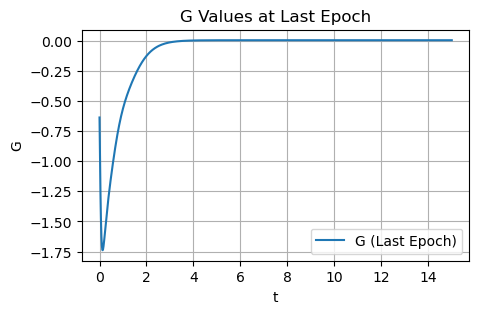

It 303000: loss = 8.51e-04,loss_G = 1.45e-01, alpha21 = 3.0288, alpha22 = 5.0526
Initial Condition: [20.00 0.00 0.00 0.00]


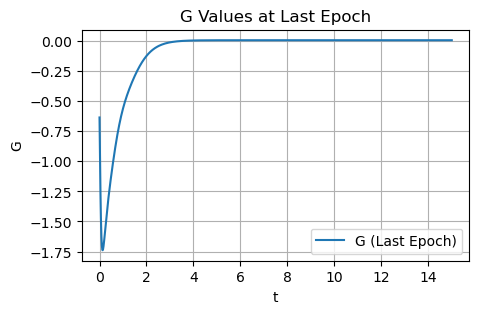

It 303500: loss = 8.51e-04,loss_G = 1.44e-01, alpha21 = 3.0284, alpha22 = 5.0518
Initial Condition: [20.00 0.00 0.00 0.00]


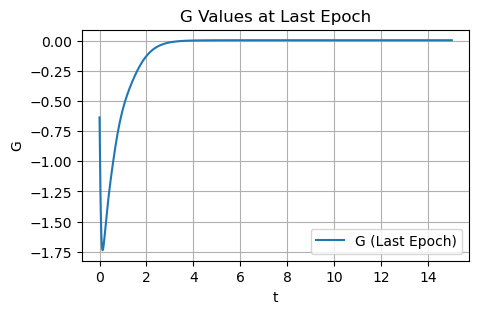

It 304000: loss = 8.51e-04,loss_G = 1.47e-01, alpha21 = 3.0292, alpha22 = 5.0532
Initial Condition: [20.00 0.00 0.00 -0.00]


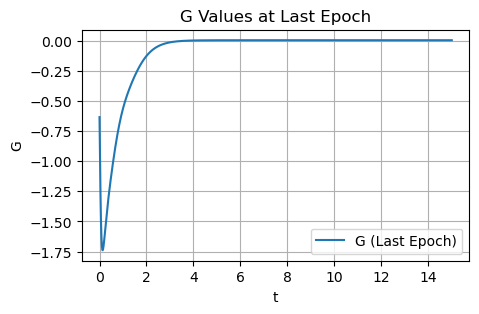

It 304500: loss = 1.00e-03,loss_G = 1.52e-01, alpha21 = 3.0280, alpha22 = 5.0527
Initial Condition: [20.00 0.00 0.00 0.00]


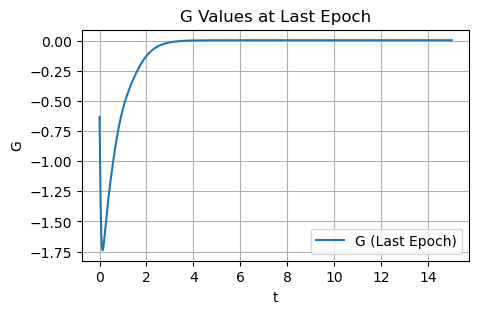

It 305000: loss = 8.82e-04,loss_G = 1.36e-01, alpha21 = 3.0283, alpha22 = 5.0532
Initial Condition: [20.00 0.00 0.00 0.00]


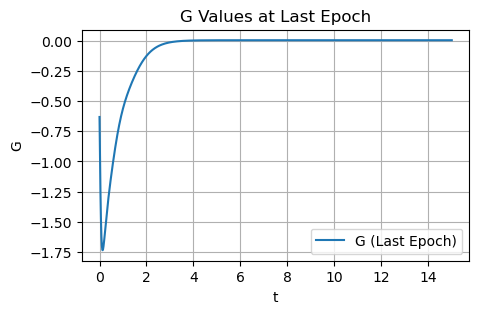

It 305500: loss = 1.79e-03,loss_G = 1.58e-01, alpha21 = 3.0276, alpha22 = 5.0525
Initial Condition: [20.00 0.00 0.00 0.00]


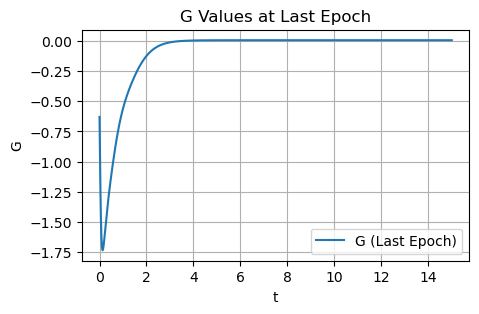

It 306000: loss = 8.51e-04,loss_G = 1.46e-01, alpha21 = 3.0297, alpha22 = 5.0543
Initial Condition: [20.00 0.00 0.00 -0.00]


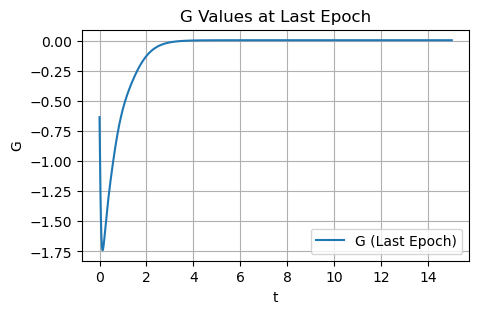

It 306500: loss = 8.51e-04,loss_G = 1.43e-01, alpha21 = 3.0284, alpha22 = 5.0520
Initial Condition: [20.00 0.00 0.00 0.00]


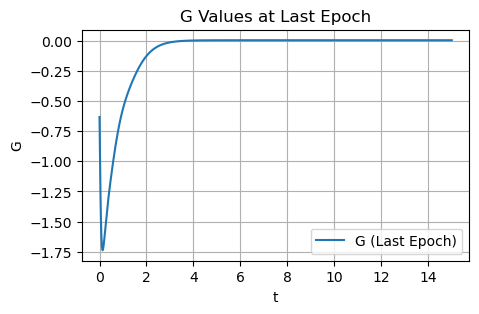

It 307000: loss = 8.54e-04,loss_G = 1.44e-01, alpha21 = 3.0301, alpha22 = 5.0547
Initial Condition: [20.00 -0.00 -0.00 -0.00]


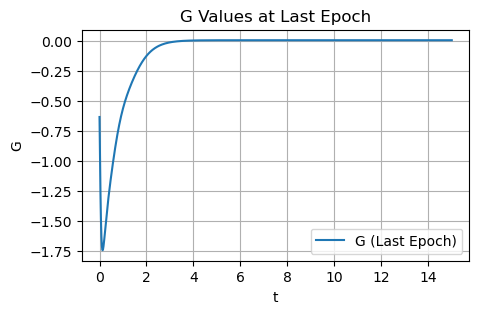

It 307500: loss = 9.48e-04,loss_G = 1.41e-01, alpha21 = 3.0288, alpha22 = 5.0532
Initial Condition: [20.00 0.00 -0.00 0.00]


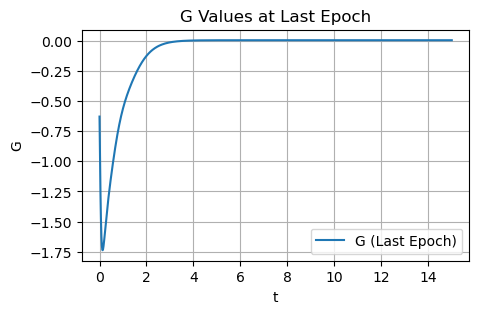

It 308000: loss = 8.52e-04,loss_G = 1.41e-01, alpha21 = 3.0289, alpha22 = 5.0529
Initial Condition: [20.00 -0.00 0.00 -0.00]


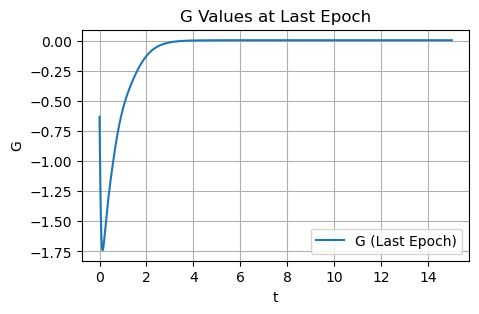

It 308500: loss = 8.53e-04,loss_G = 1.45e-01, alpha21 = 3.0266, alpha22 = 5.0489
Initial Condition: [20.00 0.00 0.00 0.00]


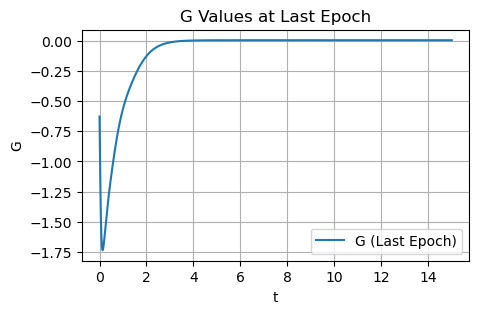

It 309000: loss = 8.55e-04,loss_G = 1.51e-01, alpha21 = 3.0284, alpha22 = 5.0520
Initial Condition: [20.00 0.00 0.00 0.00]


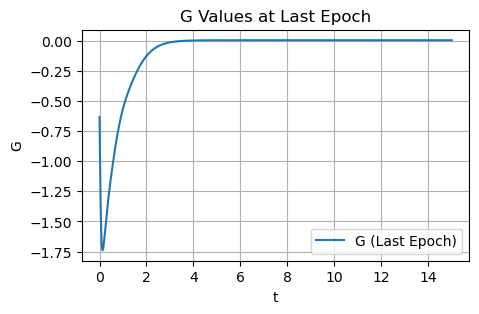

It 309500: loss = 8.82e-04,loss_G = 1.54e-01, alpha21 = 3.0279, alpha22 = 5.0506
Initial Condition: [20.00 0.00 0.00 0.00]


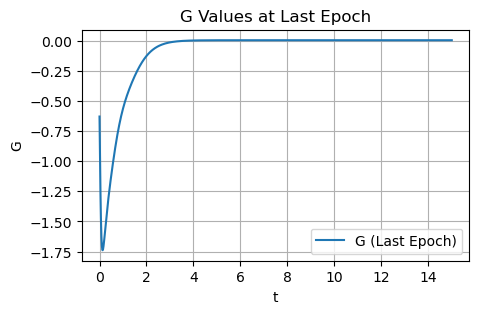

It 310000: loss = 1.41e-03,loss_G = 1.43e-01, alpha21 = 3.0283, alpha22 = 5.0528
Initial Condition: [20.00 0.00 -0.00 0.00]


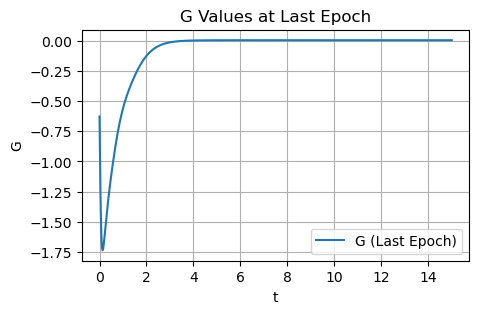

It 310500: loss = 8.51e-04,loss_G = 1.41e-01, alpha21 = 3.0284, alpha22 = 5.0520
Initial Condition: [20.00 0.00 0.00 -0.00]


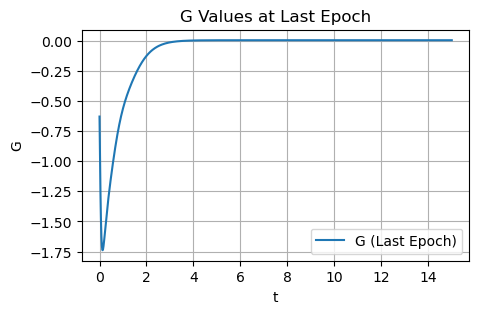

It 311000: loss = 1.31e-03,loss_G = 1.41e-01, alpha21 = 3.0274, alpha22 = 5.0513
Initial Condition: [20.00 0.00 -0.00 0.00]


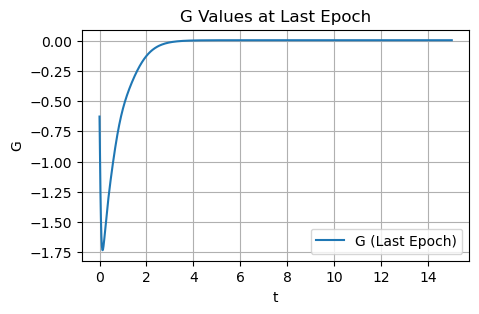

It 311500: loss = 1.55e-03,loss_G = 1.57e-01, alpha21 = 3.0278, alpha22 = 5.0498
Initial Condition: [20.00 0.00 -0.00 -0.00]


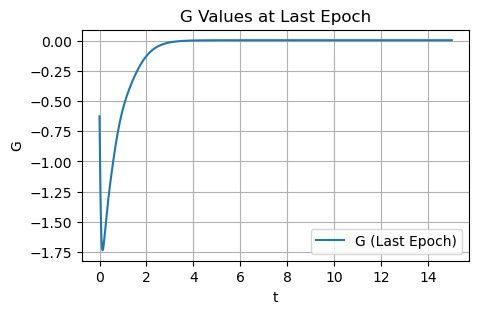

It 312000: loss = 8.51e-04,loss_G = 1.43e-01, alpha21 = 3.0272, alpha22 = 5.0496
Initial Condition: [20.00 0.00 0.00 -0.00]


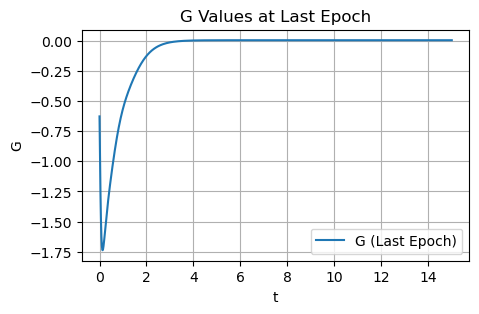

It 312500: loss = 8.51e-04,loss_G = 1.49e-01, alpha21 = 3.0284, alpha22 = 5.0517
Initial Condition: [20.00 0.00 0.00 -0.00]


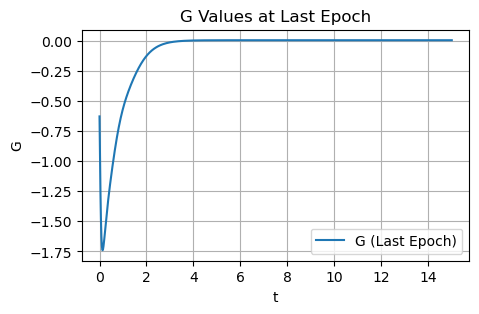

It 313000: loss = 8.54e-04,loss_G = 1.48e-01, alpha21 = 3.0284, alpha22 = 5.0515
Initial Condition: [20.00 -0.00 0.00 -0.00]


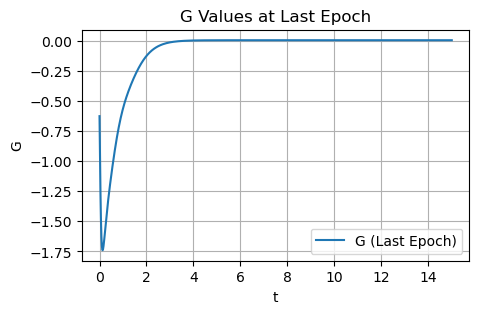

It 313500: loss = 1.63e-03,loss_G = 1.35e-01, alpha21 = 3.0289, alpha22 = 5.0515
Initial Condition: [20.00 -0.00 0.00 -0.00]


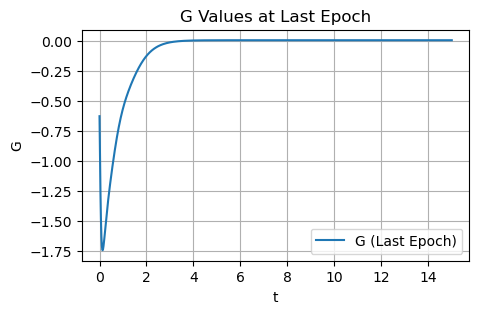

It 314000: loss = 8.51e-04,loss_G = 1.41e-01, alpha21 = 3.0285, alpha22 = 5.0523
Initial Condition: [20.00 0.00 0.00 -0.00]


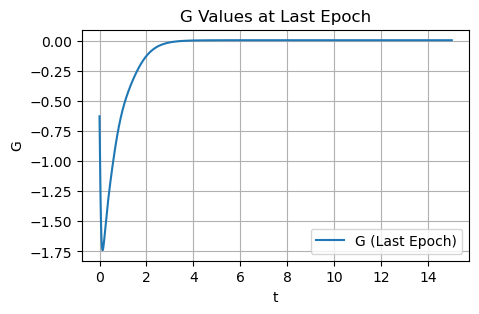

It 314500: loss = 8.51e-04,loss_G = 1.45e-01, alpha21 = 3.0285, alpha22 = 5.0521
Initial Condition: [20.00 0.00 0.00 0.00]


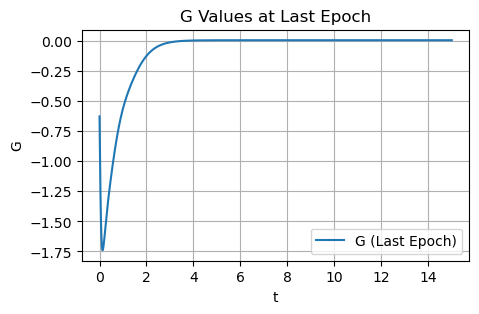

It 315000: loss = 8.51e-04,loss_G = 1.46e-01, alpha21 = 3.0281, alpha22 = 5.0513
Initial Condition: [20.00 0.00 0.00 -0.00]


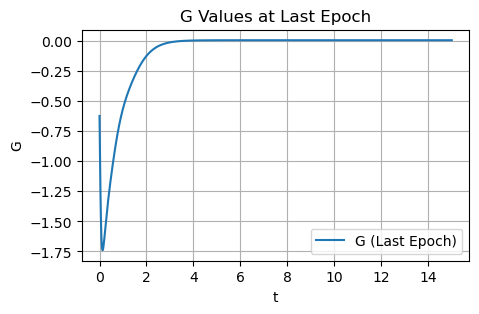

It 315500: loss = 8.51e-04,loss_G = 1.48e-01, alpha21 = 3.0270, alpha22 = 5.0492
Initial Condition: [20.00 0.00 0.00 0.00]


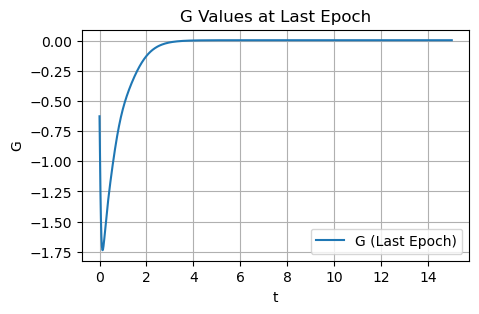

It 316000: loss = 9.00e-04,loss_G = 1.53e-01, alpha21 = 3.0262, alpha22 = 5.0478
Initial Condition: [20.00 0.00 -0.00 0.00]


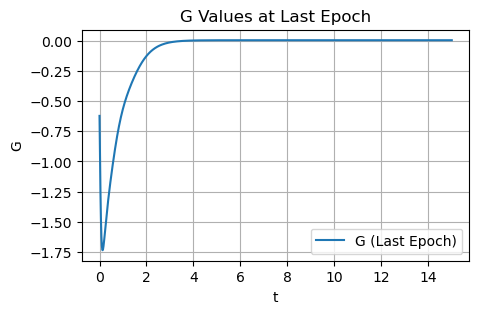

It 316500: loss = 8.54e-04,loss_G = 1.52e-01, alpha21 = 3.0277, alpha22 = 5.0502
Initial Condition: [20.00 0.00 0.00 0.00]


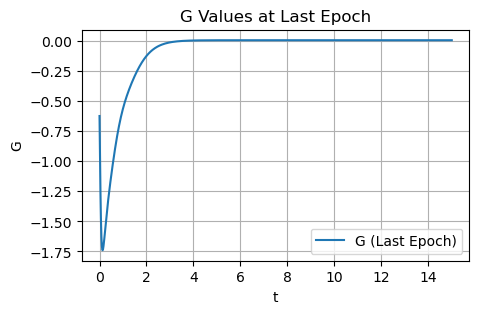

It 317000: loss = 1.01e-03,loss_G = 1.51e-01, alpha21 = 3.0269, alpha22 = 5.0522
Initial Condition: [20.00 0.00 0.00 0.00]


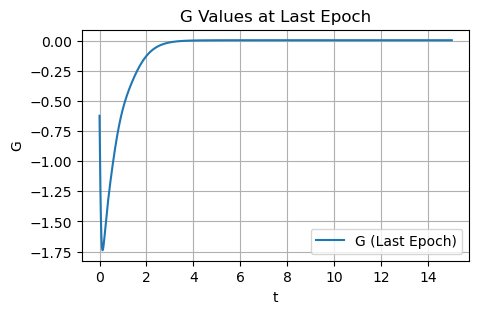

It 317500: loss = 8.51e-04,loss_G = 1.42e-01, alpha21 = 3.0269, alpha22 = 5.0491
Initial Condition: [20.00 0.00 0.00 0.00]


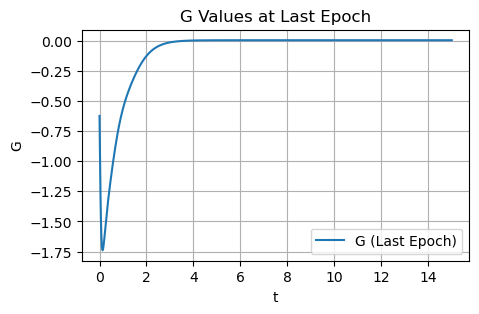

It 318000: loss = 6.75e-03,loss_G = 1.26e-01, alpha21 = 3.0280, alpha22 = 5.0480
Initial Condition: [20.00 -0.00 0.00 -0.00]


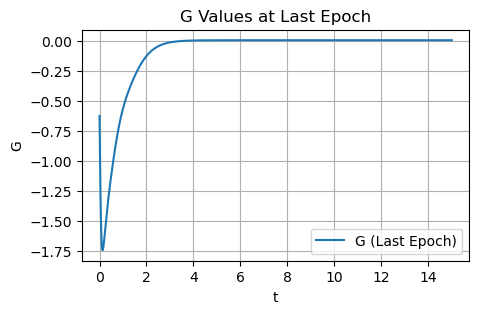

It 318500: loss = 8.58e-04,loss_G = 1.32e-01, alpha21 = 3.0271, alpha22 = 5.0496
Initial Condition: [20.00 -0.00 -0.00 -0.00]


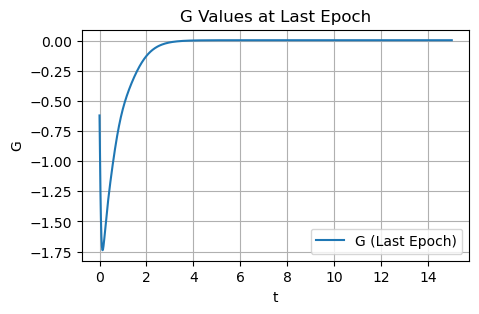

It 319000: loss = 8.53e-04,loss_G = 1.40e-01, alpha21 = 3.0271, alpha22 = 5.0496
Initial Condition: [20.00 -0.00 0.00 -0.00]


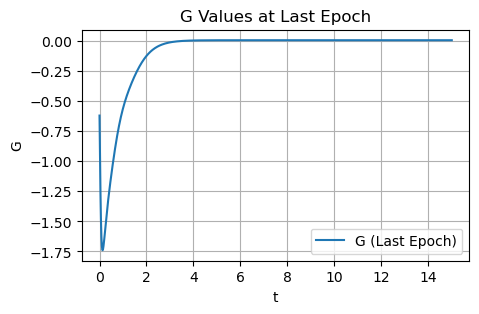

It 319500: loss = 8.74e-04,loss_G = 1.47e-01, alpha21 = 3.0269, alpha22 = 5.0489
Initial Condition: [20.00 -0.00 0.00 -0.00]


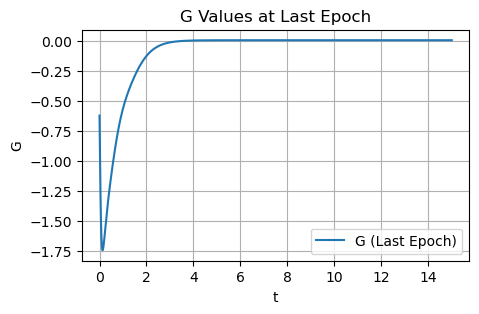

It 320000: loss = 1.73e-03,loss_G = 1.43e-01, alpha21 = 3.0281, alpha22 = 5.0472
Initial Condition: [20.00 -0.00 -0.00 -0.00]


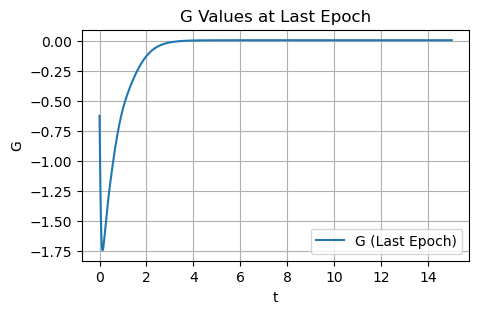

It 320500: loss = 9.39e-04,loss_G = 1.45e-01, alpha21 = 3.0265, alpha22 = 5.0486
Initial Condition: [20.00 0.00 0.00 0.00]


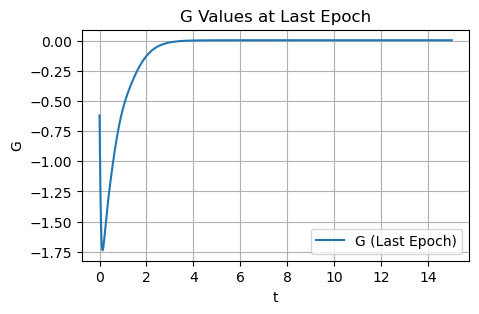

It 321000: loss = 8.52e-04,loss_G = 1.45e-01, alpha21 = 3.0270, alpha22 = 5.0491
Initial Condition: [20.00 -0.00 0.00 -0.00]


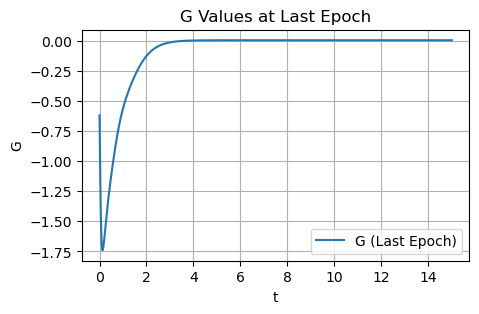

It 321500: loss = 8.52e-04,loss_G = 1.42e-01, alpha21 = 3.0269, alpha22 = 5.0491
Initial Condition: [20.00 -0.00 0.00 -0.00]


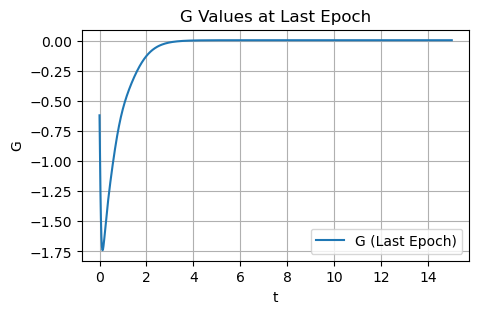

It 322000: loss = 4.28e-03,loss_G = 1.30e-01, alpha21 = 3.0280, alpha22 = 5.0477
Initial Condition: [20.00 -0.00 0.00 -0.00]


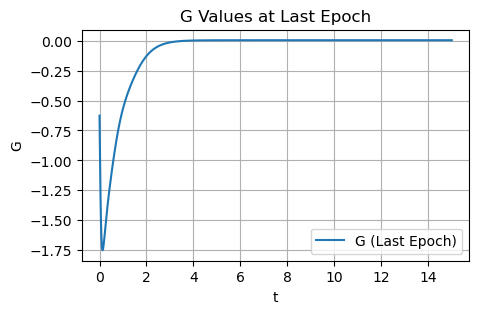

It 322500: loss = 8.51e-04,loss_G = 1.44e-01, alpha21 = 3.0268, alpha22 = 5.0489
Initial Condition: [20.00 0.00 0.00 -0.00]


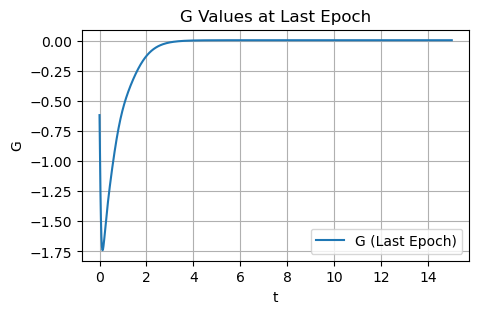

It 323000: loss = 8.79e-04,loss_G = 1.47e-01, alpha21 = 3.0267, alpha22 = 5.0489
Initial Condition: [20.00 0.00 0.00 0.00]


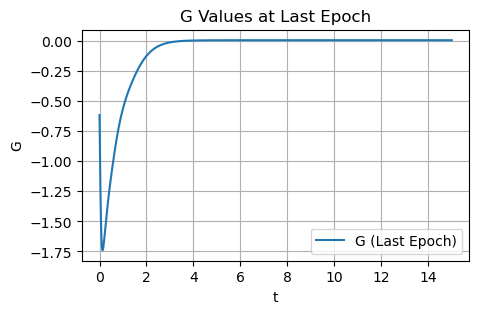

It 323500: loss = 8.51e-04,loss_G = 1.45e-01, alpha21 = 3.0268, alpha22 = 5.0490
Initial Condition: [20.00 0.00 0.00 0.00]


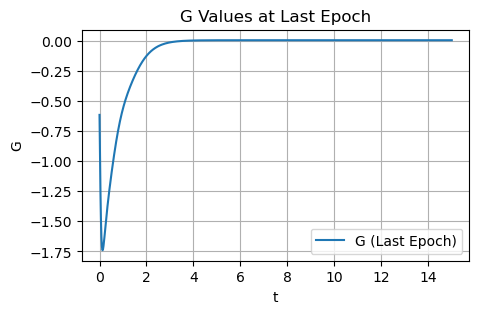

It 324000: loss = 8.51e-04,loss_G = 1.40e-01, alpha21 = 3.0270, alpha22 = 5.0495
Initial Condition: [20.00 0.00 0.00 -0.00]


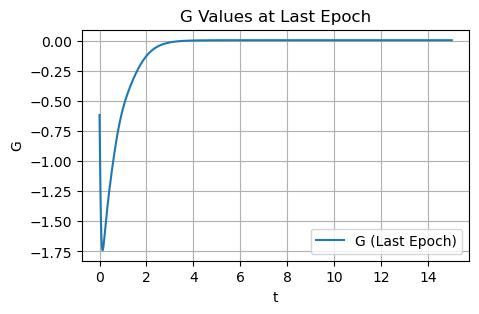

It 324500: loss = 8.58e-04,loss_G = 1.39e-01, alpha21 = 3.0267, alpha22 = 5.0492
Initial Condition: [20.00 0.00 0.00 0.00]


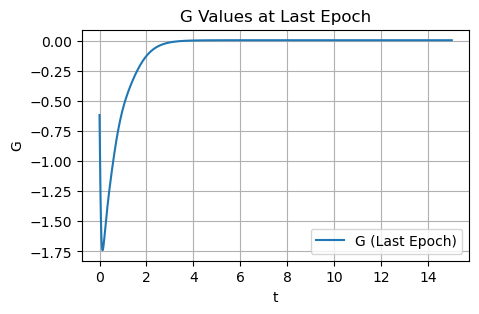

It 325000: loss = 5.35e-03,loss_G = 1.29e-01, alpha21 = 3.0275, alpha22 = 5.0464
Initial Condition: [20.00 -0.00 0.00 -0.00]


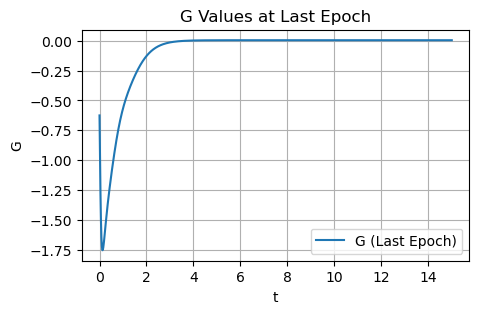

It 325500: loss = 1.25e-02,loss_G = 1.66e-01, alpha21 = 3.0237, alpha22 = 5.0494
Initial Condition: [19.99 0.01 -0.00 0.01]


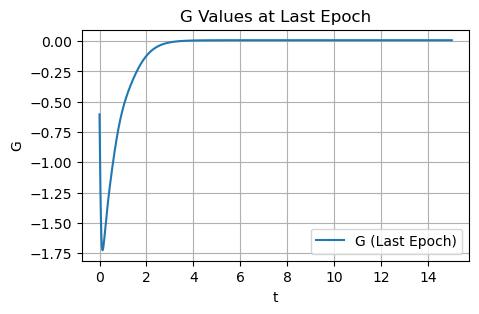

It 326000: loss = 8.51e-04,loss_G = 1.39e-01, alpha21 = 3.0268, alpha22 = 5.0492
Initial Condition: [20.00 0.00 0.00 0.00]


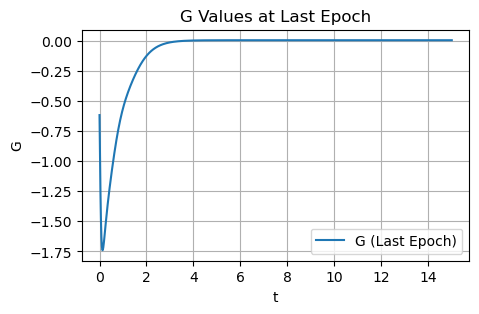

It 326500: loss = 8.51e-04,loss_G = 1.37e-01, alpha21 = 3.0258, alpha22 = 5.0473
Initial Condition: [20.00 0.00 0.00 -0.00]


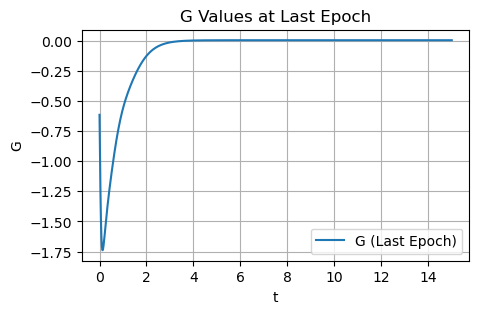

It 327000: loss = 8.51e-04,loss_G = 1.35e-01, alpha21 = 3.0248, alpha22 = 5.0454
Initial Condition: [20.00 0.00 0.00 -0.00]


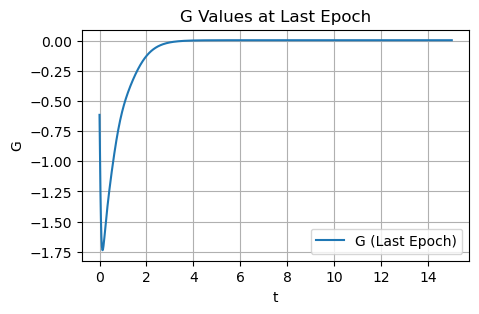

It 327500: loss = 8.51e-04,loss_G = 1.40e-01, alpha21 = 3.0259, alpha22 = 5.0474
Initial Condition: [20.00 0.00 0.00 -0.00]


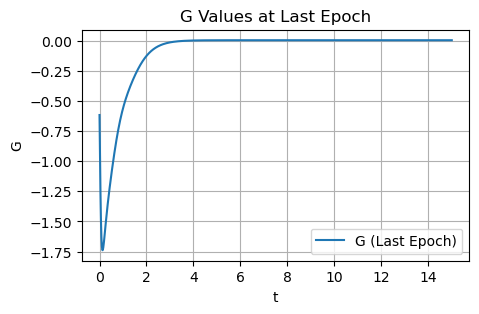

It 328000: loss = 8.51e-04,loss_G = 1.38e-01, alpha21 = 3.0253, alpha22 = 5.0463
Initial Condition: [20.00 0.00 0.00 -0.00]


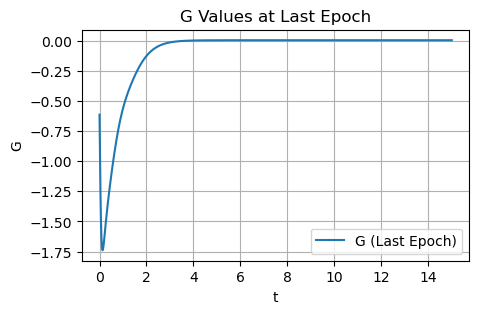

It 328500: loss = 8.51e-04,loss_G = 1.35e-01, alpha21 = 3.0239, alpha22 = 5.0439
Initial Condition: [20.00 0.00 0.00 -0.00]


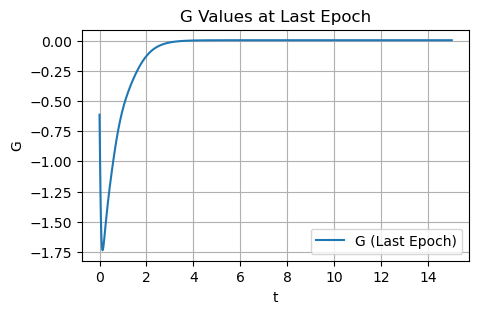

It 329000: loss = 8.51e-04,loss_G = 1.41e-01, alpha21 = 3.0254, alpha22 = 5.0463
Initial Condition: [20.00 0.00 0.00 -0.00]


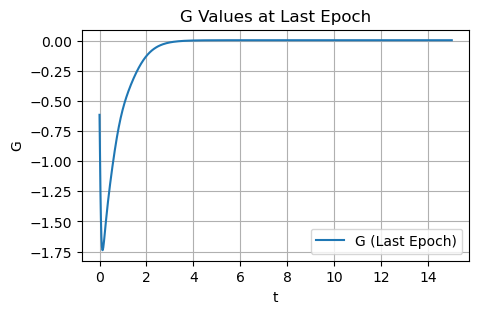

It 329500: loss = 8.51e-04,loss_G = 1.37e-01, alpha21 = 3.0249, alpha22 = 5.0456
Initial Condition: [20.00 0.00 0.00 -0.00]


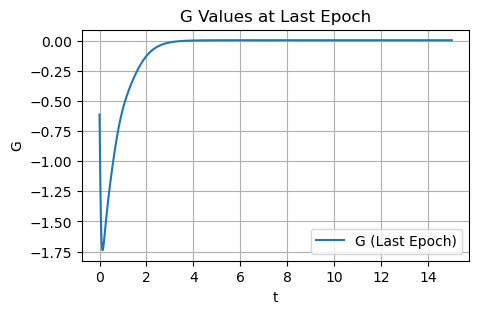

It 330000: loss = 1.17e-03,loss_G = 1.38e-01, alpha21 = 3.0248, alpha22 = 5.0441
Initial Condition: [20.00 -0.00 0.00 -0.00]


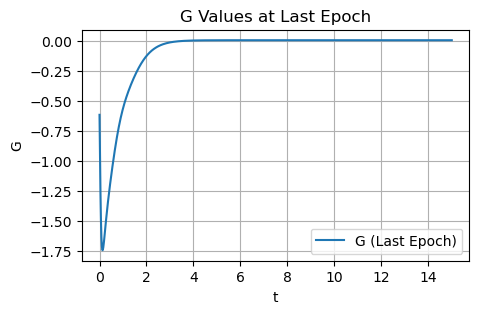

It 330500: loss = 8.51e-04,loss_G = 1.38e-01, alpha21 = 3.0255, alpha22 = 5.0468
Initial Condition: [20.00 0.00 0.00 -0.00]


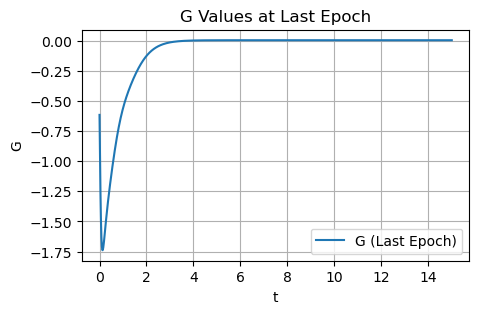

It 331000: loss = 8.51e-04,loss_G = 1.37e-01, alpha21 = 3.0249, alpha22 = 5.0456
Initial Condition: [20.00 0.00 0.00 -0.00]


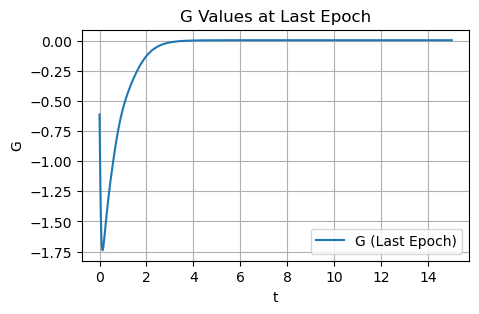

It 331500: loss = 9.40e-04,loss_G = 1.35e-01, alpha21 = 3.0251, alpha22 = 5.0453
Initial Condition: [20.00 -0.00 0.00 -0.00]


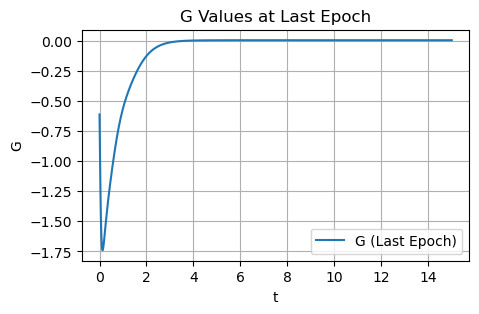

It 332000: loss = 9.14e-03,loss_G = 1.86e-01, alpha21 = 3.0239, alpha22 = 5.0465
Initial Condition: [20.00 0.00 -0.00 0.00]


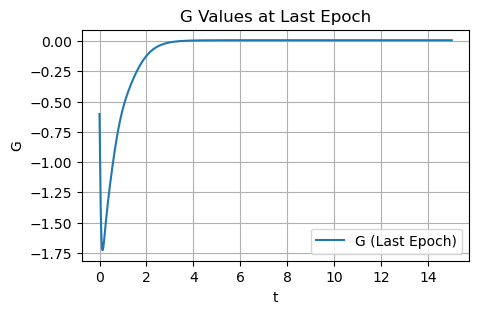

It 332500: loss = 8.51e-04,loss_G = 1.40e-01, alpha21 = 3.0248, alpha22 = 5.0453
Initial Condition: [20.00 0.00 0.00 -0.00]


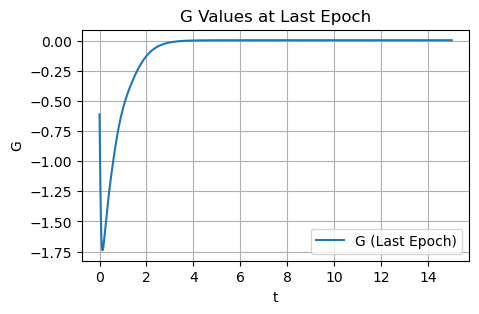

It 333000: loss = 8.51e-04,loss_G = 1.40e-01, alpha21 = 3.0247, alpha22 = 5.0451
Initial Condition: [20.00 0.00 0.00 -0.00]


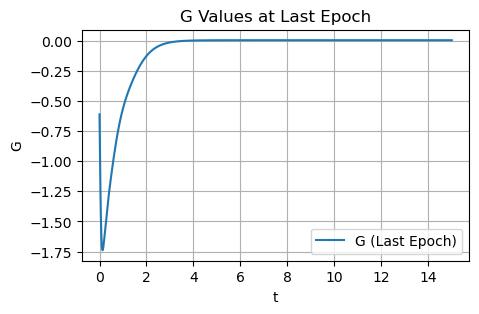

It 333500: loss = 8.51e-04,loss_G = 1.28e-01, alpha21 = 3.0234, alpha22 = 5.0433
Initial Condition: [20.00 0.00 0.00 0.00]


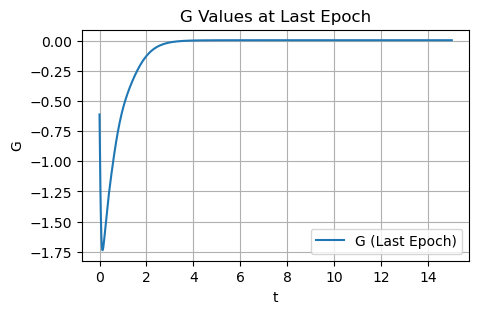

It 334000: loss = 8.51e-04,loss_G = 1.37e-01, alpha21 = 3.0243, alpha22 = 5.0445
Initial Condition: [20.00 0.00 0.00 -0.00]


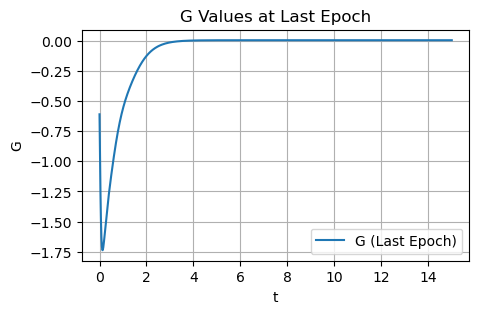

It 334500: loss = 8.51e-04,loss_G = 1.42e-01, alpha21 = 3.0241, alpha22 = 5.0439
Initial Condition: [20.00 0.00 0.00 0.00]


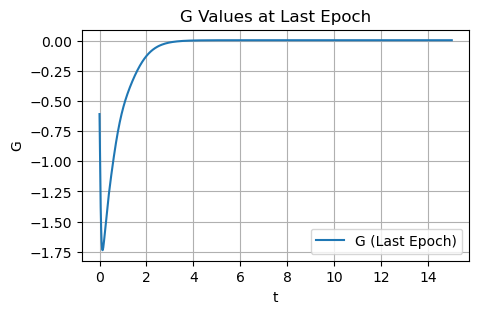

It 335000: loss = 8.51e-04,loss_G = 1.41e-01, alpha21 = 3.0237, alpha22 = 5.0431
Initial Condition: [20.00 0.00 0.00 0.00]


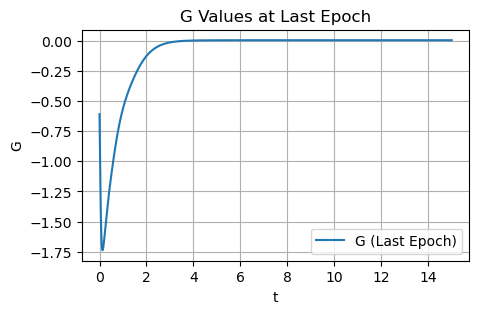

It 335500: loss = 8.54e-04,loss_G = 1.36e-01, alpha21 = 3.0215, alpha22 = 5.0391
Initial Condition: [20.00 -0.00 0.00 0.00]


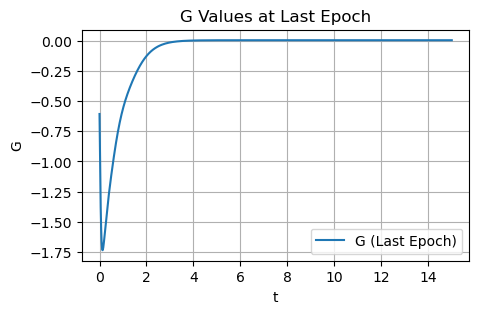

It 336000: loss = 8.69e-04,loss_G = 1.31e-01, alpha21 = 3.0235, alpha22 = 5.0437
Initial Condition: [20.00 0.00 0.00 0.00]


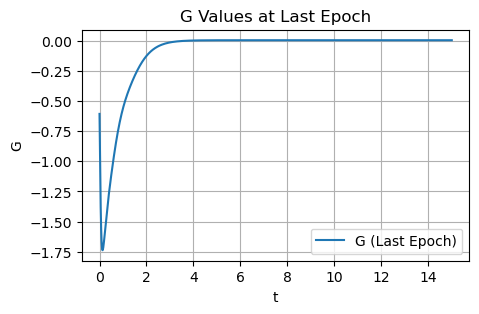

It 336500: loss = 8.51e-04,loss_G = 1.35e-01, alpha21 = 3.0231, alpha22 = 5.0424
Initial Condition: [20.00 0.00 0.00 -0.00]


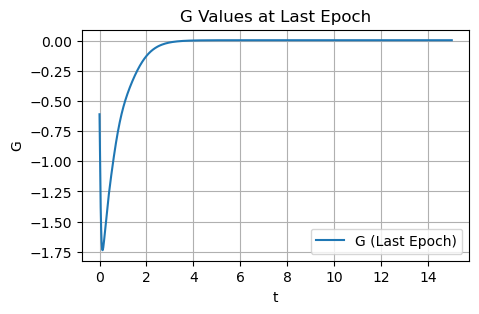

It 337000: loss = 8.51e-04,loss_G = 1.38e-01, alpha21 = 3.0229, alpha22 = 5.0417
Initial Condition: [20.00 0.00 0.00 0.00]


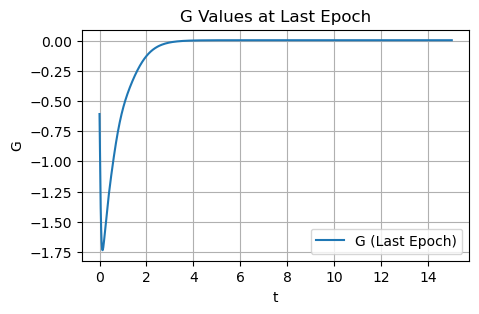

It 337500: loss = 8.51e-04,loss_G = 1.39e-01, alpha21 = 3.0224, alpha22 = 5.0408
Initial Condition: [20.00 0.00 0.00 -0.00]


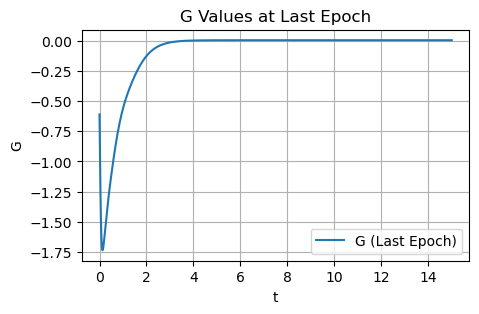

It 338000: loss = 8.62e-04,loss_G = 1.45e-01, alpha21 = 3.0228, alpha22 = 5.0406
Initial Condition: [20.00 -0.00 0.00 -0.00]


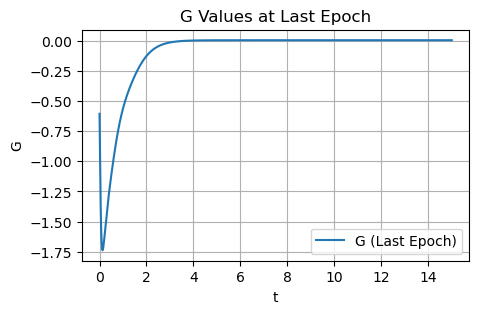

It 338500: loss = 8.51e-04,loss_G = 1.34e-01, alpha21 = 3.0232, alpha22 = 5.0426
Initial Condition: [20.00 0.00 0.00 -0.00]


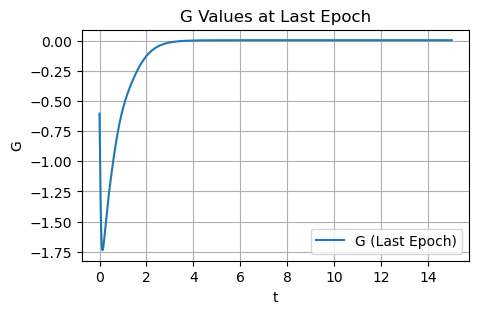

It 339000: loss = 5.03e-03,loss_G = 1.70e-01, alpha21 = 3.0225, alpha22 = 5.0432
Initial Condition: [20.00 0.00 -0.00 0.00]


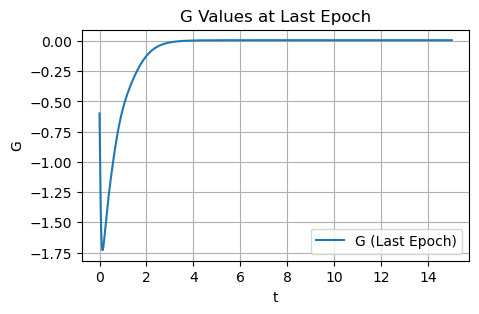

It 339500: loss = 8.51e-04,loss_G = 1.39e-01, alpha21 = 3.0236, alpha22 = 5.0431
Initial Condition: [20.00 0.00 0.00 -0.00]


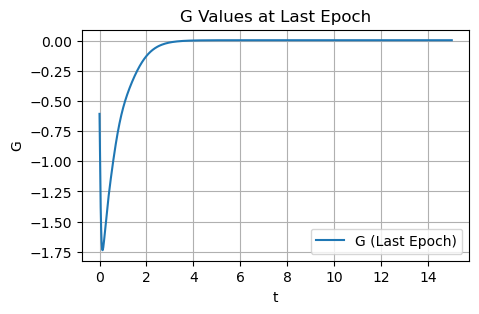

It 340000: loss = 8.51e-04,loss_G = 1.34e-01, alpha21 = 3.0230, alpha22 = 5.0421
Initial Condition: [20.00 0.00 0.00 -0.00]


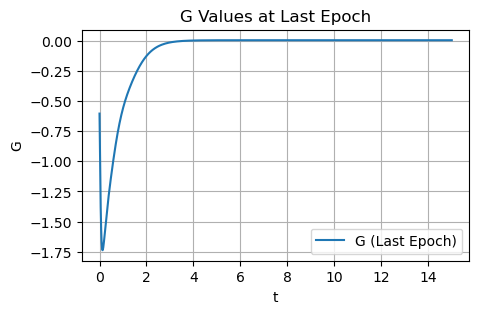

It 340500: loss = 8.51e-04,loss_G = 1.31e-01, alpha21 = 3.0224, alpha22 = 5.0412
Initial Condition: [20.00 0.00 0.00 -0.00]


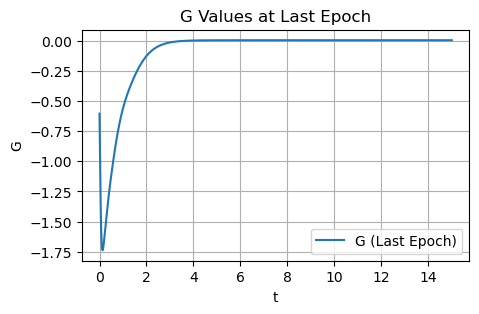

It 341000: loss = 1.03e-03,loss_G = 1.26e-01, alpha21 = 3.0242, alpha22 = 5.0416
Initial Condition: [20.00 0.00 -0.00 -0.00]


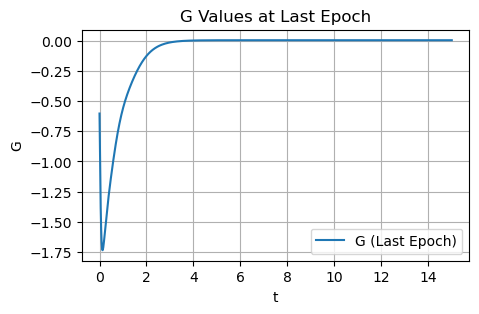

It 341500: loss = 1.22e-03,loss_G = 1.33e-01, alpha21 = 3.0229, alpha22 = 5.0400
Initial Condition: [20.00 -0.00 0.00 -0.00]


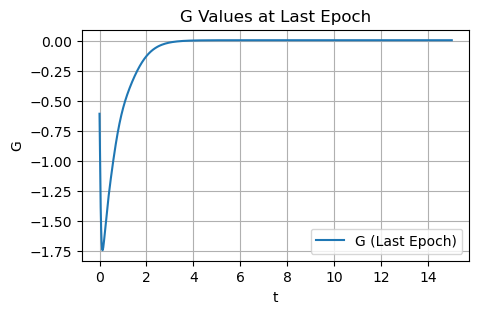

It 342000: loss = 8.51e-04,loss_G = 1.38e-01, alpha21 = 3.0226, alpha22 = 5.0413
Initial Condition: [20.00 0.00 0.00 0.00]


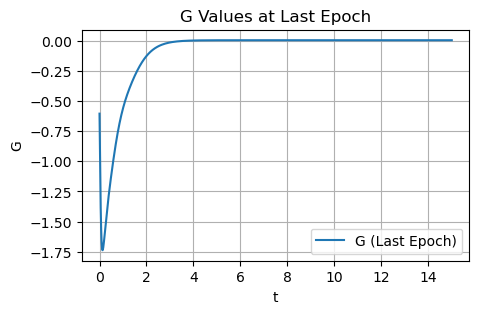

It 342500: loss = 8.51e-04,loss_G = 1.35e-01, alpha21 = 3.0215, alpha22 = 5.0392
Initial Condition: [20.00 0.00 0.00 -0.00]


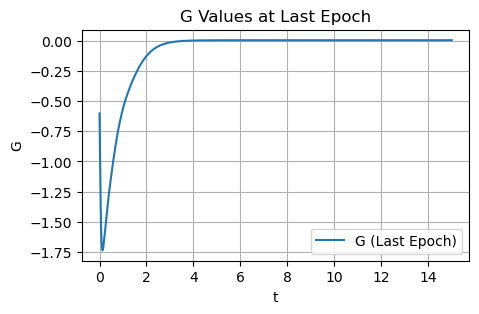

It 343000: loss = 8.57e-04,loss_G = 1.47e-01, alpha21 = 3.0224, alpha22 = 5.0405
Initial Condition: [20.00 -0.00 -0.00 -0.00]


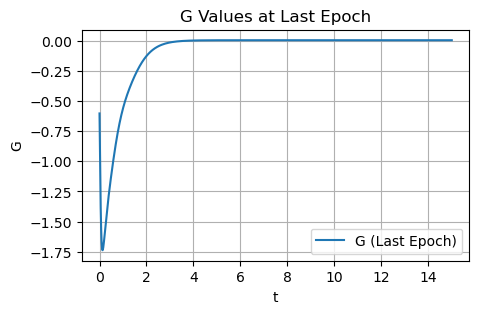

It 343500: loss = 8.51e-04,loss_G = 1.34e-01, alpha21 = 3.0225, alpha22 = 5.0412
Initial Condition: [20.00 0.00 0.00 -0.00]


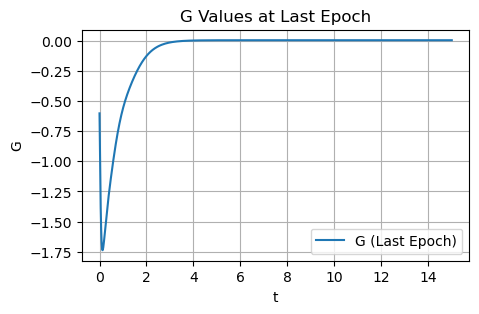

It 344000: loss = 8.51e-04,loss_G = 1.33e-01, alpha21 = 3.0227, alpha22 = 5.0418
Initial Condition: [20.00 0.00 0.00 0.00]


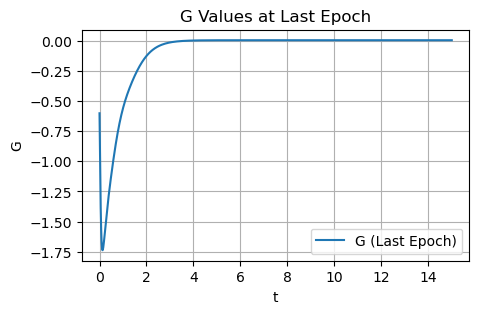

It 344500: loss = 9.28e-04,loss_G = 1.26e-01, alpha21 = 3.0225, alpha22 = 5.0410
Initial Condition: [20.00 -0.00 0.00 -0.00]


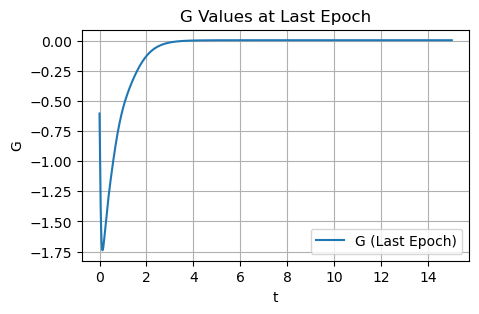

It 345000: loss = 8.58e-04,loss_G = 1.25e-01, alpha21 = 3.0222, alpha22 = 5.0404
Initial Condition: [20.00 -0.00 -0.00 -0.00]


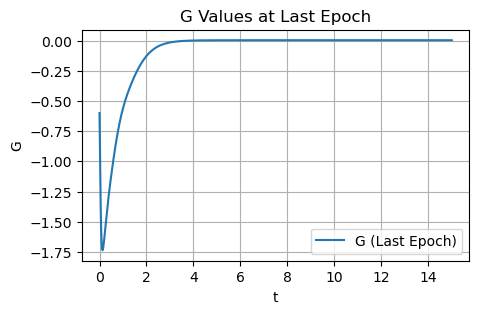

It 345500: loss = 9.12e-04,loss_G = 1.36e-01, alpha21 = 3.0220, alpha22 = 5.0390
Initial Condition: [20.00 -0.00 -0.00 -0.00]


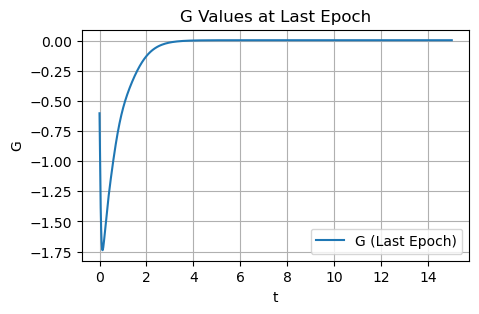

It 346000: loss = 8.51e-04,loss_G = 1.35e-01, alpha21 = 3.0219, alpha22 = 5.0401
Initial Condition: [20.00 0.00 0.00 -0.00]


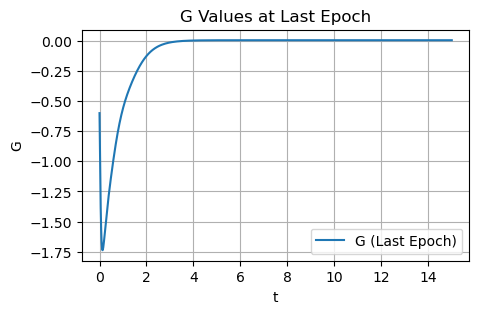

It 346500: loss = 8.51e-04,loss_G = 1.42e-01, alpha21 = 3.0211, alpha22 = 5.0385
Initial Condition: [20.00 0.00 0.00 0.00]


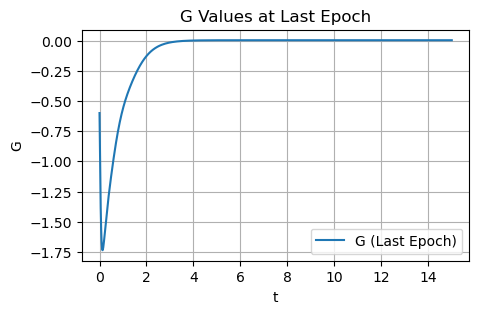

It 347000: loss = 2.80e-03,loss_G = 1.63e-01, alpha21 = 3.0207, alpha22 = 5.0407
Initial Condition: [20.00 0.00 -0.00 0.00]


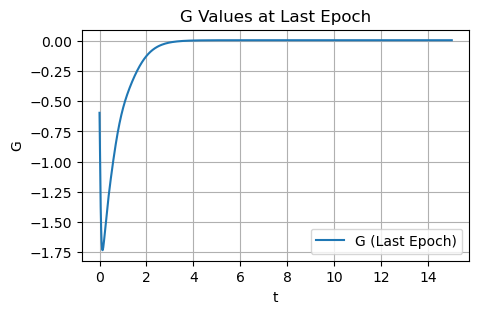

It 347500: loss = 1.83e-03,loss_G = 1.55e-01, alpha21 = 3.0208, alpha22 = 5.0382
Initial Condition: [20.00 -0.00 0.00 -0.00]


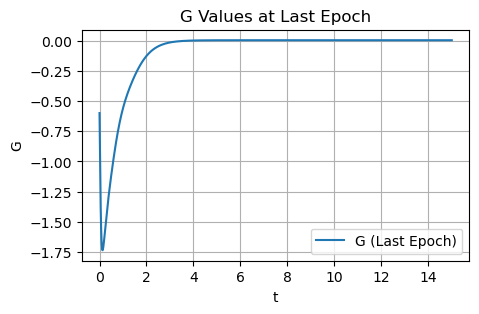

It 348000: loss = 8.57e-04,loss_G = 1.34e-01, alpha21 = 3.0223, alpha22 = 5.0417
Initial Condition: [20.00 0.00 0.00 0.00]


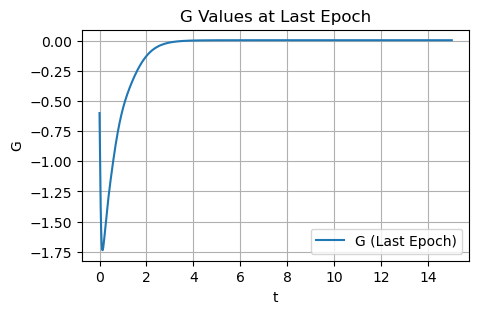

It 348500: loss = 8.51e-04,loss_G = 1.39e-01, alpha21 = 3.0220, alpha22 = 5.0400
Initial Condition: [20.00 0.00 0.00 -0.00]


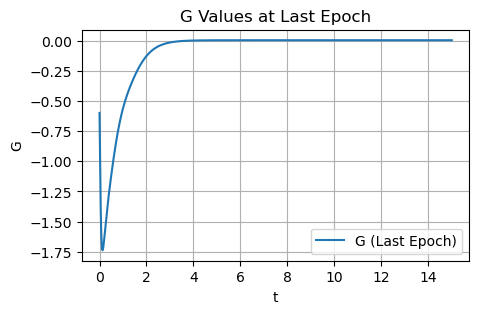

It 349000: loss = 8.51e-04,loss_G = 1.36e-01, alpha21 = 3.0220, alpha22 = 5.0403
Initial Condition: [20.00 0.00 0.00 0.00]


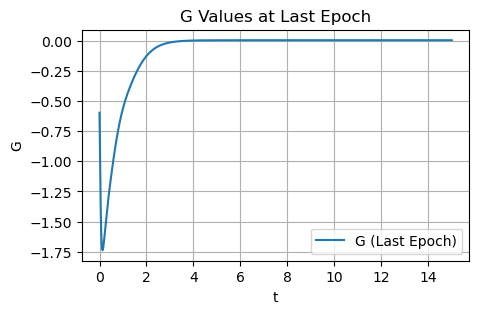

It 349500: loss = 8.51e-04,loss_G = 1.30e-01, alpha21 = 3.0211, alpha22 = 5.0387
Initial Condition: [20.00 0.00 0.00 -0.00]


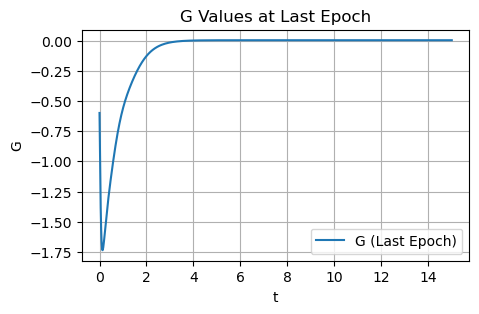

It 350000: loss = 8.51e-04,loss_G = 1.35e-01, alpha21 = 3.0222, alpha22 = 5.0406
Initial Condition: [20.00 0.00 0.00 -0.00]


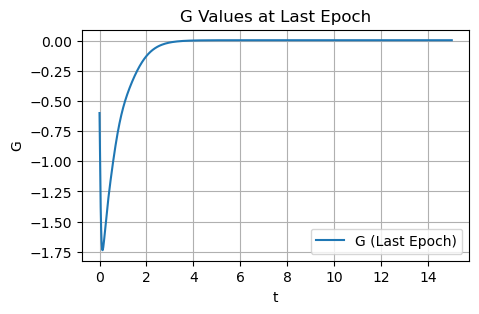

It 350500: loss = 8.51e-04,loss_G = 1.39e-01, alpha21 = 3.0218, alpha22 = 5.0397
Initial Condition: [20.00 0.00 0.00 -0.00]


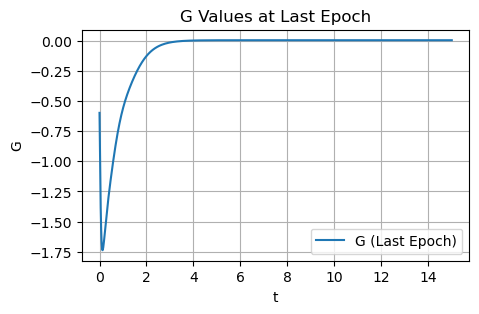

It 351000: loss = 8.56e-04,loss_G = 1.29e-01, alpha21 = 3.0218, alpha22 = 5.0403
Initial Condition: [20.00 0.00 0.00 0.00]


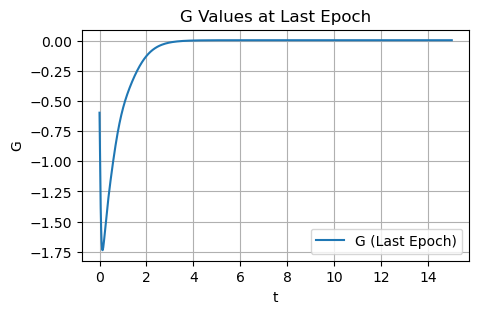

It 351500: loss = 8.51e-04,loss_G = 1.38e-01, alpha21 = 3.0214, alpha22 = 5.0390
Initial Condition: [20.00 -0.00 0.00 -0.00]


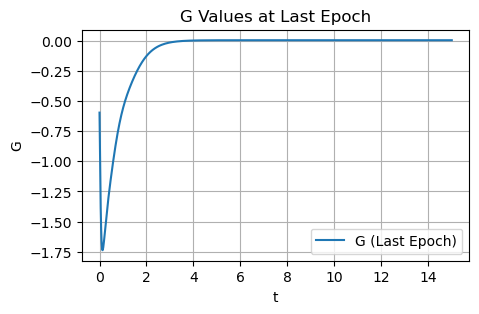

It 352000: loss = 1.07e-03,loss_G = 1.45e-01, alpha21 = 3.0210, alpha22 = 5.0372
Initial Condition: [20.00 -0.00 0.00 -0.00]


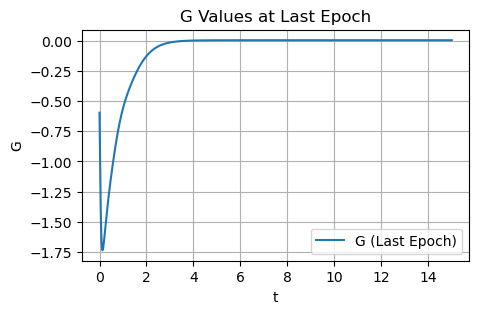

It 352500: loss = 8.79e-04,loss_G = 1.33e-01, alpha21 = 3.0206, alpha22 = 5.0377
Initial Condition: [20.00 0.00 -0.00 0.00]


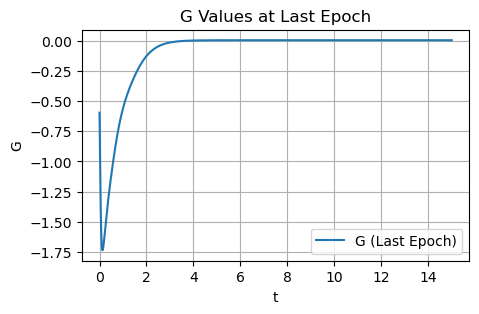

It 353000: loss = 8.54e-04,loss_G = 1.36e-01, alpha21 = 3.0208, alpha22 = 5.0376
Initial Condition: [20.00 -0.00 0.00 -0.00]


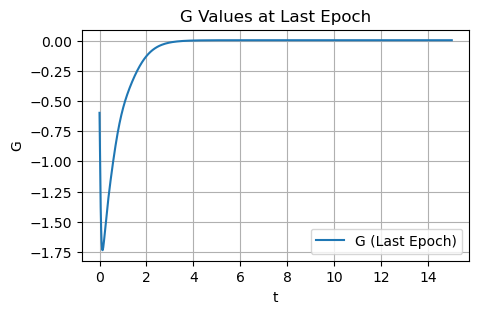

It 353500: loss = 8.51e-04,loss_G = 1.29e-01, alpha21 = 3.0188, alpha22 = 5.0343
Initial Condition: [20.00 0.00 0.00 -0.00]


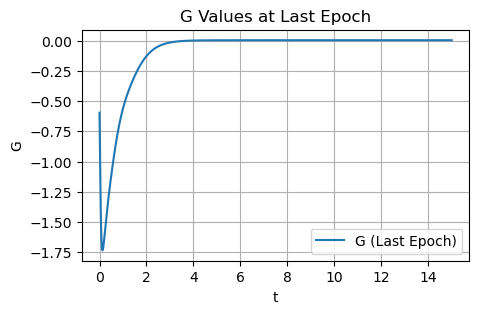

It 354000: loss = 8.52e-04,loss_G = 1.41e-01, alpha21 = 3.0204, alpha22 = 5.0368
Initial Condition: [20.00 0.00 0.00 -0.00]


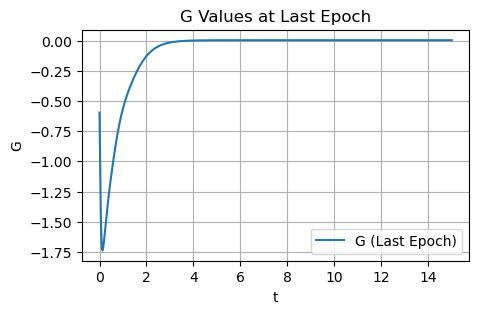

It 354500: loss = 8.60e-04,loss_G = 1.45e-01, alpha21 = 3.0196, alpha22 = 5.0361
Initial Condition: [20.00 0.00 0.00 0.00]


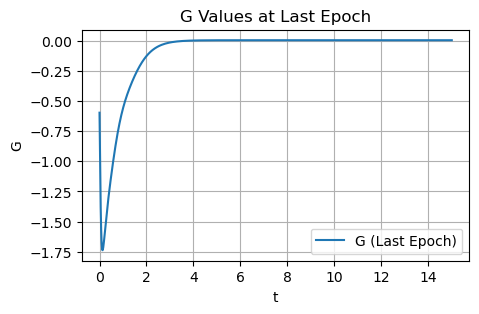

It 355000: loss = 8.75e-04,loss_G = 1.34e-01, alpha21 = 3.0199, alpha22 = 5.0360
Initial Condition: [20.00 -0.00 0.00 -0.00]


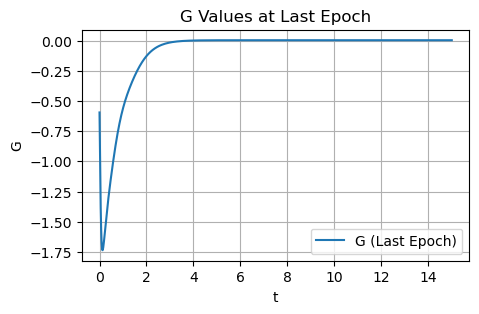

It 355500: loss = 8.51e-04,loss_G = 1.38e-01, alpha21 = 3.0203, alpha22 = 5.0369
Initial Condition: [20.00 0.00 0.00 -0.00]


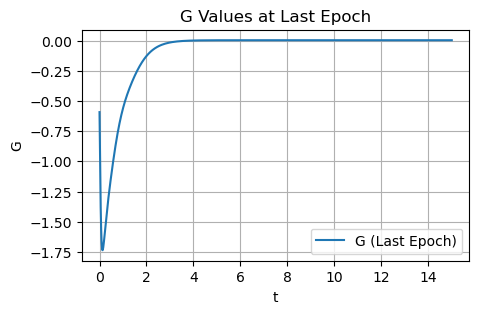

It 356000: loss = 8.94e-04,loss_G = 1.31e-01, alpha21 = 3.0208, alpha22 = 5.0389
Initial Condition: [20.00 0.00 0.00 0.00]


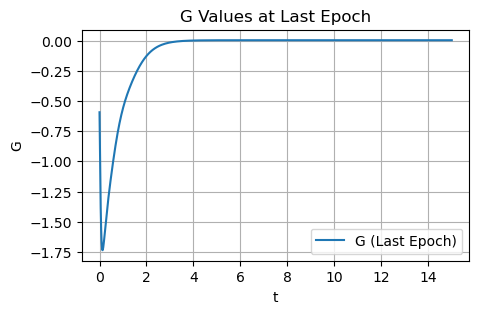

It 356500: loss = 8.54e-04,loss_G = 1.27e-01, alpha21 = 3.0208, alpha22 = 5.0386
Initial Condition: [20.00 0.00 0.00 0.00]


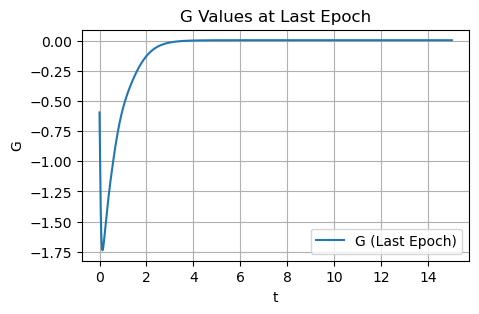

It 357000: loss = 8.51e-04,loss_G = 1.22e-01, alpha21 = 3.0188, alpha22 = 5.0348
Initial Condition: [20.00 0.00 0.00 0.00]


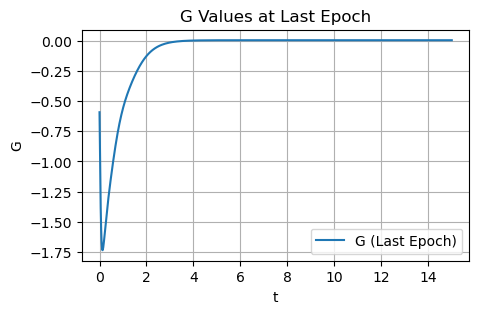

It 357500: loss = 8.51e-04,loss_G = 1.28e-01, alpha21 = 3.0203, alpha22 = 5.0374
Initial Condition: [20.00 0.00 0.00 -0.00]


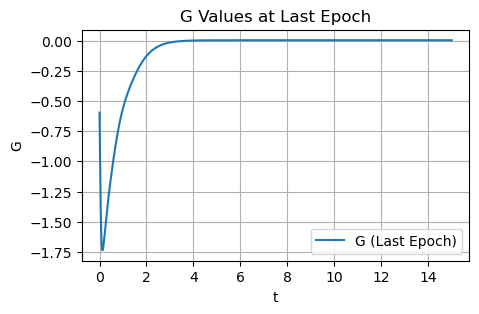

It 358000: loss = 8.51e-04,loss_G = 1.34e-01, alpha21 = 3.0199, alpha22 = 5.0363
Initial Condition: [20.00 0.00 0.00 0.00]


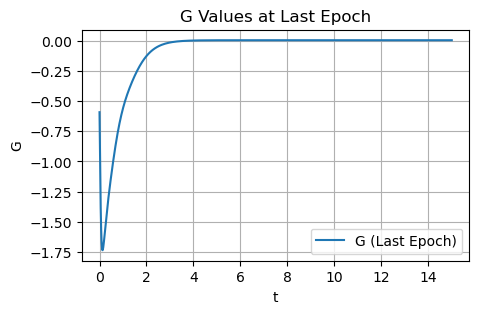

It 358500: loss = 1.20e-03,loss_G = 1.60e-01, alpha21 = 3.0190, alpha22 = 5.0336
Initial Condition: [20.00 -0.00 0.00 0.00]


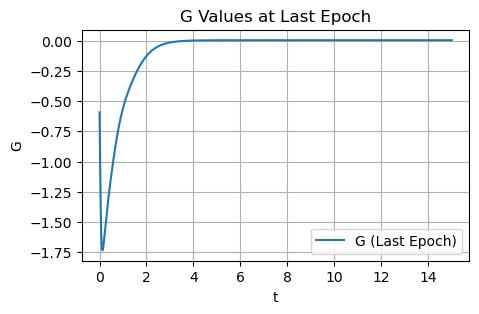

It 359000: loss = 1.60e-03,loss_G = 1.54e-01, alpha21 = 3.0181, alpha22 = 5.0392
Initial Condition: [20.00 0.00 0.00 0.00]


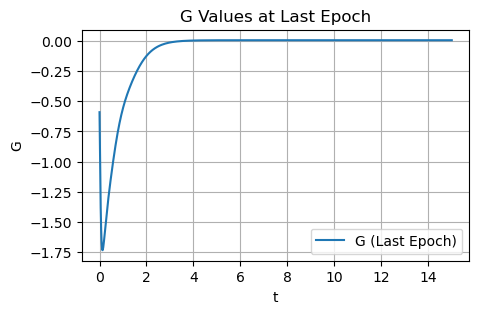

It 359500: loss = 8.60e-04,loss_G = 1.37e-01, alpha21 = 3.0185, alpha22 = 5.0334
Initial Condition: [20.00 -0.00 0.00 -0.00]


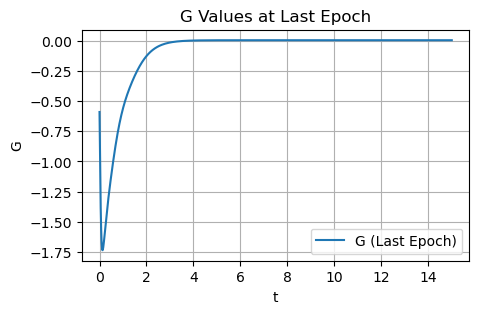

It 360000: loss = 8.73e-04,loss_G = 1.45e-01, alpha21 = 3.0182, alpha22 = 5.0330
Initial Condition: [20.00 0.00 0.00 0.00]


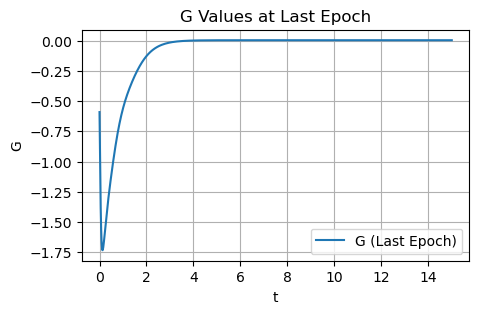

It 360500: loss = 2.76e-03,loss_G = 1.39e-01, alpha21 = 3.0178, alpha22 = 5.0358
Initial Condition: [20.00 0.00 -0.00 0.00]


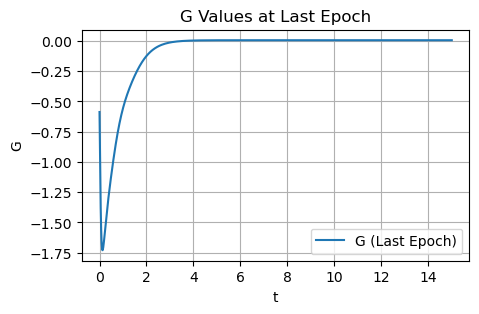

It 361000: loss = 8.99e-04,loss_G = 1.31e-01, alpha21 = 3.0188, alpha22 = 5.0352
Initial Condition: [20.00 0.00 0.00 0.00]


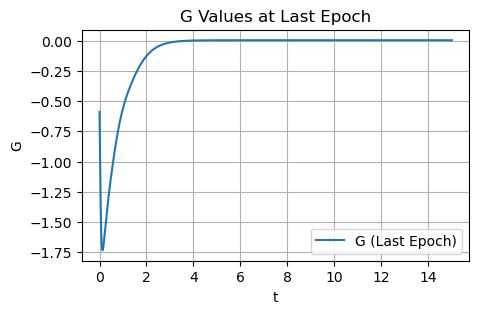

It 361500: loss = 1.34e-03,loss_G = 1.51e-01, alpha21 = 3.0186, alpha22 = 5.0341
Initial Condition: [20.00 0.00 0.00 0.00]


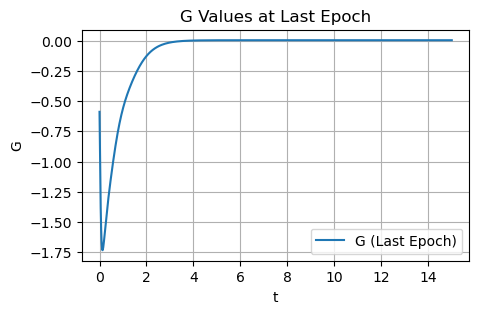

It 362000: loss = 8.51e-04,loss_G = 1.28e-01, alpha21 = 3.0194, alpha22 = 5.0357
Initial Condition: [20.00 0.00 0.00 0.00]


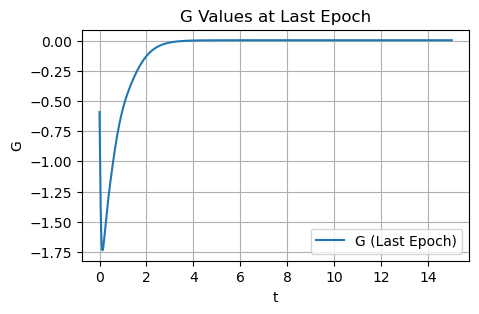

It 362500: loss = 8.51e-04,loss_G = 1.26e-01, alpha21 = 3.0195, alpha22 = 5.0359
Initial Condition: [20.00 0.00 0.00 -0.00]


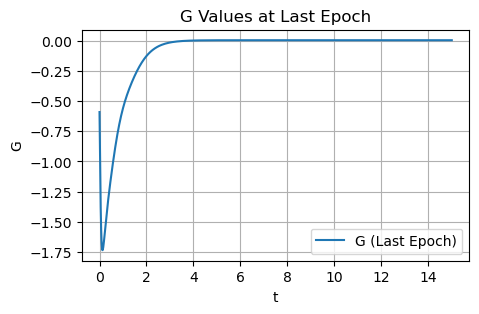

It 363000: loss = 8.51e-04,loss_G = 1.33e-01, alpha21 = 3.0195, alpha22 = 5.0358
Initial Condition: [20.00 0.00 0.00 -0.00]


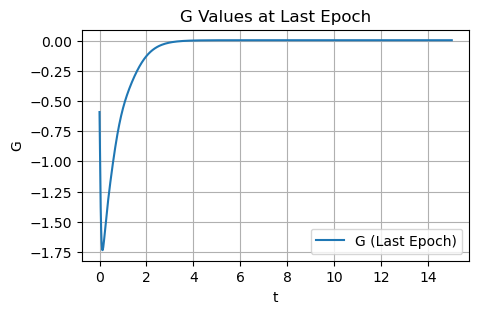

It 363500: loss = 1.82e-03,loss_G = 1.27e-01, alpha21 = 3.0186, alpha22 = 5.0345
Initial Condition: [20.00 0.00 -0.00 0.00]


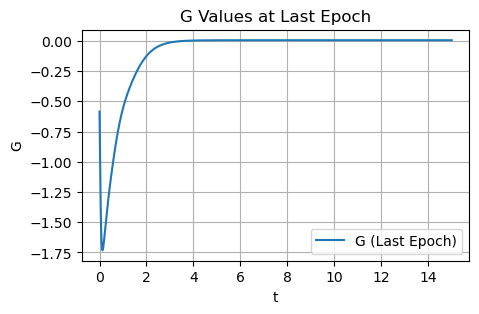

It 364000: loss = 8.56e-04,loss_G = 1.33e-01, alpha21 = 3.0179, alpha22 = 5.0326
Initial Condition: [20.00 0.00 0.00 0.00]


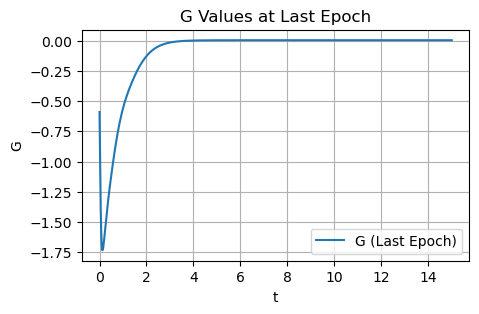

It 364500: loss = 8.51e-04,loss_G = 1.33e-01, alpha21 = 3.0191, alpha22 = 5.0349
Initial Condition: [20.00 0.00 0.00 -0.00]


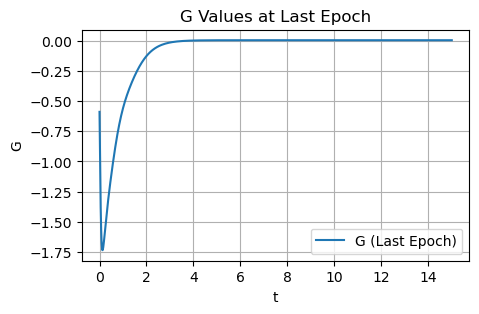

It 365000: loss = 7.74e-03,loss_G = 1.52e-01, alpha21 = 3.0172, alpha22 = 5.0347
Initial Condition: [20.00 0.00 -0.00 0.00]


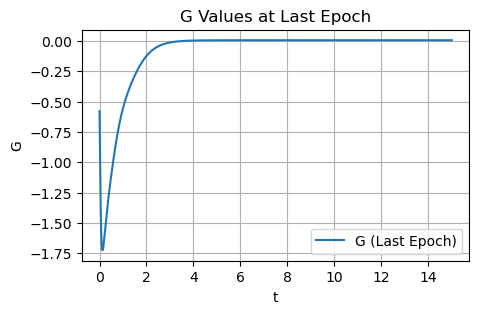

It 365500: loss = 8.51e-04,loss_G = 1.26e-01, alpha21 = 3.0187, alpha22 = 5.0345
Initial Condition: [20.00 0.00 0.00 -0.00]


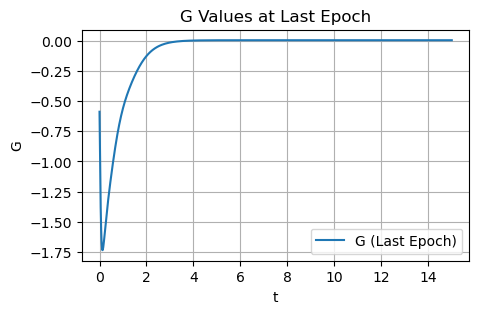

It 366000: loss = 8.59e-04,loss_G = 1.25e-01, alpha21 = 3.0183, alpha22 = 5.0339
Initial Condition: [20.00 0.00 0.00 0.00]


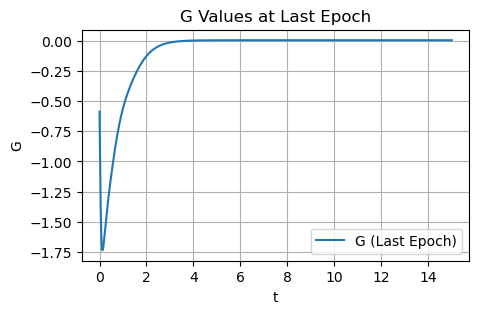

It 366500: loss = 8.55e-04,loss_G = 1.29e-01, alpha21 = 3.0183, alpha22 = 5.0334
Initial Condition: [20.00 -0.00 0.00 -0.00]


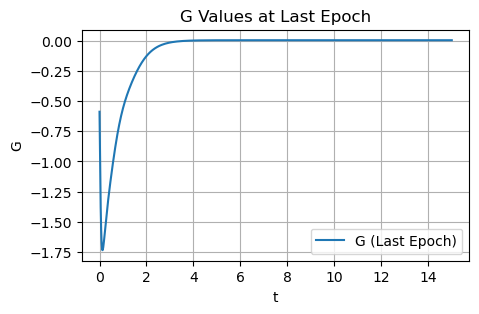

It 367000: loss = 8.67e-04,loss_G = 1.37e-01, alpha21 = 3.0177, alpha22 = 5.0320
Initial Condition: [20.00 0.00 -0.00 0.00]


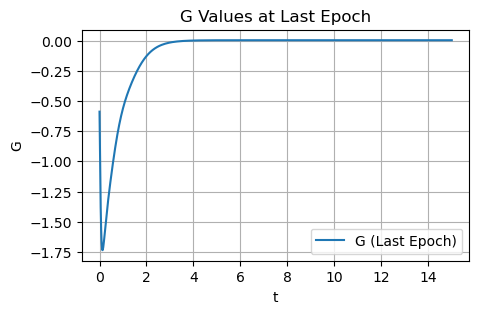

It 367500: loss = 1.55e-02,loss_G = 9.80e-02, alpha21 = 3.0203, alpha22 = 5.0320
Initial Condition: [20.00 -0.00 0.00 -0.01]


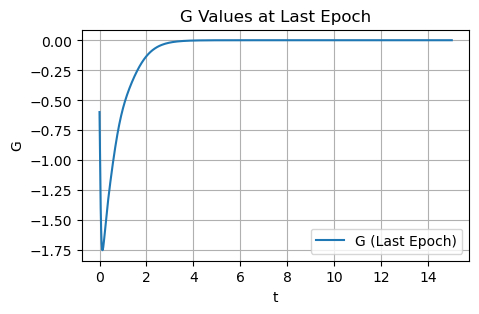

It 368000: loss = 8.10e-03,loss_G = 1.24e-01, alpha21 = 3.0202, alpha22 = 5.0322
Initial Condition: [20.01 -0.00 0.00 -0.00]


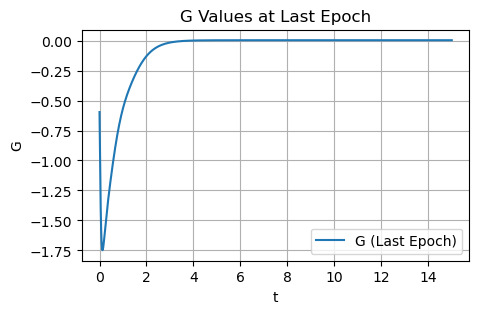

It 368500: loss = 3.90e-03,loss_G = 1.39e-01, alpha21 = 3.0167, alpha22 = 5.0350
Initial Condition: [20.00 0.00 -0.00 0.00]


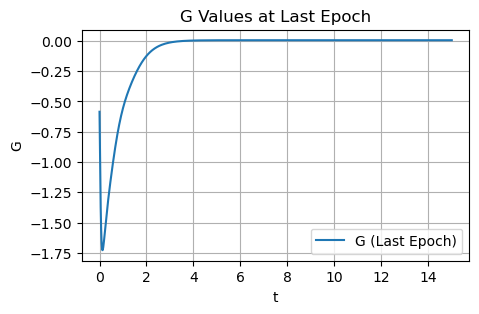

It 369000: loss = 8.51e-04,loss_G = 1.20e-01, alpha21 = 3.0166, alpha22 = 5.0306
Initial Condition: [20.00 0.00 0.00 -0.00]


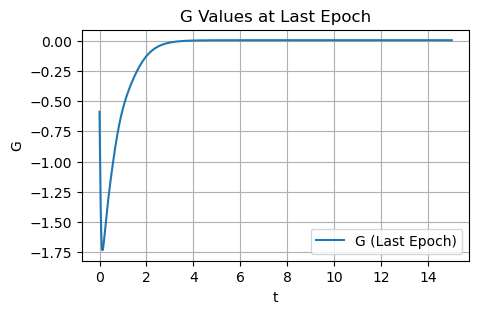

It 369500: loss = 8.51e-04,loss_G = 1.35e-01, alpha21 = 3.0172, alpha22 = 5.0313
Initial Condition: [20.00 0.00 0.00 0.00]


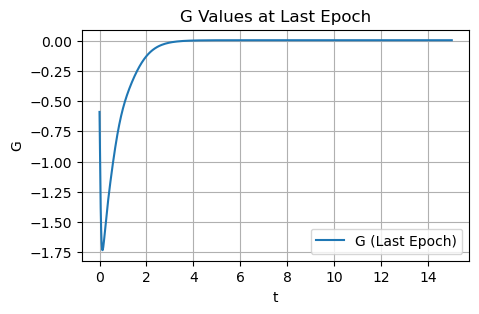

It 370000: loss = 8.53e-04,loss_G = 1.32e-01, alpha21 = 3.0167, alpha22 = 5.0302
Initial Condition: [20.00 -0.00 0.00 -0.00]


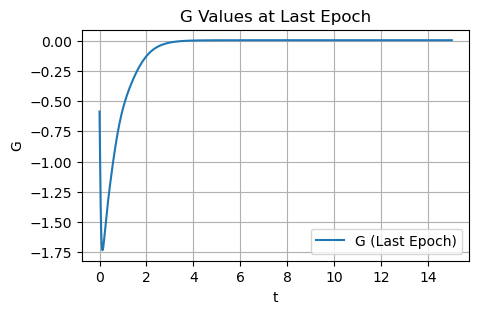

It 370500: loss = 8.54e-04,loss_G = 1.26e-01, alpha21 = 3.0169, alpha22 = 5.0312
Initial Condition: [20.00 0.00 0.00 0.00]


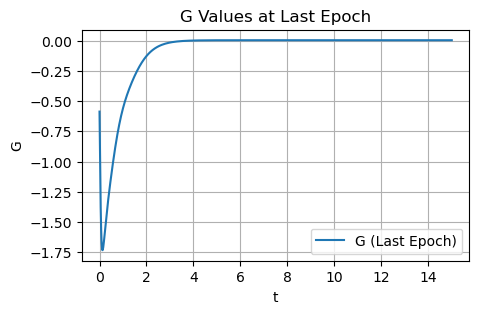

It 371000: loss = 1.25e-03,loss_G = 1.38e-01, alpha21 = 3.0163, alpha22 = 5.0304
Initial Condition: [20.00 0.00 -0.00 0.00]


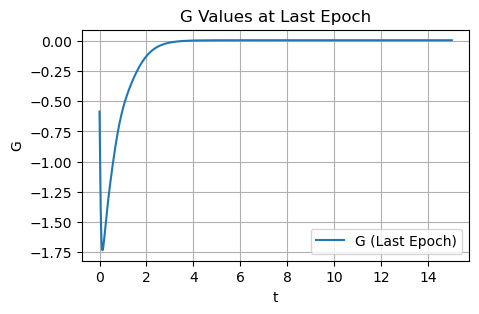

It 371500: loss = 8.68e-04,loss_G = 1.27e-01, alpha21 = 3.0167, alpha22 = 5.0309
Initial Condition: [20.00 0.00 0.00 0.00]


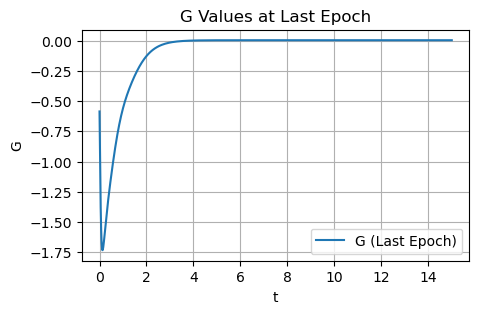

It 372000: loss = 8.51e-04,loss_G = 1.25e-01, alpha21 = 3.0169, alpha22 = 5.0312
Initial Condition: [20.00 0.00 0.00 -0.00]


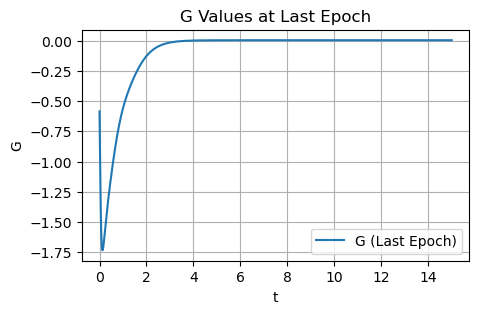

It 372500: loss = 1.63e-03,loss_G = 1.25e-01, alpha21 = 3.0158, alpha22 = 5.0307
Initial Condition: [20.00 0.00 -0.00 0.00]


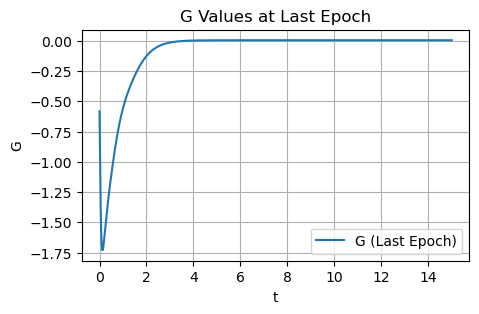

It 373000: loss = 8.51e-04,loss_G = 1.22e-01, alpha21 = 3.0176, alpha22 = 5.0323
Initial Condition: [20.00 -0.00 0.00 -0.00]


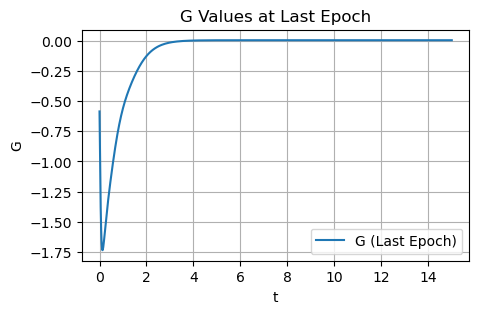

It 373500: loss = 1.46e-02,loss_G = 8.86e-02, alpha21 = 3.0184, alpha22 = 5.0297
Initial Condition: [20.00 -0.00 -0.00 -0.00]


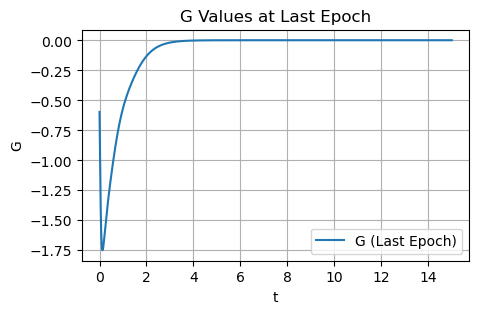

It 374000: loss = 8.57e-04,loss_G = 1.33e-01, alpha21 = 3.0167, alpha22 = 5.0305
Initial Condition: [20.00 0.00 0.00 0.00]


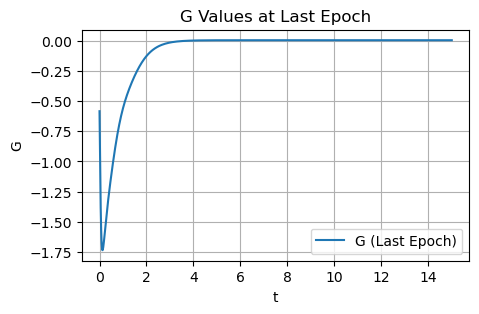

It 374500: loss = 9.82e-04,loss_G = 1.38e-01, alpha21 = 3.0157, alpha22 = 5.0296
Initial Condition: [20.00 0.00 -0.00 0.00]


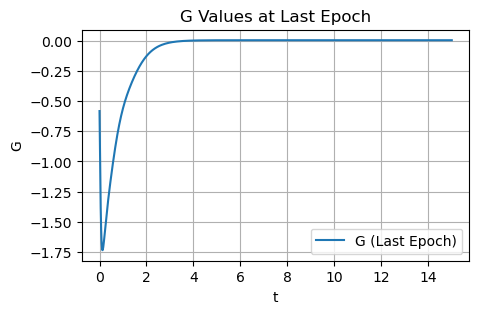

It 375000: loss = 8.70e-04,loss_G = 1.21e-01, alpha21 = 3.0175, alpha22 = 5.0310
Initial Condition: [20.00 -0.00 -0.00 -0.00]


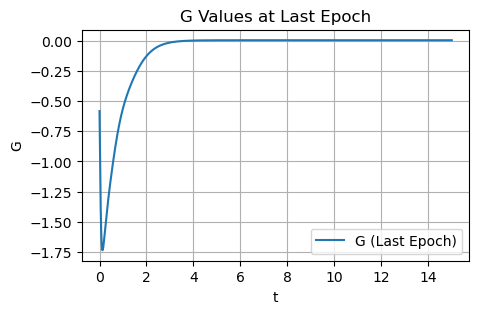

It 375500: loss = 8.51e-04,loss_G = 1.24e-01, alpha21 = 3.0164, alpha22 = 5.0301
Initial Condition: [20.00 -0.00 0.00 -0.00]


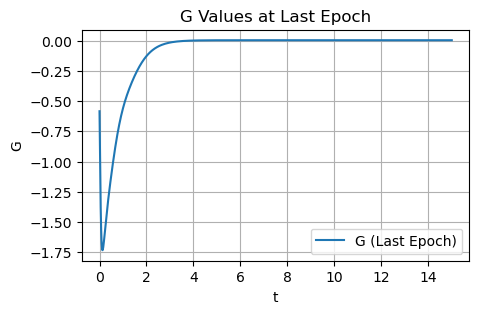

It 376000: loss = 8.51e-04,loss_G = 1.24e-01, alpha21 = 3.0166, alpha22 = 5.0306
Initial Condition: [20.00 -0.00 0.00 -0.00]


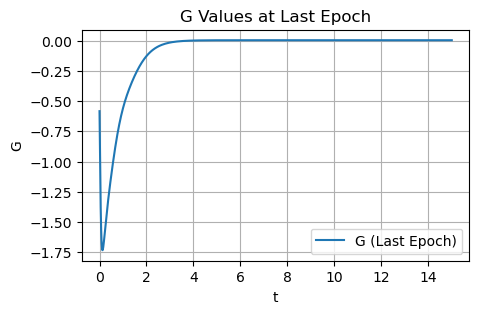

It 376500: loss = 1.37e-03,loss_G = 1.57e-01, alpha21 = 3.0146, alpha22 = 5.0306
Initial Condition: [19.99 0.00 0.00 0.00]


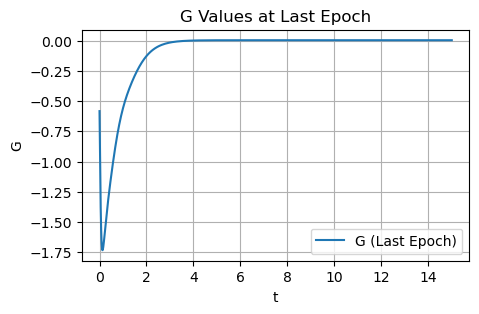

It 377000: loss = 8.51e-04,loss_G = 1.20e-01, alpha21 = 3.0139, alpha22 = 5.0256
Initial Condition: [20.00 0.00 0.00 -0.00]


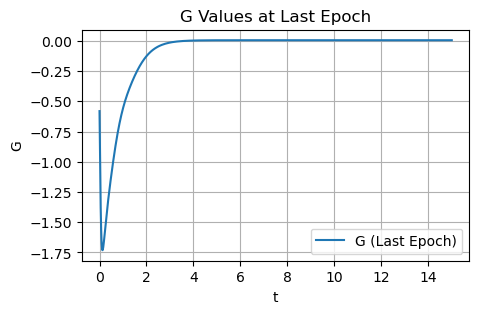

It 377500: loss = 1.63e-03,loss_G = 1.21e-01, alpha21 = 3.0159, alpha22 = 5.0269
Initial Condition: [20.00 -0.00 0.00 -0.00]


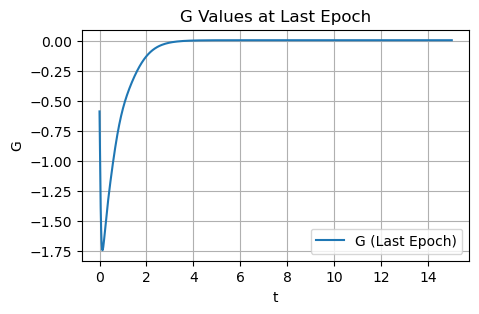

It 378000: loss = 8.77e-04,loss_G = 1.21e-01, alpha21 = 3.0162, alpha22 = 5.0306
Initial Condition: [20.00 0.00 0.00 0.00]


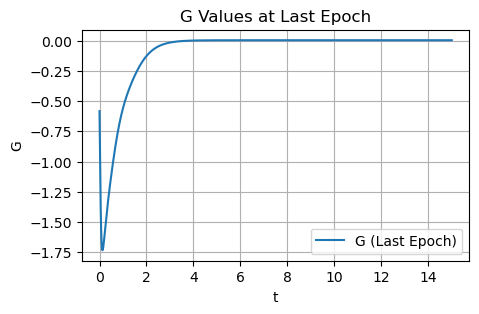

It 378500: loss = 8.64e-04,loss_G = 1.32e-01, alpha21 = 3.0155, alpha22 = 5.0286
Initial Condition: [20.00 0.00 0.00 0.00]


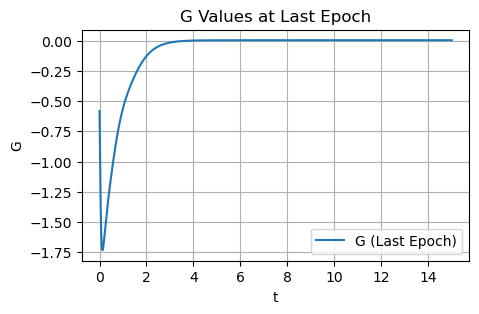

It 379000: loss = 8.51e-04,loss_G = 1.21e-01, alpha21 = 3.0148, alpha22 = 5.0273
Initial Condition: [20.00 0.00 0.00 -0.00]


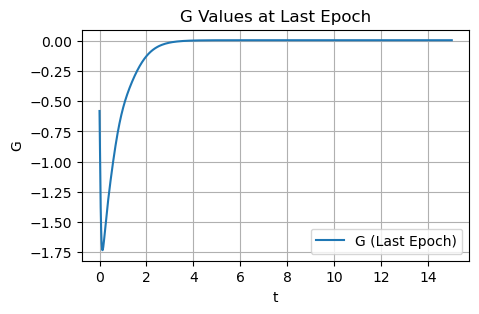

It 379500: loss = 8.51e-04,loss_G = 1.26e-01, alpha21 = 3.0162, alpha22 = 5.0298
Initial Condition: [20.00 0.00 0.00 -0.00]


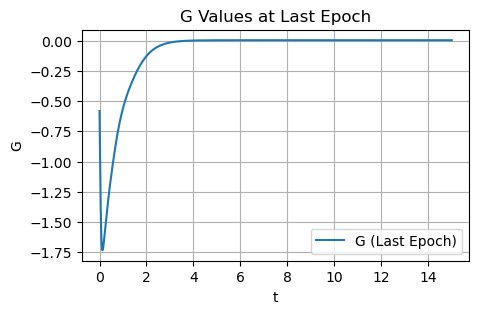

It 380000: loss = 1.34e-03,loss_G = 1.20e-01, alpha21 = 3.0162, alpha22 = 5.0275
Initial Condition: [20.00 -0.00 -0.00 -0.00]


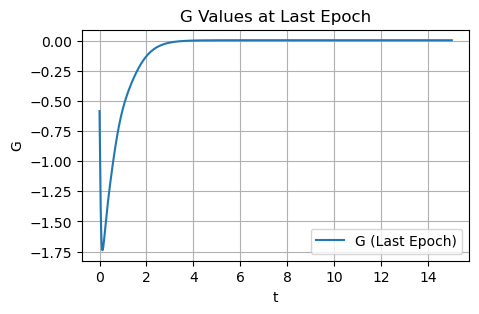

It 380500: loss = 8.51e-04,loss_G = 1.23e-01, alpha21 = 3.0154, alpha22 = 5.0284
Initial Condition: [20.00 0.00 0.00 -0.00]


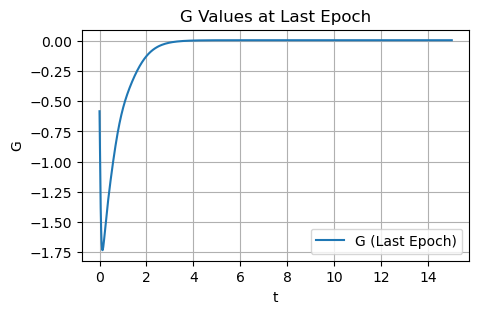

It 381000: loss = 8.51e-04,loss_G = 1.29e-01, alpha21 = 3.0162, alpha22 = 5.0297
Initial Condition: [20.00 0.00 0.00 -0.00]


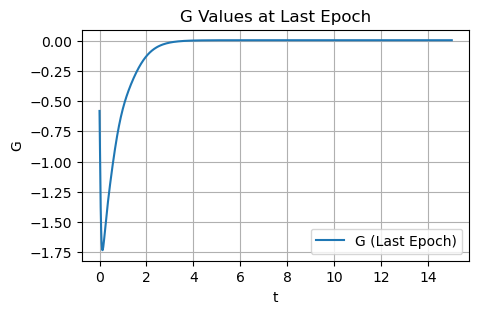

It 381500: loss = 8.51e-04,loss_G = 1.31e-01, alpha21 = 3.0160, alpha22 = 5.0292
Initial Condition: [20.00 0.00 0.00 -0.00]


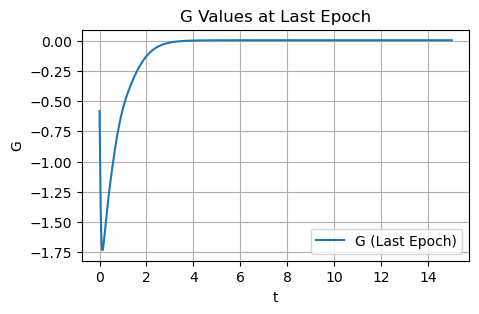

It 382000: loss = 8.37e-03,loss_G = 1.71e-01, alpha21 = 3.0156, alpha22 = 5.0289
Initial Condition: [20.00 0.00 0.00 0.00]


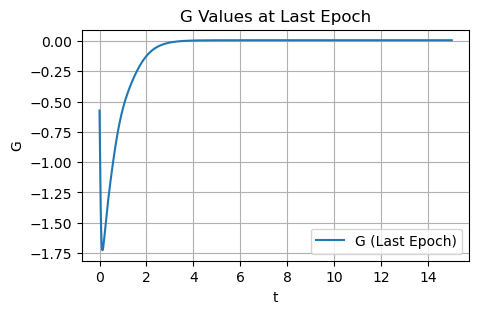

It 382500: loss = 8.51e-04,loss_G = 1.21e-01, alpha21 = 3.0161, alpha22 = 5.0298
Initial Condition: [20.00 0.00 0.00 -0.00]


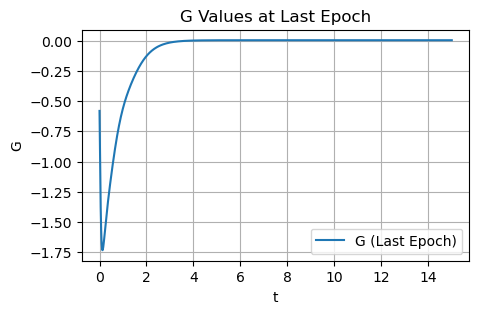

It 383000: loss = 8.52e-04,loss_G = 1.28e-01, alpha21 = 3.0159, alpha22 = 5.0289
Initial Condition: [20.00 0.00 0.00 -0.00]


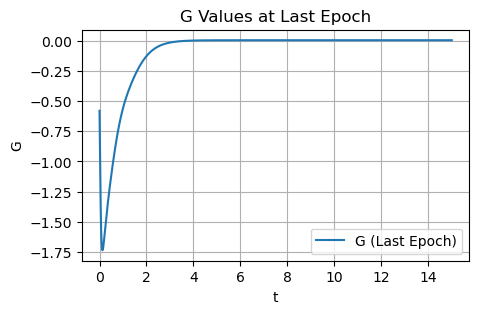

It 383500: loss = 8.51e-04,loss_G = 1.21e-01, alpha21 = 3.0157, alpha22 = 5.0292
Initial Condition: [20.00 0.00 0.00 -0.00]


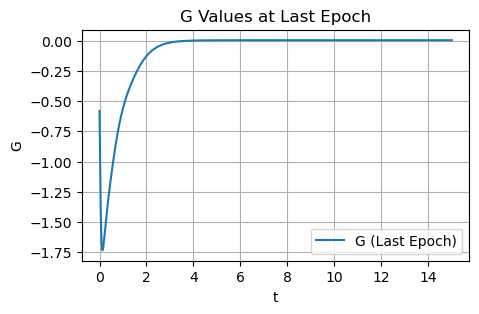

It 384000: loss = 1.44e-02,loss_G = 1.68e-01, alpha21 = 3.0136, alpha22 = 5.0312
Initial Condition: [19.99 0.00 -0.00 0.01]


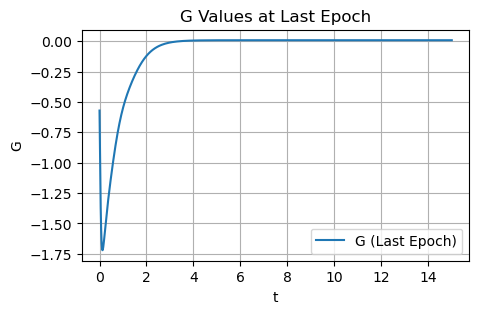

It 384500: loss = 9.03e-04,loss_G = 1.33e-01, alpha21 = 3.0151, alpha22 = 5.0278
Initial Condition: [20.00 0.00 0.00 0.00]


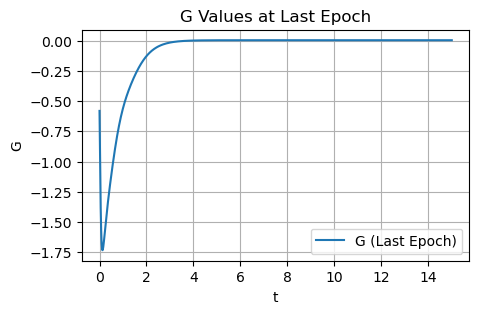

It 385000: loss = 8.51e-04,loss_G = 1.22e-01, alpha21 = 3.0157, alpha22 = 5.0289
Initial Condition: [20.00 0.00 0.00 -0.00]


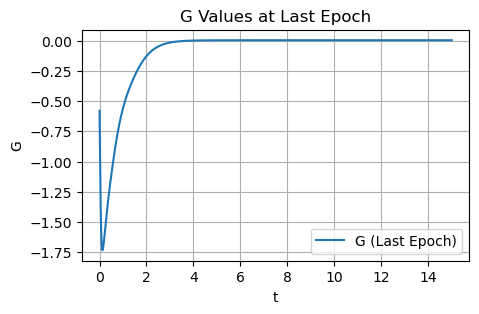

It 385500: loss = 1.31e-02,loss_G = 1.50e-01, alpha21 = 3.0132, alpha22 = 5.0305
Initial Condition: [19.99 0.01 -0.00 0.01]


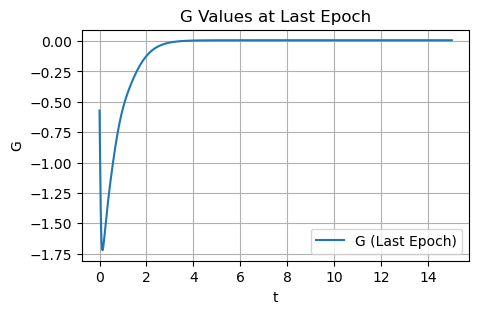

It 386000: loss = 8.52e-04,loss_G = 1.22e-01, alpha21 = 3.0166, alpha22 = 5.0303
Initial Condition: [20.00 -0.00 -0.00 -0.00]


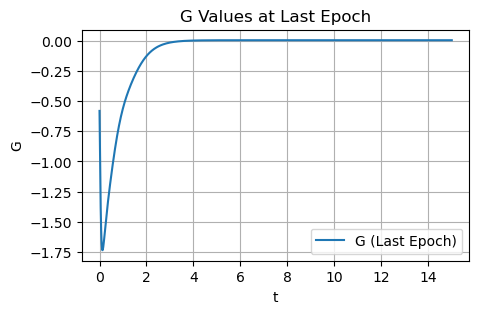

It 386500: loss = 8.65e-04,loss_G = 1.20e-01, alpha21 = 3.0156, alpha22 = 5.0291
Initial Condition: [20.00 0.00 0.00 0.00]


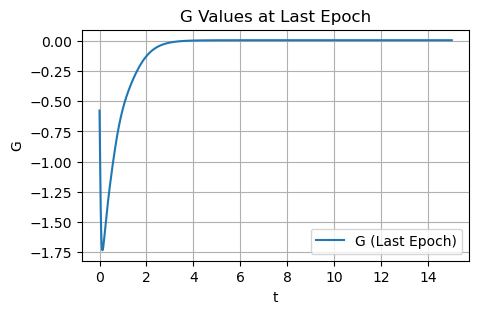

It 387000: loss = 1.13e-03,loss_G = 1.52e-01, alpha21 = 3.0140, alpha22 = 5.0271
Initial Condition: [20.00 0.00 0.00 0.00]


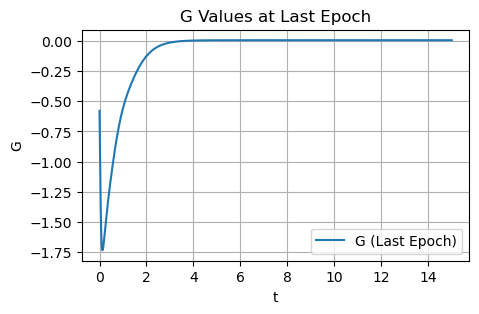

It 387500: loss = 2.96e-03,loss_G = 1.26e-01, alpha21 = 3.0154, alpha22 = 5.0305
Initial Condition: [20.00 0.00 -0.00 0.00]


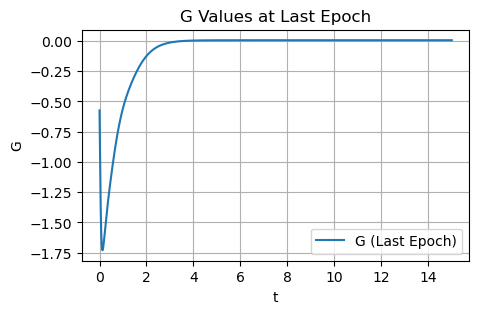

It 388000: loss = 8.51e-04,loss_G = 1.14e-01, alpha21 = 3.0133, alpha22 = 5.0247
Initial Condition: [20.00 0.00 0.00 -0.00]


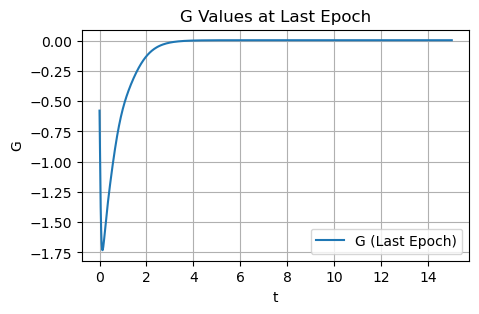

It 388500: loss = 8.51e-04,loss_G = 1.24e-01, alpha21 = 3.0149, alpha22 = 5.0275
Initial Condition: [20.00 0.00 0.00 -0.00]


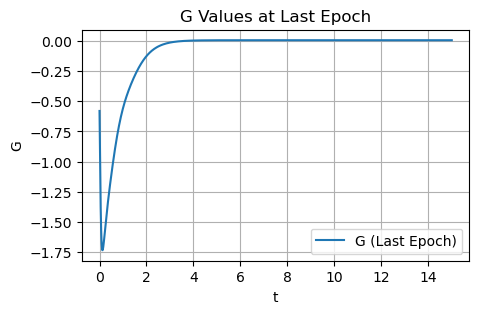

It 389000: loss = 8.51e-04,loss_G = 1.21e-01, alpha21 = 3.0129, alpha22 = 5.0237
Initial Condition: [20.00 0.00 0.00 0.00]


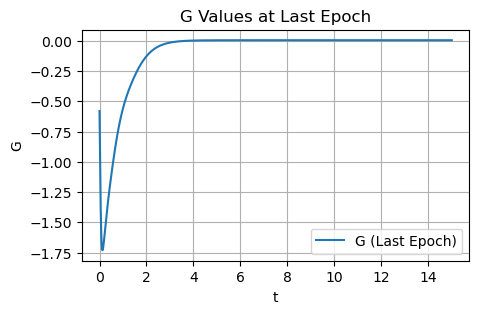

It 389500: loss = 8.63e-04,loss_G = 1.30e-01, alpha21 = 3.0142, alpha22 = 5.0256
Initial Condition: [20.00 -0.00 0.00 -0.00]


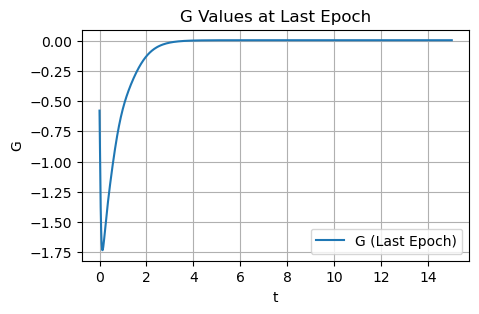

It 390000: loss = 8.51e-04,loss_G = 1.17e-01, alpha21 = 3.0153, alpha22 = 5.0285
Initial Condition: [20.00 0.00 0.00 -0.00]


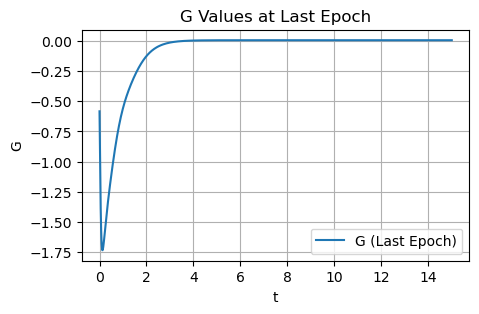

It 390500: loss = 8.51e-04,loss_G = 1.19e-01, alpha21 = 3.0151, alpha22 = 5.0281
Initial Condition: [20.00 0.00 0.00 -0.00]


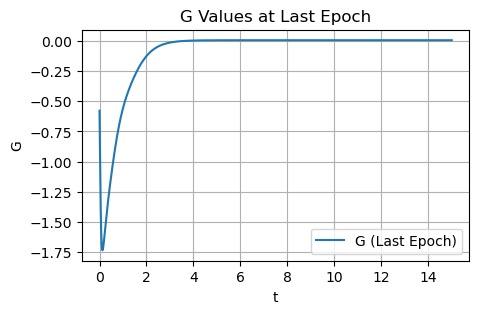

It 391000: loss = 8.51e-04,loss_G = 1.22e-01, alpha21 = 3.0150, alpha22 = 5.0277
Initial Condition: [20.00 0.00 0.00 -0.00]


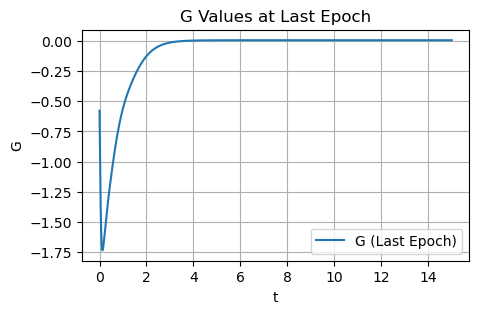

It 391500: loss = 8.52e-04,loss_G = 1.22e-01, alpha21 = 3.0131, alpha22 = 5.0242
Initial Condition: [20.00 0.00 0.00 0.00]


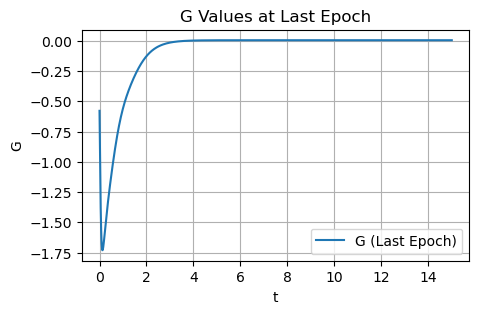

It 392000: loss = 8.52e-04,loss_G = 1.34e-01, alpha21 = 3.0141, alpha22 = 5.0258
Initial Condition: [20.00 -0.00 0.00 0.00]


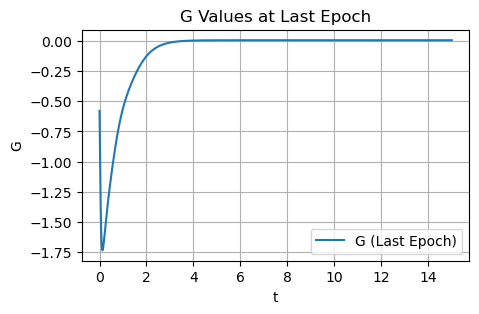

It 392500: loss = 1.78e-03,loss_G = 1.21e-01, alpha21 = 3.0140, alpha22 = 5.0232
Initial Condition: [20.00 -0.00 0.00 -0.00]


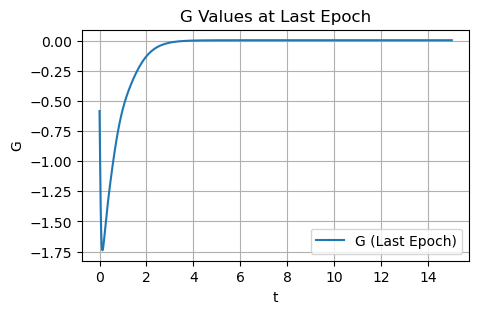

It 393000: loss = 8.51e-04,loss_G = 1.19e-01, alpha21 = 3.0151, alpha22 = 5.0280
Initial Condition: [20.00 0.00 0.00 -0.00]


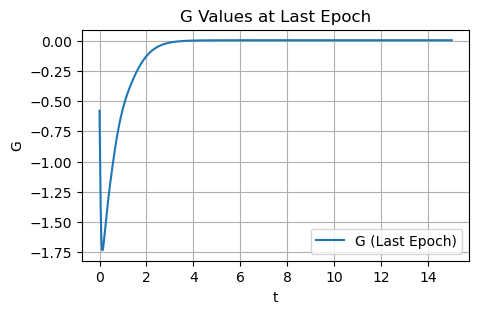

It 393500: loss = 8.51e-04,loss_G = 1.25e-01, alpha21 = 3.0146, alpha22 = 5.0267
Initial Condition: [20.00 0.00 0.00 -0.00]


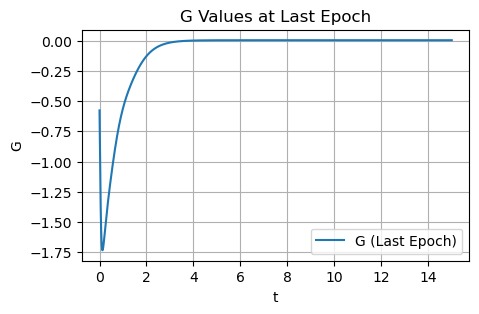

It 394000: loss = 2.54e-03,loss_G = 1.50e-01, alpha21 = 3.0122, alpha22 = 5.0277
Initial Condition: [20.00 0.00 0.00 0.00]


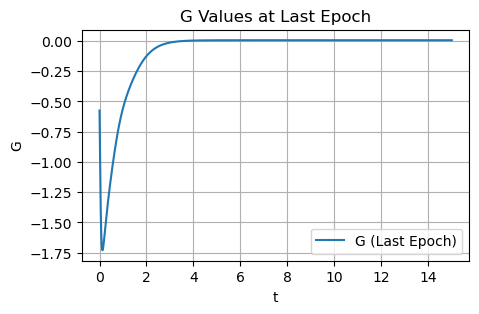

It 394500: loss = 5.87e-03,loss_G = 1.41e-01, alpha21 = 3.0129, alpha22 = 5.0293
Initial Condition: [19.99 0.00 -0.00 0.00]


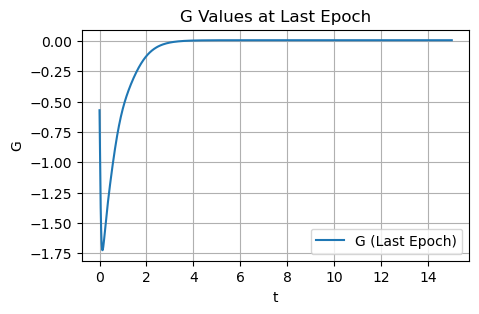

It 395000: loss = 1.59e-03,loss_G = 1.43e-01, alpha21 = 3.0135, alpha22 = 5.0252
Initial Condition: [20.00 0.00 0.00 0.00]


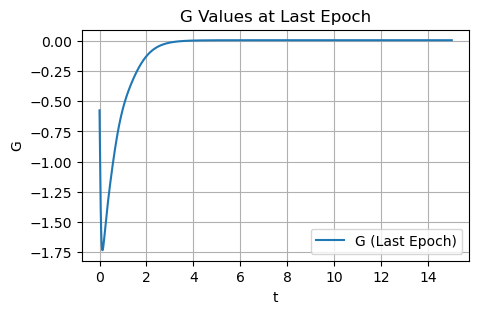

It 395500: loss = 9.33e-04,loss_G = 1.33e-01, alpha21 = 3.0139, alpha22 = 5.0249
Initial Condition: [20.00 -0.00 -0.00 -0.00]


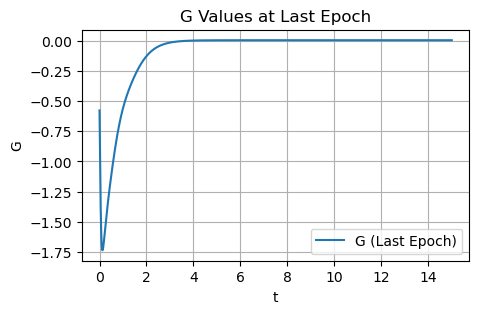

It 396000: loss = 8.79e-04,loss_G = 1.33e-01, alpha21 = 3.0132, alpha22 = 5.0240
Initial Condition: [20.00 -0.00 0.00 0.00]


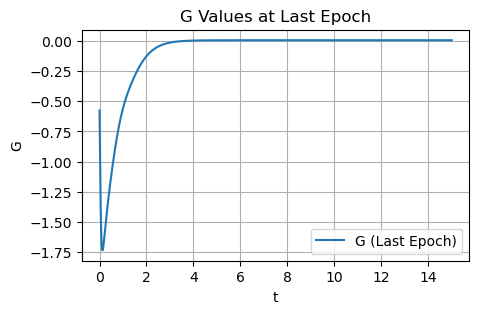

It 396500: loss = 6.15e-03,loss_G = 1.00e-01, alpha21 = 3.0145, alpha22 = 5.0250
Initial Condition: [20.00 -0.00 0.00 -0.00]


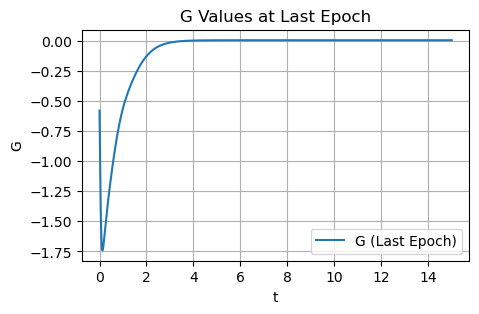

It 397000: loss = 1.30e-03,loss_G = 1.38e-01, alpha21 = 3.0136, alpha22 = 5.0258
Initial Condition: [20.00 0.00 0.00 0.00]


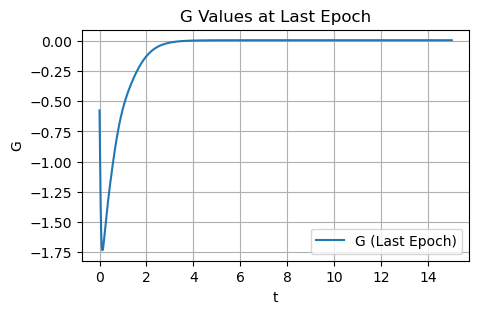

It 397500: loss = 8.51e-04,loss_G = 1.20e-01, alpha21 = 3.0143, alpha22 = 5.0265
Initial Condition: [20.00 0.00 0.00 -0.00]


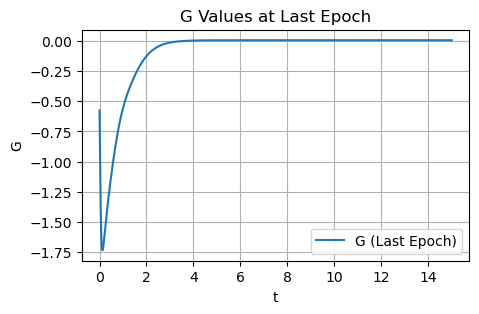

It 398000: loss = 9.72e-04,loss_G = 1.37e-01, alpha21 = 3.0134, alpha22 = 5.0254
Initial Condition: [20.00 0.00 0.00 0.00]


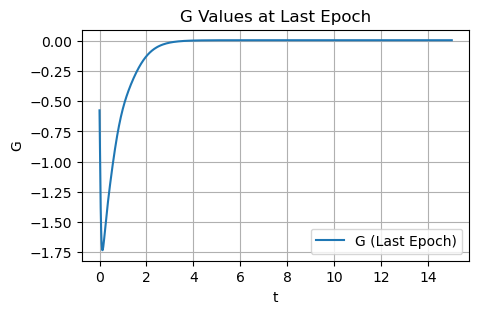

It 398500: loss = 1.14e-03,loss_G = 1.32e-01, alpha21 = 3.0133, alpha22 = 5.0254
Initial Condition: [20.00 0.00 -0.00 0.00]


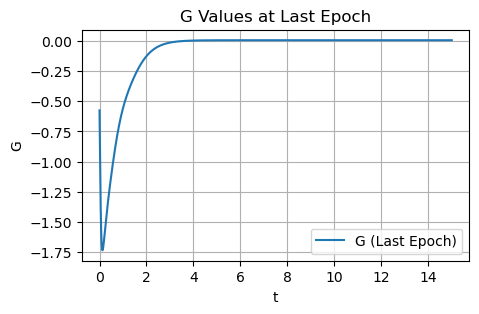

It 399000: loss = 8.52e-04,loss_G = 1.25e-01, alpha21 = 3.0136, alpha22 = 5.0245
Initial Condition: [20.00 -0.00 0.00 -0.00]


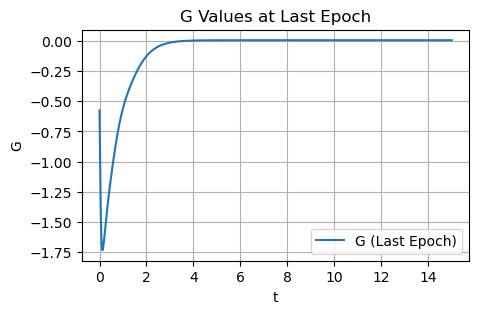

It 399500: loss = 8.51e-04,loss_G = 1.29e-01, alpha21 = 3.0145, alpha22 = 5.0265
Initial Condition: [20.00 0.00 0.00 -0.00]


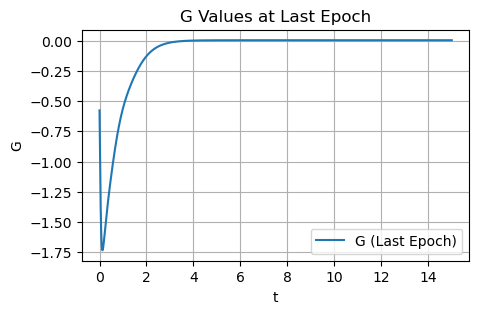

Final Loss: 0.00085063925
Final Parameters: [3.0147614, 5.0273533]

Computation time: 512.26 minutes


In [11]:
# Set random seeds for reproducibility
seed = 42
np.random.seed(seed)
tf.random.set_seed(seed)
random.seed(seed)

# Initialize models
knowndynamics_model = PINNIdentificationNet()
unknowndynamics_model = GNet()

# Initialize PINN Solver
solver = PINNSolver_ID(
    knowndynamics_model=knowndynamics_model, 
    unknowndynamics_model=unknowndynamics_model, 
    T_r=T_data_train
)

# Start timer
t0 = time()

# Define optimizer
optimizer = tf.keras.optimizers.Adam(learning_rate=0.02)

# Train the models
final_loss_value, final_variables, final_IC, loss_history, lossp_history, lossd_history, \
lossic_history, lossg_history, alpha21_history, alpha22_history = solver.solve_with_TFoptimizer(
    optimizer, 
    T_data_train, 
    tf.stack([X_data_noisy_train[:, 2], X_data_noisy_train[:, 1] + X_data_noisy_train[:, 3]], axis=1), 
    N=400000
)

# Print results
print("Final Loss:", final_loss_value)
print("Final Parameters:", final_variables)
print("\nComputation time: {:.2f} minutes".format((time() - t0) / 60))


## Save output 

In [ ]:
t_PINNs,X_PINNs, G_PINNs =  solver.get_solution(T_data)
R_PINNs = X_PINNs[:,0:1]
M_PINNs = X_PINNs[:,1:2]
F_PINNs = X_PINNs[:,2:3]
MI_PINNs = X_PINNs[:,3:4]


# Save all variables
filename = 'PINNs_unknownparams_wp1.0_lr0.02_400k_F_M+MI_2layers-v1.npz'
np.savez(
    filename,
    t_PINNs=t_PINNs,
    X_PINNs=X_PINNs,
    R_PINNs=R_PINNs,
    M_PINNs=M_PINNs,
    F_PINNs=F_PINNs,
    MI_PINNs=MI_PINNs,
    G_PINNs = G_PINNs,
    final_loss_value=final_loss_value,
    final_variables=final_variables,
    final_IC=final_IC,
    loss_history=loss_history,
    lossp_history=lossp_history,
    lossd_history=lossd_history,
    lossic_history=lossic_history,
    alpha21_history=alpha21_history,
    alpha22_history=alpha22_history 
)

## Import saved output

In [13]:
filename = 'PINNs_unknownparams_wp1.0_lr0.02_400k_F_M+MI_2layers-v1.npz'

# Load variables
loaded_data = np.load(filename)

# Access variables
t_PINNs = loaded_data['t_PINNs']
X_PINNs = loaded_data['X_PINNs']
R_PINNs = loaded_data['R_PINNs']
M_PINNs = loaded_data['M_PINNs']
F_PINNs = loaded_data['F_PINNs']
MI_PINNs = loaded_data['MI_PINNs']
G_PINNs = loaded_data['G_PINNs'],
final_loss_value = loaded_data['final_loss_value']
final_variables = loaded_data['final_variables']
final_IC = loaded_data['final_IC']
loss_history = loaded_data['loss_history']
lossp_history = loaded_data['lossp_history']
lossd_history = loaded_data['lossd_history']
lossic_history = loaded_data['lossic_history']
alpha21_history = loaded_data['alpha21_history']
alpha22_history = loaded_data['alpha22_history']

## Plot states

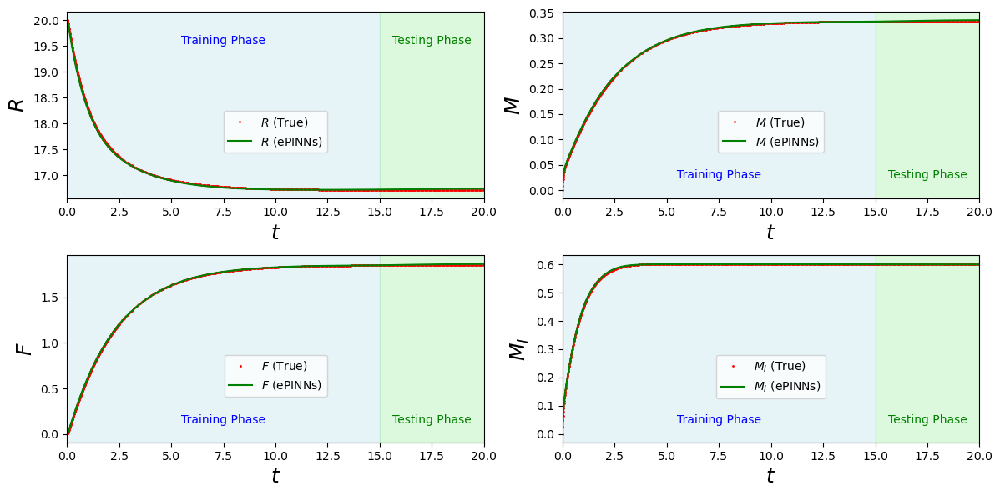

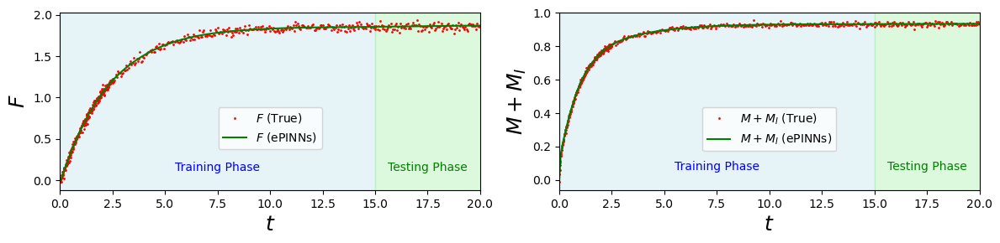

In [15]:
fig, axs = plt.subplots(2, 2, figsize=(12, 6))
axs = axs.flatten()

# Define the regions for shading
training_start, training_end = 0, 15  # Training phase: 0 to 15
testing_start, testing_end = 15, max(t_true)  # Testing phase: 15 to end

# PINNs_knownparams_wp0.5_lr0.01_180k_F_M+MI
text_positions = [
    [(7.5, 19.6), (17.5, 19.6)],  # Subplot 1: Training and Testing Phase positions
    [(7.5, 0.03), (17.5, 0.03)],  # Subplot 2
    [(7.5, 0.15), (17.5, 0.15)],  # Subplot 3
    [(7.5, 0.05), (17.5, 0.05)]  # Subplot 4
]

# PINNs_knownparams_wp0.0_lr0.01_180k_F_M+MI
# text_positions = [
#     [(7.5, 19), (17.5, 19)],  # Subplot 1: Training and Testing Phase positions
#     [(7.5, 0.05), (17.5, 0.05)],  # Subplot 2
#     [(7.5, 0.15), (17.5, 0.15)],  # Subplot 3
#     [(7.5, 0.0), (17.5, 0.0)]  # Subplot 4
# ]
# Define font properties for the legend
legend_font = {'family': 'serif',
               'weight': 'bold',
               'size': 12}
# Plot each curve in a separate subplot
for i, (ax, y_noisy, y_PINNs, ylabel) in enumerate(zip(
    axs,
    [R_true, M_true, F_true, MI_true],
    [R_PINNs, M_PINNs, F_PINNs, MI_PINNs],
    ['$R$', '$M$', '$F$', '$M_I$']
)):
    # Shade the training phase
    ax.axvspan(training_start, training_end, color='lightblue', alpha=0.3)
    training_x, training_y = text_positions[i][0]  # Manual training text coordinates
    ax.text(
        training_x, training_y,  # X and Y coordinates for "Training Phase"
        'Training Phase',
        color='blue', fontsize=10, ha='center', va='center'
    )
    
    # Shade the testing phase
    ax.axvspan(testing_start, testing_end, color='lightgreen', alpha=0.3)
    testing_x, testing_y = text_positions[i][1]  # Manual testing text coordinates
    ax.text(
        testing_x, testing_y,  # X and Y coordinates for "Testing Phase"
        'Testing Phase',
        color='green', fontsize=10, ha='center', va='center'
    )

    # Plot the noisy data and PINNs data
    ax.plot(t_true, y_noisy, label=f'{ylabel} (True)', color='r', linestyle='', marker='o', markersize=1)
    ax.plot(t_PINNs, y_PINNs, label=f'{ylabel} (ePINNs)', color='g')
    ax.set_ylabel(ylabel,fontsize=18)
    ax.set_xlabel('$t$ ',fontsize=18)
    ax.legend( bbox_to_anchor=(0.5, 0.5), loc='upper center')
    ax.set_xlim(0, 20)

# Adjust layout to remove white space
fig.tight_layout(rect=[0, 0, 1, 1])

# Show the plot
plt.show()

# # Save the plot as JPEG and PNG
fig.savefig('PINNs_unknownparams_wp1.0_lr0.02_400k_F_M+MI_2layers.jpeg', format='jpeg', dpi=300)
fig.savefig('PINNs_unknownparams_wp1.0_lr0.02_400k_F_M+MI_2layers.png', format='png', dpi=300)
# # Show the plot


fig, axs = plt.subplots(1, 2, figsize=(12, 3))
axs = axs.flatten()

# Define the regions for shading
training_start, training_end = 0, 15  # Training phase: 0 to 15
testing_start, testing_end = 15, max(t_true)  # Testing phase: 15 to end

# PINNs_knownparams_wp0.5_lr0.01_180k_F_M+MI
text_positions = [
    [(7.5, 0.15), (17.5, 0.15)],  # Subplot 1
    [(7.5, 0.08), (17.5, 0.08)],  # Subplot 2

]

# Define font properties for the legend
legend_font = {'family': 'serif',
               'weight': 'bold',
               'size': 12}
# Plot each curve in a separate subplot
for i, (ax, y_noisy, y_PINNs, ylabel) in enumerate(zip(
    axs,
    [F_noisy, M_noisy+MI_noisy],
    [F_PINNs, M_PINNs+MI_PINNs],
    ['$F$',  '$M+M_I$']
)):
    # Shade the training phase
    ax.axvspan(training_start, training_end, color='lightblue', alpha=0.3)
    training_x, training_y = text_positions[i][0]  # Manual training text coordinates
    ax.text(
        training_x, training_y,  # X and Y coordinates for "Training Phase"
        'Training Phase',
        color='blue', fontsize=10, ha='center', va='center'
    )
    
    # Shade the testing phase
    ax.axvspan(testing_start, testing_end, color='lightgreen', alpha=0.3)
    testing_x, testing_y = text_positions[i][1]  # Manual testing text coordinates
    ax.text(
        testing_x, testing_y,  # X and Y coordinates for "Testing Phase"
        'Testing Phase',
        color='green', fontsize=10, ha='center', va='center'
    )

    # Plot the noisy data and PINNs data
    ax.plot(t_true, y_noisy, label=f'{ylabel} (True)', color='r', linestyle='', marker='o', markersize=1)
    ax.plot(t_PINNs, y_PINNs, label=f'{ylabel} (ePINNs)', color='g')
    ax.set_ylabel(ylabel,fontsize=18)
    ax.set_xlabel('$t$ ',fontsize=18)
    ax.legend( bbox_to_anchor=(0.5, 0.5), loc='upper center')
    ax.set_xlim(0, 20)

# Adjust layout to remove white space
fig.tight_layout(rect=[0, 0, 1, 1])

# Show the plot
plt.show()

# # Save the plot as JPEG and PNG
fig.savefig('PINNs_unknownparams_wp1.0_lr0.02_400k_F_M+MI2_2layers.jpeg', format='jpeg', dpi=300)
fig.savefig('PINNs_unknownparams_wp1.0_lr0.02_400k_F_M+MI2_2layers.png', format='png', dpi=300)
# # Show the plot



## Plot paramters

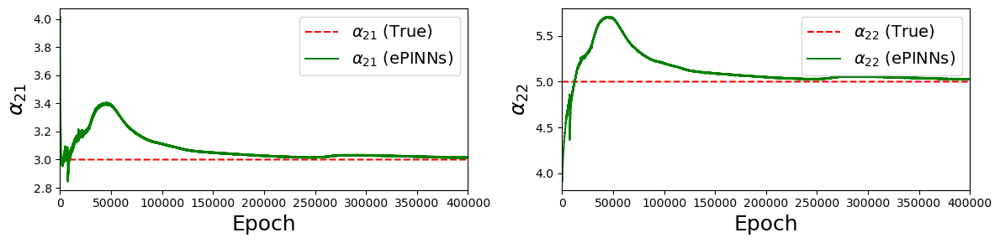

In [16]:
# Define training and testing regions
training_start, training_end = 0, 15  # Training phase: 0 to 15
testing_start, testing_end = 15, max(t_true)  # Testing phase: 15 to end

# Create subplots
fig, axs = plt.subplots(1, 2, figsize=(12, 3))
axs = axs.flatten()

# Plot alpha21 evolution
axs[0].plot(range(len(alpha21_history)), np.full(len(alpha21_history), 3), 
            label=r'$\alpha_{21}$ (True)', color='r', linestyle='dashed')
axs[0].plot(alpha21_history, label=r'$\alpha_{21}$ (ePINNs)', color='g')

# Formatting alpha21 subplot
axs[0].set_ylabel(r'$\alpha_{21}$', fontsize=18)
axs[0].set_xlabel('Epoch', fontsize=18)
axs[0].legend(loc='best', fontsize=14)
axs[0].set_xlim(0, 400000)

# Plot alpha22 evolution
axs[1].plot(range(len(alpha22_history)), np.full(len(alpha22_history), 5), 
            label=r'$\alpha_{22}$ (True)', color='r', linestyle='dashed')
axs[1].plot(alpha22_history, label=r'$\alpha_{22}$ (ePINNs)', color='g')

# Formatting alpha22 subplot
axs[1].set_ylabel(r'$\alpha_{22}$', fontsize=18)
axs[1].set_xlabel('Epoch', fontsize=18)
axs[1].legend(loc='best', fontsize=14)
axs[1].set_xlim(0, 400000)

# Adjust layout and show plot
plt.tight_layout()
plt.show()

# Save the plot as an image
fig.savefig('alpha2122_PINNs_unknownparams_wp1.0_lr0.02_450k_F_M+MI2_2layers.jpeg', format='jpeg', dpi=300)
fig.savefig('alpha2122_PINNs_unknownparams_wp1.0_lr0.02_450k_F_M+MI2_2layers.png', format='png', dpi=300)


## Plot unknown dynamics

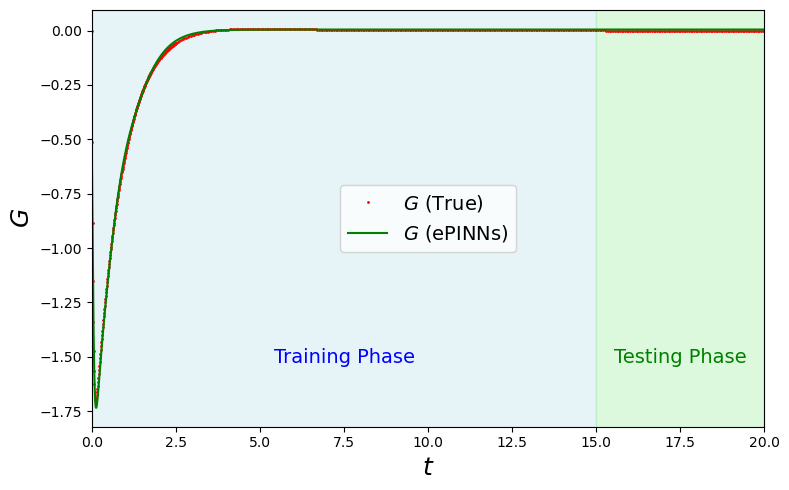

In [19]:

# Define the system of differential equations
def knownsystem(state, t, params):
    R, M, F, MI = state
    
    # Unpack parameters
    w11, w12, w21, w22 = params['w11'], params['w12'], params['w21'], params['w22']
    alpha11, alpha12, alpha21, alpha22 = params['alpha11'], params['alpha12'], params['alpha21'], params['alpha22']
    RT = params['RT']
    
    # Define the system of equations
    dR_dt = -w11 * M * R + w12 * F - w21 * MI * R + w22 * (RT - R - F)
    dM_dt = alpha11 - alpha12 * M - w11 * M * R + w12 * F
    dF_dt = w11 * M * R - w12 * F
    dMI_dt = alpha21 - alpha22 * MI - w21 * MI * R + w22 * (RT - R - F)
    
    return [dR_dt, dM_dt, dF_dt, dMI_dt]

def partiallyknownsystem(state, t, params):
    R, M, F, MI = state
    
    # Unpack parameters
    w11, w12 = params['w11'], params['w12']
    alpha11, alpha12, alpha21, alpha22 = params['alpha11'], params['alpha12'], params['alpha21'], params['alpha22']
    
    # Define the system of equations
    dR_dt = -w11 * M * R + w12 * F
    dM_dt = alpha11 - alpha12 * M - w11 * M * R + w12 * F
    dF_dt = w11 * M * R - w12 * F
    dMI_dt = alpha21 - alpha22 * MI
    
    return [dR_dt, dM_dt, dF_dt, dMI_dt]

# Optimized parameters
alpha21_opt, alpha22_opt = final_variables

# Estimated parameters
params_est = {
    'w11': 1, 'w12': 3, 'w21': 1, 'w22': 7,
    'beta2': 1,
    'alpha11': 1, 'alpha12': 3, 'alpha21': alpha21_opt, 'alpha22': alpha22_opt,
    'RT': 20, 'QT': 18
}

# True parameters
params = {
    'w11': 1, 'w12': 3, 'w21': 1, 'w22': 7,
    'beta1': 2, 'beta2': 1,
    'alpha11': 1, 'alpha12': 3, 'alpha21': 3, 'alpha22': 5,
    'RT': 20, 'QT': 18
}

# Initial conditions
initial_conditions = [20, 0, 0, 0]

# Solve the known system
solution = odeint(knownsystem, initial_conditions, t_data, args=(params,))
R_true_known, M_true_known, F_true_known, MI_true_known = solution.T
G_true_known = -params['w21'] * MI_true_known * R_true_known + params['w22'] * (params['RT'] - R_true_known - F_true_known)
G_known = -params['w21'] * MI_noisy * R_noisy + params['w22'] * (params['RT'] - R_noisy - F_noisy)

# Solve the estimated system
solution = odeint(knownsystem, initial_conditions, t_data, args=(params_est,))
R_est_known, M_est_known, F_est_known, MI_est_known = solution.T
G_est = -params['w21'] * MI_est_known * R_est_known + params['w22'] * (params['RT'] - R_est_known - F_est_known)

# Solve the partially known system
solution = odeint(partiallyknownsystem, initial_conditions, t_data, args=(params_est,))
R_est_pknown, M_est_pknown, F_est_pknown, MI_est_pknown = solution.T

# Define the regions for shading
training_start, training_end = 0, 15  # Training phase: 0 to 15
testing_start, testing_end = 15, max(t_true)  # Testing phase: 15 to end

# Create the figure and axis
fig, ax = plt.subplots(figsize=(8, 5))

# Shade the training and testing regions
ax.axvspan(training_start, training_end, color='lightblue', alpha=0.3)
ax.text((training_start + training_end) / 2, min(G_true_known) * 0.9, 'Training Phase', color='blue', fontsize=14, ha='center')

ax.axvspan(testing_start, testing_end, color='lightgreen', alpha=0.3)
ax.text((testing_start + testing_end) / 2, min(G_true_known) * 0.9, 'Testing Phase', color='green', fontsize=14, ha='center')

# Plot the curves
ax.plot(t_true, G_true_known, label='$G$ (True)', color='r', linestyle='', marker='o', markersize=1)
ax.plot(t_PINNs, np.squeeze(G_PINNs), label='$G$ (ePINNs)', color='g')

# Set labels and formatting
ax.set_ylabel('$G$', fontsize=18)
ax.set_xlabel('$t$', fontsize=18)
ax.legend(loc='best', fontsize=14)
ax.set_xlim(0, 20)

# Adjust layout and save the plot
plt.tight_layout()
plt.show()

# Save the plot as an image
fig.savefig('G_PINNs_unknownparams_wp1.0_lr0.02_400k_F_M+MI2_2layers-v1.jpeg', format='jpeg', dpi=300)
fig.savefig('G_PINNs_unknownparams_wp1.0_lr0.02_400k_F_M+MI2_2layers-v1.png', format='png', dpi=300)
